In [1]:
!pip install nltk
!pip install gensim
!pip install pandas

In [2]:
import os
MODEL_PATH = os.path.join("Model", "CNN.h5")

In [3]:
import tensorflow as tf
from keras.callbacks import ModelCheckpoint
from keras.layers import Dense, Dropout, Reshape, Flatten, concatenate, Input, Conv1D, GlobalMaxPooling1D, Embedding,\
                            BatchNormalization
from keras.models import Sequential

from keras.models import Model
import numpy as np
import pandas as pd
import nltk
import re
import gensim
from gensim.models import Word2Vec
from gensim.models import KeyedVectors

import warnings
warnings.filterwarnings(action ='ignore')

In [4]:
from nltk.data import find
nltk.download('word2vec_sample')

[nltk_data] Downloading package word2vec_sample to C:\Users\Imad
[nltk_data]     Eddine Hajjane\AppData\Roaming\nltk_data...
[nltk_data]   Package word2vec_sample is already up-to-date!


True

# Import data

In [5]:
dataframe = pd.read_csv(os.path.join("train", "training_noemoticon.csv"), encoding='latin-1')[['id', 'text']]
dataframe

,id,text
0,0,upset ca nt update facebook texting might cry...
1,0,kenichan i dive many time ball manage save ...
2,0,whole body feel itchy like fire
3,0,nationwideclass no not behave mad i ca nt...
4,0,kwesidei not whole crew
...,...,...
1599626,1,just woke have no school best feeling ever
1599627,1,thewdbcom very cool hear old walt interview r
1599628,1,be ready mojo makeover ask detail
1599629,1,happy th birthday boo alll time tupac amaru...


In [6]:
labels = dataframe[[dataframe.columns[0]]].to_numpy().flatten()

In [7]:
X = dataframe["text"]

In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(lowercase=False, sublinear_tf=True, dtype=np.float32)
vectors = vectorizer.fit_transform(X)
terms = vectorizer.get_feature_names_out()

# Create an index

In [9]:
MAX_SEQUENCE_LENGTH = 300
EMBEDDING_DIM = 300

In [10]:
def get_average_word2vec(tokens_list, vector, generate_missing=False, k=300):
    if len(tokens_list)<1:
        return np.zeros(k)
    if generate_missing:
        vectorized = [vector[word] if word in vector else np.random.rand(k) for word in tokens_list]
    else:
        vectorized = [vector[word] if word in vector else np.zeros(k) for word in tokens_list]
    length = len(vectorized)
    summed = np.sum(vectorized, axis=0)
    averaged = np.divide(summed, length)
    return averaged

def get_word2vec_embeddings(vectors, clean_comments, generate_missing=False, k=300):
    embeddings = clean_comments.apply(lambda x: get_average_word2vec(x, vectors, generate_missing=generate_missing, k=k))
    return list(embeddings)

In [11]:
word2vec = KeyedVectors.load_word2vec_format(str(find('models/word2vec_sample/pruned.word2vec.txt')), binary=False)

In [12]:
training_embeddings = get_word2vec_embeddings(word2vec, X.apply(lambda x : x.split()), generate_missing=True, k=EMBEDDING_DIM)

In [13]:
from sklearn.model_selection import train_test_split
data_train, data_test, Label_train, Label_test = train_test_split(X, labels, test_size=0.25, random_state=42)

In [14]:
from keras.preprocessing.text import Tokenizer
from keras_preprocessing.sequence import pad_sequences
oov_tok = ''
padding_type='post'
trunc_type='post'
tokenizer = Tokenizer(num_words = len(terms), oov_token=oov_tok)
tokenizer.fit_on_texts(data_train)
word_index = tokenizer.word_index


train_sequences = tokenizer.texts_to_sequences(data_train)
train_cnn_data = pad_sequences(train_sequences, padding='post', maxlen=MAX_SEQUENCE_LENGTH)

test_sequences = tokenizer.texts_to_sequences(data_test)
test_cnn_data = pad_sequences(test_sequences, padding='post', maxlen=MAX_SEQUENCE_LENGTH)

In [15]:
train_embedding_weights = np.zeros((len(word_index)+1, EMBEDDING_DIM))
for word,index in word_index.items():
    train_embedding_weights[index,:] = word2vec[word] if word in word2vec else np.random.rand(EMBEDDING_DIM)
print(train_embedding_weights.shape)

(500960, 300)


# Create CNN Model (Convolution Neuron Network)

In [16]:
import tensorflow as tf 
from tensorflow.python.client import device_lib
tf.debugging.set_log_device_placement(True)
gpus =tf.config.list_physical_devices('GPU')
tf.config.set_visible_devices(gpus[0], 'GPU')

In [17]:
class ConvNet:
    def __init__(self, embeddings, max_sequence_length, num_words, embedding_dim):
        self.embedding_layer = Embedding(num_words, embedding_dim, weights=[embeddings], input_length=max_sequence_length, trainable=True)
        self.Input_seq = Input(shape=(max_sequence_length,), dtype='int32')
        self.embedded_sequences = self.embedding_layer(self.Input_seq)
    
    def conv(self, list_filtre):
        return concatenate([GlobalMaxPooling1D()(Conv1D(filters=200, kernel_size=filter_size, activation='relu')(self.embedded_sequences))
                           for filter_size in list_filtre], axis=1)
    def build(self): 
        x = Dense(128, activation='relu')(Dropout(0.1)(self.conv([2,3,4,5,6])))
        return Model(self.Input_seq, Dense(1, activation='sigmoid')(Dropout(0.2)(x)))

In [18]:
model = ConvNet(train_embedding_weights, MAX_SEQUENCE_LENGTH, len(word_index)+1, EMBEDDING_DIM).build()

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomGetKeyCounter in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomUniformV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in

Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomGetKeyCounter in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op StatelessRandomUniformV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Sub in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Mul in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AddV2 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device

# Compile & training 

In [19]:
model.compile(loss=tf.keras.losses.binary_crossentropy,\
                 optimizer=tf.keras.optimizers.Adam(),\
                 metrics=['accuracy'])

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0


In [20]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 300)]        0           []                               
                                                                                                  
 embedding (Embedding)          (None, 300, 300)     150288000   ['input_1[0][0]']                
                                                                                                  
 conv1d (Conv1D)                (None, 299, 200)     120200      ['embedding[0][0]']              
                                                                                                  
 conv1d_1 (Conv1D)              (None, 298, 200)     180200      ['embedding[0][0]']              
                                                                                              

In [21]:
hist = model.fit(train_cnn_data, Label_train, epochs=5, batch_size=64, validation_split=0.1, shuffle=True,\
                callbacks=[tf.keras.callbacks.ModelCheckpoint(f"{MODEL_PATH}", save_best_only=True),\
                                tf.keras.callbacks.ReduceLROnPlateau(factor=tf.math.exp(-0.1), patience=3, min_lr=0.00001)])


Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Exp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op GreaterEqual in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Fill in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op VarHandleOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localh

    7/16872 [..............................] - ETA: 16:48 - loss: 0.8854 - accuracy: 0.5134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
    8/16872 [..............................] - ETA: 16:46 - loss: 0.8573 - accuracy: 0.5254Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
    9/16872 [..............................] - ETA: 16:48 - loss: 0.8394 - accuracy: 0.5243Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   31/16872 [..............................] - ETA: 16:43 - loss: 0.7377 - accuracy: 0.5459Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   32/16872 [..............................] - ETA: 16:44 - loss: 0.7358 - accuracy: 0.5459Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   33/16872 [..............................] - ETA: 16:44 - loss: 0.7340 - accuracy: 0.5469Executing op ReadVariableOp in

   54/16872 [..............................] - ETA: 16:45 - loss: 0.7152 - accuracy: 0.5480Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   55/16872 [..............................] - ETA: 16:47 - loss: 0.7146 - accuracy: 0.5480Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   56/16872 [..............................] - ETA: 16:50 - loss: 0.7139 - accuracy: 0.5469Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   78/16872 [..............................] - ETA: 16:48 - loss: 0.7036 - accuracy: 0.5519Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   79/16872 [..............................] - ETA: 16:48 - loss: 0.7033 - accuracy: 0.5522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   80/16872 [..............................] - ETA: 16:48 - loss: 0.7025 - accuracy: 0.5531Executing op ReadVariableOp in

  101/16872 [..............................] - ETA: 16:41 - loss: 0.6967 - accuracy: 0.5572Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  102/16872 [..............................] - ETA: 16:41 - loss: 0.6967 - accuracy: 0.5573Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  103/16872 [..............................] - ETA: 16:41 - loss: 0.6962 - accuracy: 0.5579Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  125/16872 [..............................] - ETA: 16:42 - loss: 0.6889 - accuracy: 0.5684Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  126/16872 [..............................] - ETA: 16:42 - loss: 0.6888 - accuracy: 0.5683Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  127/16872 [..............................] - ETA: 16:42 - loss: 0.6880 - accuracy: 0.5693Executing op ReadVariableOp in

  148/16872 [..............................] - ETA: 16:42 - loss: 0.6796 - accuracy: 0.5834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  149/16872 [..............................] - ETA: 16:42 - loss: 0.6786 - accuracy: 0.5850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  150/16872 [..............................] - ETA: 16:42 - loss: 0.6775 - accuracy: 0.5867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  172/16872 [..............................] - ETA: 16:39 - loss: 0.6656 - accuracy: 0.6015Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  173/16872 [..............................] - ETA: 16:38 - loss: 0.6646 - accuracy: 0.6023Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  174/16872 [..............................] - ETA: 16:38 - loss: 0.6637 - accuracy: 0.6029Executing op ReadVariableOp in

  195/16872 [..............................] - ETA: 16:36 - loss: 0.6507 - accuracy: 0.6183Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  196/16872 [..............................] - ETA: 16:35 - loss: 0.6509 - accuracy: 0.6183Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  197/16872 [..............................] - ETA: 16:35 - loss: 0.6505 - accuracy: 0.6190Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  219/16872 [..............................] - ETA: 16:32 - loss: 0.6398 - accuracy: 0.6306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  220/16872 [..............................] - ETA: 16:33 - loss: 0.6393 - accuracy: 0.6312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  221/16872 [..............................] - ETA: 16:33 - loss: 0.6389 - accuracy: 0.6318Executing op ReadVariableOp in

  242/16872 [..............................] - ETA: 16:26 - loss: 0.6302 - accuracy: 0.6406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  243/16872 [..............................] - ETA: 16:26 - loss: 0.6301 - accuracy: 0.6406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  244/16872 [..............................] - ETA: 16:26 - loss: 0.6299 - accuracy: 0.6408Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  266/16872 [..............................] - ETA: 16:23 - loss: 0.6205 - accuracy: 0.6500Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  267/16872 [..............................] - ETA: 16:23 - loss: 0.6201 - accuracy: 0.6503Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  268/16872 [..............................] - ETA: 16:23 - loss: 0.6200 - accuracy: 0.6508Executing op ReadVariableOp in

  289/16872 [..............................] - ETA: 16:19 - loss: 0.6164 - accuracy: 0.6551Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  290/16872 [..............................] - ETA: 16:19 - loss: 0.6160 - accuracy: 0.6552Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  291/16872 [..............................] - ETA: 16:19 - loss: 0.6156 - accuracy: 0.6556Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  313/16872 [..............................] - ETA: 16:17 - loss: 0.6095 - accuracy: 0.6624Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  314/16872 [..............................] - ETA: 16:17 - loss: 0.6093 - accuracy: 0.6628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  315/16872 [..............................] - ETA: 16:16 - loss: 0.6091 - accuracy: 0.6630Executing op ReadVariableOp in

  336/16872 [..............................] - ETA: 16:15 - loss: 0.6035 - accuracy: 0.6686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  337/16872 [..............................] - ETA: 16:16 - loss: 0.6032 - accuracy: 0.6688Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  338/16872 [..............................] - ETA: 16:16 - loss: 0.6030 - accuracy: 0.6691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  360/16872 [..............................] - ETA: 16:17 - loss: 0.5963 - accuracy: 0.6750Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  361/16872 [..............................] - ETA: 16:17 - loss: 0.5961 - accuracy: 0.6753Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  362/16872 [..............................] - ETA: 16:17 - loss: 0.5957 - accuracy: 0.6755Executing op ReadVariableOp in

  383/16872 [..............................] - ETA: 16:16 - loss: 0.5928 - accuracy: 0.6788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  384/16872 [..............................] - ETA: 16:16 - loss: 0.5926 - accuracy: 0.6791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  385/16872 [..............................] - ETA: 16:16 - loss: 0.5924 - accuracy: 0.6794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  407/16872 [..............................] - ETA: 16:14 - loss: 0.5892 - accuracy: 0.6831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  408/16872 [..............................] - ETA: 16:14 - loss: 0.5891 - accuracy: 0.6833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  409/16872 [..............................] - ETA: 16:14 - loss: 0.5889 - accuracy: 0.6835Executing op ReadVariableOp in

  430/16872 [..............................] - ETA: 16:11 - loss: 0.5855 - accuracy: 0.6865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  431/16872 [..............................] - ETA: 16:11 - loss: 0.5851 - accuracy: 0.6868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  432/16872 [..............................] - ETA: 16:10 - loss: 0.5848 - accuracy: 0.6872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  454/16872 [..............................] - ETA: 16:09 - loss: 0.5804 - accuracy: 0.6903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  455/16872 [..............................] - ETA: 16:09 - loss: 0.5801 - accuracy: 0.6905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  456/16872 [..............................] - ETA: 16:09 - loss: 0.5797 - accuracy: 0.6909Executing op ReadVariableOp in

  477/16872 [..............................] - ETA: 16:07 - loss: 0.5768 - accuracy: 0.6933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  478/16872 [..............................] - ETA: 16:07 - loss: 0.5765 - accuracy: 0.6935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  479/16872 [..............................] - ETA: 16:07 - loss: 0.5764 - accuracy: 0.6937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  501/16872 [..............................] - ETA: 16:03 - loss: 0.5726 - accuracy: 0.6967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  502/16872 [..............................] - ETA: 16:03 - loss: 0.5725 - accuracy: 0.6967Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  503/16872 [..............................] - ETA: 16:03 - loss: 0.5724 - accuracy: 0.6969Executing op ReadVariableOp in

  524/16872 [..............................] - ETA: 16:00 - loss: 0.5697 - accuracy: 0.6991Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  525/16872 [..............................] - ETA: 16:00 - loss: 0.5696 - accuracy: 0.6992Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  526/16872 [..............................] - ETA: 16:00 - loss: 0.5695 - accuracy: 0.6993Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  548/16872 [..............................] - ETA: 15:58 - loss: 0.5670 - accuracy: 0.7013Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  549/16872 [..............................] - ETA: 15:58 - loss: 0.5669 - accuracy: 0.7014Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  550/16872 [..............................] - ETA: 15:58 - loss: 0.5669 - accuracy: 0.7014Executing op ReadVariableOp in

  571/16872 [>.............................] - ETA: 15:55 - loss: 0.5641 - accuracy: 0.7035Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  572/16872 [>.............................] - ETA: 15:55 - loss: 0.5637 - accuracy: 0.7036Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  573/16872 [>.............................] - ETA: 15:55 - loss: 0.5635 - accuracy: 0.7038Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  595/16872 [>.............................] - ETA: 15:53 - loss: 0.5607 - accuracy: 0.7062Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  596/16872 [>.............................] - ETA: 15:53 - loss: 0.5607 - accuracy: 0.7062Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  597/16872 [>.............................] - ETA: 15:53 - loss: 0.5606 - accuracy: 0.7062Executing op ReadVariableOp in

  618/16872 [>.............................] - ETA: 15:51 - loss: 0.5585 - accuracy: 0.7075Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  619/16872 [>.............................] - ETA: 15:51 - loss: 0.5583 - accuracy: 0.7077Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  620/16872 [>.............................] - ETA: 15:50 - loss: 0.5581 - accuracy: 0.7077Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  642/16872 [>.............................] - ETA: 15:48 - loss: 0.5564 - accuracy: 0.7088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  643/16872 [>.............................] - ETA: 15:48 - loss: 0.5563 - accuracy: 0.7090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  644/16872 [>.............................] - ETA: 15:48 - loss: 0.5562 - accuracy: 0.7090Executing op ReadVariableOp in

  665/16872 [>.............................] - ETA: 15:47 - loss: 0.5545 - accuracy: 0.7106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  666/16872 [>.............................] - ETA: 15:47 - loss: 0.5544 - accuracy: 0.7107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  667/16872 [>.............................] - ETA: 15:47 - loss: 0.5542 - accuracy: 0.7108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  689/16872 [>.............................] - ETA: 15:45 - loss: 0.5529 - accuracy: 0.7120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  690/16872 [>.............................] - ETA: 15:45 - loss: 0.5529 - accuracy: 0.7120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  691/16872 [>.............................] - ETA: 15:45 - loss: 0.5527 - accuracy: 0.7122Executing op ReadVariableOp in

  712/16872 [>.............................] - ETA: 15:44 - loss: 0.5519 - accuracy: 0.7132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  713/16872 [>.............................] - ETA: 15:44 - loss: 0.5518 - accuracy: 0.7133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  714/16872 [>.............................] - ETA: 15:44 - loss: 0.5516 - accuracy: 0.7134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  736/16872 [>.............................] - ETA: 15:42 - loss: 0.5499 - accuracy: 0.7148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  737/16872 [>.............................] - ETA: 15:42 - loss: 0.5498 - accuracy: 0.7148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  738/16872 [>.............................] - ETA: 15:42 - loss: 0.5496 - accuracy: 0.7149Executing op ReadVariableOp in

  759/16872 [>.............................] - ETA: 15:39 - loss: 0.5484 - accuracy: 0.7160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  760/16872 [>.............................] - ETA: 15:39 - loss: 0.5482 - accuracy: 0.7161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  761/16872 [>.............................] - ETA: 15:39 - loss: 0.5482 - accuracy: 0.7161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  783/16872 [>.............................] - ETA: 15:37 - loss: 0.5467 - accuracy: 0.7171Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  784/16872 [>.............................] - ETA: 15:37 - loss: 0.5466 - accuracy: 0.7172Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  785/16872 [>.............................] - ETA: 15:37 - loss: 0.5465 - accuracy: 0.7172Executing op ReadVariableOp in

  806/16872 [>.............................] - ETA: 15:36 - loss: 0.5452 - accuracy: 0.7184Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  807/16872 [>.............................] - ETA: 15:36 - loss: 0.5450 - accuracy: 0.7185Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  808/16872 [>.............................] - ETA: 15:36 - loss: 0.5449 - accuracy: 0.7186Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  830/16872 [>.............................] - ETA: 15:34 - loss: 0.5440 - accuracy: 0.7193Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  831/16872 [>.............................] - ETA: 15:33 - loss: 0.5439 - accuracy: 0.7193Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  832/16872 [>.............................] - ETA: 15:33 - loss: 0.5438 - accuracy: 0.7194Executing op ReadVariableOp in

  853/16872 [>.............................] - ETA: 15:32 - loss: 0.5423 - accuracy: 0.7207Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  854/16872 [>.............................] - ETA: 15:32 - loss: 0.5422 - accuracy: 0.7209Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  855/16872 [>.............................] - ETA: 15:31 - loss: 0.5422 - accuracy: 0.7208Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  877/16872 [>.............................] - ETA: 15:30 - loss: 0.5402 - accuracy: 0.7220Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  878/16872 [>.............................] - ETA: 15:29 - loss: 0.5400 - accuracy: 0.7220Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  879/16872 [>.............................] - ETA: 15:29 - loss: 0.5400 - accuracy: 0.7221Executing op ReadVariableOp in

  900/16872 [>.............................] - ETA: 15:27 - loss: 0.5388 - accuracy: 0.7230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  901/16872 [>.............................] - ETA: 15:27 - loss: 0.5388 - accuracy: 0.7230Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  902/16872 [>.............................] - ETA: 15:27 - loss: 0.5388 - accuracy: 0.7231Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  924/16872 [>.............................] - ETA: 15:25 - loss: 0.5375 - accuracy: 0.7241Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  925/16872 [>.............................] - ETA: 15:25 - loss: 0.5374 - accuracy: 0.7242Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  926/16872 [>.............................] - ETA: 15:25 - loss: 0.5373 - accuracy: 0.7242Executing op ReadVariableOp in

  947/16872 [>.............................] - ETA: 15:23 - loss: 0.5360 - accuracy: 0.7252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  948/16872 [>.............................] - ETA: 15:23 - loss: 0.5361 - accuracy: 0.7251Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  949/16872 [>.............................] - ETA: 15:23 - loss: 0.5360 - accuracy: 0.7252Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  971/16872 [>.............................] - ETA: 15:21 - loss: 0.5350 - accuracy: 0.7260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  972/16872 [>.............................] - ETA: 15:21 - loss: 0.5350 - accuracy: 0.7260Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  973/16872 [>.............................] - ETA: 15:21 - loss: 0.5349 - accuracy: 0.7261Executing op ReadVariableOp in

  994/16872 [>.............................] - ETA: 15:19 - loss: 0.5336 - accuracy: 0.7272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  995/16872 [>.............................] - ETA: 15:19 - loss: 0.5336 - accuracy: 0.7272Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  996/16872 [>.............................] - ETA: 15:19 - loss: 0.5335 - accuracy: 0.7273Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1018/16872 [>.............................] - ETA: 15:18 - loss: 0.5328 - accuracy: 0.7281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1019/16872 [>.............................] - ETA: 15:18 - loss: 0.5329 - accuracy: 0.7281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1020/16872 [>.............................] - ETA: 15:18 - loss: 0.5328 - accuracy: 0.7282Executing op ReadVariableOp in

 1041/16872 [>.............................] - ETA: 15:18 - loss: 0.5320 - accuracy: 0.7289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1042/16872 [>.............................] - ETA: 15:18 - loss: 0.5319 - accuracy: 0.7291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1043/16872 [>.............................] - ETA: 15:18 - loss: 0.5318 - accuracy: 0.7291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1065/16872 [>.............................] - ETA: 15:17 - loss: 0.5305 - accuracy: 0.7301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1066/16872 [>.............................] - ETA: 15:17 - loss: 0.5304 - accuracy: 0.7302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1067/16872 [>.............................] - ETA: 15:17 - loss: 0.5304 - accuracy: 0.7301Executing op ReadVariableOp in

 1088/16872 [>.............................] - ETA: 15:15 - loss: 0.5298 - accuracy: 0.7306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1089/16872 [>.............................] - ETA: 15:15 - loss: 0.5297 - accuracy: 0.7306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1090/16872 [>.............................] - ETA: 15:15 - loss: 0.5296 - accuracy: 0.7306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1112/16872 [>.............................] - ETA: 15:13 - loss: 0.5287 - accuracy: 0.7313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1113/16872 [>.............................] - ETA: 15:13 - loss: 0.5286 - accuracy: 0.7314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1114/16872 [>.............................] - ETA: 15:13 - loss: 0.5286 - accuracy: 0.7314Executing op ReadVariableOp in

 1135/16872 [=>............................] - ETA: 15:11 - loss: 0.5280 - accuracy: 0.7320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1136/16872 [=>............................] - ETA: 15:11 - loss: 0.5280 - accuracy: 0.7320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1137/16872 [=>............................] - ETA: 15:11 - loss: 0.5280 - accuracy: 0.7320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1159/16872 [=>............................] - ETA: 15:10 - loss: 0.5276 - accuracy: 0.7322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1160/16872 [=>............................] - ETA: 15:10 - loss: 0.5275 - accuracy: 0.7324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1161/16872 [=>............................] - ETA: 15:10 - loss: 0.5274 - accuracy: 0.7325Executing op ReadVariableOp in

 1182/16872 [=>............................] - ETA: 15:09 - loss: 0.5263 - accuracy: 0.7331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1183/16872 [=>............................] - ETA: 15:08 - loss: 0.5262 - accuracy: 0.7332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1184/16872 [=>............................] - ETA: 15:08 - loss: 0.5261 - accuracy: 0.7333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1206/16872 [=>............................] - ETA: 15:07 - loss: 0.5258 - accuracy: 0.7338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1207/16872 [=>............................] - ETA: 15:07 - loss: 0.5258 - accuracy: 0.7338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1208/16872 [=>............................] - ETA: 15:07 - loss: 0.5258 - accuracy: 0.7338Executing op ReadVariableOp in

 1229/16872 [=>............................] - ETA: 15:05 - loss: 0.5255 - accuracy: 0.7341Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1230/16872 [=>............................] - ETA: 15:05 - loss: 0.5254 - accuracy: 0.7342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1231/16872 [=>............................] - ETA: 15:05 - loss: 0.5253 - accuracy: 0.7342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1253/16872 [=>............................] - ETA: 15:04 - loss: 0.5247 - accuracy: 0.7347Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1254/16872 [=>............................] - ETA: 15:04 - loss: 0.5246 - accuracy: 0.7347Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1255/16872 [=>............................] - ETA: 15:04 - loss: 0.5246 - accuracy: 0.7348Executing op ReadVariableOp in

 1276/16872 [=>............................] - ETA: 15:02 - loss: 0.5239 - accuracy: 0.7352Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1277/16872 [=>............................] - ETA: 15:02 - loss: 0.5239 - accuracy: 0.7353Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1278/16872 [=>............................] - ETA: 15:02 - loss: 0.5240 - accuracy: 0.7352Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1300/16872 [=>............................] - ETA: 15:02 - loss: 0.5233 - accuracy: 0.7357Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1301/16872 [=>............................] - ETA: 15:02 - loss: 0.5232 - accuracy: 0.7358Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1302/16872 [=>............................] - ETA: 15:02 - loss: 0.5232 - accuracy: 0.7359Executing op ReadVariableOp in

 1323/16872 [=>............................] - ETA: 15:00 - loss: 0.5224 - accuracy: 0.7365Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1324/16872 [=>............................] - ETA: 15:00 - loss: 0.5224 - accuracy: 0.7365Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1325/16872 [=>............................] - ETA: 15:00 - loss: 0.5224 - accuracy: 0.7365Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1347/16872 [=>............................] - ETA: 15:00 - loss: 0.5220 - accuracy: 0.7370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1348/16872 [=>............................] - ETA: 15:00 - loss: 0.5219 - accuracy: 0.7370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1349/16872 [=>............................] - ETA: 15:00 - loss: 0.5219 - accuracy: 0.7370Executing op ReadVariableOp in

 1370/16872 [=>............................] - ETA: 14:59 - loss: 0.5216 - accuracy: 0.7372Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1371/16872 [=>............................] - ETA: 14:59 - loss: 0.5216 - accuracy: 0.7372Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1372/16872 [=>............................] - ETA: 14:59 - loss: 0.5216 - accuracy: 0.7372Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1394/16872 [=>............................] - ETA: 14:57 - loss: 0.5214 - accuracy: 0.7373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1395/16872 [=>............................] - ETA: 14:57 - loss: 0.5213 - accuracy: 0.7373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1396/16872 [=>............................] - ETA: 14:57 - loss: 0.5213 - accuracy: 0.7373Executing op ReadVariableOp in

 1417/16872 [=>............................] - ETA: 14:57 - loss: 0.5210 - accuracy: 0.7376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1418/16872 [=>............................] - ETA: 14:56 - loss: 0.5210 - accuracy: 0.7376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1419/16872 [=>............................] - ETA: 14:56 - loss: 0.5210 - accuracy: 0.7376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1441/16872 [=>............................] - ETA: 14:55 - loss: 0.5203 - accuracy: 0.7381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1442/16872 [=>............................] - ETA: 14:55 - loss: 0.5203 - accuracy: 0.7381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1443/16872 [=>............................] - ETA: 14:55 - loss: 0.5202 - accuracy: 0.7382Executing op ReadVariableOp in

 1464/16872 [=>............................] - ETA: 14:53 - loss: 0.5191 - accuracy: 0.7391Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1465/16872 [=>............................] - ETA: 14:53 - loss: 0.5191 - accuracy: 0.7392Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1466/16872 [=>............................] - ETA: 14:53 - loss: 0.5191 - accuracy: 0.7392Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1488/16872 [=>............................] - ETA: 14:52 - loss: 0.5187 - accuracy: 0.7396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1489/16872 [=>............................] - ETA: 14:52 - loss: 0.5187 - accuracy: 0.7397Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1490/16872 [=>............................] - ETA: 14:52 - loss: 0.5187 - accuracy: 0.7397Executing op ReadVariableOp in

 1511/16872 [=>............................] - ETA: 14:52 - loss: 0.5181 - accuracy: 0.7403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1512/16872 [=>............................] - ETA: 14:52 - loss: 0.5180 - accuracy: 0.7404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1513/16872 [=>............................] - ETA: 14:51 - loss: 0.5181 - accuracy: 0.7403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1535/16872 [=>............................] - ETA: 14:51 - loss: 0.5175 - accuracy: 0.7408Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1536/16872 [=>............................] - ETA: 14:51 - loss: 0.5175 - accuracy: 0.7408Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1537/16872 [=>............................] - ETA: 14:51 - loss: 0.5175 - accuracy: 0.7408Executing op ReadVariableOp in

 1558/16872 [=>............................] - ETA: 14:50 - loss: 0.5172 - accuracy: 0.7412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1559/16872 [=>............................] - ETA: 14:49 - loss: 0.5172 - accuracy: 0.7413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1560/16872 [=>............................] - ETA: 14:49 - loss: 0.5171 - accuracy: 0.7413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1582/16872 [=>............................] - ETA: 14:48 - loss: 0.5166 - accuracy: 0.7419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1583/16872 [=>............................] - ETA: 14:48 - loss: 0.5166 - accuracy: 0.7419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1584/16872 [=>............................] - ETA: 14:48 - loss: 0.5166 - accuracy: 0.7420Executing op ReadVariableOp in

 1605/16872 [=>............................] - ETA: 14:47 - loss: 0.5163 - accuracy: 0.7421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1606/16872 [=>............................] - ETA: 14:47 - loss: 0.5162 - accuracy: 0.7420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1607/16872 [=>............................] - ETA: 14:47 - loss: 0.5164 - accuracy: 0.7420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1629/16872 [=>............................] - ETA: 14:46 - loss: 0.5156 - accuracy: 0.7426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1630/16872 [=>............................] - ETA: 14:47 - loss: 0.5155 - accuracy: 0.7426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1631/16872 [=>............................] - ETA: 14:46 - loss: 0.5155 - accuracy: 0.7427Executing op ReadVariableOp in

 1652/16872 [=>............................] - ETA: 14:45 - loss: 0.5148 - accuracy: 0.7431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1653/16872 [=>............................] - ETA: 14:46 - loss: 0.5147 - accuracy: 0.7432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1654/16872 [=>............................] - ETA: 14:45 - loss: 0.5147 - accuracy: 0.7432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1676/16872 [=>............................] - ETA: 14:44 - loss: 0.5143 - accuracy: 0.7436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1677/16872 [=>............................] - ETA: 14:44 - loss: 0.5143 - accuracy: 0.7436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1678/16872 [=>............................] - ETA: 14:44 - loss: 0.5142 - accuracy: 0.7436Executing op ReadVariableOp in

 1699/16872 [==>...........................] - ETA: 14:43 - loss: 0.5139 - accuracy: 0.7440Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1700/16872 [==>...........................] - ETA: 14:43 - loss: 0.5139 - accuracy: 0.7441Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1701/16872 [==>...........................] - ETA: 14:43 - loss: 0.5138 - accuracy: 0.7441Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1723/16872 [==>...........................] - ETA: 14:41 - loss: 0.5134 - accuracy: 0.7445Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1724/16872 [==>...........................] - ETA: 14:41 - loss: 0.5134 - accuracy: 0.7445Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1725/16872 [==>...........................] - ETA: 14:41 - loss: 0.5134 - accuracy: 0.7445Executing op ReadVariableOp in

 1746/16872 [==>...........................] - ETA: 14:39 - loss: 0.5129 - accuracy: 0.7449Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1747/16872 [==>...........................] - ETA: 14:39 - loss: 0.5129 - accuracy: 0.7449Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1748/16872 [==>...........................] - ETA: 14:39 - loss: 0.5129 - accuracy: 0.7450Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1770/16872 [==>...........................] - ETA: 14:38 - loss: 0.5123 - accuracy: 0.7455Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1771/16872 [==>...........................] - ETA: 14:38 - loss: 0.5123 - accuracy: 0.7455Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1772/16872 [==>...........................] - ETA: 14:38 - loss: 0.5122 - accuracy: 0.7455Executing op ReadVariableOp in

 1793/16872 [==>...........................] - ETA: 14:36 - loss: 0.5118 - accuracy: 0.7459Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1794/16872 [==>...........................] - ETA: 14:36 - loss: 0.5118 - accuracy: 0.7459Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1795/16872 [==>...........................] - ETA: 14:36 - loss: 0.5117 - accuracy: 0.7460Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1817/16872 [==>...........................] - ETA: 14:34 - loss: 0.5113 - accuracy: 0.7463Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1818/16872 [==>...........................] - ETA: 14:34 - loss: 0.5113 - accuracy: 0.7463Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1819/16872 [==>...........................] - ETA: 14:34 - loss: 0.5113 - accuracy: 0.7463Executing op ReadVariableOp in

 1840/16872 [==>...........................] - ETA: 14:33 - loss: 0.5108 - accuracy: 0.7466Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1841/16872 [==>...........................] - ETA: 14:33 - loss: 0.5108 - accuracy: 0.7467Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1842/16872 [==>...........................] - ETA: 14:33 - loss: 0.5108 - accuracy: 0.7467Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1864/16872 [==>...........................] - ETA: 14:31 - loss: 0.5106 - accuracy: 0.7469Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1865/16872 [==>...........................] - ETA: 14:31 - loss: 0.5107 - accuracy: 0.7468Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1866/16872 [==>...........................] - ETA: 14:31 - loss: 0.5107 - accuracy: 0.7468Executing op ReadVariableOp in

 1887/16872 [==>...........................] - ETA: 14:30 - loss: 0.5104 - accuracy: 0.7470Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1888/16872 [==>...........................] - ETA: 14:29 - loss: 0.5103 - accuracy: 0.7471Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1889/16872 [==>...........................] - ETA: 14:29 - loss: 0.5103 - accuracy: 0.7471Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1911/16872 [==>...........................] - ETA: 14:29 - loss: 0.5097 - accuracy: 0.7476Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1912/16872 [==>...........................] - ETA: 14:29 - loss: 0.5096 - accuracy: 0.7476Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1913/16872 [==>...........................] - ETA: 14:29 - loss: 0.5096 - accuracy: 0.7477Executing op ReadVariableOp in

 1934/16872 [==>...........................] - ETA: 14:28 - loss: 0.5094 - accuracy: 0.7479Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1935/16872 [==>...........................] - ETA: 14:28 - loss: 0.5094 - accuracy: 0.7479Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1936/16872 [==>...........................] - ETA: 14:28 - loss: 0.5094 - accuracy: 0.7480Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1958/16872 [==>...........................] - ETA: 14:27 - loss: 0.5089 - accuracy: 0.7483Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1959/16872 [==>...........................] - ETA: 14:27 - loss: 0.5089 - accuracy: 0.7483Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1960/16872 [==>...........................] - ETA: 14:26 - loss: 0.5089 - accuracy: 0.7483Executing op ReadVariableOp in

 1981/16872 [==>...........................] - ETA: 14:25 - loss: 0.5084 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1982/16872 [==>...........................] - ETA: 14:25 - loss: 0.5084 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1983/16872 [==>...........................] - ETA: 14:25 - loss: 0.5083 - accuracy: 0.7487Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2005/16872 [==>...........................] - ETA: 14:26 - loss: 0.5078 - accuracy: 0.7490Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2006/16872 [==>...........................] - ETA: 14:26 - loss: 0.5078 - accuracy: 0.7490Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2007/16872 [==>...........................] - ETA: 14:26 - loss: 0.5078 - accuracy: 0.7491Executing op ReadVariableOp in

 2028/16872 [==>...........................] - ETA: 14:27 - loss: 0.5075 - accuracy: 0.7494Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2029/16872 [==>...........................] - ETA: 14:27 - loss: 0.5075 - accuracy: 0.7494Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2030/16872 [==>...........................] - ETA: 14:27 - loss: 0.5075 - accuracy: 0.7494Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2052/16872 [==>...........................] - ETA: 14:28 - loss: 0.5072 - accuracy: 0.7497Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2053/16872 [==>...........................] - ETA: 14:28 - loss: 0.5073 - accuracy: 0.7497Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2054/16872 [==>...........................] - ETA: 14:28 - loss: 0.5073 - accuracy: 0.7496Executing op ReadVariableOp in

 2075/16872 [==>...........................] - ETA: 14:27 - loss: 0.5069 - accuracy: 0.7500Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2076/16872 [==>...........................] - ETA: 14:27 - loss: 0.5068 - accuracy: 0.7501Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2077/16872 [==>...........................] - ETA: 14:27 - loss: 0.5068 - accuracy: 0.7501Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2099/16872 [==>...........................] - ETA: 14:25 - loss: 0.5061 - accuracy: 0.7506Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2100/16872 [==>...........................] - ETA: 14:25 - loss: 0.5061 - accuracy: 0.7506Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2101/16872 [==>...........................] - ETA: 14:25 - loss: 0.5061 - accuracy: 0.7507Executing op ReadVariableOp in

 2122/16872 [==>...........................] - ETA: 14:24 - loss: 0.5058 - accuracy: 0.7509Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2123/16872 [==>...........................] - ETA: 14:24 - loss: 0.5058 - accuracy: 0.7509Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2124/16872 [==>...........................] - ETA: 14:24 - loss: 0.5057 - accuracy: 0.7510Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2146/16872 [==>...........................] - ETA: 14:22 - loss: 0.5053 - accuracy: 0.7513Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2147/16872 [==>...........................] - ETA: 14:22 - loss: 0.5053 - accuracy: 0.7513Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2148/16872 [==>...........................] - ETA: 14:22 - loss: 0.5053 - accuracy: 0.7513Executing op ReadVariableOp in

 2169/16872 [==>...........................] - ETA: 14:22 - loss: 0.5049 - accuracy: 0.7517Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2170/16872 [==>...........................] - ETA: 14:22 - loss: 0.5050 - accuracy: 0.7516Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2171/16872 [==>...........................] - ETA: 14:22 - loss: 0.5049 - accuracy: 0.7517Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2193/16872 [==>...........................] - ETA: 14:22 - loss: 0.5046 - accuracy: 0.7519Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2194/16872 [==>...........................] - ETA: 14:22 - loss: 0.5046 - accuracy: 0.7520Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2195/16872 [==>...........................] - ETA: 14:22 - loss: 0.5046 - accuracy: 0.7520Executing op ReadVariableOp in

 2216/16872 [==>...........................] - ETA: 14:23 - loss: 0.5042 - accuracy: 0.7522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2217/16872 [==>...........................] - ETA: 14:23 - loss: 0.5042 - accuracy: 0.7522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2218/16872 [==>...........................] - ETA: 14:22 - loss: 0.5043 - accuracy: 0.7522Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2240/16872 [==>...........................] - ETA: 14:21 - loss: 0.5036 - accuracy: 0.7526Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2241/16872 [==>...........................] - ETA: 14:21 - loss: 0.5036 - accuracy: 0.7526Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2242/16872 [==>...........................] - ETA: 14:21 - loss: 0.5035 - accuracy: 0.7526Executing op ReadVariableOp in

 2263/16872 [===>..........................] - ETA: 14:21 - loss: 0.5034 - accuracy: 0.7528Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2264/16872 [===>..........................] - ETA: 14:21 - loss: 0.5033 - accuracy: 0.7528Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2265/16872 [===>..........................] - ETA: 14:21 - loss: 0.5033 - accuracy: 0.7528Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2287/16872 [===>..........................] - ETA: 14:21 - loss: 0.5028 - accuracy: 0.7531Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2288/16872 [===>..........................] - ETA: 14:21 - loss: 0.5028 - accuracy: 0.7531Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2289/16872 [===>..........................] - ETA: 14:21 - loss: 0.5028 - accuracy: 0.7531Executing op ReadVariableOp in

 2310/16872 [===>..........................] - ETA: 14:20 - loss: 0.5025 - accuracy: 0.7534Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2311/16872 [===>..........................] - ETA: 14:20 - loss: 0.5025 - accuracy: 0.7534Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2312/16872 [===>..........................] - ETA: 14:20 - loss: 0.5025 - accuracy: 0.7534Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2334/16872 [===>..........................] - ETA: 14:19 - loss: 0.5021 - accuracy: 0.7537Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2335/16872 [===>..........................] - ETA: 14:19 - loss: 0.5021 - accuracy: 0.7537Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2336/16872 [===>..........................] - ETA: 14:19 - loss: 0.5021 - accuracy: 0.7537Executing op ReadVariableOp in

 2357/16872 [===>..........................] - ETA: 14:19 - loss: 0.5019 - accuracy: 0.7538Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2358/16872 [===>..........................] - ETA: 14:19 - loss: 0.5019 - accuracy: 0.7538Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2359/16872 [===>..........................] - ETA: 14:19 - loss: 0.5019 - accuracy: 0.7538Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2381/16872 [===>..........................] - ETA: 14:21 - loss: 0.5015 - accuracy: 0.7540Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2382/16872 [===>..........................] - ETA: 14:21 - loss: 0.5016 - accuracy: 0.7540Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2383/16872 [===>..........................] - ETA: 14:21 - loss: 0.5016 - accuracy: 0.7540Executing op ReadVariableOp in

 2404/16872 [===>..........................] - ETA: 14:21 - loss: 0.5014 - accuracy: 0.7542Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2405/16872 [===>..........................] - ETA: 14:21 - loss: 0.5014 - accuracy: 0.7542Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2406/16872 [===>..........................] - ETA: 14:21 - loss: 0.5015 - accuracy: 0.7542Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2428/16872 [===>..........................] - ETA: 14:21 - loss: 0.5012 - accuracy: 0.7543Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2429/16872 [===>..........................] - ETA: 14:21 - loss: 0.5012 - accuracy: 0.7544Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2430/16872 [===>..........................] - ETA: 14:21 - loss: 0.5011 - accuracy: 0.7544Executing op ReadVariableOp in

 2451/16872 [===>..........................] - ETA: 14:21 - loss: 0.5010 - accuracy: 0.7546Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2452/16872 [===>..........................] - ETA: 14:21 - loss: 0.5010 - accuracy: 0.7546Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2453/16872 [===>..........................] - ETA: 14:21 - loss: 0.5009 - accuracy: 0.7547Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2475/16872 [===>..........................] - ETA: 14:21 - loss: 0.5006 - accuracy: 0.7550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2476/16872 [===>..........................] - ETA: 14:21 - loss: 0.5006 - accuracy: 0.7550Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2477/16872 [===>..........................] - ETA: 14:21 - loss: 0.5006 - accuracy: 0.7550Executing op ReadVariableOp in

 2498/16872 [===>..........................] - ETA: 14:22 - loss: 0.5002 - accuracy: 0.7553Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2499/16872 [===>..........................] - ETA: 14:22 - loss: 0.5002 - accuracy: 0.7553Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2500/16872 [===>..........................] - ETA: 14:22 - loss: 0.5001 - accuracy: 0.7553Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2522/16872 [===>..........................] - ETA: 14:22 - loss: 0.4999 - accuracy: 0.7555Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2523/16872 [===>..........................] - ETA: 14:22 - loss: 0.4999 - accuracy: 0.7554Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2524/16872 [===>..........................] - ETA: 14:22 - loss: 0.4999 - accuracy: 0.7554Executing op ReadVariableOp in

 2545/16872 [===>..........................] - ETA: 14:22 - loss: 0.4996 - accuracy: 0.7557Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2546/16872 [===>..........................] - ETA: 14:22 - loss: 0.4996 - accuracy: 0.7558Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2547/16872 [===>..........................] - ETA: 14:22 - loss: 0.4995 - accuracy: 0.7557Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2569/16872 [===>..........................] - ETA: 14:22 - loss: 0.4991 - accuracy: 0.7561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2570/16872 [===>..........................] - ETA: 14:22 - loss: 0.4991 - accuracy: 0.7561Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2571/16872 [===>..........................] - ETA: 14:22 - loss: 0.4990 - accuracy: 0.7561Executing op ReadVariableOp in

 2592/16872 [===>..........................] - ETA: 14:22 - loss: 0.4988 - accuracy: 0.7564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2593/16872 [===>..........................] - ETA: 14:22 - loss: 0.4988 - accuracy: 0.7564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2594/16872 [===>..........................] - ETA: 14:22 - loss: 0.4988 - accuracy: 0.7564Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2616/16872 [===>..........................] - ETA: 14:22 - loss: 0.4984 - accuracy: 0.7567Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2617/16872 [===>..........................] - ETA: 14:22 - loss: 0.4984 - accuracy: 0.7567Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2618/16872 [===>..........................] - ETA: 14:22 - loss: 0.4984 - accuracy: 0.7567Executing op ReadVariableOp in

 2639/16872 [===>..........................] - ETA: 14:21 - loss: 0.4980 - accuracy: 0.7570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2640/16872 [===>..........................] - ETA: 14:21 - loss: 0.4980 - accuracy: 0.7570Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2641/16872 [===>..........................] - ETA: 14:21 - loss: 0.4979 - accuracy: 0.7571Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2663/16872 [===>..........................] - ETA: 14:20 - loss: 0.4975 - accuracy: 0.7574Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2664/16872 [===>..........................] - ETA: 14:20 - loss: 0.4975 - accuracy: 0.7574Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2665/16872 [===>..........................] - ETA: 14:20 - loss: 0.4975 - accuracy: 0.7574Executing op ReadVariableOp in

 2686/16872 [===>..........................] - ETA: 14:20 - loss: 0.4972 - accuracy: 0.7575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2687/16872 [===>..........................] - ETA: 14:20 - loss: 0.4972 - accuracy: 0.7575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2688/16872 [===>..........................] - ETA: 14:20 - loss: 0.4972 - accuracy: 0.7575Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2710/16872 [===>..........................] - ETA: 14:19 - loss: 0.4968 - accuracy: 0.7578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2711/16872 [===>..........................] - ETA: 14:19 - loss: 0.4968 - accuracy: 0.7578Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2712/16872 [===>..........................] - ETA: 14:19 - loss: 0.4967 - accuracy: 0.7578Executing op ReadVariableOp in

 2733/16872 [===>..........................] - ETA: 14:18 - loss: 0.4965 - accuracy: 0.7580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2734/16872 [===>..........................] - ETA: 14:18 - loss: 0.4965 - accuracy: 0.7580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2735/16872 [===>..........................] - ETA: 14:18 - loss: 0.4965 - accuracy: 0.7580Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2757/16872 [===>..........................] - ETA: 14:16 - loss: 0.4962 - accuracy: 0.7582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2758/16872 [===>..........................] - ETA: 14:16 - loss: 0.4962 - accuracy: 0.7582Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2759/16872 [===>..........................] - ETA: 14:16 - loss: 0.4962 - accuracy: 0.7582Executing op ReadVariableOp in

 2780/16872 [===>..........................] - ETA: 14:15 - loss: 0.4958 - accuracy: 0.7585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2781/16872 [===>..........................] - ETA: 14:15 - loss: 0.4958 - accuracy: 0.7586Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2782/16872 [===>..........................] - ETA: 14:15 - loss: 0.4958 - accuracy: 0.7585Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2804/16872 [===>..........................] - ETA: 14:14 - loss: 0.4956 - accuracy: 0.7587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2805/16872 [===>..........................] - ETA: 14:14 - loss: 0.4956 - accuracy: 0.7587Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2806/16872 [===>..........................] - ETA: 14:13 - loss: 0.4956 - accuracy: 0.7586Executing op ReadVariableOp in

 2827/16872 [====>.........................] - ETA: 14:12 - loss: 0.4951 - accuracy: 0.7589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2828/16872 [====>.........................] - ETA: 14:12 - loss: 0.4951 - accuracy: 0.7589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2829/16872 [====>.........................] - ETA: 14:12 - loss: 0.4951 - accuracy: 0.7589Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2851/16872 [====>.........................] - ETA: 14:12 - loss: 0.4950 - accuracy: 0.7590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2852/16872 [====>.........................] - ETA: 14:12 - loss: 0.4950 - accuracy: 0.7590Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2853/16872 [====>.........................] - ETA: 14:12 - loss: 0.4950 - accuracy: 0.7590Executing op ReadVariableOp in

 2874/16872 [====>.........................] - ETA: 14:11 - loss: 0.4948 - accuracy: 0.7592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2875/16872 [====>.........................] - ETA: 14:11 - loss: 0.4948 - accuracy: 0.7592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2876/16872 [====>.........................] - ETA: 14:11 - loss: 0.4948 - accuracy: 0.7592Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2898/16872 [====>.........................] - ETA: 14:11 - loss: 0.4944 - accuracy: 0.7594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2899/16872 [====>.........................] - ETA: 14:11 - loss: 0.4944 - accuracy: 0.7594Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2900/16872 [====>.........................] - ETA: 14:11 - loss: 0.4944 - accuracy: 0.7594Executing op ReadVariableOp in

 2921/16872 [====>.........................] - ETA: 14:11 - loss: 0.4939 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2922/16872 [====>.........................] - ETA: 14:11 - loss: 0.4939 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2923/16872 [====>.........................] - ETA: 14:11 - loss: 0.4939 - accuracy: 0.7598Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2945/16872 [====>.........................] - ETA: 14:11 - loss: 0.4936 - accuracy: 0.7600Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2946/16872 [====>.........................] - ETA: 14:11 - loss: 0.4936 - accuracy: 0.7600Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2947/16872 [====>.........................] - ETA: 14:11 - loss: 0.4936 - accuracy: 0.7600Executing op ReadVariableOp in

 2968/16872 [====>.........................] - ETA: 14:10 - loss: 0.4933 - accuracy: 0.7600Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2969/16872 [====>.........................] - ETA: 14:10 - loss: 0.4933 - accuracy: 0.7600Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2970/16872 [====>.........................] - ETA: 14:10 - loss: 0.4933 - accuracy: 0.7601Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2992/16872 [====>.........................] - ETA: 14:10 - loss: 0.4932 - accuracy: 0.7603Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2993/16872 [====>.........................] - ETA: 14:10 - loss: 0.4931 - accuracy: 0.7603Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2994/16872 [====>.........................] - ETA: 14:10 - loss: 0.4931 - accuracy: 0.7603Executing op ReadVariableOp in

 3015/16872 [====>.........................] - ETA: 14:10 - loss: 0.4929 - accuracy: 0.7605Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3016/16872 [====>.........................] - ETA: 14:10 - loss: 0.4928 - accuracy: 0.7605Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3017/16872 [====>.........................] - ETA: 14:10 - loss: 0.4929 - accuracy: 0.7604Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3039/16872 [====>.........................] - ETA: 14:09 - loss: 0.4924 - accuracy: 0.7608Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3040/16872 [====>.........................] - ETA: 14:09 - loss: 0.4924 - accuracy: 0.7608Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3041/16872 [====>.........................] - ETA: 14:09 - loss: 0.4924 - accuracy: 0.7608Executing op ReadVariableOp in

 3062/16872 [====>.........................] - ETA: 14:07 - loss: 0.4919 - accuracy: 0.7611Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3063/16872 [====>.........................] - ETA: 14:07 - loss: 0.4919 - accuracy: 0.7611Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3064/16872 [====>.........................] - ETA: 14:07 - loss: 0.4919 - accuracy: 0.7611Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3086/16872 [====>.........................] - ETA: 14:06 - loss: 0.4917 - accuracy: 0.7613Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3087/16872 [====>.........................] - ETA: 14:06 - loss: 0.4916 - accuracy: 0.7613Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3088/16872 [====>.........................] - ETA: 14:06 - loss: 0.4917 - accuracy: 0.7612Executing op ReadVariableOp in

 3109/16872 [====>.........................] - ETA: 14:04 - loss: 0.4914 - accuracy: 0.7614Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3110/16872 [====>.........................] - ETA: 14:04 - loss: 0.4914 - accuracy: 0.7614Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3111/16872 [====>.........................] - ETA: 14:04 - loss: 0.4914 - accuracy: 0.7614Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3133/16872 [====>.........................] - ETA: 14:03 - loss: 0.4909 - accuracy: 0.7618Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3134/16872 [====>.........................] - ETA: 14:03 - loss: 0.4909 - accuracy: 0.7618Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3135/16872 [====>.........................] - ETA: 14:03 - loss: 0.4909 - accuracy: 0.7618Executing op ReadVariableOp in

 3156/16872 [====>.........................] - ETA: 14:01 - loss: 0.4906 - accuracy: 0.7620Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3157/16872 [====>.........................] - ETA: 14:01 - loss: 0.4907 - accuracy: 0.7620Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3158/16872 [====>.........................] - ETA: 14:01 - loss: 0.4907 - accuracy: 0.7620Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3180/16872 [====>.........................] - ETA: 14:00 - loss: 0.4905 - accuracy: 0.7621Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3181/16872 [====>.........................] - ETA: 14:00 - loss: 0.4904 - accuracy: 0.7621Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3182/16872 [====>.........................] - ETA: 14:00 - loss: 0.4905 - accuracy: 0.7621Executing op ReadVariableOp in

 3203/16872 [====>.........................] - ETA: 13:59 - loss: 0.4904 - accuracy: 0.7622Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3204/16872 [====>.........................] - ETA: 13:58 - loss: 0.4903 - accuracy: 0.7623Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3205/16872 [====>.........................] - ETA: 13:58 - loss: 0.4903 - accuracy: 0.7623Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3227/16872 [====>.........................] - ETA: 13:57 - loss: 0.4902 - accuracy: 0.7624Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3228/16872 [====>.........................] - ETA: 13:57 - loss: 0.4902 - accuracy: 0.7624Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3229/16872 [====>.........................] - ETA: 13:57 - loss: 0.4901 - accuracy: 0.7625Executing op ReadVariableOp in

 3250/16872 [====>.........................] - ETA: 13:56 - loss: 0.4899 - accuracy: 0.7626Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3251/16872 [====>.........................] - ETA: 13:56 - loss: 0.4898 - accuracy: 0.7626Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3252/16872 [====>.........................] - ETA: 13:56 - loss: 0.4898 - accuracy: 0.7626Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3274/16872 [====>.........................] - ETA: 13:56 - loss: 0.4897 - accuracy: 0.7628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3275/16872 [====>.........................] - ETA: 13:56 - loss: 0.4897 - accuracy: 0.7628Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3276/16872 [====>.........................] - ETA: 13:56 - loss: 0.4896 - accuracy: 0.7628Executing op ReadVariableOp in

 3297/16872 [====>.........................] - ETA: 13:55 - loss: 0.4894 - accuracy: 0.7630Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3298/16872 [====>.........................] - ETA: 13:55 - loss: 0.4894 - accuracy: 0.7630Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3299/16872 [====>.........................] - ETA: 13:55 - loss: 0.4894 - accuracy: 0.7630Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3321/16872 [====>.........................] - ETA: 13:55 - loss: 0.4892 - accuracy: 0.7632Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3322/16872 [====>.........................] - ETA: 13:54 - loss: 0.4892 - accuracy: 0.7632Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3323/16872 [====>.........................] - ETA: 13:54 - loss: 0.4892 - accuracy: 0.7632Executing op ReadVariableOp in

 3344/16872 [====>.........................] - ETA: 13:54 - loss: 0.4890 - accuracy: 0.7634Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3345/16872 [====>.........................] - ETA: 13:54 - loss: 0.4889 - accuracy: 0.7634Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3346/16872 [====>.........................] - ETA: 13:54 - loss: 0.4889 - accuracy: 0.7634Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3368/16872 [====>.........................] - ETA: 13:53 - loss: 0.4888 - accuracy: 0.7636Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3369/16872 [====>.........................] - ETA: 13:53 - loss: 0.4888 - accuracy: 0.7636Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3370/16872 [====>.........................] - ETA: 13:53 - loss: 0.4888 - accuracy: 0.7636Executing op ReadVariableOp in

 3391/16872 [=====>........................] - ETA: 13:53 - loss: 0.4886 - accuracy: 0.7637Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3392/16872 [=====>........................] - ETA: 13:53 - loss: 0.4886 - accuracy: 0.7638Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3393/16872 [=====>........................] - ETA: 13:53 - loss: 0.4886 - accuracy: 0.7638Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3415/16872 [=====>........................] - ETA: 13:52 - loss: 0.4884 - accuracy: 0.7639Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3416/16872 [=====>........................] - ETA: 13:52 - loss: 0.4884 - accuracy: 0.7639Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3417/16872 [=====>........................] - ETA: 13:52 - loss: 0.4884 - accuracy: 0.7639Executing op ReadVariableOp in

 3438/16872 [=====>........................] - ETA: 13:51 - loss: 0.4883 - accuracy: 0.7640Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3439/16872 [=====>........................] - ETA: 13:51 - loss: 0.4883 - accuracy: 0.7641Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3440/16872 [=====>........................] - ETA: 13:51 - loss: 0.4882 - accuracy: 0.7641Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3462/16872 [=====>........................] - ETA: 13:50 - loss: 0.4880 - accuracy: 0.7643Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3463/16872 [=====>........................] - ETA: 13:50 - loss: 0.4880 - accuracy: 0.7643Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3464/16872 [=====>........................] - ETA: 13:50 - loss: 0.4880 - accuracy: 0.7643Executing op ReadVariableOp in

 3485/16872 [=====>........................] - ETA: 13:49 - loss: 0.4877 - accuracy: 0.7645Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3486/16872 [=====>........................] - ETA: 13:49 - loss: 0.4877 - accuracy: 0.7645Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3487/16872 [=====>........................] - ETA: 13:49 - loss: 0.4877 - accuracy: 0.7645Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3509/16872 [=====>........................] - ETA: 13:48 - loss: 0.4875 - accuracy: 0.7646Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3510/16872 [=====>........................] - ETA: 13:48 - loss: 0.4875 - accuracy: 0.7646Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3511/16872 [=====>........................] - ETA: 13:48 - loss: 0.4875 - accuracy: 0.7646Executing op ReadVariableOp in

 3532/16872 [=====>........................] - ETA: 13:48 - loss: 0.4873 - accuracy: 0.7647Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3533/16872 [=====>........................] - ETA: 13:47 - loss: 0.4873 - accuracy: 0.7647Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3534/16872 [=====>........................] - ETA: 13:47 - loss: 0.4873 - accuracy: 0.7647Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3556/16872 [=====>........................] - ETA: 13:47 - loss: 0.4870 - accuracy: 0.7650Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3557/16872 [=====>........................] - ETA: 13:47 - loss: 0.4870 - accuracy: 0.7650Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3558/16872 [=====>........................] - ETA: 13:47 - loss: 0.4870 - accuracy: 0.7650Executing op ReadVariableOp in

 3579/16872 [=====>........................] - ETA: 13:46 - loss: 0.4869 - accuracy: 0.7651Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3580/16872 [=====>........................] - ETA: 13:46 - loss: 0.4869 - accuracy: 0.7651Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3581/16872 [=====>........................] - ETA: 13:46 - loss: 0.4869 - accuracy: 0.7651Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3603/16872 [=====>........................] - ETA: 13:46 - loss: 0.4865 - accuracy: 0.7654Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3604/16872 [=====>........................] - ETA: 13:46 - loss: 0.4865 - accuracy: 0.7654Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3605/16872 [=====>........................] - ETA: 13:46 - loss: 0.4865 - accuracy: 0.7654Executing op ReadVariableOp in

 3626/16872 [=====>........................] - ETA: 13:45 - loss: 0.4863 - accuracy: 0.7656Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3627/16872 [=====>........................] - ETA: 13:45 - loss: 0.4863 - accuracy: 0.7656Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3628/16872 [=====>........................] - ETA: 13:45 - loss: 0.4863 - accuracy: 0.7656Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3650/16872 [=====>........................] - ETA: 13:44 - loss: 0.4860 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3651/16872 [=====>........................] - ETA: 13:44 - loss: 0.4861 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3652/16872 [=====>........................] - ETA: 13:44 - loss: 0.4861 - accuracy: 0.7658Executing op ReadVariableOp in

 3673/16872 [=====>........................] - ETA: 13:43 - loss: 0.4860 - accuracy: 0.7659Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3674/16872 [=====>........................] - ETA: 13:43 - loss: 0.4860 - accuracy: 0.7659Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3675/16872 [=====>........................] - ETA: 13:43 - loss: 0.4860 - accuracy: 0.7658Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3697/16872 [=====>........................] - ETA: 13:41 - loss: 0.4859 - accuracy: 0.7659Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3698/16872 [=====>........................] - ETA: 13:41 - loss: 0.4859 - accuracy: 0.7659Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3699/16872 [=====>........................] - ETA: 13:41 - loss: 0.4859 - accuracy: 0.7659Executing op ReadVariableOp in

 3720/16872 [=====>........................] - ETA: 13:39 - loss: 0.4856 - accuracy: 0.7661Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3721/16872 [=====>........................] - ETA: 13:39 - loss: 0.4856 - accuracy: 0.7661Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3722/16872 [=====>........................] - ETA: 13:39 - loss: 0.4856 - accuracy: 0.7661Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3744/16872 [=====>........................] - ETA: 13:38 - loss: 0.4853 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3745/16872 [=====>........................] - ETA: 13:38 - loss: 0.4853 - accuracy: 0.7663Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3746/16872 [=====>........................] - ETA: 13:38 - loss: 0.4853 - accuracy: 0.7663Executing op ReadVariableOp in

 3767/16872 [=====>........................] - ETA: 13:37 - loss: 0.4850 - accuracy: 0.7665Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3768/16872 [=====>........................] - ETA: 13:37 - loss: 0.4850 - accuracy: 0.7665Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3769/16872 [=====>........................] - ETA: 13:37 - loss: 0.4850 - accuracy: 0.7665Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3791/16872 [=====>........................] - ETA: 13:36 - loss: 0.4848 - accuracy: 0.7667Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3792/16872 [=====>........................] - ETA: 13:36 - loss: 0.4848 - accuracy: 0.7667Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3793/16872 [=====>........................] - ETA: 13:36 - loss: 0.4848 - accuracy: 0.7667Executing op ReadVariableOp in

 3814/16872 [=====>........................] - ETA: 13:35 - loss: 0.4845 - accuracy: 0.7669Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3815/16872 [=====>........................] - ETA: 13:35 - loss: 0.4845 - accuracy: 0.7669Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3816/16872 [=====>........................] - ETA: 13:35 - loss: 0.4845 - accuracy: 0.7669Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3838/16872 [=====>........................] - ETA: 13:34 - loss: 0.4843 - accuracy: 0.7670Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3839/16872 [=====>........................] - ETA: 13:34 - loss: 0.4843 - accuracy: 0.7670Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3840/16872 [=====>........................] - ETA: 13:34 - loss: 0.4843 - accuracy: 0.7670Executing op ReadVariableOp in

 3861/16872 [=====>........................] - ETA: 13:33 - loss: 0.4841 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3862/16872 [=====>........................] - ETA: 13:33 - loss: 0.4841 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3863/16872 [=====>........................] - ETA: 13:33 - loss: 0.4841 - accuracy: 0.7672Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3885/16872 [=====>........................] - ETA: 13:32 - loss: 0.4838 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3886/16872 [=====>........................] - ETA: 13:32 - loss: 0.4838 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3887/16872 [=====>........................] - ETA: 13:31 - loss: 0.4837 - accuracy: 0.7674Executing op ReadVariableOp in

 3908/16872 [=====>........................] - ETA: 13:30 - loss: 0.4836 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3909/16872 [=====>........................] - ETA: 13:30 - loss: 0.4836 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3910/16872 [=====>........................] - ETA: 13:30 - loss: 0.4836 - accuracy: 0.7674Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3932/16872 [=====>........................] - ETA: 13:28 - loss: 0.4835 - accuracy: 0.7676Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3933/16872 [=====>........................] - ETA: 13:28 - loss: 0.4834 - accuracy: 0.7676Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3934/16872 [=====>........................] - ETA: 13:28 - loss: 0.4834 - accuracy: 0.7676Executing op ReadVariableOp in

 3955/16872 [======>.......................] - ETA: 13:26 - loss: 0.4831 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3956/16872 [======>.......................] - ETA: 13:26 - loss: 0.4831 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3957/16872 [======>.......................] - ETA: 13:26 - loss: 0.4831 - accuracy: 0.7678Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3979/16872 [======>.......................] - ETA: 13:24 - loss: 0.4828 - accuracy: 0.7680Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3980/16872 [======>.......................] - ETA: 13:24 - loss: 0.4828 - accuracy: 0.7680Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3981/16872 [======>.......................] - ETA: 13:24 - loss: 0.4828 - accuracy: 0.7680Executing op ReadVariableOp in

 4002/16872 [======>.......................] - ETA: 13:22 - loss: 0.4825 - accuracy: 0.7682Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4003/16872 [======>.......................] - ETA: 13:22 - loss: 0.4825 - accuracy: 0.7682Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4004/16872 [======>.......................] - ETA: 13:22 - loss: 0.4825 - accuracy: 0.7682Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4026/16872 [======>.......................] - ETA: 13:20 - loss: 0.4822 - accuracy: 0.7685Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4027/16872 [======>.......................] - ETA: 13:20 - loss: 0.4822 - accuracy: 0.7684Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4028/16872 [======>.......................] - ETA: 13:20 - loss: 0.4822 - accuracy: 0.7685Executing op ReadVariableOp in

 4049/16872 [======>.......................] - ETA: 13:18 - loss: 0.4819 - accuracy: 0.7686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4050/16872 [======>.......................] - ETA: 13:18 - loss: 0.4820 - accuracy: 0.7686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4051/16872 [======>.......................] - ETA: 13:18 - loss: 0.4820 - accuracy: 0.7686Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4073/16872 [======>.......................] - ETA: 13:17 - loss: 0.4817 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4074/16872 [======>.......................] - ETA: 13:17 - loss: 0.4817 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4075/16872 [======>.......................] - ETA: 13:16 - loss: 0.4817 - accuracy: 0.7687Executing op ReadVariableOp in

 4096/16872 [======>.......................] - ETA: 13:15 - loss: 0.4816 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4097/16872 [======>.......................] - ETA: 13:15 - loss: 0.4816 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4098/16872 [======>.......................] - ETA: 13:15 - loss: 0.4816 - accuracy: 0.7687Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4120/16872 [======>.......................] - ETA: 13:13 - loss: 0.4814 - accuracy: 0.7689Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4121/16872 [======>.......................] - ETA: 13:13 - loss: 0.4814 - accuracy: 0.7689Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4122/16872 [======>.......................] - ETA: 13:13 - loss: 0.4814 - accuracy: 0.7689Executing op ReadVariableOp in

 4143/16872 [======>.......................] - ETA: 13:11 - loss: 0.4811 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4144/16872 [======>.......................] - ETA: 13:11 - loss: 0.4811 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4145/16872 [======>.......................] - ETA: 13:11 - loss: 0.4811 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4167/16872 [======>.......................] - ETA: 13:09 - loss: 0.4810 - accuracy: 0.7691Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4168/16872 [======>.......................] - ETA: 13:09 - loss: 0.4810 - accuracy: 0.7692Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4169/16872 [======>.......................] - ETA: 13:09 - loss: 0.4809 - accuracy: 0.7692Executing op ReadVariableOp in

 4190/16872 [======>.......................] - ETA: 13:08 - loss: 0.4808 - accuracy: 0.7693Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4191/16872 [======>.......................] - ETA: 13:07 - loss: 0.4807 - accuracy: 0.7693Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4192/16872 [======>.......................] - ETA: 13:07 - loss: 0.4807 - accuracy: 0.7693Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4214/16872 [======>.......................] - ETA: 13:06 - loss: 0.4805 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4215/16872 [======>.......................] - ETA: 13:06 - loss: 0.4804 - accuracy: 0.7694Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4216/16872 [======>.......................] - ETA: 13:06 - loss: 0.4804 - accuracy: 0.7694Executing op ReadVariableOp in

 4237/16872 [======>.......................] - ETA: 13:04 - loss: 0.4802 - accuracy: 0.7696Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4238/16872 [======>.......................] - ETA: 13:04 - loss: 0.4802 - accuracy: 0.7696Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4239/16872 [======>.......................] - ETA: 13:04 - loss: 0.4802 - accuracy: 0.7696Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4261/16872 [======>.......................] - ETA: 13:02 - loss: 0.4800 - accuracy: 0.7697Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4262/16872 [======>.......................] - ETA: 13:02 - loss: 0.4800 - accuracy: 0.7697Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4263/16872 [======>.......................] - ETA: 13:02 - loss: 0.4800 - accuracy: 0.7698Executing op ReadVariableOp in

 4284/16872 [======>.......................] - ETA: 13:00 - loss: 0.4799 - accuracy: 0.7698Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4285/16872 [======>.......................] - ETA: 13:00 - loss: 0.4799 - accuracy: 0.7698Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4286/16872 [======>.......................] - ETA: 13:00 - loss: 0.4799 - accuracy: 0.7698Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4308/16872 [======>.......................] - ETA: 12:58 - loss: 0.4798 - accuracy: 0.7699Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4309/16872 [======>.......................] - ETA: 12:58 - loss: 0.4798 - accuracy: 0.7699Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4310/16872 [======>.......................] - ETA: 12:58 - loss: 0.4797 - accuracy: 0.7699Executing op ReadVariableOp in

 4331/16872 [======>.......................] - ETA: 12:57 - loss: 0.4796 - accuracy: 0.7700Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4332/16872 [======>.......................] - ETA: 12:57 - loss: 0.4796 - accuracy: 0.7700Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4333/16872 [======>.......................] - ETA: 12:57 - loss: 0.4796 - accuracy: 0.7700Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4355/16872 [======>.......................] - ETA: 12:55 - loss: 0.4794 - accuracy: 0.7701Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4356/16872 [======>.......................] - ETA: 12:55 - loss: 0.4794 - accuracy: 0.7701Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4357/16872 [======>.......................] - ETA: 12:55 - loss: 0.4794 - accuracy: 0.7702Executing op ReadVariableOp in

 4378/16872 [======>.......................] - ETA: 12:53 - loss: 0.4792 - accuracy: 0.7702Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4379/16872 [======>.......................] - ETA: 12:53 - loss: 0.4792 - accuracy: 0.7702Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4380/16872 [======>.......................] - ETA: 12:53 - loss: 0.4792 - accuracy: 0.7702Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4402/16872 [======>.......................] - ETA: 12:51 - loss: 0.4792 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4403/16872 [======>.......................] - ETA: 12:51 - loss: 0.4791 - accuracy: 0.7703Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4404/16872 [======>.......................] - ETA: 12:51 - loss: 0.4791 - accuracy: 0.7703Executing op ReadVariableOp in

 4425/16872 [======>.......................] - ETA: 12:50 - loss: 0.4790 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4426/16872 [======>.......................] - ETA: 12:49 - loss: 0.4790 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4427/16872 [======>.......................] - ETA: 12:49 - loss: 0.4790 - accuracy: 0.7704Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4449/16872 [======>.......................] - ETA: 12:48 - loss: 0.4788 - accuracy: 0.7705Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4450/16872 [======>.......................] - ETA: 12:48 - loss: 0.4788 - accuracy: 0.7705Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4451/16872 [======>.......................] - ETA: 12:48 - loss: 0.4788 - accuracy: 0.7705Executing op ReadVariableOp in

 4472/16872 [======>.......................] - ETA: 12:46 - loss: 0.4787 - accuracy: 0.7706Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4473/16872 [======>.......................] - ETA: 12:46 - loss: 0.4787 - accuracy: 0.7706Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4474/16872 [======>.......................] - ETA: 12:46 - loss: 0.4787 - accuracy: 0.7706Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4496/16872 [======>.......................] - ETA: 12:44 - loss: 0.4785 - accuracy: 0.7707Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4497/16872 [======>.......................] - ETA: 12:44 - loss: 0.4785 - accuracy: 0.7707Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4498/16872 [======>.......................] - ETA: 12:44 - loss: 0.4785 - accuracy: 0.7707Executing op ReadVariableOp in

 4519/16872 [=======>......................] - ETA: 12:43 - loss: 0.4784 - accuracy: 0.7708Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4520/16872 [=======>......................] - ETA: 12:42 - loss: 0.4784 - accuracy: 0.7708Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4521/16872 [=======>......................] - ETA: 12:42 - loss: 0.4784 - accuracy: 0.7708Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4543/16872 [=======>......................] - ETA: 12:41 - loss: 0.4781 - accuracy: 0.7709Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4544/16872 [=======>......................] - ETA: 12:41 - loss: 0.4781 - accuracy: 0.7709Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4545/16872 [=======>......................] - ETA: 12:41 - loss: 0.4781 - accuracy: 0.7709Executing op ReadVariableOp in

 4566/16872 [=======>......................] - ETA: 12:39 - loss: 0.4779 - accuracy: 0.7711Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4567/16872 [=======>......................] - ETA: 12:39 - loss: 0.4779 - accuracy: 0.7711Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4568/16872 [=======>......................] - ETA: 12:39 - loss: 0.4779 - accuracy: 0.7711Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4590/16872 [=======>......................] - ETA: 12:37 - loss: 0.4776 - accuracy: 0.7712Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4591/16872 [=======>......................] - ETA: 12:37 - loss: 0.4776 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4592/16872 [=======>......................] - ETA: 12:37 - loss: 0.4777 - accuracy: 0.7712Executing op ReadVariableOp in

 4613/16872 [=======>......................] - ETA: 12:36 - loss: 0.4776 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4614/16872 [=======>......................] - ETA: 12:35 - loss: 0.4776 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4615/16872 [=======>......................] - ETA: 12:35 - loss: 0.4776 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4637/16872 [=======>......................] - ETA: 12:34 - loss: 0.4775 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4638/16872 [=======>......................] - ETA: 12:34 - loss: 0.4775 - accuracy: 0.7713Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4639/16872 [=======>......................] - ETA: 12:34 - loss: 0.4775 - accuracy: 0.7713Executing op ReadVariableOp in

 4660/16872 [=======>......................] - ETA: 12:32 - loss: 0.4772 - accuracy: 0.7714Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4661/16872 [=======>......................] - ETA: 12:32 - loss: 0.4772 - accuracy: 0.7714Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4662/16872 [=======>......................] - ETA: 12:32 - loss: 0.4772 - accuracy: 0.7714Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4684/16872 [=======>......................] - ETA: 12:30 - loss: 0.4771 - accuracy: 0.7715Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4685/16872 [=======>......................] - ETA: 12:30 - loss: 0.4772 - accuracy: 0.7715Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4686/16872 [=======>......................] - ETA: 12:30 - loss: 0.4771 - accuracy: 0.7715Executing op ReadVariableOp in

 4707/16872 [=======>......................] - ETA: 12:29 - loss: 0.4770 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4708/16872 [=======>......................] - ETA: 12:29 - loss: 0.4770 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4709/16872 [=======>......................] - ETA: 12:28 - loss: 0.4770 - accuracy: 0.7716Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4731/16872 [=======>......................] - ETA: 12:27 - loss: 0.4769 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4732/16872 [=======>......................] - ETA: 12:27 - loss: 0.4769 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4733/16872 [=======>......................] - ETA: 12:27 - loss: 0.4769 - accuracy: 0.7717Executing op ReadVariableOp in

 4754/16872 [=======>......................] - ETA: 12:25 - loss: 0.4767 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4755/16872 [=======>......................] - ETA: 12:25 - loss: 0.4767 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4756/16872 [=======>......................] - ETA: 12:25 - loss: 0.4767 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4778/16872 [=======>......................] - ETA: 12:23 - loss: 0.4766 - accuracy: 0.7718Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4779/16872 [=======>......................] - ETA: 12:23 - loss: 0.4766 - accuracy: 0.7717Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4780/16872 [=======>......................] - ETA: 12:23 - loss: 0.4766 - accuracy: 0.7718Executing op ReadVariableOp in

 4801/16872 [=======>......................] - ETA: 12:22 - loss: 0.4764 - accuracy: 0.7719Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4802/16872 [=======>......................] - ETA: 12:22 - loss: 0.4764 - accuracy: 0.7719Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4803/16872 [=======>......................] - ETA: 12:22 - loss: 0.4764 - accuracy: 0.7719Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4825/16872 [=======>......................] - ETA: 12:20 - loss: 0.4763 - accuracy: 0.7720Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4826/16872 [=======>......................] - ETA: 12:20 - loss: 0.4763 - accuracy: 0.7720Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4827/16872 [=======>......................] - ETA: 12:20 - loss: 0.4763 - accuracy: 0.7720Executing op ReadVariableOp in

 4848/16872 [=======>......................] - ETA: 12:18 - loss: 0.4762 - accuracy: 0.7721Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4849/16872 [=======>......................] - ETA: 12:18 - loss: 0.4762 - accuracy: 0.7721Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4850/16872 [=======>......................] - ETA: 12:18 - loss: 0.4762 - accuracy: 0.7721Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4872/16872 [=======>......................] - ETA: 12:17 - loss: 0.4760 - accuracy: 0.7723Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4873/16872 [=======>......................] - ETA: 12:16 - loss: 0.4760 - accuracy: 0.7723Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4874/16872 [=======>......................] - ETA: 12:16 - loss: 0.4760 - accuracy: 0.7723Executing op ReadVariableOp in

 4895/16872 [=======>......................] - ETA: 12:15 - loss: 0.4757 - accuracy: 0.7725Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4896/16872 [=======>......................] - ETA: 12:15 - loss: 0.4757 - accuracy: 0.7725Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4897/16872 [=======>......................] - ETA: 12:15 - loss: 0.4756 - accuracy: 0.7725Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4919/16872 [=======>......................] - ETA: 12:13 - loss: 0.4755 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4920/16872 [=======>......................] - ETA: 12:13 - loss: 0.4755 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4921/16872 [=======>......................] - ETA: 12:13 - loss: 0.4755 - accuracy: 0.7727Executing op ReadVariableOp in

 4942/16872 [=======>......................] - ETA: 12:12 - loss: 0.4754 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4943/16872 [=======>......................] - ETA: 12:11 - loss: 0.4754 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4944/16872 [=======>......................] - ETA: 12:11 - loss: 0.4754 - accuracy: 0.7727Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4966/16872 [=======>......................] - ETA: 12:10 - loss: 0.4753 - accuracy: 0.7728Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4967/16872 [=======>......................] - ETA: 12:10 - loss: 0.4752 - accuracy: 0.7728Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4968/16872 [=======>......................] - ETA: 12:10 - loss: 0.4752 - accuracy: 0.7728Executing op ReadVariableOp in

 4989/16872 [=======>......................] - ETA: 12:09 - loss: 0.4750 - accuracy: 0.7729Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4990/16872 [=======>......................] - ETA: 12:08 - loss: 0.4750 - accuracy: 0.7729Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4991/16872 [=======>......................] - ETA: 12:08 - loss: 0.4750 - accuracy: 0.7729Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5013/16872 [=======>......................] - ETA: 12:07 - loss: 0.4749 - accuracy: 0.7730Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5014/16872 [=======>......................] - ETA: 12:07 - loss: 0.4748 - accuracy: 0.7730Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5015/16872 [=======>......................] - ETA: 12:07 - loss: 0.4748 - accuracy: 0.7730Executing op ReadVariableOp in

 5036/16872 [=======>......................] - ETA: 12:05 - loss: 0.4747 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5037/16872 [=======>......................] - ETA: 12:05 - loss: 0.4747 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5038/16872 [=======>......................] - ETA: 12:05 - loss: 0.4747 - accuracy: 0.7731Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5060/16872 [=======>......................] - ETA: 12:03 - loss: 0.4745 - accuracy: 0.7732Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5061/16872 [=======>......................] - ETA: 12:03 - loss: 0.4745 - accuracy: 0.7732Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5062/16872 [========>.....................] - ETA: 12:03 - loss: 0.4745 - accuracy: 0.7732Executing op ReadVariableOp in

 5083/16872 [========>.....................] - ETA: 12:02 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5084/16872 [========>.....................] - ETA: 12:02 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5085/16872 [========>.....................] - ETA: 12:02 - loss: 0.4745 - accuracy: 0.7733Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5107/16872 [========>.....................] - ETA: 12:00 - loss: 0.4744 - accuracy: 0.7734Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5108/16872 [========>.....................] - ETA: 12:00 - loss: 0.4744 - accuracy: 0.7734Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5109/16872 [========>.....................] - ETA: 12:00 - loss: 0.4743 - accuracy: 0.7734Executing op ReadVariableOp in

 5130/16872 [========>.....................] - ETA: 11:59 - loss: 0.4742 - accuracy: 0.7735Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5131/16872 [========>.....................] - ETA: 11:59 - loss: 0.4741 - accuracy: 0.7735Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5132/16872 [========>.....................] - ETA: 11:58 - loss: 0.4742 - accuracy: 0.7735Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5154/16872 [========>.....................] - ETA: 11:57 - loss: 0.4739 - accuracy: 0.7737Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5155/16872 [========>.....................] - ETA: 11:57 - loss: 0.4738 - accuracy: 0.7737Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5156/16872 [========>.....................] - ETA: 11:57 - loss: 0.4738 - accuracy: 0.7737Executing op ReadVariableOp in

 5177/16872 [========>.....................] - ETA: 11:56 - loss: 0.4736 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5178/16872 [========>.....................] - ETA: 11:56 - loss: 0.4736 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5179/16872 [========>.....................] - ETA: 11:56 - loss: 0.4737 - accuracy: 0.7738Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5201/16872 [========>.....................] - ETA: 11:55 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5202/16872 [========>.....................] - ETA: 11:55 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5203/16872 [========>.....................] - ETA: 11:54 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in

 5224/16872 [========>.....................] - ETA: 11:53 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5225/16872 [========>.....................] - ETA: 11:53 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5226/16872 [========>.....................] - ETA: 11:53 - loss: 0.4735 - accuracy: 0.7739Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5248/16872 [========>.....................] - ETA: 11:52 - loss: 0.4733 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5249/16872 [========>.....................] - ETA: 11:52 - loss: 0.4733 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5250/16872 [========>.....................] - ETA: 11:52 - loss: 0.4733 - accuracy: 0.7740Executing op ReadVariableOp in

 5271/16872 [========>.....................] - ETA: 11:51 - loss: 0.4732 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5272/16872 [========>.....................] - ETA: 11:51 - loss: 0.4733 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5273/16872 [========>.....................] - ETA: 11:51 - loss: 0.4733 - accuracy: 0.7740Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5295/16872 [========>.....................] - ETA: 11:49 - loss: 0.4731 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5296/16872 [========>.....................] - ETA: 11:49 - loss: 0.4731 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5297/16872 [========>.....................] - ETA: 11:49 - loss: 0.4731 - accuracy: 0.7741Executing op ReadVariableOp in

 5318/16872 [========>.....................] - ETA: 11:48 - loss: 0.4730 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5319/16872 [========>.....................] - ETA: 11:48 - loss: 0.4730 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5320/16872 [========>.....................] - ETA: 11:48 - loss: 0.4730 - accuracy: 0.7741Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5342/16872 [========>.....................] - ETA: 11:47 - loss: 0.4729 - accuracy: 0.7742Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5343/16872 [========>.....................] - ETA: 11:47 - loss: 0.4729 - accuracy: 0.7742Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5344/16872 [========>.....................] - ETA: 11:47 - loss: 0.4729 - accuracy: 0.7742Executing op ReadVariableOp in

 5365/16872 [========>.....................] - ETA: 11:46 - loss: 0.4727 - accuracy: 0.7743Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5366/16872 [========>.....................] - ETA: 11:46 - loss: 0.4727 - accuracy: 0.7743Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5367/16872 [========>.....................] - ETA: 11:46 - loss: 0.4727 - accuracy: 0.7743Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5389/16872 [========>.....................] - ETA: 11:44 - loss: 0.4726 - accuracy: 0.7744Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5390/16872 [========>.....................] - ETA: 11:44 - loss: 0.4726 - accuracy: 0.7744Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5391/16872 [========>.....................] - ETA: 11:44 - loss: 0.4726 - accuracy: 0.7744Executing op ReadVariableOp in

 5412/16872 [========>.....................] - ETA: 11:43 - loss: 0.4725 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5413/16872 [========>.....................] - ETA: 11:43 - loss: 0.4725 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5414/16872 [========>.....................] - ETA: 11:43 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5436/16872 [========>.....................] - ETA: 11:42 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5437/16872 [========>.....................] - ETA: 11:42 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5438/16872 [========>.....................] - ETA: 11:42 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in

 5459/16872 [========>.....................] - ETA: 11:40 - loss: 0.4725 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5460/16872 [========>.....................] - ETA: 11:40 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5461/16872 [========>.....................] - ETA: 11:40 - loss: 0.4724 - accuracy: 0.7745Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5483/16872 [========>.....................] - ETA: 11:39 - loss: 0.4722 - accuracy: 0.7747Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5484/16872 [========>.....................] - ETA: 11:39 - loss: 0.4722 - accuracy: 0.7747Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5485/16872 [========>.....................] - ETA: 11:39 - loss: 0.4722 - accuracy: 0.7747Executing op ReadVariableOp in

 5506/16872 [========>.....................] - ETA: 11:38 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5507/16872 [========>.....................] - ETA: 11:38 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5508/16872 [========>.....................] - ETA: 11:38 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5530/16872 [========>.....................] - ETA: 11:36 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5531/16872 [========>.....................] - ETA: 11:36 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5532/16872 [========>.....................] - ETA: 11:36 - loss: 0.4719 - accuracy: 0.7748Executing op ReadVariableOp in

 5553/16872 [========>.....................] - ETA: 11:35 - loss: 0.4718 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5554/16872 [========>.....................] - ETA: 11:35 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5555/16872 [========>.....................] - ETA: 11:35 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5577/16872 [========>.....................] - ETA: 11:34 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5578/16872 [========>.....................] - ETA: 11:34 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5579/16872 [========>.....................] - ETA: 11:34 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in

 5600/16872 [========>.....................] - ETA: 11:33 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5601/16872 [========>.....................] - ETA: 11:32 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5602/16872 [========>.....................] - ETA: 11:32 - loss: 0.4717 - accuracy: 0.7749Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5624/16872 [=========>....................] - ETA: 11:31 - loss: 0.4715 - accuracy: 0.7751Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5625/16872 [=========>....................] - ETA: 11:31 - loss: 0.4715 - accuracy: 0.7751Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5626/16872 [=========>....................] - ETA: 11:31 - loss: 0.4715 - accuracy: 0.7751Executing op ReadVariableOp in

 5647/16872 [=========>....................] - ETA: 11:30 - loss: 0.4714 - accuracy: 0.7752Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5648/16872 [=========>....................] - ETA: 11:30 - loss: 0.4714 - accuracy: 0.7752Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5649/16872 [=========>....................] - ETA: 11:30 - loss: 0.4714 - accuracy: 0.7752Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5671/16872 [=========>....................] - ETA: 11:29 - loss: 0.4712 - accuracy: 0.7753Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5672/16872 [=========>....................] - ETA: 11:29 - loss: 0.4712 - accuracy: 0.7753Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5673/16872 [=========>....................] - ETA: 11:28 - loss: 0.4712 - accuracy: 0.7753Executing op ReadVariableOp in

 5694/16872 [=========>....................] - ETA: 11:27 - loss: 0.4710 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5695/16872 [=========>....................] - ETA: 11:27 - loss: 0.4710 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5696/16872 [=========>....................] - ETA: 11:27 - loss: 0.4710 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5718/16872 [=========>....................] - ETA: 11:26 - loss: 0.4709 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5719/16872 [=========>....................] - ETA: 11:26 - loss: 0.4709 - accuracy: 0.7754Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5720/16872 [=========>....................] - ETA: 11:26 - loss: 0.4709 - accuracy: 0.7754Executing op ReadVariableOp in

 5741/16872 [=========>....................] - ETA: 11:25 - loss: 0.4707 - accuracy: 0.7756Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5742/16872 [=========>....................] - ETA: 11:25 - loss: 0.4707 - accuracy: 0.7756Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5743/16872 [=========>....................] - ETA: 11:24 - loss: 0.4707 - accuracy: 0.7756Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5765/16872 [=========>....................] - ETA: 11:23 - loss: 0.4706 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5766/16872 [=========>....................] - ETA: 11:23 - loss: 0.4706 - accuracy: 0.7757Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5767/16872 [=========>....................] - ETA: 11:23 - loss: 0.4706 - accuracy: 0.7757Executing op ReadVariableOp in

 5788/16872 [=========>....................] - ETA: 11:22 - loss: 0.4704 - accuracy: 0.7759Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5789/16872 [=========>....................] - ETA: 11:22 - loss: 0.4704 - accuracy: 0.7758Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5790/16872 [=========>....................] - ETA: 11:22 - loss: 0.4704 - accuracy: 0.7758Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5812/16872 [=========>....................] - ETA: 11:21 - loss: 0.4703 - accuracy: 0.7759Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5813/16872 [=========>....................] - ETA: 11:21 - loss: 0.4703 - accuracy: 0.7759Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5814/16872 [=========>....................] - ETA: 11:21 - loss: 0.4703 - accuracy: 0.7759Executing op ReadVariableOp in

 5835/16872 [=========>....................] - ETA: 11:19 - loss: 0.4701 - accuracy: 0.7761Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5836/16872 [=========>....................] - ETA: 11:19 - loss: 0.4701 - accuracy: 0.7761Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5837/16872 [=========>....................] - ETA: 11:19 - loss: 0.4701 - accuracy: 0.7761Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5859/16872 [=========>....................] - ETA: 11:18 - loss: 0.4698 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5860/16872 [=========>....................] - ETA: 11:18 - loss: 0.4698 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5861/16872 [=========>....................] - ETA: 11:18 - loss: 0.4698 - accuracy: 0.7763Executing op ReadVariableOp in

 5882/16872 [=========>....................] - ETA: 11:17 - loss: 0.4697 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5883/16872 [=========>....................] - ETA: 11:17 - loss: 0.4697 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5884/16872 [=========>....................] - ETA: 11:17 - loss: 0.4697 - accuracy: 0.7763Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5906/16872 [=========>....................] - ETA: 11:15 - loss: 0.4695 - accuracy: 0.7764Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5907/16872 [=========>....................] - ETA: 11:15 - loss: 0.4695 - accuracy: 0.7765Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5908/16872 [=========>....................] - ETA: 11:15 - loss: 0.4695 - accuracy: 0.7764Executing op ReadVariableOp in

 5929/16872 [=========>....................] - ETA: 11:14 - loss: 0.4694 - accuracy: 0.7766Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5930/16872 [=========>....................] - ETA: 11:14 - loss: 0.4694 - accuracy: 0.7766Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5931/16872 [=========>....................] - ETA: 11:14 - loss: 0.4693 - accuracy: 0.7766Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5953/16872 [=========>....................] - ETA: 11:13 - loss: 0.4692 - accuracy: 0.7766Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5954/16872 [=========>....................] - ETA: 11:13 - loss: 0.4692 - accuracy: 0.7767Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5955/16872 [=========>....................] - ETA: 11:13 - loss: 0.4692 - accuracy: 0.7767Executing op ReadVariableOp in

 5976/16872 [=========>....................] - ETA: 11:11 - loss: 0.4691 - accuracy: 0.7767Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5977/16872 [=========>....................] - ETA: 11:11 - loss: 0.4691 - accuracy: 0.7767Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5978/16872 [=========>....................] - ETA: 11:11 - loss: 0.4691 - accuracy: 0.7767Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6000/16872 [=========>....................] - ETA: 11:10 - loss: 0.4690 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6001/16872 [=========>....................] - ETA: 11:10 - loss: 0.4690 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6002/16872 [=========>....................] - ETA: 11:10 - loss: 0.4690 - accuracy: 0.7768Executing op ReadVariableOp in

 6023/16872 [=========>....................] - ETA: 11:09 - loss: 0.4689 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6024/16872 [=========>....................] - ETA: 11:09 - loss: 0.4689 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6025/16872 [=========>....................] - ETA: 11:09 - loss: 0.4689 - accuracy: 0.7768Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6047/16872 [=========>....................] - ETA: 11:07 - loss: 0.4689 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6048/16872 [=========>....................] - ETA: 11:07 - loss: 0.4689 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6049/16872 [=========>....................] - ETA: 11:07 - loss: 0.4689 - accuracy: 0.7769Executing op ReadVariableOp in

 6070/16872 [=========>....................] - ETA: 11:06 - loss: 0.4688 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6071/16872 [=========>....................] - ETA: 11:06 - loss: 0.4688 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6072/16872 [=========>....................] - ETA: 11:06 - loss: 0.4688 - accuracy: 0.7769Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6094/16872 [=========>....................] - ETA: 11:05 - loss: 0.4686 - accuracy: 0.7770Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6095/16872 [=========>....................] - ETA: 11:05 - loss: 0.4686 - accuracy: 0.7770Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6096/16872 [=========>....................] - ETA: 11:04 - loss: 0.4686 - accuracy: 0.7770Executing op ReadVariableOp in

 6117/16872 [=========>....................] - ETA: 11:03 - loss: 0.4684 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6118/16872 [=========>....................] - ETA: 11:03 - loss: 0.4684 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6119/16872 [=========>....................] - ETA: 11:03 - loss: 0.4684 - accuracy: 0.7772Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6141/16872 [=========>....................] - ETA: 11:02 - loss: 0.4682 - accuracy: 0.7773Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6142/16872 [=========>....................] - ETA: 11:02 - loss: 0.4682 - accuracy: 0.7773Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6143/16872 [=========>....................] - ETA: 11:02 - loss: 0.4682 - accuracy: 0.7773Executing op ReadVariableOp in

 6164/16872 [=========>....................] - ETA: 11:01 - loss: 0.4680 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6165/16872 [=========>....................] - ETA: 11:01 - loss: 0.4679 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6166/16872 [=========>....................] - ETA: 11:00 - loss: 0.4679 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6188/16872 [==========>...................] - ETA: 10:59 - loss: 0.4679 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6189/16872 [==========>...................] - ETA: 10:59 - loss: 0.4679 - accuracy: 0.7775Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6190/16872 [==========>...................] - ETA: 10:59 - loss: 0.4679 - accuracy: 0.7775Executing op ReadVariableOp in

 6211/16872 [==========>...................] - ETA: 10:58 - loss: 0.4678 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6212/16872 [==========>...................] - ETA: 10:58 - loss: 0.4677 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6213/16872 [==========>...................] - ETA: 10:58 - loss: 0.4677 - accuracy: 0.7776Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6235/16872 [==========>...................] - ETA: 10:57 - loss: 0.4676 - accuracy: 0.7777Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6236/16872 [==========>...................] - ETA: 10:56 - loss: 0.4676 - accuracy: 0.7777Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6237/16872 [==========>...................] - ETA: 10:56 - loss: 0.4676 - accuracy: 0.7777Executing op ReadVariableOp in

 6258/16872 [==========>...................] - ETA: 10:55 - loss: 0.4676 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6259/16872 [==========>...................] - ETA: 10:55 - loss: 0.4676 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6260/16872 [==========>...................] - ETA: 10:55 - loss: 0.4676 - accuracy: 0.7778Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6282/16872 [==========>...................] - ETA: 10:54 - loss: 0.4674 - accuracy: 0.7779Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6283/16872 [==========>...................] - ETA: 10:54 - loss: 0.4673 - accuracy: 0.7779Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6284/16872 [==========>...................] - ETA: 10:54 - loss: 0.4673 - accuracy: 0.7779Executing op ReadVariableOp in

 6305/16872 [==========>...................] - ETA: 10:53 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6306/16872 [==========>...................] - ETA: 10:52 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6307/16872 [==========>...................] - ETA: 10:52 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6329/16872 [==========>...................] - ETA: 10:51 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6330/16872 [==========>...................] - ETA: 10:51 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6331/16872 [==========>...................] - ETA: 10:51 - loss: 0.4672 - accuracy: 0.7780Executing op ReadVariableOp in

 6352/16872 [==========>...................] - ETA: 10:50 - loss: 0.4671 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6353/16872 [==========>...................] - ETA: 10:50 - loss: 0.4671 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6354/16872 [==========>...................] - ETA: 10:50 - loss: 0.4671 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6376/16872 [==========>...................] - ETA: 10:48 - loss: 0.4670 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6377/16872 [==========>...................] - ETA: 10:48 - loss: 0.4671 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6378/16872 [==========>...................] - ETA: 10:48 - loss: 0.4670 - accuracy: 0.7781Executing op ReadVariableOp in

 6399/16872 [==========>...................] - ETA: 10:47 - loss: 0.4670 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6400/16872 [==========>...................] - ETA: 10:47 - loss: 0.4670 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6401/16872 [==========>...................] - ETA: 10:47 - loss: 0.4670 - accuracy: 0.7781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6423/16872 [==========>...................] - ETA: 10:46 - loss: 0.4669 - accuracy: 0.7782Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6424/16872 [==========>...................] - ETA: 10:46 - loss: 0.4669 - accuracy: 0.7782Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6425/16872 [==========>...................] - ETA: 10:46 - loss: 0.4669 - accuracy: 0.7782Executing op ReadVariableOp in

 6446/16872 [==========>...................] - ETA: 10:44 - loss: 0.4669 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6447/16872 [==========>...................] - ETA: 10:44 - loss: 0.4669 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6448/16872 [==========>...................] - ETA: 10:44 - loss: 0.4669 - accuracy: 0.7783Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6470/16872 [==========>...................] - ETA: 10:43 - loss: 0.4667 - accuracy: 0.7784Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6471/16872 [==========>...................] - ETA: 10:43 - loss: 0.4667 - accuracy: 0.7784Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6472/16872 [==========>...................] - ETA: 10:43 - loss: 0.4667 - accuracy: 0.7784Executing op ReadVariableOp in

 6493/16872 [==========>...................] - ETA: 10:42 - loss: 0.4666 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6494/16872 [==========>...................] - ETA: 10:42 - loss: 0.4666 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6495/16872 [==========>...................] - ETA: 10:42 - loss: 0.4666 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6517/16872 [==========>...................] - ETA: 10:40 - loss: 0.4665 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6518/16872 [==========>...................] - ETA: 10:40 - loss: 0.4665 - accuracy: 0.7785Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6519/16872 [==========>...................] - ETA: 10:40 - loss: 0.4665 - accuracy: 0.7786Executing op ReadVariableOp in

 6540/16872 [==========>...................] - ETA: 10:39 - loss: 0.4664 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6541/16872 [==========>...................] - ETA: 10:39 - loss: 0.4664 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6542/16872 [==========>...................] - ETA: 10:39 - loss: 0.4664 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6564/16872 [==========>...................] - ETA: 10:38 - loss: 0.4663 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6565/16872 [==========>...................] - ETA: 10:37 - loss: 0.4663 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6566/16872 [==========>...................] - ETA: 10:37 - loss: 0.4663 - accuracy: 0.7787Executing op ReadVariableOp in

 6587/16872 [==========>...................] - ETA: 10:36 - loss: 0.4662 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6588/16872 [==========>...................] - ETA: 10:36 - loss: 0.4662 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6589/16872 [==========>...................] - ETA: 10:36 - loss: 0.4662 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6611/16872 [==========>...................] - ETA: 10:35 - loss: 0.4661 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6612/16872 [==========>...................] - ETA: 10:35 - loss: 0.4661 - accuracy: 0.7787Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6613/16872 [==========>...................] - ETA: 10:35 - loss: 0.4661 - accuracy: 0.7787Executing op ReadVariableOp in

 6634/16872 [==========>...................] - ETA: 10:33 - loss: 0.4660 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6635/16872 [==========>...................] - ETA: 10:33 - loss: 0.4660 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6636/16872 [==========>...................] - ETA: 10:33 - loss: 0.4659 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6658/16872 [==========>...................] - ETA: 10:32 - loss: 0.4659 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6659/16872 [==========>...................] - ETA: 10:32 - loss: 0.4659 - accuracy: 0.7788Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6660/16872 [==========>...................] - ETA: 10:32 - loss: 0.4659 - accuracy: 0.7788Executing op ReadVariableOp in

 6681/16872 [==========>...................] - ETA: 10:31 - loss: 0.4658 - accuracy: 0.7789Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6682/16872 [==========>...................] - ETA: 10:31 - loss: 0.4658 - accuracy: 0.7789Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6683/16872 [==========>...................] - ETA: 10:31 - loss: 0.4658 - accuracy: 0.7789Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6705/16872 [==========>...................] - ETA: 10:29 - loss: 0.4656 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6706/16872 [==========>...................] - ETA: 10:29 - loss: 0.4656 - accuracy: 0.7790Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6707/16872 [==========>...................] - ETA: 10:29 - loss: 0.4656 - accuracy: 0.7790Executing op ReadVariableOp in

 6728/16872 [==========>...................] - ETA: 10:28 - loss: 0.4655 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6729/16872 [==========>...................] - ETA: 10:28 - loss: 0.4655 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6730/16872 [==========>...................] - ETA: 10:28 - loss: 0.4655 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6752/16872 [===========>..................] - ETA: 10:27 - loss: 0.4654 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6753/16872 [===========>..................] - ETA: 10:26 - loss: 0.4654 - accuracy: 0.7791Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6754/16872 [===========>..................] - ETA: 10:26 - loss: 0.4654 - accuracy: 0.7791Executing op ReadVariableOp in

 6775/16872 [===========>..................] - ETA: 10:25 - loss: 0.4653 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6776/16872 [===========>..................] - ETA: 10:25 - loss: 0.4653 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6777/16872 [===========>..................] - ETA: 10:25 - loss: 0.4653 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6799/16872 [===========>..................] - ETA: 10:24 - loss: 0.4652 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6800/16872 [===========>..................] - ETA: 10:24 - loss: 0.4652 - accuracy: 0.7792Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6801/16872 [===========>..................] - ETA: 10:24 - loss: 0.4652 - accuracy: 0.7792Executing op ReadVariableOp in

 6822/16872 [===========>..................] - ETA: 10:22 - loss: 0.4651 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6823/16872 [===========>..................] - ETA: 10:22 - loss: 0.4651 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6824/16872 [===========>..................] - ETA: 10:22 - loss: 0.4651 - accuracy: 0.7793Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6846/16872 [===========>..................] - ETA: 10:21 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6847/16872 [===========>..................] - ETA: 10:21 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6848/16872 [===========>..................] - ETA: 10:21 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in

 6869/16872 [===========>..................] - ETA: 10:20 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6870/16872 [===========>..................] - ETA: 10:20 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6871/16872 [===========>..................] - ETA: 10:20 - loss: 0.4649 - accuracy: 0.7794Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6893/16872 [===========>..................] - ETA: 10:18 - loss: 0.4648 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6894/16872 [===========>..................] - ETA: 10:18 - loss: 0.4648 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6895/16872 [===========>..................] - ETA: 10:18 - loss: 0.4648 - accuracy: 0.7795Executing op ReadVariableOp in

 6916/16872 [===========>..................] - ETA: 10:17 - loss: 0.4647 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6917/16872 [===========>..................] - ETA: 10:17 - loss: 0.4647 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6918/16872 [===========>..................] - ETA: 10:17 - loss: 0.4647 - accuracy: 0.7795Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6940/16872 [===========>..................] - ETA: 10:16 - loss: 0.4646 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6941/16872 [===========>..................] - ETA: 10:15 - loss: 0.4646 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6942/16872 [===========>..................] - ETA: 10:15 - loss: 0.4646 - accuracy: 0.7796Executing op ReadVariableOp in

 6963/16872 [===========>..................] - ETA: 10:14 - loss: 0.4645 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6964/16872 [===========>..................] - ETA: 10:14 - loss: 0.4645 - accuracy: 0.7796Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6965/16872 [===========>..................] - ETA: 10:14 - loss: 0.4645 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6987/16872 [===========>..................] - ETA: 10:13 - loss: 0.4644 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6988/16872 [===========>..................] - ETA: 10:13 - loss: 0.4644 - accuracy: 0.7797Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6989/16872 [===========>..................] - ETA: 10:13 - loss: 0.4644 - accuracy: 0.7797Executing op ReadVariableOp in

 7010/16872 [===========>..................] - ETA: 10:11 - loss: 0.4643 - accuracy: 0.7798Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7011/16872 [===========>..................] - ETA: 10:11 - loss: 0.4643 - accuracy: 0.7798Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7012/16872 [===========>..................] - ETA: 10:11 - loss: 0.4642 - accuracy: 0.7798Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7034/16872 [===========>..................] - ETA: 10:10 - loss: 0.4641 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7035/16872 [===========>..................] - ETA: 10:10 - loss: 0.4641 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7036/16872 [===========>..................] - ETA: 10:10 - loss: 0.4641 - accuracy: 0.7799Executing op ReadVariableOp in

 7057/16872 [===========>..................] - ETA: 10:09 - loss: 0.4640 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7058/16872 [===========>..................] - ETA: 10:09 - loss: 0.4640 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7059/16872 [===========>..................] - ETA: 10:09 - loss: 0.4640 - accuracy: 0.7799Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7081/16872 [===========>..................] - ETA: 10:07 - loss: 0.4640 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7082/16872 [===========>..................] - ETA: 10:07 - loss: 0.4640 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7083/16872 [===========>..................] - ETA: 10:07 - loss: 0.4640 - accuracy: 0.7800Executing op ReadVariableOp in

 7104/16872 [===========>..................] - ETA: 10:06 - loss: 0.4639 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7105/16872 [===========>..................] - ETA: 10:06 - loss: 0.4639 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7106/16872 [===========>..................] - ETA: 10:06 - loss: 0.4639 - accuracy: 0.7800Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7128/16872 [===========>..................] - ETA: 10:04 - loss: 0.4638 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7129/16872 [===========>..................] - ETA: 10:04 - loss: 0.4638 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7130/16872 [===========>..................] - ETA: 10:04 - loss: 0.4638 - accuracy: 0.7801Executing op ReadVariableOp in

 7151/16872 [===========>..................] - ETA: 10:03 - loss: 0.4637 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7152/16872 [===========>..................] - ETA: 10:03 - loss: 0.4637 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7153/16872 [===========>..................] - ETA: 10:03 - loss: 0.4637 - accuracy: 0.7801Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7175/16872 [===========>..................] - ETA: 10:02 - loss: 0.4636 - accuracy: 0.7802Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7176/16872 [===========>..................] - ETA: 10:02 - loss: 0.4636 - accuracy: 0.7802Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7177/16872 [===========>..................] - ETA: 10:02 - loss: 0.4636 - accuracy: 0.7802Executing op ReadVariableOp in

 7198/16872 [===========>..................] - ETA: 10:00 - loss: 0.4635 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7199/16872 [===========>..................] - ETA: 10:00 - loss: 0.4635 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7200/16872 [===========>..................] - ETA: 10:00 - loss: 0.4635 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7222/16872 [===========>..................] - ETA: 9:59 - loss: 0.4635 - accuracy: 0.7804Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7223/16872 [===========>..................] - ETA: 9:59 - loss: 0.4635 - accuracy: 0.7803Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7224/16872 [===========>..................] - ETA: 9:59 - loss: 0.4635 - accuracy: 0.7804Executing op ReadVariableOp in de

 7245/16872 [===========>..................] - ETA: 9:58 - loss: 0.4634 - accuracy: 0.7804Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7246/16872 [===========>..................] - ETA: 9:57 - loss: 0.4633 - accuracy: 0.7805Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7247/16872 [===========>..................] - ETA: 9:57 - loss: 0.4633 - accuracy: 0.7805Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7269/16872 [===========>..................] - ETA: 9:56 - loss: 0.4633 - accuracy: 0.7805Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7270/16872 [===========>..................] - ETA: 9:56 - loss: 0.4632 - accuracy: 0.7805Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7271/16872 [===========>..................] - ETA: 9:56 - loss: 0.4632 - accuracy: 0.7805Executing op ReadVariableOp in de

 7292/16872 [===========>..................] - ETA: 9:55 - loss: 0.4631 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7293/16872 [===========>..................] - ETA: 9:55 - loss: 0.4631 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7294/16872 [===========>..................] - ETA: 9:55 - loss: 0.4632 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7316/16872 [============>.................] - ETA: 9:53 - loss: 0.4631 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7317/16872 [============>.................] - ETA: 9:53 - loss: 0.4631 - accuracy: 0.7806Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7318/16872 [============>.................] - ETA: 9:53 - loss: 0.4631 - accuracy: 0.7806Executing op ReadVariableOp in de

 7339/16872 [============>.................] - ETA: 9:52 - loss: 0.4630 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7340/16872 [============>.................] - ETA: 9:52 - loss: 0.4630 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7341/16872 [============>.................] - ETA: 9:52 - loss: 0.4630 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7363/16872 [============>.................] - ETA: 9:50 - loss: 0.4629 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7364/16872 [============>.................] - ETA: 9:50 - loss: 0.4629 - accuracy: 0.7807Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7365/16872 [============>.................] - ETA: 9:50 - loss: 0.4629 - accuracy: 0.7807Executing op ReadVariableOp in de

 7386/16872 [============>.................] - ETA: 9:49 - loss: 0.4628 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7387/16872 [============>.................] - ETA: 9:49 - loss: 0.4628 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7388/16872 [============>.................] - ETA: 9:49 - loss: 0.4628 - accuracy: 0.7808Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7410/16872 [============>.................] - ETA: 9:48 - loss: 0.4626 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7411/16872 [============>.................] - ETA: 9:48 - loss: 0.4625 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7412/16872 [============>.................] - ETA: 9:48 - loss: 0.4626 - accuracy: 0.7810Executing op ReadVariableOp in de

 7433/16872 [============>.................] - ETA: 9:46 - loss: 0.4625 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7434/16872 [============>.................] - ETA: 9:46 - loss: 0.4625 - accuracy: 0.7810Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7435/16872 [============>.................] - ETA: 9:46 - loss: 0.4625 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7457/16872 [============>.................] - ETA: 9:45 - loss: 0.4624 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7458/16872 [============>.................] - ETA: 9:45 - loss: 0.4624 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7459/16872 [============>.................] - ETA: 9:45 - loss: 0.4624 - accuracy: 0.7811Executing op ReadVariableOp in de

 7480/16872 [============>.................] - ETA: 9:44 - loss: 0.4623 - accuracy: 0.7811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7481/16872 [============>.................] - ETA: 9:43 - loss: 0.4623 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7482/16872 [============>.................] - ETA: 9:43 - loss: 0.4623 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7504/16872 [============>.................] - ETA: 9:42 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7505/16872 [============>.................] - ETA: 9:42 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7506/16872 [============>.................] - ETA: 9:42 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in de

 7527/16872 [============>.................] - ETA: 9:41 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7528/16872 [============>.................] - ETA: 9:41 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7529/16872 [============>.................] - ETA: 9:41 - loss: 0.4622 - accuracy: 0.7812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7551/16872 [============>.................] - ETA: 9:39 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7552/16872 [============>.................] - ETA: 9:39 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7553/16872 [============>.................] - ETA: 9:39 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in de

 7574/16872 [============>.................] - ETA: 9:38 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7575/16872 [============>.................] - ETA: 9:38 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7576/16872 [============>.................] - ETA: 9:38 - loss: 0.4621 - accuracy: 0.7813Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7598/16872 [============>.................] - ETA: 9:37 - loss: 0.4620 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7599/16872 [============>.................] - ETA: 9:36 - loss: 0.4620 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7600/16872 [============>.................] - ETA: 9:36 - loss: 0.4621 - accuracy: 0.7814Executing op ReadVariableOp in de

 7621/16872 [============>.................] - ETA: 9:35 - loss: 0.4620 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7622/16872 [============>.................] - ETA: 9:35 - loss: 0.4620 - accuracy: 0.7814Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7623/16872 [============>.................] - ETA: 9:35 - loss: 0.4620 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7645/16872 [============>.................] - ETA: 9:34 - loss: 0.4619 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7646/16872 [============>.................] - ETA: 9:34 - loss: 0.4619 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7647/16872 [============>.................] - ETA: 9:34 - loss: 0.4619 - accuracy: 0.7815Executing op ReadVariableOp in de

 7668/16872 [============>.................] - ETA: 9:32 - loss: 0.4619 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7669/16872 [============>.................] - ETA: 9:32 - loss: 0.4619 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7670/16872 [============>.................] - ETA: 9:32 - loss: 0.4618 - accuracy: 0.7815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7692/16872 [============>.................] - ETA: 9:31 - loss: 0.4618 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7693/16872 [============>.................] - ETA: 9:31 - loss: 0.4618 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7694/16872 [============>.................] - ETA: 9:31 - loss: 0.4617 - accuracy: 0.7816Executing op ReadVariableOp in de

 7715/16872 [============>.................] - ETA: 9:30 - loss: 0.4616 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7716/16872 [============>.................] - ETA: 9:29 - loss: 0.4616 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7717/16872 [============>.................] - ETA: 9:29 - loss: 0.4616 - accuracy: 0.7816Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7739/16872 [============>.................] - ETA: 9:28 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7740/16872 [============>.................] - ETA: 9:28 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7741/16872 [============>.................] - ETA: 9:28 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in de

 7762/16872 [============>.................] - ETA: 9:27 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7763/16872 [============>.................] - ETA: 9:27 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7764/16872 [============>.................] - ETA: 9:27 - loss: 0.4615 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7786/16872 [============>.................] - ETA: 9:25 - loss: 0.4614 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7787/16872 [============>.................] - ETA: 9:25 - loss: 0.4614 - accuracy: 0.7817Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7788/16872 [============>.................] - ETA: 9:25 - loss: 0.4614 - accuracy: 0.7817Executing op ReadVariableOp in de

 7809/16872 [============>.................] - ETA: 9:24 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7810/16872 [============>.................] - ETA: 9:24 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7811/16872 [============>.................] - ETA: 9:24 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7833/16872 [============>.................] - ETA: 9:22 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7834/16872 [============>.................] - ETA: 9:22 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7835/16872 [============>.................] - ETA: 9:22 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in de

 7856/16872 [============>.................] - ETA: 9:21 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7857/16872 [============>.................] - ETA: 9:21 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7858/16872 [============>.................] - ETA: 9:21 - loss: 0.4613 - accuracy: 0.7818Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7880/16872 [=============>................] - ETA: 9:20 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7881/16872 [=============>................] - ETA: 9:20 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7882/16872 [=============>................] - ETA: 9:19 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in de

 7903/16872 [=============>................] - ETA: 9:18 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7904/16872 [=============>................] - ETA: 9:18 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7905/16872 [=============>................] - ETA: 9:18 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7927/16872 [=============>................] - ETA: 9:17 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7928/16872 [=============>................] - ETA: 9:17 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7929/16872 [=============>................] - ETA: 9:17 - loss: 0.4612 - accuracy: 0.7819Executing op ReadVariableOp in de

 7950/16872 [=============>................] - ETA: 9:15 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7951/16872 [=============>................] - ETA: 9:15 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7952/16872 [=============>................] - ETA: 9:15 - loss: 0.4611 - accuracy: 0.7820Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7974/16872 [=============>................] - ETA: 9:14 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7975/16872 [=============>................] - ETA: 9:14 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7976/16872 [=============>................] - ETA: 9:14 - loss: 0.4610 - accuracy: 0.7821Executing op ReadVariableOp in de

 7997/16872 [=============>................] - ETA: 9:13 - loss: 0.4609 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7998/16872 [=============>................] - ETA: 9:13 - loss: 0.4609 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7999/16872 [=============>................] - ETA: 9:12 - loss: 0.4609 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8021/16872 [=============>................] - ETA: 9:11 - loss: 0.4608 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8022/16872 [=============>................] - ETA: 9:11 - loss: 0.4608 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8023/16872 [=============>................] - ETA: 9:11 - loss: 0.4608 - accuracy: 0.7822Executing op ReadVariableOp in de

 8044/16872 [=============>................] - ETA: 9:10 - loss: 0.4609 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8045/16872 [=============>................] - ETA: 9:10 - loss: 0.4609 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8046/16872 [=============>................] - ETA: 9:10 - loss: 0.4608 - accuracy: 0.7822Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8068/16872 [=============>................] - ETA: 9:08 - loss: 0.4608 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8069/16872 [=============>................] - ETA: 9:08 - loss: 0.4608 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8070/16872 [=============>................] - ETA: 9:08 - loss: 0.4608 - accuracy: 0.7823Executing op ReadVariableOp in de

 8091/16872 [=============>................] - ETA: 9:07 - loss: 0.4607 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8092/16872 [=============>................] - ETA: 9:07 - loss: 0.4607 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8093/16872 [=============>................] - ETA: 9:07 - loss: 0.4607 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8115/16872 [=============>................] - ETA: 9:05 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8116/16872 [=============>................] - ETA: 9:05 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8117/16872 [=============>................] - ETA: 9:05 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in de

 8138/16872 [=============>................] - ETA: 9:04 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8139/16872 [=============>................] - ETA: 9:04 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8140/16872 [=============>................] - ETA: 9:04 - loss: 0.4606 - accuracy: 0.7824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8162/16872 [=============>................] - ETA: 9:03 - loss: 0.4604 - accuracy: 0.7825Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8163/16872 [=============>................] - ETA: 9:03 - loss: 0.4604 - accuracy: 0.7825Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8164/16872 [=============>................] - ETA: 9:02 - loss: 0.4604 - accuracy: 0.7825Executing op ReadVariableOp in de

 8185/16872 [=============>................] - ETA: 9:01 - loss: 0.4604 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8186/16872 [=============>................] - ETA: 9:01 - loss: 0.4604 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8187/16872 [=============>................] - ETA: 9:01 - loss: 0.4603 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8209/16872 [=============>................] - ETA: 9:00 - loss: 0.4603 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8210/16872 [=============>................] - ETA: 9:00 - loss: 0.4603 - accuracy: 0.7826Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8211/16872 [=============>................] - ETA: 9:00 - loss: 0.4603 - accuracy: 0.7826Executing op ReadVariableOp in de

 8232/16872 [=============>................] - ETA: 8:58 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8233/16872 [=============>................] - ETA: 8:58 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8234/16872 [=============>................] - ETA: 8:58 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8256/16872 [=============>................] - ETA: 8:57 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8257/16872 [=============>................] - ETA: 8:57 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8258/16872 [=============>................] - ETA: 8:57 - loss: 0.4602 - accuracy: 0.7827Executing op ReadVariableOp in de

 8279/16872 [=============>................] - ETA: 8:56 - loss: 0.4600 - accuracy: 0.7828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8280/16872 [=============>................] - ETA: 8:55 - loss: 0.4600 - accuracy: 0.7828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8281/16872 [=============>................] - ETA: 8:55 - loss: 0.4600 - accuracy: 0.7828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8303/16872 [=============>................] - ETA: 8:54 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8304/16872 [=============>................] - ETA: 8:54 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8305/16872 [=============>................] - ETA: 8:54 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in de

 8326/16872 [=============>................] - ETA: 8:53 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8327/16872 [=============>................] - ETA: 8:53 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8328/16872 [=============>................] - ETA: 8:53 - loss: 0.4599 - accuracy: 0.7829Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8350/16872 [=============>................] - ETA: 8:51 - loss: 0.4597 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8351/16872 [=============>................] - ETA: 8:51 - loss: 0.4597 - accuracy: 0.7830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8352/16872 [=============>................] - ETA: 8:51 - loss: 0.4597 - accuracy: 0.7830Executing op ReadVariableOp in de

 8373/16872 [=============>................] - ETA: 8:50 - loss: 0.4596 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8374/16872 [=============>................] - ETA: 8:50 - loss: 0.4596 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8375/16872 [=============>................] - ETA: 8:50 - loss: 0.4596 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8397/16872 [=============>................] - ETA: 8:48 - loss: 0.4595 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8398/16872 [=============>................] - ETA: 8:48 - loss: 0.4595 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8399/16872 [=============>................] - ETA: 8:48 - loss: 0.4595 - accuracy: 0.7832Executing op ReadVariableOp in de

 8420/16872 [=============>................] - ETA: 8:47 - loss: 0.4594 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8421/16872 [=============>................] - ETA: 8:47 - loss: 0.4594 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8422/16872 [=============>................] - ETA: 8:47 - loss: 0.4594 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8444/16872 [==============>...............] - ETA: 8:46 - loss: 0.4593 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8445/16872 [==============>...............] - ETA: 8:45 - loss: 0.4593 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8446/16872 [==============>...............] - ETA: 8:45 - loss: 0.4593 - accuracy: 0.7833Executing op ReadVariableOp in de

 8467/16872 [==============>...............] - ETA: 8:44 - loss: 0.4592 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8468/16872 [==============>...............] - ETA: 8:44 - loss: 0.4592 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8469/16872 [==============>...............] - ETA: 8:44 - loss: 0.4592 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8491/16872 [==============>...............] - ETA: 8:43 - loss: 0.4591 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8492/16872 [==============>...............] - ETA: 8:43 - loss: 0.4591 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8493/16872 [==============>...............] - ETA: 8:43 - loss: 0.4591 - accuracy: 0.7834Executing op ReadVariableOp in de

 8514/16872 [==============>...............] - ETA: 8:41 - loss: 0.4591 - accuracy: 0.7834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8515/16872 [==============>...............] - ETA: 8:41 - loss: 0.4590 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8516/16872 [==============>...............] - ETA: 8:41 - loss: 0.4590 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8538/16872 [==============>...............] - ETA: 8:40 - loss: 0.4590 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8539/16872 [==============>...............] - ETA: 8:40 - loss: 0.4590 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8540/16872 [==============>...............] - ETA: 8:40 - loss: 0.4590 - accuracy: 0.7835Executing op ReadVariableOp in de

 8561/16872 [==============>...............] - ETA: 8:38 - loss: 0.4589 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8562/16872 [==============>...............] - ETA: 8:38 - loss: 0.4589 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8563/16872 [==============>...............] - ETA: 8:38 - loss: 0.4589 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8585/16872 [==============>...............] - ETA: 8:37 - loss: 0.4588 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8586/16872 [==============>...............] - ETA: 8:37 - loss: 0.4588 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8587/16872 [==============>...............] - ETA: 8:37 - loss: 0.4588 - accuracy: 0.7836Executing op ReadVariableOp in de

 8608/16872 [==============>...............] - ETA: 8:36 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8609/16872 [==============>...............] - ETA: 8:36 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8610/16872 [==============>...............] - ETA: 8:35 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8632/16872 [==============>...............] - ETA: 8:34 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8633/16872 [==============>...............] - ETA: 8:34 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8634/16872 [==============>...............] - ETA: 8:34 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in de

 8655/16872 [==============>...............] - ETA: 8:33 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8656/16872 [==============>...............] - ETA: 8:33 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8657/16872 [==============>...............] - ETA: 8:33 - loss: 0.4587 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8679/16872 [==============>...............] - ETA: 8:31 - loss: 0.4586 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8680/16872 [==============>...............] - ETA: 8:31 - loss: 0.4586 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8681/16872 [==============>...............] - ETA: 8:31 - loss: 0.4586 - accuracy: 0.7838Executing op ReadVariableOp in de

 8702/16872 [==============>...............] - ETA: 8:30 - loss: 0.4585 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8703/16872 [==============>...............] - ETA: 8:30 - loss: 0.4585 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8704/16872 [==============>...............] - ETA: 8:30 - loss: 0.4585 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8726/16872 [==============>...............] - ETA: 8:28 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8727/16872 [==============>...............] - ETA: 8:28 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8728/16872 [==============>...............] - ETA: 8:28 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in de

 8749/16872 [==============>...............] - ETA: 8:27 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8750/16872 [==============>...............] - ETA: 8:27 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8751/16872 [==============>...............] - ETA: 8:27 - loss: 0.4584 - accuracy: 0.7839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8773/16872 [==============>...............] - ETA: 8:26 - loss: 0.4583 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8774/16872 [==============>...............] - ETA: 8:26 - loss: 0.4583 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8775/16872 [==============>...............] - ETA: 8:25 - loss: 0.4583 - accuracy: 0.7840Executing op ReadVariableOp in de

 8796/16872 [==============>...............] - ETA: 8:24 - loss: 0.4582 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8797/16872 [==============>...............] - ETA: 8:24 - loss: 0.4582 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8798/16872 [==============>...............] - ETA: 8:24 - loss: 0.4582 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8820/16872 [==============>...............] - ETA: 8:23 - loss: 0.4582 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8821/16872 [==============>...............] - ETA: 8:23 - loss: 0.4582 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8822/16872 [==============>...............] - ETA: 8:23 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in de

 8843/16872 [==============>...............] - ETA: 8:21 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8844/16872 [==============>...............] - ETA: 8:21 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8845/16872 [==============>...............] - ETA: 8:21 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8867/16872 [==============>...............] - ETA: 8:20 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8868/16872 [==============>...............] - ETA: 8:20 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8869/16872 [==============>...............] - ETA: 8:20 - loss: 0.4581 - accuracy: 0.7841Executing op ReadVariableOp in de

 8890/16872 [==============>...............] - ETA: 8:18 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8891/16872 [==============>...............] - ETA: 8:18 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8892/16872 [==============>...............] - ETA: 8:18 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8914/16872 [==============>...............] - ETA: 8:17 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8915/16872 [==============>...............] - ETA: 8:17 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8916/16872 [==============>...............] - ETA: 8:17 - loss: 0.4580 - accuracy: 0.7842Executing op ReadVariableOp in de

 8937/16872 [==============>...............] - ETA: 8:16 - loss: 0.4579 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8938/16872 [==============>...............] - ETA: 8:16 - loss: 0.4579 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8939/16872 [==============>...............] - ETA: 8:15 - loss: 0.4578 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8961/16872 [==============>...............] - ETA: 8:14 - loss: 0.4578 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8962/16872 [==============>...............] - ETA: 8:14 - loss: 0.4578 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8963/16872 [==============>...............] - ETA: 8:14 - loss: 0.4578 - accuracy: 0.7844Executing op ReadVariableOp in de

 8984/16872 [==============>...............] - ETA: 8:13 - loss: 0.4578 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8985/16872 [==============>...............] - ETA: 8:13 - loss: 0.4577 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8986/16872 [==============>...............] - ETA: 8:13 - loss: 0.4577 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9008/16872 [===============>..............] - ETA: 8:11 - loss: 0.4577 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9009/16872 [===============>..............] - ETA: 8:11 - loss: 0.4577 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9010/16872 [===============>..............] - ETA: 8:11 - loss: 0.4577 - accuracy: 0.7844Executing op ReadVariableOp in de

 9031/16872 [===============>..............] - ETA: 8:10 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9032/16872 [===============>..............] - ETA: 8:10 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9033/16872 [===============>..............] - ETA: 8:10 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9055/16872 [===============>..............] - ETA: 8:08 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9056/16872 [===============>..............] - ETA: 8:08 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9057/16872 [===============>..............] - ETA: 8:08 - loss: 0.4576 - accuracy: 0.7845Executing op ReadVariableOp in de

 9078/16872 [===============>..............] - ETA: 8:07 - loss: 0.4575 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9079/16872 [===============>..............] - ETA: 8:07 - loss: 0.4575 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9080/16872 [===============>..............] - ETA: 8:07 - loss: 0.4575 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9102/16872 [===============>..............] - ETA: 8:06 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9103/16872 [===============>..............] - ETA: 8:05 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9104/16872 [===============>..............] - ETA: 8:05 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in de

 9125/16872 [===============>..............] - ETA: 8:04 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9126/16872 [===============>..............] - ETA: 8:04 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9127/16872 [===============>..............] - ETA: 8:04 - loss: 0.4574 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9149/16872 [===============>..............] - ETA: 8:03 - loss: 0.4573 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9150/16872 [===============>..............] - ETA: 8:03 - loss: 0.4573 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9151/16872 [===============>..............] - ETA: 8:03 - loss: 0.4573 - accuracy: 0.7846Executing op ReadVariableOp in de

 9172/16872 [===============>..............] - ETA: 8:01 - loss: 0.4573 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9173/16872 [===============>..............] - ETA: 8:01 - loss: 0.4573 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9174/16872 [===============>..............] - ETA: 8:01 - loss: 0.4573 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9196/16872 [===============>..............] - ETA: 8:00 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9197/16872 [===============>..............] - ETA: 8:00 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9198/16872 [===============>..............] - ETA: 8:00 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in de

 9219/16872 [===============>..............] - ETA: 7:58 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9220/16872 [===============>..............] - ETA: 7:58 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9221/16872 [===============>..............] - ETA: 7:58 - loss: 0.4572 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9243/16872 [===============>..............] - ETA: 7:57 - loss: 0.4571 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9244/16872 [===============>..............] - ETA: 7:57 - loss: 0.4571 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9245/16872 [===============>..............] - ETA: 7:57 - loss: 0.4571 - accuracy: 0.7848Executing op ReadVariableOp in de

 9266/16872 [===============>..............] - ETA: 7:56 - loss: 0.4571 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9267/16872 [===============>..............] - ETA: 7:55 - loss: 0.4571 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9268/16872 [===============>..............] - ETA: 7:55 - loss: 0.4571 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9290/16872 [===============>..............] - ETA: 7:54 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9291/16872 [===============>..............] - ETA: 7:54 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9292/16872 [===============>..............] - ETA: 7:54 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in de

 9313/16872 [===============>..............] - ETA: 7:53 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9314/16872 [===============>..............] - ETA: 7:53 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9315/16872 [===============>..............] - ETA: 7:53 - loss: 0.4570 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9337/16872 [===============>..............] - ETA: 7:51 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9338/16872 [===============>..............] - ETA: 7:51 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9339/16872 [===============>..............] - ETA: 7:51 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in de

 9360/16872 [===============>..............] - ETA: 7:50 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9361/16872 [===============>..............] - ETA: 7:50 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9362/16872 [===============>..............] - ETA: 7:50 - loss: 0.4569 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9384/16872 [===============>..............] - ETA: 7:48 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9385/16872 [===============>..............] - ETA: 7:48 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9386/16872 [===============>..............] - ETA: 7:48 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in de

 9407/16872 [===============>..............] - ETA: 7:47 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9408/16872 [===============>..............] - ETA: 7:47 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9409/16872 [===============>..............] - ETA: 7:47 - loss: 0.4568 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9431/16872 [===============>..............] - ETA: 7:45 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9432/16872 [===============>..............] - ETA: 7:45 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9433/16872 [===============>..............] - ETA: 7:45 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in de

 9454/16872 [===============>..............] - ETA: 7:44 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9455/16872 [===============>..............] - ETA: 7:44 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9456/16872 [===============>..............] - ETA: 7:44 - loss: 0.4567 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9478/16872 [===============>..............] - ETA: 7:43 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9479/16872 [===============>..............] - ETA: 7:42 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9480/16872 [===============>..............] - ETA: 7:42 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in de

 9501/16872 [===============>..............] - ETA: 7:41 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9502/16872 [===============>..............] - ETA: 7:41 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9503/16872 [===============>..............] - ETA: 7:41 - loss: 0.4566 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9525/16872 [===============>..............] - ETA: 7:40 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9526/16872 [===============>..............] - ETA: 7:40 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9527/16872 [===============>..............] - ETA: 7:40 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in de

 9548/16872 [===============>..............] - ETA: 7:38 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9549/16872 [===============>..............] - ETA: 7:38 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9550/16872 [===============>..............] - ETA: 7:38 - loss: 0.4565 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9572/16872 [================>.............] - ETA: 7:37 - loss: 0.4564 - accuracy: 0.7852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9573/16872 [================>.............] - ETA: 7:37 - loss: 0.4564 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9574/16872 [================>.............] - ETA: 7:37 - loss: 0.4564 - accuracy: 0.7853Executing op ReadVariableOp in de

 9595/16872 [================>.............] - ETA: 7:35 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9596/16872 [================>.............] - ETA: 7:35 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9597/16872 [================>.............] - ETA: 7:35 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9619/16872 [================>.............] - ETA: 7:34 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9620/16872 [================>.............] - ETA: 7:34 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9621/16872 [================>.............] - ETA: 7:34 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in de

 9642/16872 [================>.............] - ETA: 7:32 - loss: 0.4563 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9643/16872 [================>.............] - ETA: 7:32 - loss: 0.4562 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9644/16872 [================>.............] - ETA: 7:32 - loss: 0.4562 - accuracy: 0.7853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9666/16872 [================>.............] - ETA: 7:31 - loss: 0.4562 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9667/16872 [================>.............] - ETA: 7:31 - loss: 0.4562 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9668/16872 [================>.............] - ETA: 7:31 - loss: 0.4562 - accuracy: 0.7854Executing op ReadVariableOp in de

 9689/16872 [================>.............] - ETA: 7:30 - loss: 0.4561 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9690/16872 [================>.............] - ETA: 7:30 - loss: 0.4561 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9691/16872 [================>.............] - ETA: 7:29 - loss: 0.4561 - accuracy: 0.7854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9713/16872 [================>.............] - ETA: 7:28 - loss: 0.4560 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9714/16872 [================>.............] - ETA: 7:28 - loss: 0.4560 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9715/16872 [================>.............] - ETA: 7:28 - loss: 0.4560 - accuracy: 0.7855Executing op ReadVariableOp in de

 9736/16872 [================>.............] - ETA: 7:27 - loss: 0.4560 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9737/16872 [================>.............] - ETA: 7:27 - loss: 0.4559 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9738/16872 [================>.............] - ETA: 7:27 - loss: 0.4560 - accuracy: 0.7855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9760/16872 [================>.............] - ETA: 7:25 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9761/16872 [================>.............] - ETA: 7:25 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9762/16872 [================>.............] - ETA: 7:25 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in de

 9783/16872 [================>.............] - ETA: 7:24 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9784/16872 [================>.............] - ETA: 7:24 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9785/16872 [================>.............] - ETA: 7:24 - loss: 0.4558 - accuracy: 0.7856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9807/16872 [================>.............] - ETA: 7:22 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9808/16872 [================>.............] - ETA: 7:22 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9809/16872 [================>.............] - ETA: 7:22 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in de

 9830/16872 [================>.............] - ETA: 7:21 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9831/16872 [================>.............] - ETA: 7:21 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9832/16872 [================>.............] - ETA: 7:21 - loss: 0.4557 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9854/16872 [================>.............] - ETA: 7:19 - loss: 0.4556 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9855/16872 [================>.............] - ETA: 7:19 - loss: 0.4556 - accuracy: 0.7857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9856/16872 [================>.............] - ETA: 7:19 - loss: 0.4556 - accuracy: 0.7857Executing op ReadVariableOp in de

 9877/16872 [================>.............] - ETA: 7:18 - loss: 0.4555 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9878/16872 [================>.............] - ETA: 7:17 - loss: 0.4555 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9879/16872 [================>.............] - ETA: 7:17 - loss: 0.4555 - accuracy: 0.7858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9901/16872 [================>.............] - ETA: 7:16 - loss: 0.4554 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9902/16872 [================>.............] - ETA: 7:16 - loss: 0.4554 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9903/16872 [================>.............] - ETA: 7:16 - loss: 0.4555 - accuracy: 0.7859Executing op ReadVariableOp in de

 9924/16872 [================>.............] - ETA: 7:14 - loss: 0.4554 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9925/16872 [================>.............] - ETA: 7:14 - loss: 0.4554 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9926/16872 [================>.............] - ETA: 7:14 - loss: 0.4554 - accuracy: 0.7859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9948/16872 [================>.............] - ETA: 7:13 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9949/16872 [================>.............] - ETA: 7:13 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9950/16872 [================>.............] - ETA: 7:13 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in de

 9971/16872 [================>.............] - ETA: 7:11 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9972/16872 [================>.............] - ETA: 7:11 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9973/16872 [================>.............] - ETA: 7:11 - loss: 0.4553 - accuracy: 0.7860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9995/16872 [================>.............] - ETA: 7:10 - loss: 0.4552 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9996/16872 [================>.............] - ETA: 7:09 - loss: 0.4552 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9997/16872 [================>.............] - ETA: 7:09 - loss: 0.4552 - accuracy: 0.7861Executing op ReadVariableOp in de

10018/16872 [================>.............] - ETA: 7:08 - loss: 0.4551 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10019/16872 [================>.............] - ETA: 7:08 - loss: 0.4551 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10020/16872 [================>.............] - ETA: 7:08 - loss: 0.4551 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10042/16872 [================>.............] - ETA: 7:06 - loss: 0.4550 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10043/16872 [================>.............] - ETA: 7:06 - loss: 0.4550 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10044/16872 [================>.............] - ETA: 7:06 - loss: 0.4550 - accuracy: 0.7862Executing op ReadVariableOp in de

10065/16872 [================>.............] - ETA: 7:05 - loss: 0.4550 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10066/16872 [================>.............] - ETA: 7:05 - loss: 0.4550 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10067/16872 [================>.............] - ETA: 7:05 - loss: 0.4550 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10089/16872 [================>.............] - ETA: 7:03 - loss: 0.4549 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10090/16872 [================>.............] - ETA: 7:03 - loss: 0.4549 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10091/16872 [================>.............] - ETA: 7:03 - loss: 0.4549 - accuracy: 0.7863Executing op ReadVariableOp in de

10112/16872 [================>.............] - ETA: 7:02 - loss: 0.4549 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10113/16872 [================>.............] - ETA: 7:02 - loss: 0.4549 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10114/16872 [================>.............] - ETA: 7:02 - loss: 0.4549 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10136/16872 [=================>............] - ETA: 7:00 - loss: 0.4548 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10137/16872 [=================>............] - ETA: 7:00 - loss: 0.4548 - accuracy: 0.7863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10138/16872 [=================>............] - ETA: 7:00 - loss: 0.4548 - accuracy: 0.7863Executing op ReadVariableOp in de

10159/16872 [=================>............] - ETA: 6:59 - loss: 0.4548 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10160/16872 [=================>............] - ETA: 6:58 - loss: 0.4547 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10161/16872 [=================>............] - ETA: 6:58 - loss: 0.4548 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10183/16872 [=================>............] - ETA: 6:57 - loss: 0.4547 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10184/16872 [=================>............] - ETA: 6:57 - loss: 0.4547 - accuracy: 0.7864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10185/16872 [=================>............] - ETA: 6:57 - loss: 0.4547 - accuracy: 0.7864Executing op ReadVariableOp in de

10206/16872 [=================>............] - ETA: 6:55 - loss: 0.4547 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10207/16872 [=================>............] - ETA: 6:55 - loss: 0.4546 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10208/16872 [=================>............] - ETA: 6:55 - loss: 0.4546 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10230/16872 [=================>............] - ETA: 6:54 - loss: 0.4546 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10231/16872 [=================>............] - ETA: 6:54 - loss: 0.4546 - accuracy: 0.7865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10232/16872 [=================>............] - ETA: 6:54 - loss: 0.4546 - accuracy: 0.7865Executing op ReadVariableOp in de

10253/16872 [=================>............] - ETA: 6:52 - loss: 0.4545 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10254/16872 [=================>............] - ETA: 6:52 - loss: 0.4545 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10255/16872 [=================>............] - ETA: 6:52 - loss: 0.4545 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10277/16872 [=================>............] - ETA: 6:51 - loss: 0.4544 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10278/16872 [=================>............] - ETA: 6:51 - loss: 0.4544 - accuracy: 0.7866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10279/16872 [=================>............] - ETA: 6:51 - loss: 0.4544 - accuracy: 0.7866Executing op ReadVariableOp in de

10300/16872 [=================>............] - ETA: 6:49 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10301/16872 [=================>............] - ETA: 6:49 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10302/16872 [=================>............] - ETA: 6:49 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10324/16872 [=================>............] - ETA: 6:48 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10325/16872 [=================>............] - ETA: 6:47 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10326/16872 [=================>............] - ETA: 6:47 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in de

10347/16872 [=================>............] - ETA: 6:46 - loss: 0.4543 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10348/16872 [=================>............] - ETA: 6:46 - loss: 0.4542 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10349/16872 [=================>............] - ETA: 6:46 - loss: 0.4542 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10371/16872 [=================>............] - ETA: 6:44 - loss: 0.4541 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10372/16872 [=================>............] - ETA: 6:44 - loss: 0.4541 - accuracy: 0.7867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10373/16872 [=================>............] - ETA: 6:44 - loss: 0.4541 - accuracy: 0.7867Executing op ReadVariableOp in de

10394/16872 [=================>............] - ETA: 6:43 - loss: 0.4541 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10395/16872 [=================>............] - ETA: 6:43 - loss: 0.4541 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10396/16872 [=================>............] - ETA: 6:43 - loss: 0.4541 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10418/16872 [=================>............] - ETA: 6:41 - loss: 0.4540 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10419/16872 [=================>............] - ETA: 6:41 - loss: 0.4540 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10420/16872 [=================>............] - ETA: 6:41 - loss: 0.4540 - accuracy: 0.7868Executing op ReadVariableOp in de

10441/16872 [=================>............] - ETA: 6:40 - loss: 0.4540 - accuracy: 0.7868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10442/16872 [=================>............] - ETA: 6:40 - loss: 0.4540 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10443/16872 [=================>............] - ETA: 6:40 - loss: 0.4540 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10465/16872 [=================>............] - ETA: 6:38 - loss: 0.4539 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10466/16872 [=================>............] - ETA: 6:38 - loss: 0.4539 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10467/16872 [=================>............] - ETA: 6:38 - loss: 0.4539 - accuracy: 0.7869Executing op ReadVariableOp in de

10488/16872 [=================>............] - ETA: 6:37 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10489/16872 [=================>............] - ETA: 6:37 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10490/16872 [=================>............] - ETA: 6:36 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10512/16872 [=================>............] - ETA: 6:35 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10513/16872 [=================>............] - ETA: 6:35 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10514/16872 [=================>............] - ETA: 6:35 - loss: 0.4538 - accuracy: 0.7870Executing op ReadVariableOp in de

10535/16872 [=================>............] - ETA: 6:33 - loss: 0.4537 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10536/16872 [=================>............] - ETA: 6:33 - loss: 0.4537 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10537/16872 [=================>............] - ETA: 6:33 - loss: 0.4537 - accuracy: 0.7870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10559/16872 [=================>............] - ETA: 6:32 - loss: 0.4537 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10560/16872 [=================>............] - ETA: 6:32 - loss: 0.4537 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10561/16872 [=================>............] - ETA: 6:32 - loss: 0.4537 - accuracy: 0.7871Executing op ReadVariableOp in de

10582/16872 [=================>............] - ETA: 6:30 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10583/16872 [=================>............] - ETA: 6:30 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10584/16872 [=================>............] - ETA: 6:30 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10606/16872 [=================>............] - ETA: 6:29 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10607/16872 [=================>............] - ETA: 6:29 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10608/16872 [=================>............] - ETA: 6:29 - loss: 0.4536 - accuracy: 0.7871Executing op ReadVariableOp in de

10629/16872 [=================>............] - ETA: 6:27 - loss: 0.4535 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10630/16872 [=================>............] - ETA: 6:27 - loss: 0.4535 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10631/16872 [=================>............] - ETA: 6:27 - loss: 0.4535 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10653/16872 [=================>............] - ETA: 6:26 - loss: 0.4534 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10654/16872 [=================>............] - ETA: 6:26 - loss: 0.4534 - accuracy: 0.7872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10655/16872 [=================>............] - ETA: 6:26 - loss: 0.4534 - accuracy: 0.7872Executing op ReadVariableOp in de

10676/16872 [=================>............] - ETA: 6:24 - loss: 0.4534 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10677/16872 [=================>............] - ETA: 6:24 - loss: 0.4534 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10678/16872 [=================>............] - ETA: 6:24 - loss: 0.4534 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10700/16872 [==================>...........] - ETA: 6:23 - loss: 0.4533 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10701/16872 [==================>...........] - ETA: 6:23 - loss: 0.4533 - accuracy: 0.7873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10702/16872 [==================>...........] - ETA: 6:22 - loss: 0.4533 - accuracy: 0.7873Executing op ReadVariableOp in de

10723/16872 [==================>...........] - ETA: 6:21 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10724/16872 [==================>...........] - ETA: 6:21 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10725/16872 [==================>...........] - ETA: 6:21 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10747/16872 [==================>...........] - ETA: 6:19 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10748/16872 [==================>...........] - ETA: 6:19 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10749/16872 [==================>...........] - ETA: 6:19 - loss: 0.4532 - accuracy: 0.7874Executing op ReadVariableOp in de

10770/16872 [==================>...........] - ETA: 6:18 - loss: 0.4531 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10771/16872 [==================>...........] - ETA: 6:18 - loss: 0.4531 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10772/16872 [==================>...........] - ETA: 6:18 - loss: 0.4531 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10794/16872 [==================>...........] - ETA: 6:16 - loss: 0.4531 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10795/16872 [==================>...........] - ETA: 6:16 - loss: 0.4531 - accuracy: 0.7874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10796/16872 [==================>...........] - ETA: 6:16 - loss: 0.4531 - accuracy: 0.7875Executing op ReadVariableOp in de

10817/16872 [==================>...........] - ETA: 6:15 - loss: 0.4530 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10818/16872 [==================>...........] - ETA: 6:15 - loss: 0.4530 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10819/16872 [==================>...........] - ETA: 6:15 - loss: 0.4530 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10841/16872 [==================>...........] - ETA: 6:13 - loss: 0.4530 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10842/16872 [==================>...........] - ETA: 6:13 - loss: 0.4530 - accuracy: 0.7875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10843/16872 [==================>...........] - ETA: 6:13 - loss: 0.4529 - accuracy: 0.7875Executing op ReadVariableOp in de

10864/16872 [==================>...........] - ETA: 6:12 - loss: 0.4529 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10865/16872 [==================>...........] - ETA: 6:12 - loss: 0.4529 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10866/16872 [==================>...........] - ETA: 6:12 - loss: 0.4529 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10888/16872 [==================>...........] - ETA: 6:10 - loss: 0.4528 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10889/16872 [==================>...........] - ETA: 6:10 - loss: 0.4528 - accuracy: 0.7876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10890/16872 [==================>...........] - ETA: 6:10 - loss: 0.4528 - accuracy: 0.7876Executing op ReadVariableOp in de

10911/16872 [==================>...........] - ETA: 6:09 - loss: 0.4528 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10912/16872 [==================>...........] - ETA: 6:09 - loss: 0.4528 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10913/16872 [==================>...........] - ETA: 6:09 - loss: 0.4528 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10935/16872 [==================>...........] - ETA: 6:07 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10936/16872 [==================>...........] - ETA: 6:07 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10937/16872 [==================>...........] - ETA: 6:07 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in de

10958/16872 [==================>...........] - ETA: 6:06 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10959/16872 [==================>...........] - ETA: 6:06 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10960/16872 [==================>...........] - ETA: 6:06 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10982/16872 [==================>...........] - ETA: 6:04 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10983/16872 [==================>...........] - ETA: 6:04 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10984/16872 [==================>...........] - ETA: 6:04 - loss: 0.4527 - accuracy: 0.7877Executing op ReadVariableOp in de

11005/16872 [==================>...........] - ETA: 6:03 - loss: 0.4526 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11006/16872 [==================>...........] - ETA: 6:03 - loss: 0.4526 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11007/16872 [==================>...........] - ETA: 6:02 - loss: 0.4526 - accuracy: 0.7877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11029/16872 [==================>...........] - ETA: 6:01 - loss: 0.4526 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11030/16872 [==================>...........] - ETA: 6:01 - loss: 0.4526 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11031/16872 [==================>...........] - ETA: 6:01 - loss: 0.4526 - accuracy: 0.7878Executing op ReadVariableOp in de

11052/16872 [==================>...........] - ETA: 5:59 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11053/16872 [==================>...........] - ETA: 5:59 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11054/16872 [==================>...........] - ETA: 5:59 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11076/16872 [==================>...........] - ETA: 5:58 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11077/16872 [==================>...........] - ETA: 5:58 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11078/16872 [==================>...........] - ETA: 5:58 - loss: 0.4525 - accuracy: 0.7878Executing op ReadVariableOp in de

11099/16872 [==================>...........] - ETA: 5:56 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11100/16872 [==================>...........] - ETA: 5:56 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11101/16872 [==================>...........] - ETA: 5:56 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11123/16872 [==================>...........] - ETA: 5:55 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11124/16872 [==================>...........] - ETA: 5:55 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11125/16872 [==================>...........] - ETA: 5:55 - loss: 0.4524 - accuracy: 0.7879Executing op ReadVariableOp in de

11146/16872 [==================>...........] - ETA: 5:53 - loss: 0.4523 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11147/16872 [==================>...........] - ETA: 5:53 - loss: 0.4523 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11148/16872 [==================>...........] - ETA: 5:53 - loss: 0.4523 - accuracy: 0.7879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11170/16872 [==================>...........] - ETA: 5:52 - loss: 0.4523 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11171/16872 [==================>...........] - ETA: 5:52 - loss: 0.4523 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11172/16872 [==================>...........] - ETA: 5:52 - loss: 0.4523 - accuracy: 0.7880Executing op ReadVariableOp in de

11193/16872 [==================>...........] - ETA: 5:50 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11194/16872 [==================>...........] - ETA: 5:50 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11195/16872 [==================>...........] - ETA: 5:50 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11217/16872 [==================>...........] - ETA: 5:49 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11218/16872 [==================>...........] - ETA: 5:49 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11219/16872 [==================>...........] - ETA: 5:49 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in de

11240/16872 [==================>...........] - ETA: 5:47 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11241/16872 [==================>...........] - ETA: 5:47 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11242/16872 [==================>...........] - ETA: 5:47 - loss: 0.4522 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11264/16872 [===================>..........] - ETA: 5:46 - loss: 0.4521 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11265/16872 [===================>..........] - ETA: 5:46 - loss: 0.4521 - accuracy: 0.7880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11266/16872 [===================>..........] - ETA: 5:46 - loss: 0.4521 - accuracy: 0.7880Executing op ReadVariableOp in de

11287/16872 [===================>..........] - ETA: 5:44 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11288/16872 [===================>..........] - ETA: 5:44 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11289/16872 [===================>..........] - ETA: 5:44 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11311/16872 [===================>..........] - ETA: 5:43 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11312/16872 [===================>..........] - ETA: 5:43 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11313/16872 [===================>..........] - ETA: 5:43 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in de

11334/16872 [===================>..........] - ETA: 5:41 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11335/16872 [===================>..........] - ETA: 5:41 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11336/16872 [===================>..........] - ETA: 5:41 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11358/16872 [===================>..........] - ETA: 5:40 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11359/16872 [===================>..........] - ETA: 5:40 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11360/16872 [===================>..........] - ETA: 5:39 - loss: 0.4521 - accuracy: 0.7881Executing op ReadVariableOp in de

11381/16872 [===================>..........] - ETA: 5:38 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11382/16872 [===================>..........] - ETA: 5:38 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11383/16872 [===================>..........] - ETA: 5:38 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11405/16872 [===================>..........] - ETA: 5:37 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11406/16872 [===================>..........] - ETA: 5:37 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11407/16872 [===================>..........] - ETA: 5:36 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in de

11428/16872 [===================>..........] - ETA: 5:35 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11429/16872 [===================>..........] - ETA: 5:35 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11430/16872 [===================>..........] - ETA: 5:35 - loss: 0.4520 - accuracy: 0.7881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11452/16872 [===================>..........] - ETA: 5:34 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11453/16872 [===================>..........] - ETA: 5:33 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11454/16872 [===================>..........] - ETA: 5:33 - loss: 0.4520 - accuracy: 0.7882Executing op ReadVariableOp in de

11475/16872 [===================>..........] - ETA: 5:32 - loss: 0.4519 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11476/16872 [===================>..........] - ETA: 5:32 - loss: 0.4519 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11477/16872 [===================>..........] - ETA: 5:32 - loss: 0.4519 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11499/16872 [===================>..........] - ETA: 5:31 - loss: 0.4518 - accuracy: 0.7882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11500/16872 [===================>..........] - ETA: 5:30 - loss: 0.4518 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11501/16872 [===================>..........] - ETA: 5:30 - loss: 0.4518 - accuracy: 0.7883Executing op ReadVariableOp in de

11522/16872 [===================>..........] - ETA: 5:29 - loss: 0.4518 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11523/16872 [===================>..........] - ETA: 5:29 - loss: 0.4518 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11524/16872 [===================>..........] - ETA: 5:29 - loss: 0.4518 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11546/16872 [===================>..........] - ETA: 5:27 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11547/16872 [===================>..........] - ETA: 5:27 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11548/16872 [===================>..........] - ETA: 5:27 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in de

11569/16872 [===================>..........] - ETA: 5:26 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11570/16872 [===================>..........] - ETA: 5:26 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11571/16872 [===================>..........] - ETA: 5:26 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11593/16872 [===================>..........] - ETA: 5:24 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11594/16872 [===================>..........] - ETA: 5:24 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11595/16872 [===================>..........] - ETA: 5:24 - loss: 0.4517 - accuracy: 0.7883Executing op ReadVariableOp in de

11616/16872 [===================>..........] - ETA: 5:23 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11617/16872 [===================>..........] - ETA: 5:23 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11618/16872 [===================>..........] - ETA: 5:23 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11640/16872 [===================>..........] - ETA: 5:21 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11641/16872 [===================>..........] - ETA: 5:21 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11642/16872 [===================>..........] - ETA: 5:21 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in de

11663/16872 [===================>..........] - ETA: 5:20 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11664/16872 [===================>..........] - ETA: 5:20 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11665/16872 [===================>..........] - ETA: 5:20 - loss: 0.4517 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11687/16872 [===================>..........] - ETA: 5:18 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11688/16872 [===================>..........] - ETA: 5:18 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11689/16872 [===================>..........] - ETA: 5:18 - loss: 0.4516 - accuracy: 0.7884Executing op ReadVariableOp in de

11710/16872 [===================>..........] - ETA: 5:17 - loss: 0.4516 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11711/16872 [===================>..........] - ETA: 5:17 - loss: 0.4516 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11712/16872 [===================>..........] - ETA: 5:17 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11734/16872 [===================>..........] - ETA: 5:15 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11735/16872 [===================>..........] - ETA: 5:15 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11736/16872 [===================>..........] - ETA: 5:15 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in de

11757/16872 [===================>..........] - ETA: 5:14 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11758/16872 [===================>..........] - ETA: 5:14 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11759/16872 [===================>..........] - ETA: 5:14 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11781/16872 [===================>..........] - ETA: 5:12 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11782/16872 [===================>..........] - ETA: 5:12 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11783/16872 [===================>..........] - ETA: 5:12 - loss: 0.4515 - accuracy: 0.7885Executing op ReadVariableOp in de

11804/16872 [===================>..........] - ETA: 5:11 - loss: 0.4514 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11805/16872 [===================>..........] - ETA: 5:11 - loss: 0.4514 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11806/16872 [===================>..........] - ETA: 5:11 - loss: 0.4514 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11828/16872 [====================>.........] - ETA: 5:09 - loss: 0.4514 - accuracy: 0.7885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11829/16872 [====================>.........] - ETA: 5:09 - loss: 0.4514 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11830/16872 [====================>.........] - ETA: 5:09 - loss: 0.4514 - accuracy: 0.7886Executing op ReadVariableOp in de

11851/16872 [====================>.........] - ETA: 5:08 - loss: 0.4514 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11852/16872 [====================>.........] - ETA: 5:08 - loss: 0.4514 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11853/16872 [====================>.........] - ETA: 5:08 - loss: 0.4514 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11875/16872 [====================>.........] - ETA: 5:06 - loss: 0.4513 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11876/16872 [====================>.........] - ETA: 5:06 - loss: 0.4513 - accuracy: 0.7886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11877/16872 [====================>.........] - ETA: 5:06 - loss: 0.4513 - accuracy: 0.7886Executing op ReadVariableOp in de

11898/16872 [====================>.........] - ETA: 5:05 - loss: 0.4513 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11899/16872 [====================>.........] - ETA: 5:05 - loss: 0.4513 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11900/16872 [====================>.........] - ETA: 5:05 - loss: 0.4513 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11922/16872 [====================>.........] - ETA: 5:03 - loss: 0.4512 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11923/16872 [====================>.........] - ETA: 5:03 - loss: 0.4512 - accuracy: 0.7887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11924/16872 [====================>.........] - ETA: 5:03 - loss: 0.4512 - accuracy: 0.7887Executing op ReadVariableOp in de

11945/16872 [====================>.........] - ETA: 5:02 - loss: 0.4512 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11946/16872 [====================>.........] - ETA: 5:02 - loss: 0.4511 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11947/16872 [====================>.........] - ETA: 5:02 - loss: 0.4511 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11969/16872 [====================>.........] - ETA: 5:00 - loss: 0.4511 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11970/16872 [====================>.........] - ETA: 5:00 - loss: 0.4511 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11971/16872 [====================>.........] - ETA: 5:00 - loss: 0.4511 - accuracy: 0.7888Executing op ReadVariableOp in de

11992/16872 [====================>.........] - ETA: 4:59 - loss: 0.4510 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11993/16872 [====================>.........] - ETA: 4:59 - loss: 0.4510 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11994/16872 [====================>.........] - ETA: 4:59 - loss: 0.4510 - accuracy: 0.7888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12016/16872 [====================>.........] - ETA: 4:57 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12017/16872 [====================>.........] - ETA: 4:57 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12018/16872 [====================>.........] - ETA: 4:57 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in de

12039/16872 [====================>.........] - ETA: 4:56 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12040/16872 [====================>.........] - ETA: 4:56 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12041/16872 [====================>.........] - ETA: 4:56 - loss: 0.4509 - accuracy: 0.7889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12063/16872 [====================>.........] - ETA: 4:54 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12064/16872 [====================>.........] - ETA: 4:54 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12065/16872 [====================>.........] - ETA: 4:54 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in de

12086/16872 [====================>.........] - ETA: 4:53 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12087/16872 [====================>.........] - ETA: 4:53 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12088/16872 [====================>.........] - ETA: 4:53 - loss: 0.4508 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12110/16872 [====================>.........] - ETA: 4:51 - loss: 0.4507 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12111/16872 [====================>.........] - ETA: 4:51 - loss: 0.4507 - accuracy: 0.7890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12112/16872 [====================>.........] - ETA: 4:51 - loss: 0.4507 - accuracy: 0.7890Executing op ReadVariableOp in de

12133/16872 [====================>.........] - ETA: 4:50 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12134/16872 [====================>.........] - ETA: 4:50 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12135/16872 [====================>.........] - ETA: 4:50 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12157/16872 [====================>.........] - ETA: 4:48 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12158/16872 [====================>.........] - ETA: 4:48 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12159/16872 [====================>.........] - ETA: 4:48 - loss: 0.4507 - accuracy: 0.7891Executing op ReadVariableOp in de

12180/16872 [====================>.........] - ETA: 4:47 - loss: 0.4506 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12181/16872 [====================>.........] - ETA: 4:47 - loss: 0.4506 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12182/16872 [====================>.........] - ETA: 4:47 - loss: 0.4506 - accuracy: 0.7891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12204/16872 [====================>.........] - ETA: 4:45 - loss: 0.4506 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12205/16872 [====================>.........] - ETA: 4:45 - loss: 0.4506 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12206/16872 [====================>.........] - ETA: 4:45 - loss: 0.4506 - accuracy: 0.7892Executing op ReadVariableOp in de

12227/16872 [====================>.........] - ETA: 4:44 - loss: 0.4505 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12228/16872 [====================>.........] - ETA: 4:44 - loss: 0.4505 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12229/16872 [====================>.........] - ETA: 4:44 - loss: 0.4505 - accuracy: 0.7892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12251/16872 [====================>.........] - ETA: 4:42 - loss: 0.4504 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12252/16872 [====================>.........] - ETA: 4:42 - loss: 0.4504 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12253/16872 [====================>.........] - ETA: 4:42 - loss: 0.4504 - accuracy: 0.7893Executing op ReadVariableOp in de

12274/16872 [====================>.........] - ETA: 4:41 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12275/16872 [====================>.........] - ETA: 4:41 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12276/16872 [====================>.........] - ETA: 4:41 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12298/16872 [====================>.........] - ETA: 4:39 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12299/16872 [====================>.........] - ETA: 4:39 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12300/16872 [====================>.........] - ETA: 4:39 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in de

12321/16872 [====================>.........] - ETA: 4:38 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12322/16872 [====================>.........] - ETA: 4:38 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12323/16872 [====================>.........] - ETA: 4:38 - loss: 0.4503 - accuracy: 0.7893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12345/16872 [====================>.........] - ETA: 4:36 - loss: 0.4502 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12346/16872 [====================>.........] - ETA: 4:36 - loss: 0.4502 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12347/16872 [====================>.........] - ETA: 4:36 - loss: 0.4502 - accuracy: 0.7894Executing op ReadVariableOp in de

12368/16872 [====================>.........] - ETA: 4:35 - loss: 0.4501 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12369/16872 [====================>.........] - ETA: 4:35 - loss: 0.4501 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12370/16872 [====================>.........] - ETA: 4:35 - loss: 0.4501 - accuracy: 0.7894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12392/16872 [=====================>........] - ETA: 4:33 - loss: 0.4501 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12393/16872 [=====================>........] - ETA: 4:33 - loss: 0.4501 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12394/16872 [=====================>........] - ETA: 4:33 - loss: 0.4501 - accuracy: 0.7895Executing op ReadVariableOp in de

12415/16872 [=====================>........] - ETA: 4:32 - loss: 0.4500 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12416/16872 [=====================>........] - ETA: 4:32 - loss: 0.4500 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12417/16872 [=====================>........] - ETA: 4:32 - loss: 0.4500 - accuracy: 0.7895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12439/16872 [=====================>........] - ETA: 4:31 - loss: 0.4500 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12440/16872 [=====================>........] - ETA: 4:30 - loss: 0.4500 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12441/16872 [=====================>........] - ETA: 4:30 - loss: 0.4500 - accuracy: 0.7896Executing op ReadVariableOp in de

12462/16872 [=====================>........] - ETA: 4:29 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12463/16872 [=====================>........] - ETA: 4:29 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12464/16872 [=====================>........] - ETA: 4:29 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12486/16872 [=====================>........] - ETA: 4:28 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12487/16872 [=====================>........] - ETA: 4:27 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12488/16872 [=====================>........] - ETA: 4:27 - loss: 0.4499 - accuracy: 0.7896Executing op ReadVariableOp in de

12509/16872 [=====================>........] - ETA: 4:26 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12510/16872 [=====================>........] - ETA: 4:26 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12511/16872 [=====================>........] - ETA: 4:26 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12533/16872 [=====================>........] - ETA: 4:25 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12534/16872 [=====================>........] - ETA: 4:25 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12535/16872 [=====================>........] - ETA: 4:24 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in de

12556/16872 [=====================>........] - ETA: 4:23 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12557/16872 [=====================>........] - ETA: 4:23 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12558/16872 [=====================>........] - ETA: 4:23 - loss: 0.4498 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12580/16872 [=====================>........] - ETA: 4:22 - loss: 0.4497 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12581/16872 [=====================>........] - ETA: 4:22 - loss: 0.4497 - accuracy: 0.7897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12582/16872 [=====================>........] - ETA: 4:22 - loss: 0.4497 - accuracy: 0.7897Executing op ReadVariableOp in de

12603/16872 [=====================>........] - ETA: 4:20 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12604/16872 [=====================>........] - ETA: 4:20 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12605/16872 [=====================>........] - ETA: 4:20 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12627/16872 [=====================>........] - ETA: 4:19 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12628/16872 [=====================>........] - ETA: 4:19 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12629/16872 [=====================>........] - ETA: 4:19 - loss: 0.4497 - accuracy: 0.7898Executing op ReadVariableOp in de

12650/16872 [=====================>........] - ETA: 4:17 - loss: 0.4496 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12651/16872 [=====================>........] - ETA: 4:17 - loss: 0.4496 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12652/16872 [=====================>........] - ETA: 4:17 - loss: 0.4496 - accuracy: 0.7898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12674/16872 [=====================>........] - ETA: 4:16 - loss: 0.4496 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12675/16872 [=====================>........] - ETA: 4:16 - loss: 0.4496 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12676/16872 [=====================>........] - ETA: 4:16 - loss: 0.4496 - accuracy: 0.7899Executing op ReadVariableOp in de

12697/16872 [=====================>........] - ETA: 4:14 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12698/16872 [=====================>........] - ETA: 4:14 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12699/16872 [=====================>........] - ETA: 4:14 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12721/16872 [=====================>........] - ETA: 4:13 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12722/16872 [=====================>........] - ETA: 4:13 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12723/16872 [=====================>........] - ETA: 4:13 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in de

12744/16872 [=====================>........] - ETA: 4:11 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12745/16872 [=====================>........] - ETA: 4:11 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12746/16872 [=====================>........] - ETA: 4:11 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12768/16872 [=====================>........] - ETA: 4:10 - loss: 0.4494 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12769/16872 [=====================>........] - ETA: 4:10 - loss: 0.4494 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12770/16872 [=====================>........] - ETA: 4:10 - loss: 0.4494 - accuracy: 0.7899Executing op ReadVariableOp in de

12791/16872 [=====================>........] - ETA: 4:08 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12792/16872 [=====================>........] - ETA: 4:08 - loss: 0.4494 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12793/16872 [=====================>........] - ETA: 4:08 - loss: 0.4495 - accuracy: 0.7899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12815/16872 [=====================>........] - ETA: 4:07 - loss: 0.4494 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12816/16872 [=====================>........] - ETA: 4:07 - loss: 0.4494 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12817/16872 [=====================>........] - ETA: 4:07 - loss: 0.4494 - accuracy: 0.7900Executing op ReadVariableOp in de

12838/16872 [=====================>........] - ETA: 4:05 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12839/16872 [=====================>........] - ETA: 4:05 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12840/16872 [=====================>........] - ETA: 4:05 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12862/16872 [=====================>........] - ETA: 4:04 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12863/16872 [=====================>........] - ETA: 4:04 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12864/16872 [=====================>........] - ETA: 4:04 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in de

12885/16872 [=====================>........] - ETA: 4:02 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12886/16872 [=====================>........] - ETA: 4:02 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12887/16872 [=====================>........] - ETA: 4:02 - loss: 0.4493 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12909/16872 [=====================>........] - ETA: 4:01 - loss: 0.4492 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12910/16872 [=====================>........] - ETA: 4:01 - loss: 0.4492 - accuracy: 0.7900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12911/16872 [=====================>........] - ETA: 4:01 - loss: 0.4492 - accuracy: 0.7900Executing op ReadVariableOp in de

12932/16872 [=====================>........] - ETA: 4:00 - loss: 0.4492 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12933/16872 [=====================>........] - ETA: 4:00 - loss: 0.4492 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12934/16872 [=====================>........] - ETA: 4:00 - loss: 0.4492 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12956/16872 [======================>.......] - ETA: 3:58 - loss: 0.4491 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12957/16872 [======================>.......] - ETA: 3:58 - loss: 0.4491 - accuracy: 0.7901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12958/16872 [======================>.......] - ETA: 3:58 - loss: 0.4491 - accuracy: 0.7902Executing op ReadVariableOp in de

12979/16872 [======================>.......] - ETA: 3:57 - loss: 0.4491 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12980/16872 [======================>.......] - ETA: 3:57 - loss: 0.4491 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12981/16872 [======================>.......] - ETA: 3:57 - loss: 0.4491 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13003/16872 [======================>.......] - ETA: 3:55 - loss: 0.4490 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13004/16872 [======================>.......] - ETA: 3:55 - loss: 0.4490 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13005/16872 [======================>.......] - ETA: 3:55 - loss: 0.4490 - accuracy: 0.7902Executing op ReadVariableOp in de

13026/16872 [======================>.......] - ETA: 3:54 - loss: 0.4490 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13027/16872 [======================>.......] - ETA: 3:54 - loss: 0.4490 - accuracy: 0.7902Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13028/16872 [======================>.......] - ETA: 3:54 - loss: 0.4490 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13050/16872 [======================>.......] - ETA: 3:52 - loss: 0.4490 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13051/16872 [======================>.......] - ETA: 3:52 - loss: 0.4490 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13052/16872 [======================>.......] - ETA: 3:52 - loss: 0.4490 - accuracy: 0.7903Executing op ReadVariableOp in de

13073/16872 [======================>.......] - ETA: 3:51 - loss: 0.4489 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13074/16872 [======================>.......] - ETA: 3:51 - loss: 0.4489 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13075/16872 [======================>.......] - ETA: 3:51 - loss: 0.4489 - accuracy: 0.7903Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13097/16872 [======================>.......] - ETA: 3:49 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13098/16872 [======================>.......] - ETA: 3:49 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13099/16872 [======================>.......] - ETA: 3:49 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in de

13120/16872 [======================>.......] - ETA: 3:48 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13121/16872 [======================>.......] - ETA: 3:48 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13122/16872 [======================>.......] - ETA: 3:48 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13144/16872 [======================>.......] - ETA: 3:47 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13145/16872 [======================>.......] - ETA: 3:47 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13146/16872 [======================>.......] - ETA: 3:46 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in de

13167/16872 [======================>.......] - ETA: 3:45 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13168/16872 [======================>.......] - ETA: 3:45 - loss: 0.4488 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13169/16872 [======================>.......] - ETA: 3:45 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13191/16872 [======================>.......] - ETA: 3:44 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13192/16872 [======================>.......] - ETA: 3:44 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13193/16872 [======================>.......] - ETA: 3:44 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in de

13214/16872 [======================>.......] - ETA: 3:42 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13215/16872 [======================>.......] - ETA: 3:42 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13216/16872 [======================>.......] - ETA: 3:42 - loss: 0.4487 - accuracy: 0.7904Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13238/16872 [======================>.......] - ETA: 3:41 - loss: 0.4487 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13239/16872 [======================>.......] - ETA: 3:41 - loss: 0.4487 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13240/16872 [======================>.......] - ETA: 3:41 - loss: 0.4487 - accuracy: 0.7905Executing op ReadVariableOp in de

13261/16872 [======================>.......] - ETA: 3:39 - loss: 0.4486 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13262/16872 [======================>.......] - ETA: 3:39 - loss: 0.4486 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13263/16872 [======================>.......] - ETA: 3:39 - loss: 0.4486 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13285/16872 [======================>.......] - ETA: 3:38 - loss: 0.4485 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13286/16872 [======================>.......] - ETA: 3:38 - loss: 0.4485 - accuracy: 0.7905Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13287/16872 [======================>.......] - ETA: 3:38 - loss: 0.4485 - accuracy: 0.7905Executing op ReadVariableOp in de

13308/16872 [======================>.......] - ETA: 3:37 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13309/16872 [======================>.......] - ETA: 3:36 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13310/16872 [======================>.......] - ETA: 3:36 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13332/16872 [======================>.......] - ETA: 3:35 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13333/16872 [======================>.......] - ETA: 3:35 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13334/16872 [======================>.......] - ETA: 3:35 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in de

13355/16872 [======================>.......] - ETA: 3:34 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13356/16872 [======================>.......] - ETA: 3:34 - loss: 0.4484 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13357/16872 [======================>.......] - ETA: 3:33 - loss: 0.4484 - accuracy: 0.7906Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13379/16872 [======================>.......] - ETA: 3:32 - loss: 0.4485 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13380/16872 [======================>.......] - ETA: 3:32 - loss: 0.4485 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13381/16872 [======================>.......] - ETA: 3:32 - loss: 0.4485 - accuracy: 0.7906Executing op ReadVariableOp in de

13402/16872 [======================>.......] - ETA: 3:31 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13403/16872 [======================>.......] - ETA: 3:31 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13404/16872 [======================>.......] - ETA: 3:31 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13426/16872 [======================>.......] - ETA: 3:29 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13427/16872 [======================>.......] - ETA: 3:29 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13428/16872 [======================>.......] - ETA: 3:29 - loss: 0.4484 - accuracy: 0.7907Executing op ReadVariableOp in de

13449/16872 [======================>.......] - ETA: 3:28 - loss: 0.4483 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13450/16872 [======================>.......] - ETA: 3:28 - loss: 0.4483 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13451/16872 [======================>.......] - ETA: 3:28 - loss: 0.4483 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13473/16872 [======================>.......] - ETA: 3:26 - loss: 0.4482 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13474/16872 [======================>.......] - ETA: 3:26 - loss: 0.4482 - accuracy: 0.7908Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13475/16872 [======================>.......] - ETA: 3:26 - loss: 0.4482 - accuracy: 0.7908Executing op ReadVariableOp in de

13496/16872 [======================>.......] - ETA: 3:25 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13497/16872 [======================>.......] - ETA: 3:25 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13498/16872 [=======================>......] - ETA: 3:25 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13520/16872 [=======================>......] - ETA: 3:23 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13521/16872 [=======================>......] - ETA: 3:23 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13522/16872 [=======================>......] - ETA: 3:23 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in de

13543/16872 [=======================>......] - ETA: 3:22 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13544/16872 [=======================>......] - ETA: 3:22 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13545/16872 [=======================>......] - ETA: 3:22 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13567/16872 [=======================>......] - ETA: 3:20 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13568/16872 [=======================>......] - ETA: 3:20 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13569/16872 [=======================>......] - ETA: 3:20 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in de

13590/16872 [=======================>......] - ETA: 3:19 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13591/16872 [=======================>......] - ETA: 3:19 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13592/16872 [=======================>......] - ETA: 3:19 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13614/16872 [=======================>......] - ETA: 3:18 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13615/16872 [=======================>......] - ETA: 3:18 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13616/16872 [=======================>......] - ETA: 3:17 - loss: 0.4481 - accuracy: 0.7909Executing op ReadVariableOp in de

13637/16872 [=======================>......] - ETA: 3:16 - loss: 0.4480 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13638/16872 [=======================>......] - ETA: 3:16 - loss: 0.4480 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13639/16872 [=======================>......] - ETA: 3:16 - loss: 0.4480 - accuracy: 0.7909Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13661/16872 [=======================>......] - ETA: 3:15 - loss: 0.4480 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13662/16872 [=======================>......] - ETA: 3:15 - loss: 0.4480 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13663/16872 [=======================>......] - ETA: 3:15 - loss: 0.4480 - accuracy: 0.7910Executing op ReadVariableOp in de

13684/16872 [=======================>......] - ETA: 3:13 - loss: 0.4479 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13685/16872 [=======================>......] - ETA: 3:13 - loss: 0.4479 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13686/16872 [=======================>......] - ETA: 3:13 - loss: 0.4479 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13708/16872 [=======================>......] - ETA: 3:12 - loss: 0.4479 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13709/16872 [=======================>......] - ETA: 3:12 - loss: 0.4479 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13710/16872 [=======================>......] - ETA: 3:12 - loss: 0.4478 - accuracy: 0.7910Executing op ReadVariableOp in de

13731/16872 [=======================>......] - ETA: 3:10 - loss: 0.4478 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13732/16872 [=======================>......] - ETA: 3:10 - loss: 0.4478 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13733/16872 [=======================>......] - ETA: 3:10 - loss: 0.4478 - accuracy: 0.7910Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13755/16872 [=======================>......] - ETA: 3:09 - loss: 0.4478 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13756/16872 [=======================>......] - ETA: 3:09 - loss: 0.4478 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13757/16872 [=======================>......] - ETA: 3:09 - loss: 0.4478 - accuracy: 0.7911Executing op ReadVariableOp in de

13778/16872 [=======================>......] - ETA: 3:07 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13779/16872 [=======================>......] - ETA: 3:07 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13780/16872 [=======================>......] - ETA: 3:07 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13802/16872 [=======================>......] - ETA: 3:06 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13803/16872 [=======================>......] - ETA: 3:06 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13804/16872 [=======================>......] - ETA: 3:06 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in de

13825/16872 [=======================>......] - ETA: 3:04 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13826/16872 [=======================>......] - ETA: 3:04 - loss: 0.4477 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13827/16872 [=======================>......] - ETA: 3:04 - loss: 0.4477 - accuracy: 0.7911Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13849/16872 [=======================>......] - ETA: 3:03 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13850/16872 [=======================>......] - ETA: 3:03 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13851/16872 [=======================>......] - ETA: 3:03 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in de

13872/16872 [=======================>......] - ETA: 3:02 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13873/16872 [=======================>......] - ETA: 3:02 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13874/16872 [=======================>......] - ETA: 3:01 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13896/16872 [=======================>......] - ETA: 3:00 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13897/16872 [=======================>......] - ETA: 3:00 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13898/16872 [=======================>......] - ETA: 3:00 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in de

13919/16872 [=======================>......] - ETA: 2:59 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13920/16872 [=======================>......] - ETA: 2:59 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13921/16872 [=======================>......] - ETA: 2:59 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13943/16872 [=======================>......] - ETA: 2:57 - loss: 0.4475 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13944/16872 [=======================>......] - ETA: 2:57 - loss: 0.4475 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13945/16872 [=======================>......] - ETA: 2:57 - loss: 0.4475 - accuracy: 0.7912Executing op ReadVariableOp in de

13966/16872 [=======================>......] - ETA: 2:56 - loss: 0.4475 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13967/16872 [=======================>......] - ETA: 2:56 - loss: 0.4475 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13968/16872 [=======================>......] - ETA: 2:56 - loss: 0.4476 - accuracy: 0.7912Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13990/16872 [=======================>......] - ETA: 2:54 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13991/16872 [=======================>......] - ETA: 2:54 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13992/16872 [=======================>......] - ETA: 2:54 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in de

14013/16872 [=======================>......] - ETA: 2:53 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14014/16872 [=======================>......] - ETA: 2:53 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14015/16872 [=======================>......] - ETA: 2:53 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14037/16872 [=======================>......] - ETA: 2:51 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14038/16872 [=======================>......] - ETA: 2:51 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14039/16872 [=======================>......] - ETA: 2:51 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in de

14060/16872 [========================>.....] - ETA: 2:50 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14061/16872 [========================>.....] - ETA: 2:50 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14062/16872 [========================>.....] - ETA: 2:50 - loss: 0.4475 - accuracy: 0.7913Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14084/16872 [========================>.....] - ETA: 2:49 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14085/16872 [========================>.....] - ETA: 2:48 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14086/16872 [========================>.....] - ETA: 2:48 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in de

14107/16872 [========================>.....] - ETA: 2:47 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14108/16872 [========================>.....] - ETA: 2:47 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14109/16872 [========================>.....] - ETA: 2:47 - loss: 0.4475 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14131/16872 [========================>.....] - ETA: 2:46 - loss: 0.4474 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14132/16872 [========================>.....] - ETA: 2:46 - loss: 0.4474 - accuracy: 0.7914Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14133/16872 [========================>.....] - ETA: 2:46 - loss: 0.4474 - accuracy: 0.7914Executing op ReadVariableOp in de

14154/16872 [========================>.....] - ETA: 2:44 - loss: 0.4474 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14155/16872 [========================>.....] - ETA: 2:44 - loss: 0.4474 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14156/16872 [========================>.....] - ETA: 2:44 - loss: 0.4474 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14178/16872 [========================>.....] - ETA: 2:43 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14179/16872 [========================>.....] - ETA: 2:43 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14180/16872 [========================>.....] - ETA: 2:43 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in de

14201/16872 [========================>.....] - ETA: 2:41 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14202/16872 [========================>.....] - ETA: 2:41 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14203/16872 [========================>.....] - ETA: 2:41 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14225/16872 [========================>.....] - ETA: 2:40 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14226/16872 [========================>.....] - ETA: 2:40 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14227/16872 [========================>.....] - ETA: 2:40 - loss: 0.4473 - accuracy: 0.7915Executing op ReadVariableOp in de

14248/16872 [========================>.....] - ETA: 2:38 - loss: 0.4472 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14249/16872 [========================>.....] - ETA: 2:38 - loss: 0.4472 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14250/16872 [========================>.....] - ETA: 2:38 - loss: 0.4472 - accuracy: 0.7915Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14272/16872 [========================>.....] - ETA: 2:37 - loss: 0.4472 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14273/16872 [========================>.....] - ETA: 2:37 - loss: 0.4472 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14274/16872 [========================>.....] - ETA: 2:37 - loss: 0.4472 - accuracy: 0.7916Executing op ReadVariableOp in de

14295/16872 [========================>.....] - ETA: 2:36 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14296/16872 [========================>.....] - ETA: 2:35 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14297/16872 [========================>.....] - ETA: 2:35 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14319/16872 [========================>.....] - ETA: 2:34 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14320/16872 [========================>.....] - ETA: 2:34 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14321/16872 [========================>.....] - ETA: 2:34 - loss: 0.4471 - accuracy: 0.7916Executing op ReadVariableOp in de

14342/16872 [========================>.....] - ETA: 2:33 - loss: 0.4470 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14343/16872 [========================>.....] - ETA: 2:33 - loss: 0.4470 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14344/16872 [========================>.....] - ETA: 2:33 - loss: 0.4470 - accuracy: 0.7916Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14366/16872 [========================>.....] - ETA: 2:31 - loss: 0.4470 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14367/16872 [========================>.....] - ETA: 2:31 - loss: 0.4469 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14368/16872 [========================>.....] - ETA: 2:31 - loss: 0.4469 - accuracy: 0.7917Executing op ReadVariableOp in de

14389/16872 [========================>.....] - ETA: 2:30 - loss: 0.4469 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14390/16872 [========================>.....] - ETA: 2:30 - loss: 0.4469 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14391/16872 [========================>.....] - ETA: 2:30 - loss: 0.4469 - accuracy: 0.7917Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14413/16872 [========================>.....] - ETA: 2:28 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14414/16872 [========================>.....] - ETA: 2:28 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14415/16872 [========================>.....] - ETA: 2:28 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in de

14436/16872 [========================>.....] - ETA: 2:27 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14437/16872 [========================>.....] - ETA: 2:27 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14438/16872 [========================>.....] - ETA: 2:27 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14460/16872 [========================>.....] - ETA: 2:25 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14461/16872 [========================>.....] - ETA: 2:25 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14462/16872 [========================>.....] - ETA: 2:25 - loss: 0.4468 - accuracy: 0.7918Executing op ReadVariableOp in de

14483/16872 [========================>.....] - ETA: 2:24 - loss: 0.4467 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14484/16872 [========================>.....] - ETA: 2:24 - loss: 0.4467 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14485/16872 [========================>.....] - ETA: 2:24 - loss: 0.4467 - accuracy: 0.7918Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14507/16872 [========================>.....] - ETA: 2:23 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14508/16872 [========================>.....] - ETA: 2:22 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14509/16872 [========================>.....] - ETA: 2:22 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in de

14530/16872 [========================>.....] - ETA: 2:21 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14531/16872 [========================>.....] - ETA: 2:21 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14532/16872 [========================>.....] - ETA: 2:21 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14554/16872 [========================>.....] - ETA: 2:20 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14555/16872 [========================>.....] - ETA: 2:20 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14556/16872 [========================>.....] - ETA: 2:20 - loss: 0.4467 - accuracy: 0.7919Executing op ReadVariableOp in de

14577/16872 [========================>.....] - ETA: 2:18 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14578/16872 [========================>.....] - ETA: 2:18 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14579/16872 [========================>.....] - ETA: 2:18 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14601/16872 [========================>.....] - ETA: 2:17 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14602/16872 [========================>.....] - ETA: 2:17 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14603/16872 [========================>.....] - ETA: 2:17 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in de

14624/16872 [=========================>....] - ETA: 2:15 - loss: 0.4466 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14625/16872 [=========================>....] - ETA: 2:15 - loss: 0.4465 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14626/16872 [=========================>....] - ETA: 2:15 - loss: 0.4465 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14648/16872 [=========================>....] - ETA: 2:14 - loss: 0.4465 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14649/16872 [=========================>....] - ETA: 2:14 - loss: 0.4465 - accuracy: 0.7920Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14650/16872 [=========================>....] - ETA: 2:14 - loss: 0.4465 - accuracy: 0.7920Executing op ReadVariableOp in de

14671/16872 [=========================>....] - ETA: 2:12 - loss: 0.4465 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14672/16872 [=========================>....] - ETA: 2:12 - loss: 0.4465 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14673/16872 [=========================>....] - ETA: 2:12 - loss: 0.4465 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14695/16872 [=========================>....] - ETA: 2:11 - loss: 0.4464 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14696/16872 [=========================>....] - ETA: 2:11 - loss: 0.4464 - accuracy: 0.7921Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14697/16872 [=========================>....] - ETA: 2:11 - loss: 0.4464 - accuracy: 0.7921Executing op ReadVariableOp in de

14718/16872 [=========================>....] - ETA: 2:10 - loss: 0.4464 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14719/16872 [=========================>....] - ETA: 2:10 - loss: 0.4464 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14720/16872 [=========================>....] - ETA: 2:09 - loss: 0.4464 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14742/16872 [=========================>....] - ETA: 2:08 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14743/16872 [=========================>....] - ETA: 2:08 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14744/16872 [=========================>....] - ETA: 2:08 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in de

14765/16872 [=========================>....] - ETA: 2:07 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14766/16872 [=========================>....] - ETA: 2:07 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14767/16872 [=========================>....] - ETA: 2:07 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14789/16872 [=========================>....] - ETA: 2:05 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14790/16872 [=========================>....] - ETA: 2:05 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14791/16872 [=========================>....] - ETA: 2:05 - loss: 0.4463 - accuracy: 0.7922Executing op ReadVariableOp in de

14812/16872 [=========================>....] - ETA: 2:04 - loss: 0.4462 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14813/16872 [=========================>....] - ETA: 2:04 - loss: 0.4462 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14814/16872 [=========================>....] - ETA: 2:04 - loss: 0.4462 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14836/16872 [=========================>....] - ETA: 2:02 - loss: 0.4462 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14837/16872 [=========================>....] - ETA: 2:02 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14838/16872 [=========================>....] - ETA: 2:02 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in de

14859/16872 [=========================>....] - ETA: 2:01 - loss: 0.4462 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14860/16872 [=========================>....] - ETA: 2:01 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14861/16872 [=========================>....] - ETA: 2:01 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14883/16872 [=========================>....] - ETA: 2:00 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14884/16872 [=========================>....] - ETA: 1:59 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14885/16872 [=========================>....] - ETA: 1:59 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in de

14906/16872 [=========================>....] - ETA: 1:58 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14907/16872 [=========================>....] - ETA: 1:58 - loss: 0.4461 - accuracy: 0.7923Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14908/16872 [=========================>....] - ETA: 1:58 - loss: 0.4461 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14930/16872 [=========================>....] - ETA: 1:57 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14931/16872 [=========================>....] - ETA: 1:57 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14932/16872 [=========================>....] - ETA: 1:57 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in de

14953/16872 [=========================>....] - ETA: 1:55 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14954/16872 [=========================>....] - ETA: 1:55 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14955/16872 [=========================>....] - ETA: 1:55 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14977/16872 [=========================>....] - ETA: 1:54 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14978/16872 [=========================>....] - ETA: 1:54 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14979/16872 [=========================>....] - ETA: 1:54 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in de

15000/16872 [=========================>....] - ETA: 1:52 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15001/16872 [=========================>....] - ETA: 1:52 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15002/16872 [=========================>....] - ETA: 1:52 - loss: 0.4460 - accuracy: 0.7924Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15024/16872 [=========================>....] - ETA: 1:51 - loss: 0.4459 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15025/16872 [=========================>....] - ETA: 1:51 - loss: 0.4459 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15026/16872 [=========================>....] - ETA: 1:51 - loss: 0.4459 - accuracy: 0.7925Executing op ReadVariableOp in de

15047/16872 [=========================>....] - ETA: 1:50 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15048/16872 [=========================>....] - ETA: 1:49 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15049/16872 [=========================>....] - ETA: 1:49 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15071/16872 [=========================>....] - ETA: 1:48 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15072/16872 [=========================>....] - ETA: 1:48 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15073/16872 [=========================>....] - ETA: 1:48 - loss: 0.4458 - accuracy: 0.7925Executing op ReadVariableOp in de

15094/16872 [=========================>....] - ETA: 1:47 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15095/16872 [=========================>....] - ETA: 1:47 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15096/16872 [=========================>....] - ETA: 1:47 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15118/16872 [=========================>....] - ETA: 1:45 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15119/16872 [=========================>....] - ETA: 1:45 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15120/16872 [=========================>....] - ETA: 1:45 - loss: 0.4457 - accuracy: 0.7926Executing op ReadVariableOp in de

15141/16872 [=========================>....] - ETA: 1:44 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15142/16872 [=========================>....] - ETA: 1:44 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15143/16872 [=========================>....] - ETA: 1:44 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15165/16872 [=========================>....] - ETA: 1:42 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15166/16872 [=========================>....] - ETA: 1:42 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15167/16872 [=========================>....] - ETA: 1:42 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in de

15188/16872 [==========================>...] - ETA: 1:41 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15189/16872 [==========================>...] - ETA: 1:41 - loss: 0.4456 - accuracy: 0.7926Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15190/16872 [==========================>...] - ETA: 1:41 - loss: 0.4456 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15212/16872 [==========================>...] - ETA: 1:40 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15213/16872 [==========================>...] - ETA: 1:39 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15214/16872 [==========================>...] - ETA: 1:39 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in de

15235/16872 [==========================>...] - ETA: 1:38 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15236/16872 [==========================>...] - ETA: 1:38 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15237/16872 [==========================>...] - ETA: 1:38 - loss: 0.4455 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15259/16872 [==========================>...] - ETA: 1:37 - loss: 0.4454 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15260/16872 [==========================>...] - ETA: 1:37 - loss: 0.4454 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15261/16872 [==========================>...] - ETA: 1:37 - loss: 0.4454 - accuracy: 0.7927Executing op ReadVariableOp in de

15282/16872 [==========================>...] - ETA: 1:35 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15283/16872 [==========================>...] - ETA: 1:35 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15284/16872 [==========================>...] - ETA: 1:35 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15306/16872 [==========================>...] - ETA: 1:34 - loss: 0.4454 - accuracy: 0.7927Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15307/16872 [==========================>...] - ETA: 1:34 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15308/16872 [==========================>...] - ETA: 1:34 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in de

15329/16872 [==========================>...] - ETA: 1:32 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15330/16872 [==========================>...] - ETA: 1:32 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15331/16872 [==========================>...] - ETA: 1:32 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15353/16872 [==========================>...] - ETA: 1:31 - loss: 0.4454 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15354/16872 [==========================>...] - ETA: 1:31 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15355/16872 [==========================>...] - ETA: 1:31 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in de

15376/16872 [==========================>...] - ETA: 1:30 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15377/16872 [==========================>...] - ETA: 1:29 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15378/16872 [==========================>...] - ETA: 1:29 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15400/16872 [==========================>...] - ETA: 1:28 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15401/16872 [==========================>...] - ETA: 1:28 - loss: 0.4453 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15402/16872 [==========================>...] - ETA: 1:28 - loss: 0.4453 - accuracy: 0.7929Executing op ReadVariableOp in de

15423/16872 [==========================>...] - ETA: 1:27 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15424/16872 [==========================>...] - ETA: 1:27 - loss: 0.4453 - accuracy: 0.7928Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15425/16872 [==========================>...] - ETA: 1:27 - loss: 0.4453 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15447/16872 [==========================>...] - ETA: 1:25 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15448/16872 [==========================>...] - ETA: 1:25 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15449/16872 [==========================>...] - ETA: 1:25 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in de

15470/16872 [==========================>...] - ETA: 1:24 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15471/16872 [==========================>...] - ETA: 1:24 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15472/16872 [==========================>...] - ETA: 1:24 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15494/16872 [==========================>...] - ETA: 1:22 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15495/16872 [==========================>...] - ETA: 1:22 - loss: 0.4451 - accuracy: 0.7929Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15496/16872 [==========================>...] - ETA: 1:22 - loss: 0.4452 - accuracy: 0.7929Executing op ReadVariableOp in de

15517/16872 [==========================>...] - ETA: 1:21 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15518/16872 [==========================>...] - ETA: 1:21 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15519/16872 [==========================>...] - ETA: 1:21 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15541/16872 [==========================>...] - ETA: 1:20 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15542/16872 [==========================>...] - ETA: 1:19 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15543/16872 [==========================>...] - ETA: 1:19 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in de

15564/16872 [==========================>...] - ETA: 1:18 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15565/16872 [==========================>...] - ETA: 1:18 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15566/16872 [==========================>...] - ETA: 1:18 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15588/16872 [==========================>...] - ETA: 1:17 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15589/16872 [==========================>...] - ETA: 1:17 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15590/16872 [==========================>...] - ETA: 1:17 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in de

15611/16872 [==========================>...] - ETA: 1:15 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15612/16872 [==========================>...] - ETA: 1:15 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15613/16872 [==========================>...] - ETA: 1:15 - loss: 0.4451 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15635/16872 [==========================>...] - ETA: 1:14 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15636/16872 [==========================>...] - ETA: 1:14 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15637/16872 [==========================>...] - ETA: 1:14 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in de

15658/16872 [==========================>...] - ETA: 1:12 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15659/16872 [==========================>...] - ETA: 1:12 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15660/16872 [==========================>...] - ETA: 1:12 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15682/16872 [==========================>...] - ETA: 1:11 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15683/16872 [==========================>...] - ETA: 1:11 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15684/16872 [==========================>...] - ETA: 1:11 - loss: 0.4450 - accuracy: 0.7930Executing op ReadVariableOp in de

15705/16872 [==========================>...] - ETA: 1:10 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15706/16872 [==========================>...] - ETA: 1:10 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15707/16872 [==========================>...] - ETA: 1:10 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15729/16872 [==========================>...] - ETA: 1:08 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15730/16872 [==========================>...] - ETA: 1:08 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15731/16872 [==========================>...] - ETA: 1:08 - loss: 0.4449 - accuracy: 0.7931Executing op ReadVariableOp in de

15752/16872 [===========================>..] - ETA: 1:07 - loss: 0.4448 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15753/16872 [===========================>..] - ETA: 1:07 - loss: 0.4448 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15754/16872 [===========================>..] - ETA: 1:07 - loss: 0.4448 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15776/16872 [===========================>..] - ETA: 1:05 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15777/16872 [===========================>..] - ETA: 1:05 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15778/16872 [===========================>..] - ETA: 1:05 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in de

15799/16872 [===========================>..] - ETA: 1:04 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15800/16872 [===========================>..] - ETA: 1:04 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15801/16872 [===========================>..] - ETA: 1:04 - loss: 0.4447 - accuracy: 0.7932Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15823/16872 [===========================>..] - ETA: 1:03 - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15824/16872 [===========================>..] - ETA: 1:02 - loss: 0.4447 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15825/16872 [===========================>..] - ETA: 1:02 - loss: 0.4447 - accuracy: 0.7933Executing op ReadVariableOp in de

15846/16872 [===========================>..] - ETA: 1:01 - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15847/16872 [===========================>..] - ETA: 1:01 - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15848/16872 [===========================>..] - ETA: 1:01 - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15870/16872 [===========================>..] - ETA: 1:00 - loss: 0.4447 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15871/16872 [===========================>..] - ETA: 1:00 - loss: 0.4447 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15872/16872 [===========================>..] - ETA: 1:00 - loss: 0.4447 - accuracy: 0.7933Executing op ReadVariableOp in de

15893/16872 [===========================>..] - ETA: 58s - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15894/16872 [===========================>..] - ETA: 58s - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15895/16872 [===========================>..] - ETA: 58s - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15917/16872 [===========================>..] - ETA: 57s - loss: 0.4446 - accuracy: 0.7933Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15918/16872 [===========================>..] - ETA: 57s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15919/16872 [===========================>..] - ETA: 57s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in devic

15940/16872 [===========================>..] - ETA: 55s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15941/16872 [===========================>..] - ETA: 55s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15942/16872 [===========================>..] - ETA: 55s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15964/16872 [===========================>..] - ETA: 54s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15965/16872 [===========================>..] - ETA: 54s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15966/16872 [===========================>..] - ETA: 54s - loss: 0.4446 - accuracy: 0.7934Executing op ReadVariableOp in devic

15987/16872 [===========================>..] - ETA: 53s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15988/16872 [===========================>..] - ETA: 53s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15989/16872 [===========================>..] - ETA: 52s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16011/16872 [===========================>..] - ETA: 51s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16012/16872 [===========================>..] - ETA: 51s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16013/16872 [===========================>..] - ETA: 51s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in devic

16034/16872 [===========================>..] - ETA: 50s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16035/16872 [===========================>..] - ETA: 50s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16036/16872 [===========================>..] - ETA: 50s - loss: 0.4445 - accuracy: 0.7934Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16058/16872 [===========================>..] - ETA: 48s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16059/16872 [===========================>..] - ETA: 48s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16060/16872 [===========================>..] - ETA: 48s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in devic

16081/16872 [===========================>..] - ETA: 47s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16082/16872 [===========================>..] - ETA: 47s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16083/16872 [===========================>..] - ETA: 47s - loss: 0.4444 - accuracy: 0.7935Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16105/16872 [===========================>..] - ETA: 46s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16106/16872 [===========================>..] - ETA: 45s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16107/16872 [===========================>..] - ETA: 45s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in devic

16128/16872 [===========================>..] - ETA: 44s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16129/16872 [===========================>..] - ETA: 44s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16130/16872 [===========================>..] - ETA: 44s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16152/16872 [===========================>..] - ETA: 43s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16153/16872 [===========================>..] - ETA: 43s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16154/16872 [===========================>..] - ETA: 43s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in devic

16175/16872 [===========================>..] - ETA: 41s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16176/16872 [===========================>..] - ETA: 41s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16177/16872 [===========================>..] - ETA: 41s - loss: 0.4443 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16199/16872 [===========================>..] - ETA: 40s - loss: 0.4442 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16200/16872 [===========================>..] - ETA: 40s - loss: 0.4442 - accuracy: 0.7936Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16201/16872 [===========================>..] - ETA: 40s - loss: 0.4442 - accuracy: 0.7936Executing op ReadVariableOp in devic

16222/16872 [===========================>..] - ETA: 38s - loss: 0.4442 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16223/16872 [===========================>..] - ETA: 38s - loss: 0.4442 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16224/16872 [===========================>..] - ETA: 38s - loss: 0.4442 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16246/16872 [===========================>..] - ETA: 37s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16247/16872 [===========================>..] - ETA: 37s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16248/16872 [===========================>..] - ETA: 37s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in devic

16269/16872 [===========================>..] - ETA: 36s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16270/16872 [===========================>..] - ETA: 36s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16271/16872 [===========================>..] - ETA: 36s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16293/16872 [===========================>..] - ETA: 34s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16294/16872 [===========================>..] - ETA: 34s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16295/16872 [===========================>..] - ETA: 34s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in devic

16316/16872 [============================>.] - ETA: 33s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16317/16872 [============================>.] - ETA: 33s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16318/16872 [============================>.] - ETA: 33s - loss: 0.4441 - accuracy: 0.7937Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16340/16872 [============================>.] - ETA: 31s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16341/16872 [============================>.] - ETA: 31s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16342/16872 [============================>.] - ETA: 31s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in devic

16363/16872 [============================>.] - ETA: 30s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16364/16872 [============================>.] - ETA: 30s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16365/16872 [============================>.] - ETA: 30s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16387/16872 [============================>.] - ETA: 29s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16388/16872 [============================>.] - ETA: 28s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16389/16872 [============================>.] - ETA: 28s - loss: 0.4440 - accuracy: 0.7938Executing op ReadVariableOp in devic

16410/16872 [============================>.] - ETA: 27s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16411/16872 [============================>.] - ETA: 27s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16412/16872 [============================>.] - ETA: 27s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16434/16872 [============================>.] - ETA: 26s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16435/16872 [============================>.] - ETA: 26s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16436/16872 [============================>.] - ETA: 26s - loss: 0.4439 - accuracy: 0.7938Executing op ReadVariableOp in devic

16457/16872 [============================>.] - ETA: 24s - loss: 0.4439 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16458/16872 [============================>.] - ETA: 24s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16459/16872 [============================>.] - ETA: 24s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16481/16872 [============================>.] - ETA: 23s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16482/16872 [============================>.] - ETA: 23s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16483/16872 [============================>.] - ETA: 23s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in devic

16504/16872 [============================>.] - ETA: 22s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16505/16872 [============================>.] - ETA: 21s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16506/16872 [============================>.] - ETA: 21s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16528/16872 [============================>.] - ETA: 20s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16529/16872 [============================>.] - ETA: 20s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16530/16872 [============================>.] - ETA: 20s - loss: 0.4438 - accuracy: 0.7939Executing op ReadVariableOp in devic

16551/16872 [============================>.] - ETA: 19s - loss: 0.4437 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16552/16872 [============================>.] - ETA: 19s - loss: 0.4437 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16553/16872 [============================>.] - ETA: 19s - loss: 0.4437 - accuracy: 0.7939Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16575/16872 [============================>.] - ETA: 17s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16576/16872 [============================>.] - ETA: 17s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16577/16872 [============================>.] - ETA: 17s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in devic

16598/16872 [============================>.] - ETA: 16s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16599/16872 [============================>.] - ETA: 16s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16600/16872 [============================>.] - ETA: 16s - loss: 0.4437 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16622/16872 [============================>.] - ETA: 14s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16623/16872 [============================>.] - ETA: 14s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16624/16872 [============================>.] - ETA: 14s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in devic

16645/16872 [============================>.] - ETA: 13s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16646/16872 [============================>.] - ETA: 13s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16647/16872 [============================>.] - ETA: 13s - loss: 0.4436 - accuracy: 0.7940Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16669/16872 [============================>.] - ETA: 12s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16670/16872 [============================>.] - ETA: 12s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16671/16872 [============================>.] - ETA: 12s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in devic

16692/16872 [============================>.] - ETA: 10s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16693/16872 [============================>.] - ETA: 10s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16694/16872 [============================>.] - ETA: 10s - loss: 0.4436 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16716/16872 [============================>.] - ETA: 9s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16717/16872 [============================>.] - ETA: 9s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16718/16872 [============================>.] - ETA: 9s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16740/16872 [============================>.] - ETA: 7s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16741/16872 [============================>.] - ETA: 7s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16742/16872 [============================>.] - ETA: 7s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16787/16872 [============================>.] - ETA: 5s - loss: 0.4435 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16788/16872 [============================>.] - ETA: 5s - loss: 0.4435 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16789/16872 [============================>.] - ETA: 4s - loss: 0.4435 - accuracy: 0.7941Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16811/16872 [============================>.] - ETA: 3s - loss: 0.4435 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16812/16872 [============================>.] - ETA: 3s - loss: 0.4435 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16813/16872 [============================>.] - ETA: 3s - loss: 0.4435 - accuracy: 0.7942Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16858/16872 [============================>.] - ETA: 0s - loss: 0.4434 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16859/16872 [============================>.] - ETA: 0s - loss: 0.4434 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16860/16872 [============================>.] - ETA: 0s - loss: 0.4434 - accuracy: 0.7942Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:loc

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   19/16872 [..............................] - ETA: 16:14 - loss: 0.3736 - accuracy: 0.8405Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   20/16872 [..............................] - ETA: 16:12 - loss: 0.3797 - accuracy: 0.8367Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   21/16872 [..............................] - ETA: 16:10 - loss: 0.3797 - accuracy: 0.8348Executing op ReadVariableOp in

   42/16872 [..............................] - ETA: 15:51 - loss: 0.3778 - accuracy: 0.8363Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   43/16872 [..............................] - ETA: 15:50 - loss: 0.3787 - accuracy: 0.8358Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   44/16872 [..............................] - ETA: 15:49 - loss: 0.3769 - accuracy: 0.8377Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   66/16872 [..............................] - ETA: 15:41 - loss: 0.3727 - accuracy: 0.8376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   67/16872 [..............................] - ETA: 15:41 - loss: 0.3716 - accuracy: 0.8382Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   68/16872 [..............................] - ETA: 15:41 - loss: 0.3719 - accuracy: 0.8369Executing op ReadVariableOp in

   89/16872 [..............................] - ETA: 15:36 - loss: 0.3683 - accuracy: 0.8373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   90/16872 [..............................] - ETA: 15:36 - loss: 0.3673 - accuracy: 0.8375Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   91/16872 [..............................] - ETA: 15:36 - loss: 0.3667 - accuracy: 0.8379Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  113/16872 [..............................] - ETA: 15:33 - loss: 0.3673 - accuracy: 0.8375Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  114/16872 [..............................] - ETA: 15:33 - loss: 0.3683 - accuracy: 0.8368Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  115/16872 [..............................] - ETA: 15:33 - loss: 0.3688 - accuracy: 0.8364Executing op ReadVariableOp in

  136/16872 [..............................] - ETA: 15:31 - loss: 0.3713 - accuracy: 0.8357Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  137/16872 [..............................] - ETA: 15:31 - loss: 0.3718 - accuracy: 0.8357Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  138/16872 [..............................] - ETA: 15:31 - loss: 0.3720 - accuracy: 0.8358Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  160/16872 [..............................] - ETA: 15:29 - loss: 0.3719 - accuracy: 0.8363Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  161/16872 [..............................] - ETA: 15:28 - loss: 0.3715 - accuracy: 0.8363Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  162/16872 [..............................] - ETA: 15:28 - loss: 0.3725 - accuracy: 0.8356Executing op ReadVariableOp in

  183/16872 [..............................] - ETA: 15:27 - loss: 0.3747 - accuracy: 0.8342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  184/16872 [..............................] - ETA: 15:27 - loss: 0.3748 - accuracy: 0.8341Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  185/16872 [..............................] - ETA: 15:27 - loss: 0.3751 - accuracy: 0.8336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  207/16872 [..............................] - ETA: 15:25 - loss: 0.3775 - accuracy: 0.8323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  208/16872 [..............................] - ETA: 15:25 - loss: 0.3770 - accuracy: 0.8324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  209/16872 [..............................] - ETA: 15:25 - loss: 0.3768 - accuracy: 0.8325Executing op ReadVariableOp in

  230/16872 [..............................] - ETA: 15:24 - loss: 0.3741 - accuracy: 0.8342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  231/16872 [..............................] - ETA: 15:24 - loss: 0.3743 - accuracy: 0.8341Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  232/16872 [..............................] - ETA: 15:24 - loss: 0.3739 - accuracy: 0.8344Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  254/16872 [..............................] - ETA: 15:23 - loss: 0.3732 - accuracy: 0.8345Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  255/16872 [..............................] - ETA: 15:23 - loss: 0.3730 - accuracy: 0.8347Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  256/16872 [..............................] - ETA: 15:23 - loss: 0.3726 - accuracy: 0.8349Executing op ReadVariableOp in

  277/16872 [..............................] - ETA: 15:23 - loss: 0.3702 - accuracy: 0.8360Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  278/16872 [..............................] - ETA: 15:23 - loss: 0.3706 - accuracy: 0.8358Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  279/16872 [..............................] - ETA: 15:23 - loss: 0.3709 - accuracy: 0.8356Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  301/16872 [..............................] - ETA: 15:22 - loss: 0.3719 - accuracy: 0.8351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  302/16872 [..............................] - ETA: 15:22 - loss: 0.3723 - accuracy: 0.8351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  303/16872 [..............................] - ETA: 15:21 - loss: 0.3722 - accuracy: 0.8349Executing op ReadVariableOp in

  324/16872 [..............................] - ETA: 15:21 - loss: 0.3716 - accuracy: 0.8353Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  325/16872 [..............................] - ETA: 15:21 - loss: 0.3714 - accuracy: 0.8355Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  326/16872 [..............................] - ETA: 15:21 - loss: 0.3711 - accuracy: 0.8356Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  348/16872 [..............................] - ETA: 15:20 - loss: 0.3697 - accuracy: 0.8363Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  349/16872 [..............................] - ETA: 15:20 - loss: 0.3699 - accuracy: 0.8363Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  350/16872 [..............................] - ETA: 15:20 - loss: 0.3699 - accuracy: 0.8363Executing op ReadVariableOp in

  371/16872 [..............................] - ETA: 15:18 - loss: 0.3706 - accuracy: 0.8359Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  372/16872 [..............................] - ETA: 15:18 - loss: 0.3705 - accuracy: 0.8359Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  373/16872 [..............................] - ETA: 15:18 - loss: 0.3704 - accuracy: 0.8359Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  395/16872 [..............................] - ETA: 15:17 - loss: 0.3689 - accuracy: 0.8365Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  396/16872 [..............................] - ETA: 15:17 - loss: 0.3693 - accuracy: 0.8364Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  397/16872 [..............................] - ETA: 15:17 - loss: 0.3694 - accuracy: 0.8364Executing op ReadVariableOp in

  418/16872 [..............................] - ETA: 15:16 - loss: 0.3691 - accuracy: 0.8368Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  419/16872 [..............................] - ETA: 15:16 - loss: 0.3688 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  420/16872 [..............................] - ETA: 15:15 - loss: 0.3686 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  442/16872 [..............................] - ETA: 15:15 - loss: 0.3688 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  443/16872 [..............................] - ETA: 15:15 - loss: 0.3689 - accuracy: 0.8368Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  444/16872 [..............................] - ETA: 15:15 - loss: 0.3689 - accuracy: 0.8369Executing op ReadVariableOp in

  465/16872 [..............................] - ETA: 15:14 - loss: 0.3697 - accuracy: 0.8364Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  466/16872 [..............................] - ETA: 15:13 - loss: 0.3696 - accuracy: 0.8364Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  467/16872 [..............................] - ETA: 15:13 - loss: 0.3695 - accuracy: 0.8365Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  489/16872 [..............................] - ETA: 15:13 - loss: 0.3696 - accuracy: 0.8367Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  490/16872 [..............................] - ETA: 15:13 - loss: 0.3694 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  491/16872 [..............................] - ETA: 15:13 - loss: 0.3693 - accuracy: 0.8369Executing op ReadVariableOp in

  512/16872 [..............................] - ETA: 15:11 - loss: 0.3697 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  513/16872 [..............................] - ETA: 15:11 - loss: 0.3696 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  514/16872 [..............................] - ETA: 15:11 - loss: 0.3698 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  536/16872 [..............................] - ETA: 15:09 - loss: 0.3698 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  537/16872 [..............................] - ETA: 15:09 - loss: 0.3701 - accuracy: 0.8368Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  538/16872 [..............................] - ETA: 15:09 - loss: 0.3700 - accuracy: 0.8368Executing op ReadVariableOp in

  559/16872 [..............................] - ETA: 15:08 - loss: 0.3701 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  560/16872 [..............................] - ETA: 15:08 - loss: 0.3700 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  561/16872 [..............................] - ETA: 15:08 - loss: 0.3700 - accuracy: 0.8370Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  583/16872 [>.............................] - ETA: 15:07 - loss: 0.3702 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  584/16872 [>.............................] - ETA: 15:07 - loss: 0.3702 - accuracy: 0.8369Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  585/16872 [>.............................] - ETA: 15:06 - loss: 0.3701 - accuracy: 0.8370Executing op ReadVariableOp in

  606/16872 [>.............................] - ETA: 15:05 - loss: 0.3695 - accuracy: 0.8374Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  607/16872 [>.............................] - ETA: 15:05 - loss: 0.3694 - accuracy: 0.8374Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  608/16872 [>.............................] - ETA: 15:05 - loss: 0.3694 - accuracy: 0.8373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  630/16872 [>.............................] - ETA: 15:03 - loss: 0.3688 - accuracy: 0.8376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  631/16872 [>.............................] - ETA: 15:03 - loss: 0.3689 - accuracy: 0.8376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  632/16872 [>.............................] - ETA: 15:03 - loss: 0.3689 - accuracy: 0.8376Executing op ReadVariableOp in

  653/16872 [>.............................] - ETA: 15:02 - loss: 0.3685 - accuracy: 0.8373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  654/16872 [>.............................] - ETA: 15:02 - loss: 0.3684 - accuracy: 0.8373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  655/16872 [>.............................] - ETA: 15:02 - loss: 0.3685 - accuracy: 0.8373Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  677/16872 [>.............................] - ETA: 15:01 - loss: 0.3689 - accuracy: 0.8374Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  678/16872 [>.............................] - ETA: 15:00 - loss: 0.3688 - accuracy: 0.8375Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  679/16872 [>.............................] - ETA: 15:00 - loss: 0.3690 - accuracy: 0.8375Executing op ReadVariableOp in

  700/16872 [>.............................] - ETA: 14:59 - loss: 0.3686 - accuracy: 0.8376Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  701/16872 [>.............................] - ETA: 14:59 - loss: 0.3686 - accuracy: 0.8377Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  702/16872 [>.............................] - ETA: 14:59 - loss: 0.3688 - accuracy: 0.8377Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  724/16872 [>.............................] - ETA: 14:58 - loss: 0.3683 - accuracy: 0.8381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  725/16872 [>.............................] - ETA: 14:58 - loss: 0.3683 - accuracy: 0.8381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  726/16872 [>.............................] - ETA: 14:58 - loss: 0.3683 - accuracy: 0.8381Executing op ReadVariableOp in

  747/16872 [>.............................] - ETA: 14:57 - loss: 0.3676 - accuracy: 0.8384Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  748/16872 [>.............................] - ETA: 14:57 - loss: 0.3675 - accuracy: 0.8384Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  749/16872 [>.............................] - ETA: 14:57 - loss: 0.3676 - accuracy: 0.8383Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  771/16872 [>.............................] - ETA: 14:55 - loss: 0.3679 - accuracy: 0.8380Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  772/16872 [>.............................] - ETA: 14:55 - loss: 0.3681 - accuracy: 0.8379Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  773/16872 [>.............................] - ETA: 14:55 - loss: 0.3681 - accuracy: 0.8378Executing op ReadVariableOp in

  794/16872 [>.............................] - ETA: 14:54 - loss: 0.3679 - accuracy: 0.8380Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  795/16872 [>.............................] - ETA: 14:54 - loss: 0.3679 - accuracy: 0.8381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  796/16872 [>.............................] - ETA: 14:54 - loss: 0.3679 - accuracy: 0.8381Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  818/16872 [>.............................] - ETA: 14:52 - loss: 0.3672 - accuracy: 0.8384Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  819/16872 [>.............................] - ETA: 14:52 - loss: 0.3672 - accuracy: 0.8383Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  820/16872 [>.............................] - ETA: 14:52 - loss: 0.3673 - accuracy: 0.8383Executing op ReadVariableOp in

  841/16872 [>.............................] - ETA: 14:51 - loss: 0.3673 - accuracy: 0.8383Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  842/16872 [>.............................] - ETA: 14:51 - loss: 0.3674 - accuracy: 0.8383Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  843/16872 [>.............................] - ETA: 14:51 - loss: 0.3674 - accuracy: 0.8383Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  865/16872 [>.............................] - ETA: 14:50 - loss: 0.3665 - accuracy: 0.8392Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  866/16872 [>.............................] - ETA: 14:50 - loss: 0.3666 - accuracy: 0.8392Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  867/16872 [>.............................] - ETA: 14:50 - loss: 0.3666 - accuracy: 0.8392Executing op ReadVariableOp in

  888/16872 [>.............................] - ETA: 14:48 - loss: 0.3661 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  889/16872 [>.............................] - ETA: 14:48 - loss: 0.3662 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  890/16872 [>.............................] - ETA: 14:48 - loss: 0.3662 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  912/16872 [>.............................] - ETA: 14:47 - loss: 0.3664 - accuracy: 0.8393Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  913/16872 [>.............................] - ETA: 14:47 - loss: 0.3664 - accuracy: 0.8393Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  914/16872 [>.............................] - ETA: 14:47 - loss: 0.3665 - accuracy: 0.8392Executing op ReadVariableOp in

  935/16872 [>.............................] - ETA: 14:46 - loss: 0.3667 - accuracy: 0.8388Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  936/16872 [>.............................] - ETA: 14:46 - loss: 0.3667 - accuracy: 0.8388Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  937/16872 [>.............................] - ETA: 14:45 - loss: 0.3667 - accuracy: 0.8388Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  959/16872 [>.............................] - ETA: 14:44 - loss: 0.3666 - accuracy: 0.8390Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  960/16872 [>.............................] - ETA: 14:44 - loss: 0.3667 - accuracy: 0.8391Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  961/16872 [>.............................] - ETA: 14:44 - loss: 0.3666 - accuracy: 0.8392Executing op ReadVariableOp in

  982/16872 [>.............................] - ETA: 14:43 - loss: 0.3666 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  983/16872 [>.............................] - ETA: 14:43 - loss: 0.3667 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  984/16872 [>.............................] - ETA: 14:43 - loss: 0.3666 - accuracy: 0.8396Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1006/16872 [>.............................] - ETA: 14:41 - loss: 0.3662 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1007/16872 [>.............................] - ETA: 14:41 - loss: 0.3662 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1008/16872 [>.............................] - ETA: 14:41 - loss: 0.3662 - accuracy: 0.8401Executing op ReadVariableOp in

 1029/16872 [>.............................] - ETA: 14:40 - loss: 0.3662 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1030/16872 [>.............................] - ETA: 14:40 - loss: 0.3661 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1031/16872 [>.............................] - ETA: 14:40 - loss: 0.3662 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1053/16872 [>.............................] - ETA: 14:39 - loss: 0.3656 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1054/16872 [>.............................] - ETA: 14:39 - loss: 0.3657 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1055/16872 [>.............................] - ETA: 14:39 - loss: 0.3656 - accuracy: 0.8402Executing op ReadVariableOp in

 1076/16872 [>.............................] - ETA: 14:37 - loss: 0.3656 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1077/16872 [>.............................] - ETA: 14:37 - loss: 0.3657 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1078/16872 [>.............................] - ETA: 14:37 - loss: 0.3657 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1100/16872 [>.............................] - ETA: 14:36 - loss: 0.3657 - accuracy: 0.8404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1101/16872 [>.............................] - ETA: 14:36 - loss: 0.3657 - accuracy: 0.8404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1102/16872 [>.............................] - ETA: 14:36 - loss: 0.3658 - accuracy: 0.8403Executing op ReadVariableOp in

 1123/16872 [>.............................] - ETA: 14:35 - loss: 0.3659 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1124/16872 [>.............................] - ETA: 14:35 - loss: 0.3658 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1125/16872 [=>............................] - ETA: 14:34 - loss: 0.3658 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1147/16872 [=>............................] - ETA: 14:33 - loss: 0.3653 - accuracy: 0.8404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1148/16872 [=>............................] - ETA: 14:33 - loss: 0.3653 - accuracy: 0.8404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1149/16872 [=>............................] - ETA: 14:33 - loss: 0.3653 - accuracy: 0.8405Executing op ReadVariableOp in

 1170/16872 [=>............................] - ETA: 14:32 - loss: 0.3654 - accuracy: 0.8401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1171/16872 [=>............................] - ETA: 14:32 - loss: 0.3655 - accuracy: 0.8401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1172/16872 [=>............................] - ETA: 14:32 - loss: 0.3656 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1194/16872 [=>............................] - ETA: 14:31 - loss: 0.3658 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1195/16872 [=>............................] - ETA: 14:31 - loss: 0.3658 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1196/16872 [=>............................] - ETA: 14:31 - loss: 0.3657 - accuracy: 0.8400Executing op ReadVariableOp in

 1217/16872 [=>............................] - ETA: 14:30 - loss: 0.3658 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1218/16872 [=>............................] - ETA: 14:30 - loss: 0.3657 - accuracy: 0.8401Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1219/16872 [=>............................] - ETA: 14:30 - loss: 0.3658 - accuracy: 0.8400Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1241/16872 [=>............................] - ETA: 14:28 - loss: 0.3656 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1242/16872 [=>............................] - ETA: 14:28 - loss: 0.3655 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1243/16872 [=>............................] - ETA: 14:28 - loss: 0.3655 - accuracy: 0.8402Executing op ReadVariableOp in

 1264/16872 [=>............................] - ETA: 14:27 - loss: 0.3648 - accuracy: 0.8406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1265/16872 [=>............................] - ETA: 14:27 - loss: 0.3648 - accuracy: 0.8406Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1266/16872 [=>............................] - ETA: 14:27 - loss: 0.3649 - accuracy: 0.8405Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1288/16872 [=>............................] - ETA: 14:26 - loss: 0.3651 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1289/16872 [=>............................] - ETA: 14:26 - loss: 0.3654 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1290/16872 [=>............................] - ETA: 14:26 - loss: 0.3654 - accuracy: 0.8401Executing op ReadVariableOp in

 1311/16872 [=>............................] - ETA: 14:24 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1312/16872 [=>............................] - ETA: 14:24 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1313/16872 [=>............................] - ETA: 14:24 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1335/16872 [=>............................] - ETA: 14:23 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1336/16872 [=>............................] - ETA: 14:23 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1337/16872 [=>............................] - ETA: 14:23 - loss: 0.3651 - accuracy: 0.8403Executing op ReadVariableOp in

 1358/16872 [=>............................] - ETA: 14:22 - loss: 0.3651 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1359/16872 [=>............................] - ETA: 14:22 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1360/16872 [=>............................] - ETA: 14:22 - loss: 0.3651 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1382/16872 [=>............................] - ETA: 14:20 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1383/16872 [=>............................] - ETA: 14:20 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1384/16872 [=>............................] - ETA: 14:20 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in

 1405/16872 [=>............................] - ETA: 14:19 - loss: 0.3653 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1406/16872 [=>............................] - ETA: 14:19 - loss: 0.3653 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1407/16872 [=>............................] - ETA: 14:19 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1429/16872 [=>............................] - ETA: 14:18 - loss: 0.3652 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1430/16872 [=>............................] - ETA: 14:18 - loss: 0.3652 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1431/16872 [=>............................] - ETA: 14:18 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in

 1452/16872 [=>............................] - ETA: 14:17 - loss: 0.3651 - accuracy: 0.8404Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1453/16872 [=>............................] - ETA: 14:17 - loss: 0.3652 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1454/16872 [=>............................] - ETA: 14:17 - loss: 0.3652 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1476/16872 [=>............................] - ETA: 14:15 - loss: 0.3652 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1477/16872 [=>............................] - ETA: 14:15 - loss: 0.3651 - accuracy: 0.8402Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1478/16872 [=>............................] - ETA: 14:15 - loss: 0.3651 - accuracy: 0.8403Executing op ReadVariableOp in

 1499/16872 [=>............................] - ETA: 14:14 - loss: 0.3649 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1500/16872 [=>............................] - ETA: 14:14 - loss: 0.3648 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1501/16872 [=>............................] - ETA: 14:14 - loss: 0.3649 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1523/16872 [=>............................] - ETA: 14:13 - loss: 0.3649 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1524/16872 [=>............................] - ETA: 14:13 - loss: 0.3649 - accuracy: 0.8403Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1525/16872 [=>............................] - ETA: 14:13 - loss: 0.3648 - accuracy: 0.8404Executing op ReadVariableOp in

 1546/16872 [=>............................] - ETA: 14:11 - loss: 0.3647 - accuracy: 0.8405Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1547/16872 [=>............................] - ETA: 14:11 - loss: 0.3646 - accuracy: 0.8405Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1548/16872 [=>............................] - ETA: 14:11 - loss: 0.3646 - accuracy: 0.8405Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1570/16872 [=>............................] - ETA: 14:10 - loss: 0.3644 - accuracy: 0.8407Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1571/16872 [=>............................] - ETA: 14:10 - loss: 0.3644 - accuracy: 0.8407Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1572/16872 [=>............................] - ETA: 14:10 - loss: 0.3645 - accuracy: 0.8407Executing op ReadVariableOp in

 1593/16872 [=>............................] - ETA: 14:09 - loss: 0.3644 - accuracy: 0.8407Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1594/16872 [=>............................] - ETA: 14:09 - loss: 0.3644 - accuracy: 0.8407Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1595/16872 [=>............................] - ETA: 14:09 - loss: 0.3643 - accuracy: 0.8408Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1617/16872 [=>............................] - ETA: 14:07 - loss: 0.3641 - accuracy: 0.8409Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1618/16872 [=>............................] - ETA: 14:07 - loss: 0.3642 - accuracy: 0.8409Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1619/16872 [=>............................] - ETA: 14:07 - loss: 0.3641 - accuracy: 0.8409Executing op ReadVariableOp in

 1640/16872 [=>............................] - ETA: 14:06 - loss: 0.3639 - accuracy: 0.8410Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1641/16872 [=>............................] - ETA: 14:06 - loss: 0.3639 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1642/16872 [=>............................] - ETA: 14:06 - loss: 0.3639 - accuracy: 0.8410Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1664/16872 [=>............................] - ETA: 14:05 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1665/16872 [=>............................] - ETA: 14:05 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1666/16872 [=>............................] - ETA: 14:05 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in

 1687/16872 [=>............................] - ETA: 14:04 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1688/16872 [==>...........................] - ETA: 14:04 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1689/16872 [==>...........................] - ETA: 14:04 - loss: 0.3638 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1711/16872 [==>...........................] - ETA: 14:02 - loss: 0.3636 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1712/16872 [==>...........................] - ETA: 14:02 - loss: 0.3637 - accuracy: 0.8411Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1713/16872 [==>...........................] - ETA: 14:02 - loss: 0.3637 - accuracy: 0.8411Executing op ReadVariableOp in

 1734/16872 [==>...........................] - ETA: 14:01 - loss: 0.3633 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1735/16872 [==>...........................] - ETA: 14:01 - loss: 0.3633 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1736/16872 [==>...........................] - ETA: 14:01 - loss: 0.3634 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1758/16872 [==>...........................] - ETA: 13:59 - loss: 0.3630 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1759/16872 [==>...........................] - ETA: 13:59 - loss: 0.3630 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1760/16872 [==>...........................] - ETA: 13:59 - loss: 0.3630 - accuracy: 0.8414Executing op ReadVariableOp in

 1781/16872 [==>...........................] - ETA: 13:58 - loss: 0.3633 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1782/16872 [==>...........................] - ETA: 13:58 - loss: 0.3633 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1783/16872 [==>...........................] - ETA: 13:58 - loss: 0.3633 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1805/16872 [==>...........................] - ETA: 13:57 - loss: 0.3629 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1806/16872 [==>...........................] - ETA: 13:57 - loss: 0.3630 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1807/16872 [==>...........................] - ETA: 13:57 - loss: 0.3630 - accuracy: 0.8412Executing op ReadVariableOp in

 1828/16872 [==>...........................] - ETA: 13:56 - loss: 0.3631 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1829/16872 [==>...........................] - ETA: 13:56 - loss: 0.3631 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1830/16872 [==>...........................] - ETA: 13:55 - loss: 0.3632 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1852/16872 [==>...........................] - ETA: 13:54 - loss: 0.3630 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1853/16872 [==>...........................] - ETA: 13:54 - loss: 0.3630 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1854/16872 [==>...........................] - ETA: 13:54 - loss: 0.3630 - accuracy: 0.8413Executing op ReadVariableOp in

 1875/16872 [==>...........................] - ETA: 13:53 - loss: 0.3631 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1876/16872 [==>...........................] - ETA: 13:53 - loss: 0.3631 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1877/16872 [==>...........................] - ETA: 13:53 - loss: 0.3630 - accuracy: 0.8412Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1899/16872 [==>...........................] - ETA: 13:52 - loss: 0.3628 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1900/16872 [==>...........................] - ETA: 13:52 - loss: 0.3628 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1901/16872 [==>...........................] - ETA: 13:51 - loss: 0.3628 - accuracy: 0.8414Executing op ReadVariableOp in

 1922/16872 [==>...........................] - ETA: 13:50 - loss: 0.3629 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1923/16872 [==>...........................] - ETA: 13:50 - loss: 0.3629 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1924/16872 [==>...........................] - ETA: 13:50 - loss: 0.3629 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1946/16872 [==>...........................] - ETA: 13:49 - loss: 0.3631 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1947/16872 [==>...........................] - ETA: 13:49 - loss: 0.3631 - accuracy: 0.8413Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1948/16872 [==>...........................] - ETA: 13:49 - loss: 0.3630 - accuracy: 0.8413Executing op ReadVariableOp in

 1969/16872 [==>...........................] - ETA: 13:47 - loss: 0.3630 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1970/16872 [==>...........................] - ETA: 13:47 - loss: 0.3631 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1971/16872 [==>...........................] - ETA: 13:47 - loss: 0.3631 - accuracy: 0.8414Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1993/16872 [==>...........................] - ETA: 13:46 - loss: 0.3627 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1994/16872 [==>...........................] - ETA: 13:46 - loss: 0.3627 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1995/16872 [==>...........................] - ETA: 13:46 - loss: 0.3627 - accuracy: 0.8416Executing op ReadVariableOp in

 2016/16872 [==>...........................] - ETA: 13:45 - loss: 0.3626 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2017/16872 [==>...........................] - ETA: 13:45 - loss: 0.3626 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2018/16872 [==>...........................] - ETA: 13:45 - loss: 0.3625 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2040/16872 [==>...........................] - ETA: 13:43 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2041/16872 [==>...........................] - ETA: 13:43 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2042/16872 [==>...........................] - ETA: 13:43 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in

 2063/16872 [==>...........................] - ETA: 13:42 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2064/16872 [==>...........................] - ETA: 13:42 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2065/16872 [==>...........................] - ETA: 13:42 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2087/16872 [==>...........................] - ETA: 13:41 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2088/16872 [==>...........................] - ETA: 13:41 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2089/16872 [==>...........................] - ETA: 13:41 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in

 2110/16872 [==>...........................] - ETA: 13:39 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2111/16872 [==>...........................] - ETA: 13:39 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2112/16872 [==>...........................] - ETA: 13:39 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2134/16872 [==>...........................] - ETA: 13:38 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2135/16872 [==>...........................] - ETA: 13:38 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2136/16872 [==>...........................] - ETA: 13:38 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in

 2157/16872 [==>...........................] - ETA: 13:37 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2158/16872 [==>...........................] - ETA: 13:37 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2159/16872 [==>...........................] - ETA: 13:37 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2181/16872 [==>...........................] - ETA: 13:36 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2182/16872 [==>...........................] - ETA: 13:36 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2183/16872 [==>...........................] - ETA: 13:35 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in

 2204/16872 [==>...........................] - ETA: 13:34 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2205/16872 [==>...........................] - ETA: 13:34 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2206/16872 [==>...........................] - ETA: 13:34 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2228/16872 [==>...........................] - ETA: 13:33 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2229/16872 [==>...........................] - ETA: 13:33 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2230/16872 [==>...........................] - ETA: 13:33 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in

 2251/16872 [===>..........................] - ETA: 13:31 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2252/16872 [===>..........................] - ETA: 13:31 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2253/16872 [===>..........................] - ETA: 13:31 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2275/16872 [===>..........................] - ETA: 13:30 - loss: 0.3617 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2276/16872 [===>..........................] - ETA: 13:30 - loss: 0.3617 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2277/16872 [===>..........................] - ETA: 13:30 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in

 2298/16872 [===>..........................] - ETA: 13:29 - loss: 0.3617 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2299/16872 [===>..........................] - ETA: 13:29 - loss: 0.3617 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2300/16872 [===>..........................] - ETA: 13:28 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2322/16872 [===>..........................] - ETA: 13:27 - loss: 0.3617 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2323/16872 [===>..........................] - ETA: 13:27 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2324/16872 [===>..........................] - ETA: 13:27 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 2345/16872 [===>..........................] - ETA: 13:26 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2346/16872 [===>..........................] - ETA: 13:26 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2347/16872 [===>..........................] - ETA: 13:26 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2369/16872 [===>..........................] - ETA: 13:25 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2370/16872 [===>..........................] - ETA: 13:25 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2371/16872 [===>..........................] - ETA: 13:25 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 2392/16872 [===>..........................] - ETA: 13:23 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2393/16872 [===>..........................] - ETA: 13:23 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2394/16872 [===>..........................] - ETA: 13:23 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2416/16872 [===>..........................] - ETA: 13:22 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2417/16872 [===>..........................] - ETA: 13:22 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2418/16872 [===>..........................] - ETA: 13:22 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in

 2439/16872 [===>..........................] - ETA: 13:21 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2440/16872 [===>..........................] - ETA: 13:21 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2441/16872 [===>..........................] - ETA: 13:21 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2463/16872 [===>..........................] - ETA: 13:20 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2464/16872 [===>..........................] - ETA: 13:19 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2465/16872 [===>..........................] - ETA: 13:19 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in

 2486/16872 [===>..........................] - ETA: 13:18 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2487/16872 [===>..........................] - ETA: 13:18 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2488/16872 [===>..........................] - ETA: 13:18 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2510/16872 [===>..........................] - ETA: 13:17 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2511/16872 [===>..........................] - ETA: 13:17 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2512/16872 [===>..........................] - ETA: 13:17 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in

 2533/16872 [===>..........................] - ETA: 13:16 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2534/16872 [===>..........................] - ETA: 13:16 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2535/16872 [===>..........................] - ETA: 13:16 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2557/16872 [===>..........................] - ETA: 13:14 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2558/16872 [===>..........................] - ETA: 13:14 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2559/16872 [===>..........................] - ETA: 13:14 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in

 2580/16872 [===>..........................] - ETA: 13:13 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2581/16872 [===>..........................] - ETA: 13:13 - loss: 0.3617 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2582/16872 [===>..........................] - ETA: 13:13 - loss: 0.3617 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2604/16872 [===>..........................] - ETA: 13:12 - loss: 0.3618 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2605/16872 [===>..........................] - ETA: 13:12 - loss: 0.3618 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2606/16872 [===>..........................] - ETA: 13:12 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in

 2627/16872 [===>..........................] - ETA: 13:11 - loss: 0.3620 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2628/16872 [===>..........................] - ETA: 13:11 - loss: 0.3620 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2629/16872 [===>..........................] - ETA: 13:11 - loss: 0.3620 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2651/16872 [===>..........................] - ETA: 13:09 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2652/16872 [===>..........................] - ETA: 13:09 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2653/16872 [===>..........................] - ETA: 13:09 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in

 2674/16872 [===>..........................] - ETA: 13:08 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2675/16872 [===>..........................] - ETA: 13:08 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2676/16872 [===>..........................] - ETA: 13:08 - loss: 0.3620 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2698/16872 [===>..........................] - ETA: 13:07 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2699/16872 [===>..........................] - ETA: 13:07 - loss: 0.3620 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2700/16872 [===>..........................] - ETA: 13:07 - loss: 0.3619 - accuracy: 0.8420Executing op ReadVariableOp in

 2721/16872 [===>..........................] - ETA: 13:05 - loss: 0.3618 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2722/16872 [===>..........................] - ETA: 13:05 - loss: 0.3618 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2723/16872 [===>..........................] - ETA: 13:05 - loss: 0.3617 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2745/16872 [===>..........................] - ETA: 13:04 - loss: 0.3620 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2746/16872 [===>..........................] - ETA: 13:04 - loss: 0.3620 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2747/16872 [===>..........................] - ETA: 13:04 - loss: 0.3620 - accuracy: 0.8419Executing op ReadVariableOp in

 2768/16872 [===>..........................] - ETA: 13:03 - loss: 0.3620 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2769/16872 [===>..........................] - ETA: 13:03 - loss: 0.3620 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2770/16872 [===>..........................] - ETA: 13:03 - loss: 0.3621 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2792/16872 [===>..........................] - ETA: 13:01 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2793/16872 [===>..........................] - ETA: 13:01 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2794/16872 [===>..........................] - ETA: 13:01 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in

 2815/16872 [====>.........................] - ETA: 13:00 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2816/16872 [====>.........................] - ETA: 13:00 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2817/16872 [====>.........................] - ETA: 13:00 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2839/16872 [====>.........................] - ETA: 12:59 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2840/16872 [====>.........................] - ETA: 12:59 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2841/16872 [====>.........................] - ETA: 12:59 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in

 2862/16872 [====>.........................] - ETA: 12:58 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2863/16872 [====>.........................] - ETA: 12:58 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2864/16872 [====>.........................] - ETA: 12:58 - loss: 0.3619 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2886/16872 [====>.........................] - ETA: 12:56 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2887/16872 [====>.........................] - ETA: 12:56 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2888/16872 [====>.........................] - ETA: 12:56 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in

 2909/16872 [====>.........................] - ETA: 12:55 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2910/16872 [====>.........................] - ETA: 12:55 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2911/16872 [====>.........................] - ETA: 12:55 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2933/16872 [====>.........................] - ETA: 12:54 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2934/16872 [====>.........................] - ETA: 12:53 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2935/16872 [====>.........................] - ETA: 12:53 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in

 2956/16872 [====>.........................] - ETA: 12:52 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2957/16872 [====>.........................] - ETA: 12:52 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2958/16872 [====>.........................] - ETA: 12:52 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2980/16872 [====>.........................] - ETA: 12:51 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2981/16872 [====>.........................] - ETA: 12:51 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2982/16872 [====>.........................] - ETA: 12:51 - loss: 0.3621 - accuracy: 0.8420Executing op ReadVariableOp in

 3003/16872 [====>.........................] - ETA: 12:49 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3004/16872 [====>.........................] - ETA: 12:49 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3005/16872 [====>.........................] - ETA: 12:49 - loss: 0.3622 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3027/16872 [====>.........................] - ETA: 12:48 - loss: 0.3624 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3028/16872 [====>.........................] - ETA: 12:48 - loss: 0.3624 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3029/16872 [====>.........................] - ETA: 12:48 - loss: 0.3624 - accuracy: 0.8419Executing op ReadVariableOp in

 3050/16872 [====>.........................] - ETA: 12:47 - loss: 0.3625 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3051/16872 [====>.........................] - ETA: 12:47 - loss: 0.3625 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3052/16872 [====>.........................] - ETA: 12:47 - loss: 0.3625 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3074/16872 [====>.........................] - ETA: 12:45 - loss: 0.3624 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3075/16872 [====>.........................] - ETA: 12:45 - loss: 0.3625 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3076/16872 [====>.........................] - ETA: 12:45 - loss: 0.3625 - accuracy: 0.8419Executing op ReadVariableOp in

 3097/16872 [====>.........................] - ETA: 12:44 - loss: 0.3627 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3098/16872 [====>.........................] - ETA: 12:44 - loss: 0.3627 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3099/16872 [====>.........................] - ETA: 12:44 - loss: 0.3627 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3121/16872 [====>.........................] - ETA: 12:43 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3122/16872 [====>.........................] - ETA: 12:43 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3123/16872 [====>.........................] - ETA: 12:43 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in

 3144/16872 [====>.........................] - ETA: 12:41 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3145/16872 [====>.........................] - ETA: 12:41 - loss: 0.3628 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3146/16872 [====>.........................] - ETA: 12:41 - loss: 0.3628 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3168/16872 [====>.........................] - ETA: 12:40 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3169/16872 [====>.........................] - ETA: 12:40 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3170/16872 [====>.........................] - ETA: 12:40 - loss: 0.3628 - accuracy: 0.8416Executing op ReadVariableOp in

 3191/16872 [====>.........................] - ETA: 12:39 - loss: 0.3628 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3192/16872 [====>.........................] - ETA: 12:39 - loss: 0.3628 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3193/16872 [====>.........................] - ETA: 12:39 - loss: 0.3628 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3215/16872 [====>.........................] - ETA: 12:37 - loss: 0.3629 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3216/16872 [====>.........................] - ETA: 12:37 - loss: 0.3628 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3217/16872 [====>.........................] - ETA: 12:37 - loss: 0.3628 - accuracy: 0.8417Executing op ReadVariableOp in

 3238/16872 [====>.........................] - ETA: 12:36 - loss: 0.3629 - accuracy: 0.8416Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3239/16872 [====>.........................] - ETA: 12:36 - loss: 0.3629 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3240/16872 [====>.........................] - ETA: 12:36 - loss: 0.3629 - accuracy: 0.8417Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3262/16872 [====>.........................] - ETA: 12:35 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3263/16872 [====>.........................] - ETA: 12:35 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3264/16872 [====>.........................] - ETA: 12:35 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in

 3285/16872 [====>.........................] - ETA: 12:33 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3286/16872 [====>.........................] - ETA: 12:33 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3287/16872 [====>.........................] - ETA: 12:33 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3309/16872 [====>.........................] - ETA: 12:32 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3310/16872 [====>.........................] - ETA: 12:32 - loss: 0.3625 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3311/16872 [====>.........................] - ETA: 12:32 - loss: 0.3625 - accuracy: 0.8419Executing op ReadVariableOp in

 3332/16872 [====>.........................] - ETA: 12:31 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3333/16872 [====>.........................] - ETA: 12:31 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3334/16872 [====>.........................] - ETA: 12:31 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3356/16872 [====>.........................] - ETA: 12:29 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3357/16872 [====>.........................] - ETA: 12:29 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3358/16872 [====>.........................] - ETA: 12:29 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in

 3379/16872 [=====>........................] - ETA: 12:28 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3380/16872 [=====>........................] - ETA: 12:28 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3381/16872 [=====>........................] - ETA: 12:28 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3403/16872 [=====>........................] - ETA: 12:27 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3404/16872 [=====>........................] - ETA: 12:27 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3405/16872 [=====>........................] - ETA: 12:27 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in

 3426/16872 [=====>........................] - ETA: 12:25 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3427/16872 [=====>........................] - ETA: 12:25 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3428/16872 [=====>........................] - ETA: 12:25 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3450/16872 [=====>........................] - ETA: 12:24 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3451/16872 [=====>........................] - ETA: 12:24 - loss: 0.3627 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3452/16872 [=====>........................] - ETA: 12:24 - loss: 0.3627 - accuracy: 0.8420Executing op ReadVariableOp in

 3473/16872 [=====>........................] - ETA: 12:23 - loss: 0.3627 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3474/16872 [=====>........................] - ETA: 12:23 - loss: 0.3627 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3475/16872 [=====>........................] - ETA: 12:23 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3497/16872 [=====>........................] - ETA: 12:21 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3498/16872 [=====>........................] - ETA: 12:21 - loss: 0.3628 - accuracy: 0.8418Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3499/16872 [=====>........................] - ETA: 12:21 - loss: 0.3628 - accuracy: 0.8418Executing op ReadVariableOp in

 3520/16872 [=====>........................] - ETA: 12:20 - loss: 0.3627 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3521/16872 [=====>........................] - ETA: 12:20 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3522/16872 [=====>........................] - ETA: 12:20 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3544/16872 [=====>........................] - ETA: 12:19 - loss: 0.3627 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3545/16872 [=====>........................] - ETA: 12:19 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3546/16872 [=====>........................] - ETA: 12:19 - loss: 0.3627 - accuracy: 0.8419Executing op ReadVariableOp in

 3567/16872 [=====>........................] - ETA: 12:18 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3568/16872 [=====>........................] - ETA: 12:18 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3569/16872 [=====>........................] - ETA: 12:18 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3591/16872 [=====>........................] - ETA: 12:16 - loss: 0.3628 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3592/16872 [=====>........................] - ETA: 12:16 - loss: 0.3627 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3593/16872 [=====>........................] - ETA: 12:16 - loss: 0.3627 - accuracy: 0.8420Executing op ReadVariableOp in

 3614/16872 [=====>........................] - ETA: 12:15 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3615/16872 [=====>........................] - ETA: 12:15 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3616/16872 [=====>........................] - ETA: 12:15 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3638/16872 [=====>........................] - ETA: 12:14 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3639/16872 [=====>........................] - ETA: 12:14 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3640/16872 [=====>........................] - ETA: 12:14 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in

 3661/16872 [=====>........................] - ETA: 12:12 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3662/16872 [=====>........................] - ETA: 12:12 - loss: 0.3626 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3663/16872 [=====>........................] - ETA: 12:12 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3685/16872 [=====>........................] - ETA: 12:11 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3686/16872 [=====>........................] - ETA: 12:11 - loss: 0.3626 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3687/16872 [=====>........................] - ETA: 12:11 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in

 3708/16872 [=====>........................] - ETA: 12:10 - loss: 0.3624 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3709/16872 [=====>........................] - ETA: 12:10 - loss: 0.3624 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3710/16872 [=====>........................] - ETA: 12:10 - loss: 0.3624 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3732/16872 [=====>........................] - ETA: 12:09 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3733/16872 [=====>........................] - ETA: 12:09 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3734/16872 [=====>........................] - ETA: 12:08 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in

 3755/16872 [=====>........................] - ETA: 12:07 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3756/16872 [=====>........................] - ETA: 12:07 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3757/16872 [=====>........................] - ETA: 12:07 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3779/16872 [=====>........................] - ETA: 12:06 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3780/16872 [=====>........................] - ETA: 12:06 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3781/16872 [=====>........................] - ETA: 12:06 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in

 3802/16872 [=====>........................] - ETA: 12:05 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3803/16872 [=====>........................] - ETA: 12:05 - loss: 0.3628 - accuracy: 0.8419Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3804/16872 [=====>........................] - ETA: 12:05 - loss: 0.3627 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3826/16872 [=====>........................] - ETA: 12:03 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3827/16872 [=====>........................] - ETA: 12:03 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3828/16872 [=====>........................] - ETA: 12:03 - loss: 0.3626 - accuracy: 0.8420Executing op ReadVariableOp in

 3849/16872 [=====>........................] - ETA: 12:02 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3850/16872 [=====>........................] - ETA: 12:02 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3851/16872 [=====>........................] - ETA: 12:02 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3873/16872 [=====>........................] - ETA: 12:01 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3874/16872 [=====>........................] - ETA: 12:01 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3875/16872 [=====>........................] - ETA: 12:01 - loss: 0.3625 - accuracy: 0.8420Executing op ReadVariableOp in

 3896/16872 [=====>........................] - ETA: 11:59 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3897/16872 [=====>........................] - ETA: 11:59 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3898/16872 [=====>........................] - ETA: 11:59 - loss: 0.3625 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3920/16872 [=====>........................] - ETA: 11:58 - loss: 0.3624 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3921/16872 [=====>........................] - ETA: 11:58 - loss: 0.3624 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3922/16872 [=====>........................] - ETA: 11:58 - loss: 0.3624 - accuracy: 0.8422Executing op ReadVariableOp in

 3943/16872 [======>.......................] - ETA: 11:57 - loss: 0.3622 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3944/16872 [======>.......................] - ETA: 11:57 - loss: 0.3622 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3945/16872 [======>.......................] - ETA: 11:57 - loss: 0.3622 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3967/16872 [======>.......................] - ETA: 11:55 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3968/16872 [======>.......................] - ETA: 11:55 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3969/16872 [======>.......................] - ETA: 11:55 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in

 3990/16872 [======>.......................] - ETA: 11:54 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3991/16872 [======>.......................] - ETA: 11:54 - loss: 0.3621 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3992/16872 [======>.......................] - ETA: 11:54 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4014/16872 [======>.......................] - ETA: 11:53 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4015/16872 [======>.......................] - ETA: 11:53 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4016/16872 [======>.......................] - ETA: 11:53 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in

 4037/16872 [======>.......................] - ETA: 11:52 - loss: 0.3622 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4038/16872 [======>.......................] - ETA: 11:52 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4039/16872 [======>.......................] - ETA: 11:52 - loss: 0.3622 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4061/16872 [======>.......................] - ETA: 11:50 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4062/16872 [======>.......................] - ETA: 11:50 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4063/16872 [======>.......................] - ETA: 11:50 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in

 4084/16872 [======>.......................] - ETA: 11:49 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4085/16872 [======>.......................] - ETA: 11:49 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4086/16872 [======>.......................] - ETA: 11:49 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4108/16872 [======>.......................] - ETA: 11:48 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4109/16872 [======>.......................] - ETA: 11:48 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4110/16872 [======>.......................] - ETA: 11:48 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in

 4131/16872 [======>.......................] - ETA: 11:46 - loss: 0.3621 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4132/16872 [======>.......................] - ETA: 11:46 - loss: 0.3621 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4133/16872 [======>.......................] - ETA: 11:46 - loss: 0.3621 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4155/16872 [======>.......................] - ETA: 11:45 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4156/16872 [======>.......................] - ETA: 11:45 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4157/16872 [======>.......................] - ETA: 11:45 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in

 4178/16872 [======>.......................] - ETA: 11:44 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4179/16872 [======>.......................] - ETA: 11:44 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4180/16872 [======>.......................] - ETA: 11:44 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4202/16872 [======>.......................] - ETA: 11:43 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4203/16872 [======>.......................] - ETA: 11:42 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4204/16872 [======>.......................] - ETA: 11:42 - loss: 0.3622 - accuracy: 0.8423Executing op ReadVariableOp in

 4225/16872 [======>.......................] - ETA: 11:41 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4226/16872 [======>.......................] - ETA: 11:41 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4227/16872 [======>.......................] - ETA: 11:41 - loss: 0.3621 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4249/16872 [======>.......................] - ETA: 11:40 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4250/16872 [======>.......................] - ETA: 11:40 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4251/16872 [======>.......................] - ETA: 11:40 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in

 4272/16872 [======>.......................] - ETA: 11:39 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4273/16872 [======>.......................] - ETA: 11:39 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4274/16872 [======>.......................] - ETA: 11:39 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4296/16872 [======>.......................] - ETA: 11:37 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4297/16872 [======>.......................] - ETA: 11:37 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4298/16872 [======>.......................] - ETA: 11:37 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in

 4319/16872 [======>.......................] - ETA: 11:36 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4320/16872 [======>.......................] - ETA: 11:36 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4321/16872 [======>.......................] - ETA: 11:36 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4343/16872 [======>.......................] - ETA: 11:35 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4344/16872 [======>.......................] - ETA: 11:35 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4345/16872 [======>.......................] - ETA: 11:35 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in

 4366/16872 [======>.......................] - ETA: 11:33 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4367/16872 [======>.......................] - ETA: 11:33 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4368/16872 [======>.......................] - ETA: 11:33 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4390/16872 [======>.......................] - ETA: 11:32 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4391/16872 [======>.......................] - ETA: 11:32 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4392/16872 [======>.......................] - ETA: 11:32 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in

 4413/16872 [======>.......................] - ETA: 11:31 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4414/16872 [======>.......................] - ETA: 11:31 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4415/16872 [======>.......................] - ETA: 11:31 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4437/16872 [======>.......................] - ETA: 11:29 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4438/16872 [======>.......................] - ETA: 11:29 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4439/16872 [======>.......................] - ETA: 11:29 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in

 4460/16872 [======>.......................] - ETA: 11:28 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4461/16872 [======>.......................] - ETA: 11:28 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4462/16872 [======>.......................] - ETA: 11:28 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4484/16872 [======>.......................] - ETA: 11:27 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4485/16872 [======>.......................] - ETA: 11:27 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4486/16872 [======>.......................] - ETA: 11:27 - loss: 0.3618 - accuracy: 0.8424Executing op ReadVariableOp in

 4507/16872 [=======>......................] - ETA: 11:26 - loss: 0.3617 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4508/16872 [=======>......................] - ETA: 11:25 - loss: 0.3617 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4509/16872 [=======>......................] - ETA: 11:25 - loss: 0.3617 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4531/16872 [=======>......................] - ETA: 11:24 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4532/16872 [=======>......................] - ETA: 11:24 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4533/16872 [=======>......................] - ETA: 11:24 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in

 4554/16872 [=======>......................] - ETA: 11:23 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4555/16872 [=======>......................] - ETA: 11:23 - loss: 0.3616 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4556/16872 [=======>......................] - ETA: 11:23 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4578/16872 [=======>......................] - ETA: 11:21 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4579/16872 [=======>......................] - ETA: 11:21 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4580/16872 [=======>......................] - ETA: 11:21 - loss: 0.3616 - accuracy: 0.8426Executing op ReadVariableOp in

 4601/16872 [=======>......................] - ETA: 11:20 - loss: 0.3617 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4602/16872 [=======>......................] - ETA: 11:20 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4603/16872 [=======>......................] - ETA: 11:20 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4625/16872 [=======>......................] - ETA: 11:19 - loss: 0.3618 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4626/16872 [=======>......................] - ETA: 11:19 - loss: 0.3618 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4627/16872 [=======>......................] - ETA: 11:19 - loss: 0.3618 - accuracy: 0.8426Executing op ReadVariableOp in

 4648/16872 [=======>......................] - ETA: 11:18 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4649/16872 [=======>......................] - ETA: 11:18 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4650/16872 [=======>......................] - ETA: 11:17 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4672/16872 [=======>......................] - ETA: 11:16 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4673/16872 [=======>......................] - ETA: 11:16 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4674/16872 [=======>......................] - ETA: 11:16 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in

 4695/16872 [=======>......................] - ETA: 11:15 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4696/16872 [=======>......................] - ETA: 11:15 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4697/16872 [=======>......................] - ETA: 11:15 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4719/16872 [=======>......................] - ETA: 11:14 - loss: 0.3618 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4720/16872 [=======>......................] - ETA: 11:14 - loss: 0.3619 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4721/16872 [=======>......................] - ETA: 11:13 - loss: 0.3619 - accuracy: 0.8424Executing op ReadVariableOp in

 4742/16872 [=======>......................] - ETA: 11:12 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4743/16872 [=======>......................] - ETA: 11:12 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4744/16872 [=======>......................] - ETA: 11:12 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4766/16872 [=======>......................] - ETA: 11:11 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4767/16872 [=======>......................] - ETA: 11:11 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4768/16872 [=======>......................] - ETA: 11:11 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in

 4789/16872 [=======>......................] - ETA: 11:10 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4790/16872 [=======>......................] - ETA: 11:10 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4791/16872 [=======>......................] - ETA: 11:10 - loss: 0.3620 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4813/16872 [=======>......................] - ETA: 11:08 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4814/16872 [=======>......................] - ETA: 11:08 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4815/16872 [=======>......................] - ETA: 11:08 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 4836/16872 [=======>......................] - ETA: 11:07 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4837/16872 [=======>......................] - ETA: 11:07 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4838/16872 [=======>......................] - ETA: 11:07 - loss: 0.3619 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4860/16872 [=======>......................] - ETA: 11:06 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4861/16872 [=======>......................] - ETA: 11:06 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4862/16872 [=======>......................] - ETA: 11:06 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 4883/16872 [=======>......................] - ETA: 11:04 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4884/16872 [=======>......................] - ETA: 11:04 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4885/16872 [=======>......................] - ETA: 11:04 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4907/16872 [=======>......................] - ETA: 11:03 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4908/16872 [=======>......................] - ETA: 11:03 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4909/16872 [=======>......................] - ETA: 11:03 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 4930/16872 [=======>......................] - ETA: 11:02 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4931/16872 [=======>......................] - ETA: 11:02 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4932/16872 [=======>......................] - ETA: 11:02 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4954/16872 [=======>......................] - ETA: 11:00 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4955/16872 [=======>......................] - ETA: 11:00 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4956/16872 [=======>......................] - ETA: 11:00 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in

 4977/16872 [=======>......................] - ETA: 10:59 - loss: 0.3620 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4978/16872 [=======>......................] - ETA: 10:59 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4979/16872 [=======>......................] - ETA: 10:59 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5001/16872 [=======>......................] - ETA: 10:58 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5002/16872 [=======>......................] - ETA: 10:58 - loss: 0.3621 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5003/16872 [=======>......................] - ETA: 10:58 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in

 5024/16872 [=======>......................] - ETA: 10:57 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5025/16872 [=======>......................] - ETA: 10:57 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5026/16872 [=======>......................] - ETA: 10:56 - loss: 0.3620 - accuracy: 0.8421Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5048/16872 [=======>......................] - ETA: 10:55 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5049/16872 [=======>......................] - ETA: 10:55 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5050/16872 [=======>......................] - ETA: 10:55 - loss: 0.3619 - accuracy: 0.8422Executing op ReadVariableOp in

 5071/16872 [========>.....................] - ETA: 10:54 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5072/16872 [========>.....................] - ETA: 10:54 - loss: 0.3618 - accuracy: 0.8422Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5073/16872 [========>.....................] - ETA: 10:54 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5095/16872 [========>.....................] - ETA: 10:53 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5096/16872 [========>.....................] - ETA: 10:53 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5097/16872 [========>.....................] - ETA: 10:52 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in

 5118/16872 [========>.....................] - ETA: 10:51 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5119/16872 [========>.....................] - ETA: 10:51 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5120/16872 [========>.....................] - ETA: 10:51 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5142/16872 [========>.....................] - ETA: 10:50 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5143/16872 [========>.....................] - ETA: 10:50 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5144/16872 [========>.....................] - ETA: 10:50 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in

 5165/16872 [========>.....................] - ETA: 10:49 - loss: 0.3618 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5166/16872 [========>.....................] - ETA: 10:49 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5167/16872 [========>.....................] - ETA: 10:49 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5189/16872 [========>.....................] - ETA: 10:47 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5190/16872 [========>.....................] - ETA: 10:47 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5191/16872 [========>.....................] - ETA: 10:47 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in

 5212/16872 [========>.....................] - ETA: 10:46 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5213/16872 [========>.....................] - ETA: 10:46 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5214/16872 [========>.....................] - ETA: 10:46 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5236/16872 [========>.....................] - ETA: 10:45 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5237/16872 [========>.....................] - ETA: 10:45 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5238/16872 [========>.....................] - ETA: 10:45 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in

 5259/16872 [========>.....................] - ETA: 10:43 - loss: 0.3616 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5260/16872 [========>.....................] - ETA: 10:43 - loss: 0.3616 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5261/16872 [========>.....................] - ETA: 10:43 - loss: 0.3616 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5283/16872 [========>.....................] - ETA: 10:42 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5284/16872 [========>.....................] - ETA: 10:42 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5285/16872 [========>.....................] - ETA: 10:42 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in

 5306/16872 [========>.....................] - ETA: 10:41 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5307/16872 [========>.....................] - ETA: 10:41 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5308/16872 [========>.....................] - ETA: 10:41 - loss: 0.3617 - accuracy: 0.8423Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5330/16872 [========>.....................] - ETA: 10:39 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5331/16872 [========>.....................] - ETA: 10:39 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5332/16872 [========>.....................] - ETA: 10:39 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in

 5353/16872 [========>.....................] - ETA: 10:38 - loss: 0.3617 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5354/16872 [========>.....................] - ETA: 10:38 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5355/16872 [========>.....................] - ETA: 10:38 - loss: 0.3616 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5377/16872 [========>.....................] - ETA: 10:37 - loss: 0.3615 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5378/16872 [========>.....................] - ETA: 10:37 - loss: 0.3615 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5379/16872 [========>.....................] - ETA: 10:37 - loss: 0.3615 - accuracy: 0.8424Executing op ReadVariableOp in

 5400/16872 [========>.....................] - ETA: 10:35 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5401/16872 [========>.....................] - ETA: 10:35 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5402/16872 [========>.....................] - ETA: 10:35 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5424/16872 [========>.....................] - ETA: 10:34 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5425/16872 [========>.....................] - ETA: 10:34 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5426/16872 [========>.....................] - ETA: 10:34 - loss: 0.3614 - accuracy: 0.8424Executing op ReadVariableOp in

 5447/16872 [========>.....................] - ETA: 10:33 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5448/16872 [========>.....................] - ETA: 10:33 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5449/16872 [========>.....................] - ETA: 10:33 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5471/16872 [========>.....................] - ETA: 10:32 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5472/16872 [========>.....................] - ETA: 10:32 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5473/16872 [========>.....................] - ETA: 10:31 - loss: 0.3613 - accuracy: 0.8425Executing op ReadVariableOp in

 5494/16872 [========>.....................] - ETA: 10:30 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5495/16872 [========>.....................] - ETA: 10:30 - loss: 0.3612 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5496/16872 [========>.....................] - ETA: 10:30 - loss: 0.3612 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5518/16872 [========>.....................] - ETA: 10:29 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5519/16872 [========>.....................] - ETA: 10:29 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5520/16872 [========>.....................] - ETA: 10:29 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in

 5541/16872 [========>.....................] - ETA: 10:28 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5542/16872 [========>.....................] - ETA: 10:28 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5543/16872 [========>.....................] - ETA: 10:28 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5565/16872 [========>.....................] - ETA: 10:26 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5566/16872 [========>.....................] - ETA: 10:26 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5567/16872 [========>.....................] - ETA: 10:26 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in

 5588/16872 [========>.....................] - ETA: 10:25 - loss: 0.3612 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5589/16872 [========>.....................] - ETA: 10:25 - loss: 0.3612 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5590/16872 [========>.....................] - ETA: 10:25 - loss: 0.3612 - accuracy: 0.8425Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5612/16872 [========>.....................] - ETA: 10:24 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5613/16872 [========>.....................] - ETA: 10:24 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5614/16872 [========>.....................] - ETA: 10:24 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in

 5635/16872 [=========>....................] - ETA: 10:22 - loss: 0.3611 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5636/16872 [=========>....................] - ETA: 10:22 - loss: 0.3611 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5637/16872 [=========>....................] - ETA: 10:22 - loss: 0.3611 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5659/16872 [=========>....................] - ETA: 10:21 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5660/16872 [=========>....................] - ETA: 10:21 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5661/16872 [=========>....................] - ETA: 10:21 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in

 5682/16872 [=========>....................] - ETA: 10:20 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5683/16872 [=========>....................] - ETA: 10:20 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5684/16872 [=========>....................] - ETA: 10:20 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5706/16872 [=========>....................] - ETA: 10:19 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5707/16872 [=========>....................] - ETA: 10:18 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5708/16872 [=========>....................] - ETA: 10:18 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in

 5729/16872 [=========>....................] - ETA: 10:17 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5730/16872 [=========>....................] - ETA: 10:17 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5731/16872 [=========>....................] - ETA: 10:17 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5753/16872 [=========>....................] - ETA: 10:16 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5754/16872 [=========>....................] - ETA: 10:16 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5755/16872 [=========>....................] - ETA: 10:16 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in

 5776/16872 [=========>....................] - ETA: 10:15 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5777/16872 [=========>....................] - ETA: 10:15 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5778/16872 [=========>....................] - ETA: 10:15 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5800/16872 [=========>....................] - ETA: 10:13 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5801/16872 [=========>....................] - ETA: 10:13 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5802/16872 [=========>....................] - ETA: 10:13 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in

 5823/16872 [=========>....................] - ETA: 10:12 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5824/16872 [=========>....................] - ETA: 10:12 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5825/16872 [=========>....................] - ETA: 10:12 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5847/16872 [=========>....................] - ETA: 10:11 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5848/16872 [=========>....................] - ETA: 10:11 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5849/16872 [=========>....................] - ETA: 10:11 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in

 5870/16872 [=========>....................] - ETA: 10:09 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5871/16872 [=========>....................] - ETA: 10:09 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5872/16872 [=========>....................] - ETA: 10:09 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5894/16872 [=========>....................] - ETA: 10:08 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5895/16872 [=========>....................] - ETA: 10:08 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5896/16872 [=========>....................] - ETA: 10:08 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in

 5917/16872 [=========>....................] - ETA: 10:07 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5918/16872 [=========>....................] - ETA: 10:07 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5919/16872 [=========>....................] - ETA: 10:07 - loss: 0.3612 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5941/16872 [=========>....................] - ETA: 10:05 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5942/16872 [=========>....................] - ETA: 10:05 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5943/16872 [=========>....................] - ETA: 10:05 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in

 5964/16872 [=========>....................] - ETA: 10:04 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5965/16872 [=========>....................] - ETA: 10:04 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5966/16872 [=========>....................] - ETA: 10:04 - loss: 0.3613 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5988/16872 [=========>....................] - ETA: 10:03 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5989/16872 [=========>....................] - ETA: 10:03 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5990/16872 [=========>....................] - ETA: 10:03 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in

 6011/16872 [=========>....................] - ETA: 10:02 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6012/16872 [=========>....................] - ETA: 10:01 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6013/16872 [=========>....................] - ETA: 10:01 - loss: 0.3614 - accuracy: 0.8426Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6035/16872 [=========>....................] - ETA: 10:00 - loss: 0.3614 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6036/16872 [=========>....................] - ETA: 10:00 - loss: 0.3613 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6037/16872 [=========>....................] - ETA: 10:00 - loss: 0.3613 - accuracy: 0.8427Executing op ReadVariableOp in

 6058/16872 [=========>....................] - ETA: 9:59 - loss: 0.3613 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6059/16872 [=========>....................] - ETA: 9:59 - loss: 0.3613 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6060/16872 [=========>....................] - ETA: 9:59 - loss: 0.3613 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6082/16872 [=========>....................] - ETA: 9:58 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6083/16872 [=========>....................] - ETA: 9:58 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6084/16872 [=========>....................] - ETA: 9:57 - loss: 0.3612 - accuracy: 0.8427Executing op ReadVariableOp in de

 6105/16872 [=========>....................] - ETA: 9:56 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6106/16872 [=========>....................] - ETA: 9:56 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6107/16872 [=========>....................] - ETA: 9:56 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6129/16872 [=========>....................] - ETA: 9:55 - loss: 0.3613 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6130/16872 [=========>....................] - ETA: 9:55 - loss: 0.3613 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6131/16872 [=========>....................] - ETA: 9:55 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in de

 6152/16872 [=========>....................] - ETA: 9:54 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6153/16872 [=========>....................] - ETA: 9:54 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6154/16872 [=========>....................] - ETA: 9:54 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6176/16872 [=========>....................] - ETA: 9:52 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6177/16872 [=========>....................] - ETA: 9:52 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6178/16872 [=========>....................] - ETA: 9:52 - loss: 0.3612 - accuracy: 0.8428Executing op ReadVariableOp in de

 6199/16872 [==========>...................] - ETA: 9:51 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6200/16872 [==========>...................] - ETA: 9:51 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6201/16872 [==========>...................] - ETA: 9:51 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6223/16872 [==========>...................] - ETA: 9:50 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6224/16872 [==========>...................] - ETA: 9:50 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6225/16872 [==========>...................] - ETA: 9:50 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in de

 6246/16872 [==========>...................] - ETA: 9:48 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6247/16872 [==========>...................] - ETA: 9:48 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6248/16872 [==========>...................] - ETA: 9:48 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6270/16872 [==========>...................] - ETA: 9:47 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6271/16872 [==========>...................] - ETA: 9:47 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6272/16872 [==========>...................] - ETA: 9:47 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in de

 6293/16872 [==========>...................] - ETA: 9:46 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6294/16872 [==========>...................] - ETA: 9:46 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6295/16872 [==========>...................] - ETA: 9:46 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6317/16872 [==========>...................] - ETA: 9:44 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6318/16872 [==========>...................] - ETA: 9:44 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6319/16872 [==========>...................] - ETA: 9:44 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in de

 6340/16872 [==========>...................] - ETA: 9:43 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6341/16872 [==========>...................] - ETA: 9:43 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6342/16872 [==========>...................] - ETA: 9:43 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6364/16872 [==========>...................] - ETA: 9:42 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6365/16872 [==========>...................] - ETA: 9:42 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6366/16872 [==========>...................] - ETA: 9:42 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in de

 6387/16872 [==========>...................] - ETA: 9:40 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6388/16872 [==========>...................] - ETA: 9:40 - loss: 0.3611 - accuracy: 0.8428Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6389/16872 [==========>...................] - ETA: 9:40 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6411/16872 [==========>...................] - ETA: 9:39 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6412/16872 [==========>...................] - ETA: 9:39 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6413/16872 [==========>...................] - ETA: 9:39 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in de

 6434/16872 [==========>...................] - ETA: 9:38 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6435/16872 [==========>...................] - ETA: 9:38 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6436/16872 [==========>...................] - ETA: 9:38 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6458/16872 [==========>...................] - ETA: 9:36 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6459/16872 [==========>...................] - ETA: 9:36 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6460/16872 [==========>...................] - ETA: 9:36 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in de

 6481/16872 [==========>...................] - ETA: 9:35 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6482/16872 [==========>...................] - ETA: 9:35 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6483/16872 [==========>...................] - ETA: 9:35 - loss: 0.3610 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6505/16872 [==========>...................] - ETA: 9:34 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6506/16872 [==========>...................] - ETA: 9:34 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6507/16872 [==========>...................] - ETA: 9:34 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in de

 6528/16872 [==========>...................] - ETA: 9:33 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6529/16872 [==========>...................] - ETA: 9:33 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6530/16872 [==========>...................] - ETA: 9:32 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6552/16872 [==========>...................] - ETA: 9:31 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6553/16872 [==========>...................] - ETA: 9:31 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6554/16872 [==========>...................] - ETA: 9:31 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in de

 6575/16872 [==========>...................] - ETA: 9:30 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6576/16872 [==========>...................] - ETA: 9:30 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6577/16872 [==========>...................] - ETA: 9:30 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6599/16872 [==========>...................] - ETA: 9:29 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6600/16872 [==========>...................] - ETA: 9:29 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6601/16872 [==========>...................] - ETA: 9:29 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in de

 6622/16872 [==========>...................] - ETA: 9:27 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6623/16872 [==========>...................] - ETA: 9:27 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6624/16872 [==========>...................] - ETA: 9:27 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6646/16872 [==========>...................] - ETA: 9:26 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6647/16872 [==========>...................] - ETA: 9:26 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6648/16872 [==========>...................] - ETA: 9:26 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in de

 6669/16872 [==========>...................] - ETA: 9:25 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6670/16872 [==========>...................] - ETA: 9:25 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6671/16872 [==========>...................] - ETA: 9:25 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6693/16872 [==========>...................] - ETA: 9:23 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6694/16872 [==========>...................] - ETA: 9:23 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6695/16872 [==========>...................] - ETA: 9:23 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in de

 6716/16872 [==========>...................] - ETA: 9:22 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6717/16872 [==========>...................] - ETA: 9:22 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6718/16872 [==========>...................] - ETA: 9:22 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6740/16872 [==========>...................] - ETA: 9:21 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6741/16872 [==========>...................] - ETA: 9:21 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6742/16872 [==========>...................] - ETA: 9:21 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in de

 6763/16872 [===========>..................] - ETA: 9:20 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6764/16872 [===========>..................] - ETA: 9:19 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6765/16872 [===========>..................] - ETA: 9:19 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6787/16872 [===========>..................] - ETA: 9:18 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6788/16872 [===========>..................] - ETA: 9:18 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6789/16872 [===========>..................] - ETA: 9:18 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in de

 6810/16872 [===========>..................] - ETA: 9:17 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6811/16872 [===========>..................] - ETA: 9:17 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6812/16872 [===========>..................] - ETA: 9:17 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6834/16872 [===========>..................] - ETA: 9:16 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6835/16872 [===========>..................] - ETA: 9:16 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6836/16872 [===========>..................] - ETA: 9:16 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in de

 6857/16872 [===========>..................] - ETA: 9:14 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6858/16872 [===========>..................] - ETA: 9:14 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6859/16872 [===========>..................] - ETA: 9:14 - loss: 0.3607 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6881/16872 [===========>..................] - ETA: 9:13 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6882/16872 [===========>..................] - ETA: 9:13 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6883/16872 [===========>..................] - ETA: 9:13 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in de

 6904/16872 [===========>..................] - ETA: 9:12 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6905/16872 [===========>..................] - ETA: 9:12 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6906/16872 [===========>..................] - ETA: 9:12 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6928/16872 [===========>..................] - ETA: 9:10 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6929/16872 [===========>..................] - ETA: 9:10 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6930/16872 [===========>..................] - ETA: 9:10 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in de

 6951/16872 [===========>..................] - ETA: 9:09 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6952/16872 [===========>..................] - ETA: 9:09 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6953/16872 [===========>..................] - ETA: 9:09 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6975/16872 [===========>..................] - ETA: 9:08 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6976/16872 [===========>..................] - ETA: 9:08 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6977/16872 [===========>..................] - ETA: 9:08 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in de

 6998/16872 [===========>..................] - ETA: 9:07 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6999/16872 [===========>..................] - ETA: 9:07 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7000/16872 [===========>..................] - ETA: 9:06 - loss: 0.3607 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7022/16872 [===========>..................] - ETA: 9:05 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7023/16872 [===========>..................] - ETA: 9:05 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7024/16872 [===========>..................] - ETA: 9:05 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in de

 7045/16872 [===========>..................] - ETA: 9:04 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7046/16872 [===========>..................] - ETA: 9:04 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7047/16872 [===========>..................] - ETA: 9:04 - loss: 0.3608 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7069/16872 [===========>..................] - ETA: 9:03 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7070/16872 [===========>..................] - ETA: 9:03 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7071/16872 [===========>..................] - ETA: 9:03 - loss: 0.3608 - accuracy: 0.8430Executing op ReadVariableOp in de

 7092/16872 [===========>..................] - ETA: 9:01 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7093/16872 [===========>..................] - ETA: 9:01 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7094/16872 [===========>..................] - ETA: 9:01 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7116/16872 [===========>..................] - ETA: 9:00 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7117/16872 [===========>..................] - ETA: 9:00 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7118/16872 [===========>..................] - ETA: 9:00 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in de

 7139/16872 [===========>..................] - ETA: 8:59 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7140/16872 [===========>..................] - ETA: 8:59 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7141/16872 [===========>..................] - ETA: 8:59 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7163/16872 [===========>..................] - ETA: 8:57 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7164/16872 [===========>..................] - ETA: 8:57 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7165/16872 [===========>..................] - ETA: 8:57 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in de

 7186/16872 [===========>..................] - ETA: 8:56 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7187/16872 [===========>..................] - ETA: 8:56 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7188/16872 [===========>..................] - ETA: 8:56 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7210/16872 [===========>..................] - ETA: 8:55 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7211/16872 [===========>..................] - ETA: 8:55 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7212/16872 [===========>..................] - ETA: 8:55 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in de

 7233/16872 [===========>..................] - ETA: 8:54 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7234/16872 [===========>..................] - ETA: 8:54 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7235/16872 [===========>..................] - ETA: 8:53 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7257/16872 [===========>..................] - ETA: 8:52 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7258/16872 [===========>..................] - ETA: 8:52 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7259/16872 [===========>..................] - ETA: 8:52 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in de

 7280/16872 [===========>..................] - ETA: 8:51 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7281/16872 [===========>..................] - ETA: 8:51 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7282/16872 [===========>..................] - ETA: 8:51 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7304/16872 [===========>..................] - ETA: 8:50 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7305/16872 [===========>..................] - ETA: 8:50 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7306/16872 [===========>..................] - ETA: 8:49 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in de

 7327/16872 [============>.................] - ETA: 8:48 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7328/16872 [============>.................] - ETA: 8:48 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7329/16872 [============>.................] - ETA: 8:48 - loss: 0.3609 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7351/16872 [============>.................] - ETA: 8:47 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7352/16872 [============>.................] - ETA: 8:47 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7353/16872 [============>.................] - ETA: 8:47 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in de

 7374/16872 [============>.................] - ETA: 8:46 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7375/16872 [============>.................] - ETA: 8:46 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7376/16872 [============>.................] - ETA: 8:46 - loss: 0.3609 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7398/16872 [============>.................] - ETA: 8:44 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7399/16872 [============>.................] - ETA: 8:44 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7400/16872 [============>.................] - ETA: 8:44 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in de

 7421/16872 [============>.................] - ETA: 8:43 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7422/16872 [============>.................] - ETA: 8:43 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7423/16872 [============>.................] - ETA: 8:43 - loss: 0.3610 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7445/16872 [============>.................] - ETA: 8:42 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7446/16872 [============>.................] - ETA: 8:42 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7447/16872 [============>.................] - ETA: 8:42 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in de

 7468/16872 [============>.................] - ETA: 8:40 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7469/16872 [============>.................] - ETA: 8:40 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7470/16872 [============>.................] - ETA: 8:40 - loss: 0.3611 - accuracy: 0.8429Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7492/16872 [============>.................] - ETA: 8:39 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7493/16872 [============>.................] - ETA: 8:39 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7494/16872 [============>.................] - ETA: 8:39 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in de

 7515/16872 [============>.................] - ETA: 8:38 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7516/16872 [============>.................] - ETA: 8:38 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7517/16872 [============>.................] - ETA: 8:38 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7539/16872 [============>.................] - ETA: 8:36 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7540/16872 [============>.................] - ETA: 8:36 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7541/16872 [============>.................] - ETA: 8:36 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in de

 7562/16872 [============>.................] - ETA: 8:35 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7563/16872 [============>.................] - ETA: 8:35 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7564/16872 [============>.................] - ETA: 8:35 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7586/16872 [============>.................] - ETA: 8:34 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7587/16872 [============>.................] - ETA: 8:34 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7588/16872 [============>.................] - ETA: 8:34 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in de

 7609/16872 [============>.................] - ETA: 8:33 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7610/16872 [============>.................] - ETA: 8:32 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7611/16872 [============>.................] - ETA: 8:32 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7633/16872 [============>.................] - ETA: 8:31 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7634/16872 [============>.................] - ETA: 8:31 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7635/16872 [============>.................] - ETA: 8:31 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in de

 7656/16872 [============>.................] - ETA: 8:30 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7657/16872 [============>.................] - ETA: 8:30 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7658/16872 [============>.................] - ETA: 8:30 - loss: 0.3611 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7680/16872 [============>.................] - ETA: 8:29 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7681/16872 [============>.................] - ETA: 8:29 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7682/16872 [============>.................] - ETA: 8:28 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in de

 7703/16872 [============>.................] - ETA: 8:27 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7704/16872 [============>.................] - ETA: 8:27 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7705/16872 [============>.................] - ETA: 8:27 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7727/16872 [============>.................] - ETA: 8:26 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7728/16872 [============>.................] - ETA: 8:26 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7729/16872 [============>.................] - ETA: 8:26 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in de

 7750/16872 [============>.................] - ETA: 8:25 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7751/16872 [============>.................] - ETA: 8:25 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7752/16872 [============>.................] - ETA: 8:25 - loss: 0.3610 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7774/16872 [============>.................] - ETA: 8:23 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7775/16872 [============>.................] - ETA: 8:23 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7776/16872 [============>.................] - ETA: 8:23 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in de

 7797/16872 [============>.................] - ETA: 8:22 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7798/16872 [============>.................] - ETA: 8:22 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7799/16872 [============>.................] - ETA: 8:22 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7821/16872 [============>.................] - ETA: 8:21 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7822/16872 [============>.................] - ETA: 8:21 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7823/16872 [============>.................] - ETA: 8:21 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in de

 7844/16872 [============>.................] - ETA: 8:19 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7845/16872 [============>.................] - ETA: 8:19 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7846/16872 [============>.................] - ETA: 8:19 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7868/16872 [============>.................] - ETA: 8:18 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7869/16872 [============>.................] - ETA: 8:18 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7870/16872 [============>.................] - ETA: 8:18 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in de

 7891/16872 [=============>................] - ETA: 8:17 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7892/16872 [=============>................] - ETA: 8:17 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7893/16872 [=============>................] - ETA: 8:17 - loss: 0.3608 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7915/16872 [=============>................] - ETA: 8:15 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7916/16872 [=============>................] - ETA: 8:15 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7917/16872 [=============>................] - ETA: 8:15 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in de

 7938/16872 [=============>................] - ETA: 8:14 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7939/16872 [=============>................] - ETA: 8:14 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7940/16872 [=============>................] - ETA: 8:14 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7962/16872 [=============>................] - ETA: 8:13 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7963/16872 [=============>................] - ETA: 8:13 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7964/16872 [=============>................] - ETA: 8:13 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in de

 7985/16872 [=============>................] - ETA: 8:12 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7986/16872 [=============>................] - ETA: 8:11 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7987/16872 [=============>................] - ETA: 8:11 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8009/16872 [=============>................] - ETA: 8:10 - loss: 0.3609 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8010/16872 [=============>................] - ETA: 8:10 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8011/16872 [=============>................] - ETA: 8:10 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in de

 8032/16872 [=============>................] - ETA: 8:09 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8033/16872 [=============>................] - ETA: 8:09 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8034/16872 [=============>................] - ETA: 8:09 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8056/16872 [=============>................] - ETA: 8:08 - loss: 0.3608 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8057/16872 [=============>................] - ETA: 8:07 - loss: 0.3608 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8058/16872 [=============>................] - ETA: 8:07 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in de

 8079/16872 [=============>................] - ETA: 8:06 - loss: 0.3608 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8080/16872 [=============>................] - ETA: 8:06 - loss: 0.3608 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8081/16872 [=============>................] - ETA: 8:06 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8103/16872 [=============>................] - ETA: 8:05 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8104/16872 [=============>................] - ETA: 8:05 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8105/16872 [=============>................] - ETA: 8:05 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

 8126/16872 [=============>................] - ETA: 8:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8127/16872 [=============>................] - ETA: 8:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8128/16872 [=============>................] - ETA: 8:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8150/16872 [=============>................] - ETA: 8:02 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8151/16872 [=============>................] - ETA: 8:02 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8152/16872 [=============>................] - ETA: 8:02 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 8173/16872 [=============>................] - ETA: 8:01 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8174/16872 [=============>................] - ETA: 8:01 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8175/16872 [=============>................] - ETA: 8:01 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8197/16872 [=============>................] - ETA: 8:00 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8198/16872 [=============>................] - ETA: 8:00 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8199/16872 [=============>................] - ETA: 8:00 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 8220/16872 [=============>................] - ETA: 7:58 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8221/16872 [=============>................] - ETA: 7:58 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8222/16872 [=============>................] - ETA: 7:58 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8244/16872 [=============>................] - ETA: 7:57 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8245/16872 [=============>................] - ETA: 7:57 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8246/16872 [=============>................] - ETA: 7:57 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

 8267/16872 [=============>................] - ETA: 7:56 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8268/16872 [=============>................] - ETA: 7:56 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8269/16872 [=============>................] - ETA: 7:56 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8291/16872 [=============>................] - ETA: 7:54 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8292/16872 [=============>................] - ETA: 7:54 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8293/16872 [=============>................] - ETA: 7:54 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8314/16872 [=============>................] - ETA: 7:53 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8315/16872 [=============>................] - ETA: 7:53 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8316/16872 [=============>................] - ETA: 7:53 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8338/16872 [=============>................] - ETA: 7:52 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8339/16872 [=============>................] - ETA: 7:52 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8340/16872 [=============>................] - ETA: 7:52 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 8361/16872 [=============>................] - ETA: 7:51 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8362/16872 [=============>................] - ETA: 7:50 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8363/16872 [=============>................] - ETA: 7:50 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8385/16872 [=============>................] - ETA: 7:49 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8386/16872 [=============>................] - ETA: 7:49 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8387/16872 [=============>................] - ETA: 7:49 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 8408/16872 [=============>................] - ETA: 7:48 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8409/16872 [=============>................] - ETA: 7:48 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8410/16872 [=============>................] - ETA: 7:48 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8432/16872 [=============>................] - ETA: 7:47 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8433/16872 [=============>................] - ETA: 7:47 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8434/16872 [=============>................] - ETA: 7:46 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

 8455/16872 [==============>...............] - ETA: 7:45 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8456/16872 [==============>...............] - ETA: 7:45 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8457/16872 [==============>...............] - ETA: 7:45 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8479/16872 [==============>...............] - ETA: 7:44 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8480/16872 [==============>...............] - ETA: 7:44 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8481/16872 [==============>...............] - ETA: 7:44 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

 8502/16872 [==============>...............] - ETA: 7:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8503/16872 [==============>...............] - ETA: 7:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8504/16872 [==============>...............] - ETA: 7:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8526/16872 [==============>...............] - ETA: 7:41 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8527/16872 [==============>...............] - ETA: 7:41 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8528/16872 [==============>...............] - ETA: 7:41 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

 8549/16872 [==============>...............] - ETA: 7:40 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8550/16872 [==============>...............] - ETA: 7:40 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8551/16872 [==============>...............] - ETA: 7:40 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8573/16872 [==============>...............] - ETA: 7:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8574/16872 [==============>...............] - ETA: 7:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8575/16872 [==============>...............] - ETA: 7:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

 8596/16872 [==============>...............] - ETA: 7:37 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8597/16872 [==============>...............] - ETA: 7:37 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8598/16872 [==============>...............] - ETA: 7:37 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8620/16872 [==============>...............] - ETA: 7:36 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8621/16872 [==============>...............] - ETA: 7:36 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8622/16872 [==============>...............] - ETA: 7:36 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8643/16872 [==============>...............] - ETA: 7:35 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8644/16872 [==============>...............] - ETA: 7:35 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8645/16872 [==============>...............] - ETA: 7:35 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8667/16872 [==============>...............] - ETA: 7:34 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8668/16872 [==============>...............] - ETA: 7:33 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8669/16872 [==============>...............] - ETA: 7:33 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 8690/16872 [==============>...............] - ETA: 7:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8691/16872 [==============>...............] - ETA: 7:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8692/16872 [==============>...............] - ETA: 7:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8714/16872 [==============>...............] - ETA: 7:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8715/16872 [==============>...............] - ETA: 7:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8716/16872 [==============>...............] - ETA: 7:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 8737/16872 [==============>...............] - ETA: 7:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8738/16872 [==============>...............] - ETA: 7:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8739/16872 [==============>...............] - ETA: 7:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8761/16872 [==============>...............] - ETA: 7:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8762/16872 [==============>...............] - ETA: 7:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8763/16872 [==============>...............] - ETA: 7:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 8784/16872 [==============>...............] - ETA: 7:27 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8785/16872 [==============>...............] - ETA: 7:27 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8786/16872 [==============>...............] - ETA: 7:27 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8808/16872 [==============>...............] - ETA: 7:26 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8809/16872 [==============>...............] - ETA: 7:26 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8810/16872 [==============>...............] - ETA: 7:26 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8831/16872 [==============>...............] - ETA: 7:24 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8832/16872 [==============>...............] - ETA: 7:24 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8833/16872 [==============>...............] - ETA: 7:24 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8855/16872 [==============>...............] - ETA: 7:23 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8856/16872 [==============>...............] - ETA: 7:23 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8857/16872 [==============>...............] - ETA: 7:23 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8878/16872 [==============>...............] - ETA: 7:22 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8879/16872 [==============>...............] - ETA: 7:22 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8880/16872 [==============>...............] - ETA: 7:22 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8902/16872 [==============>...............] - ETA: 7:21 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8903/16872 [==============>...............] - ETA: 7:20 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8904/16872 [==============>...............] - ETA: 7:20 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8925/16872 [==============>...............] - ETA: 7:19 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8926/16872 [==============>...............] - ETA: 7:19 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8927/16872 [==============>...............] - ETA: 7:19 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8949/16872 [==============>...............] - ETA: 7:18 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8950/16872 [==============>...............] - ETA: 7:18 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8951/16872 [==============>...............] - ETA: 7:18 - loss: 0.3606 - accuracy: 0.8434Executing op ReadVariableOp in de

 8972/16872 [==============>...............] - ETA: 7:17 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8973/16872 [==============>...............] - ETA: 7:17 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8974/16872 [==============>...............] - ETA: 7:17 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8996/16872 [==============>...............] - ETA: 7:15 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8997/16872 [==============>...............] - ETA: 7:15 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8998/16872 [==============>...............] - ETA: 7:15 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 9019/16872 [===============>..............] - ETA: 7:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9020/16872 [===============>..............] - ETA: 7:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9021/16872 [===============>..............] - ETA: 7:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9043/16872 [===============>..............] - ETA: 7:13 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9044/16872 [===============>..............] - ETA: 7:13 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9045/16872 [===============>..............] - ETA: 7:13 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

 9066/16872 [===============>..............] - ETA: 7:11 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9067/16872 [===============>..............] - ETA: 7:11 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9068/16872 [===============>..............] - ETA: 7:11 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9090/16872 [===============>..............] - ETA: 7:10 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9091/16872 [===============>..............] - ETA: 7:10 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9092/16872 [===============>..............] - ETA: 7:10 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9113/16872 [===============>..............] - ETA: 7:09 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9114/16872 [===============>..............] - ETA: 7:09 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9115/16872 [===============>..............] - ETA: 7:09 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9137/16872 [===============>..............] - ETA: 7:07 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9138/16872 [===============>..............] - ETA: 7:07 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9139/16872 [===============>..............] - ETA: 7:07 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9160/16872 [===============>..............] - ETA: 7:06 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9161/16872 [===============>..............] - ETA: 7:06 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9162/16872 [===============>..............] - ETA: 7:06 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9184/16872 [===============>..............] - ETA: 7:05 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9185/16872 [===============>..............] - ETA: 7:05 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9186/16872 [===============>..............] - ETA: 7:05 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9207/16872 [===============>..............] - ETA: 7:04 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9208/16872 [===============>..............] - ETA: 7:04 - loss: 0.3605 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9209/16872 [===============>..............] - ETA: 7:03 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9231/16872 [===============>..............] - ETA: 7:02 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9232/16872 [===============>..............] - ETA: 7:02 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9233/16872 [===============>..............] - ETA: 7:02 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in de

 9254/16872 [===============>..............] - ETA: 7:01 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9255/16872 [===============>..............] - ETA: 7:01 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9256/16872 [===============>..............] - ETA: 7:01 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9278/16872 [===============>..............] - ETA: 7:00 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9279/16872 [===============>..............] - ETA: 7:00 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9280/16872 [===============>..............] - ETA: 7:00 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in de

 9301/16872 [===============>..............] - ETA: 6:58 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9302/16872 [===============>..............] - ETA: 6:58 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9303/16872 [===============>..............] - ETA: 6:58 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9325/16872 [===============>..............] - ETA: 6:57 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9326/16872 [===============>..............] - ETA: 6:57 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9327/16872 [===============>..............] - ETA: 6:57 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9348/16872 [===============>..............] - ETA: 6:56 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9349/16872 [===============>..............] - ETA: 6:56 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9350/16872 [===============>..............] - ETA: 6:56 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9372/16872 [===============>..............] - ETA: 6:54 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9373/16872 [===============>..............] - ETA: 6:54 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9374/16872 [===============>..............] - ETA: 6:54 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9395/16872 [===============>..............] - ETA: 6:53 - loss: 0.3605 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9396/16872 [===============>..............] - ETA: 6:53 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9397/16872 [===============>..............] - ETA: 6:53 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9419/16872 [===============>..............] - ETA: 6:52 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9420/16872 [===============>..............] - ETA: 6:52 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9421/16872 [===============>..............] - ETA: 6:52 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9442/16872 [===============>..............] - ETA: 6:51 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9443/16872 [===============>..............] - ETA: 6:51 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9444/16872 [===============>..............] - ETA: 6:50 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9466/16872 [===============>..............] - ETA: 6:49 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9467/16872 [===============>..............] - ETA: 6:49 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9468/16872 [===============>..............] - ETA: 6:49 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

 9489/16872 [===============>..............] - ETA: 6:48 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9490/16872 [===============>..............] - ETA: 6:48 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9491/16872 [===============>..............] - ETA: 6:48 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9513/16872 [===============>..............] - ETA: 6:47 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9514/16872 [===============>..............] - ETA: 6:47 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9515/16872 [===============>..............] - ETA: 6:46 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9536/16872 [===============>..............] - ETA: 6:45 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9537/16872 [===============>..............] - ETA: 6:45 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9538/16872 [===============>..............] - ETA: 6:45 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9560/16872 [===============>..............] - ETA: 6:44 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9561/16872 [================>.............] - ETA: 6:44 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9562/16872 [================>.............] - ETA: 6:44 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9583/16872 [================>.............] - ETA: 6:43 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9584/16872 [================>.............] - ETA: 6:43 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9585/16872 [================>.............] - ETA: 6:43 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9607/16872 [================>.............] - ETA: 6:41 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9608/16872 [================>.............] - ETA: 6:41 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9609/16872 [================>.............] - ETA: 6:41 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9630/16872 [================>.............] - ETA: 6:40 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9631/16872 [================>.............] - ETA: 6:40 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9632/16872 [================>.............] - ETA: 6:40 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9654/16872 [================>.............] - ETA: 6:39 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9655/16872 [================>.............] - ETA: 6:39 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9656/16872 [================>.............] - ETA: 6:39 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9677/16872 [================>.............] - ETA: 6:38 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9678/16872 [================>.............] - ETA: 6:38 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9679/16872 [================>.............] - ETA: 6:37 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9701/16872 [================>.............] - ETA: 6:36 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9702/16872 [================>.............] - ETA: 6:36 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9703/16872 [================>.............] - ETA: 6:36 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in de

 9724/16872 [================>.............] - ETA: 6:35 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9725/16872 [================>.............] - ETA: 6:35 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9726/16872 [================>.............] - ETA: 6:35 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9748/16872 [================>.............] - ETA: 6:34 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9749/16872 [================>.............] - ETA: 6:34 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9750/16872 [================>.............] - ETA: 6:34 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9771/16872 [================>.............] - ETA: 6:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9772/16872 [================>.............] - ETA: 6:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9773/16872 [================>.............] - ETA: 6:32 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9795/16872 [================>.............] - ETA: 6:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9796/16872 [================>.............] - ETA: 6:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9797/16872 [================>.............] - ETA: 6:31 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9818/16872 [================>.............] - ETA: 6:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9819/16872 [================>.............] - ETA: 6:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9820/16872 [================>.............] - ETA: 6:30 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9842/16872 [================>.............] - ETA: 6:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9843/16872 [================>.............] - ETA: 6:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9844/16872 [================>.............] - ETA: 6:28 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9865/16872 [================>.............] - ETA: 6:27 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9866/16872 [================>.............] - ETA: 6:27 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9867/16872 [================>.............] - ETA: 6:27 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9889/16872 [================>.............] - ETA: 6:26 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9890/16872 [================>.............] - ETA: 6:26 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9891/16872 [================>.............] - ETA: 6:26 - loss: 0.3605 - accuracy: 0.8435Executing op ReadVariableOp in de

 9912/16872 [================>.............] - ETA: 6:24 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9913/16872 [================>.............] - ETA: 6:24 - loss: 0.3604 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9914/16872 [================>.............] - ETA: 6:24 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9936/16872 [================>.............] - ETA: 6:23 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9937/16872 [================>.............] - ETA: 6:23 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9938/16872 [================>.............] - ETA: 6:23 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

 9959/16872 [================>.............] - ETA: 6:22 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9960/16872 [================>.............] - ETA: 6:22 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9961/16872 [================>.............] - ETA: 6:22 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9983/16872 [================>.............] - ETA: 6:21 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9984/16872 [================>.............] - ETA: 6:21 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9985/16872 [================>.............] - ETA: 6:20 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in de

10006/16872 [================>.............] - ETA: 6:19 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10007/16872 [================>.............] - ETA: 6:19 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10008/16872 [================>.............] - ETA: 6:19 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10030/16872 [================>.............] - ETA: 6:18 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10031/16872 [================>.............] - ETA: 6:18 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10032/16872 [================>.............] - ETA: 6:18 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in de

10053/16872 [================>.............] - ETA: 6:17 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10054/16872 [================>.............] - ETA: 6:17 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10055/16872 [================>.............] - ETA: 6:17 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10077/16872 [================>.............] - ETA: 6:15 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10078/16872 [================>.............] - ETA: 6:15 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10079/16872 [================>.............] - ETA: 6:15 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in de

10100/16872 [================>.............] - ETA: 6:14 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10101/16872 [================>.............] - ETA: 6:14 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10102/16872 [================>.............] - ETA: 6:14 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10124/16872 [=================>............] - ETA: 6:13 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10125/16872 [=================>............] - ETA: 6:13 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10126/16872 [=================>............] - ETA: 6:13 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10147/16872 [=================>............] - ETA: 6:12 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10148/16872 [=================>............] - ETA: 6:11 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10149/16872 [=================>............] - ETA: 6:11 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10171/16872 [=================>............] - ETA: 6:10 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10172/16872 [=================>............] - ETA: 6:10 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10173/16872 [=================>............] - ETA: 6:10 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10194/16872 [=================>............] - ETA: 6:09 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10195/16872 [=================>............] - ETA: 6:09 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10196/16872 [=================>............] - ETA: 6:09 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10218/16872 [=================>............] - ETA: 6:08 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10219/16872 [=================>............] - ETA: 6:08 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10220/16872 [=================>............] - ETA: 6:07 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10241/16872 [=================>............] - ETA: 6:06 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10242/16872 [=================>............] - ETA: 6:06 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10243/16872 [=================>............] - ETA: 6:06 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10265/16872 [=================>............] - ETA: 6:05 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10266/16872 [=================>............] - ETA: 6:05 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10267/16872 [=================>............] - ETA: 6:05 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10288/16872 [=================>............] - ETA: 6:04 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10289/16872 [=================>............] - ETA: 6:04 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10290/16872 [=================>............] - ETA: 6:04 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10312/16872 [=================>............] - ETA: 6:02 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10313/16872 [=================>............] - ETA: 6:02 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10314/16872 [=================>............] - ETA: 6:02 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in de

10335/16872 [=================>............] - ETA: 6:01 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10336/16872 [=================>............] - ETA: 6:01 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10337/16872 [=================>............] - ETA: 6:01 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10359/16872 [=================>............] - ETA: 6:00 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10360/16872 [=================>............] - ETA: 6:00 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10361/16872 [=================>............] - ETA: 6:00 - loss: 0.3603 - accuracy: 0.8436Executing op ReadVariableOp in de

10382/16872 [=================>............] - ETA: 5:58 - loss: 0.3604 - accuracy: 0.8437Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10383/16872 [=================>............] - ETA: 5:58 - loss: 0.3604 - accuracy: 0.8437Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10384/16872 [=================>............] - ETA: 5:58 - loss: 0.3604 - accuracy: 0.8437Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10406/16872 [=================>............] - ETA: 5:57 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10407/16872 [=================>............] - ETA: 5:57 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10408/16872 [=================>............] - ETA: 5:57 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10429/16872 [=================>............] - ETA: 5:56 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10430/16872 [=================>............] - ETA: 5:56 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10431/16872 [=================>............] - ETA: 5:56 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10453/16872 [=================>............] - ETA: 5:55 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10454/16872 [=================>............] - ETA: 5:55 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10455/16872 [=================>............] - ETA: 5:54 - loss: 0.3604 - accuracy: 0.8436Executing op ReadVariableOp in de

10476/16872 [=================>............] - ETA: 5:53 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10477/16872 [=================>............] - ETA: 5:53 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10478/16872 [=================>............] - ETA: 5:53 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10500/16872 [=================>............] - ETA: 5:52 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10501/16872 [=================>............] - ETA: 5:52 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10502/16872 [=================>............] - ETA: 5:52 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in de

10523/16872 [=================>............] - ETA: 5:51 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10524/16872 [=================>............] - ETA: 5:51 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10525/16872 [=================>............] - ETA: 5:51 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10547/16872 [=================>............] - ETA: 5:49 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10548/16872 [=================>............] - ETA: 5:49 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10549/16872 [=================>............] - ETA: 5:49 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in de

10570/16872 [=================>............] - ETA: 5:48 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10571/16872 [=================>............] - ETA: 5:48 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10572/16872 [=================>............] - ETA: 5:48 - loss: 0.3605 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10594/16872 [=================>............] - ETA: 5:47 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10595/16872 [=================>............] - ETA: 5:47 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10596/16872 [=================>............] - ETA: 5:47 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in de

10617/16872 [=================>............] - ETA: 5:46 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10618/16872 [=================>............] - ETA: 5:45 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10619/16872 [=================>............] - ETA: 5:45 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10641/16872 [=================>............] - ETA: 5:44 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10642/16872 [=================>............] - ETA: 5:44 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10643/16872 [=================>............] - ETA: 5:44 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

10664/16872 [=================>............] - ETA: 5:43 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10665/16872 [=================>............] - ETA: 5:43 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10666/16872 [=================>............] - ETA: 5:43 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10688/16872 [==================>...........] - ETA: 5:42 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10689/16872 [==================>...........] - ETA: 5:42 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10690/16872 [==================>...........] - ETA: 5:41 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

10711/16872 [==================>...........] - ETA: 5:40 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10712/16872 [==================>...........] - ETA: 5:40 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10713/16872 [==================>...........] - ETA: 5:40 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10735/16872 [==================>...........] - ETA: 5:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10736/16872 [==================>...........] - ETA: 5:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10737/16872 [==================>...........] - ETA: 5:39 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

10758/16872 [==================>...........] - ETA: 5:38 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10759/16872 [==================>...........] - ETA: 5:38 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10760/16872 [==================>...........] - ETA: 5:38 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10782/16872 [==================>...........] - ETA: 5:36 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10783/16872 [==================>...........] - ETA: 5:36 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10784/16872 [==================>...........] - ETA: 5:36 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

10805/16872 [==================>...........] - ETA: 5:35 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10806/16872 [==================>...........] - ETA: 5:35 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10807/16872 [==================>...........] - ETA: 5:35 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10829/16872 [==================>...........] - ETA: 5:34 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10830/16872 [==================>...........] - ETA: 5:34 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10831/16872 [==================>...........] - ETA: 5:34 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

10852/16872 [==================>...........] - ETA: 5:32 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10853/16872 [==================>...........] - ETA: 5:32 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10854/16872 [==================>...........] - ETA: 5:32 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10876/16872 [==================>...........] - ETA: 5:31 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10877/16872 [==================>...........] - ETA: 5:31 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10878/16872 [==================>...........] - ETA: 5:31 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

10899/16872 [==================>...........] - ETA: 5:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10900/16872 [==================>...........] - ETA: 5:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10901/16872 [==================>...........] - ETA: 5:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10923/16872 [==================>...........] - ETA: 5:29 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10924/16872 [==================>...........] - ETA: 5:29 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10925/16872 [==================>...........] - ETA: 5:28 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

10946/16872 [==================>...........] - ETA: 5:27 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10947/16872 [==================>...........] - ETA: 5:27 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10948/16872 [==================>...........] - ETA: 5:27 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10970/16872 [==================>...........] - ETA: 5:26 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10971/16872 [==================>...........] - ETA: 5:26 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10972/16872 [==================>...........] - ETA: 5:26 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

10993/16872 [==================>...........] - ETA: 5:25 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10994/16872 [==================>...........] - ETA: 5:25 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10995/16872 [==================>...........] - ETA: 5:25 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11017/16872 [==================>...........] - ETA: 5:23 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11018/16872 [==================>...........] - ETA: 5:23 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11019/16872 [==================>...........] - ETA: 5:23 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11040/16872 [==================>...........] - ETA: 5:22 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11041/16872 [==================>...........] - ETA: 5:22 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11042/16872 [==================>...........] - ETA: 5:22 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11064/16872 [==================>...........] - ETA: 5:21 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11065/16872 [==================>...........] - ETA: 5:21 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11066/16872 [==================>...........] - ETA: 5:21 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in de

11087/16872 [==================>...........] - ETA: 5:19 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11088/16872 [==================>...........] - ETA: 5:19 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11089/16872 [==================>...........] - ETA: 5:19 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11111/16872 [==================>...........] - ETA: 5:18 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11112/16872 [==================>...........] - ETA: 5:18 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11113/16872 [==================>...........] - ETA: 5:18 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11134/16872 [==================>...........] - ETA: 5:17 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11135/16872 [==================>...........] - ETA: 5:17 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11136/16872 [==================>...........] - ETA: 5:17 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11158/16872 [==================>...........] - ETA: 5:16 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11159/16872 [==================>...........] - ETA: 5:15 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11160/16872 [==================>...........] - ETA: 5:15 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11181/16872 [==================>...........] - ETA: 5:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11182/16872 [==================>...........] - ETA: 5:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11183/16872 [==================>...........] - ETA: 5:14 - loss: 0.3606 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11205/16872 [==================>...........] - ETA: 5:13 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11206/16872 [==================>...........] - ETA: 5:13 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11207/16872 [==================>...........] - ETA: 5:13 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in de

11228/16872 [==================>...........] - ETA: 5:12 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11229/16872 [==================>...........] - ETA: 5:12 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11230/16872 [==================>...........] - ETA: 5:12 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11252/16872 [===================>..........] - ETA: 5:10 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11253/16872 [===================>..........] - ETA: 5:10 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11254/16872 [===================>..........] - ETA: 5:10 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11275/16872 [===================>..........] - ETA: 5:09 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11276/16872 [===================>..........] - ETA: 5:09 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11277/16872 [===================>..........] - ETA: 5:09 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11299/16872 [===================>..........] - ETA: 5:08 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11300/16872 [===================>..........] - ETA: 5:08 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11301/16872 [===================>..........] - ETA: 5:08 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11322/16872 [===================>..........] - ETA: 5:07 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11323/16872 [===================>..........] - ETA: 5:06 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11324/16872 [===================>..........] - ETA: 5:06 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11346/16872 [===================>..........] - ETA: 5:05 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11347/16872 [===================>..........] - ETA: 5:05 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11348/16872 [===================>..........] - ETA: 5:05 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11369/16872 [===================>..........] - ETA: 5:04 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11370/16872 [===================>..........] - ETA: 5:04 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11371/16872 [===================>..........] - ETA: 5:04 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11393/16872 [===================>..........] - ETA: 5:03 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11394/16872 [===================>..........] - ETA: 5:03 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11395/16872 [===================>..........] - ETA: 5:02 - loss: 0.3606 - accuracy: 0.8436Executing op ReadVariableOp in de

11416/16872 [===================>..........] - ETA: 5:01 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11417/16872 [===================>..........] - ETA: 5:01 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11418/16872 [===================>..........] - ETA: 5:01 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11440/16872 [===================>..........] - ETA: 5:00 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11441/16872 [===================>..........] - ETA: 5:00 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11442/16872 [===================>..........] - ETA: 5:00 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11463/16872 [===================>..........] - ETA: 4:59 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11464/16872 [===================>..........] - ETA: 4:59 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11465/16872 [===================>..........] - ETA: 4:59 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11487/16872 [===================>..........] - ETA: 4:57 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11488/16872 [===================>..........] - ETA: 4:57 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11489/16872 [===================>..........] - ETA: 4:57 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11510/16872 [===================>..........] - ETA: 4:56 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11511/16872 [===================>..........] - ETA: 4:56 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11512/16872 [===================>..........] - ETA: 4:56 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11534/16872 [===================>..........] - ETA: 4:55 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11535/16872 [===================>..........] - ETA: 4:55 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11536/16872 [===================>..........] - ETA: 4:55 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11557/16872 [===================>..........] - ETA: 4:53 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11558/16872 [===================>..........] - ETA: 4:53 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11559/16872 [===================>..........] - ETA: 4:53 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11581/16872 [===================>..........] - ETA: 4:52 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11582/16872 [===================>..........] - ETA: 4:52 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11583/16872 [===================>..........] - ETA: 4:52 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11604/16872 [===================>..........] - ETA: 4:51 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11605/16872 [===================>..........] - ETA: 4:51 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11606/16872 [===================>..........] - ETA: 4:51 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11628/16872 [===================>..........] - ETA: 4:50 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11629/16872 [===================>..........] - ETA: 4:49 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11630/16872 [===================>..........] - ETA: 4:49 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

11651/16872 [===================>..........] - ETA: 4:48 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11652/16872 [===================>..........] - ETA: 4:48 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11653/16872 [===================>..........] - ETA: 4:48 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11675/16872 [===================>..........] - ETA: 4:47 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11676/16872 [===================>..........] - ETA: 4:47 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11677/16872 [===================>..........] - ETA: 4:47 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11698/16872 [===================>..........] - ETA: 4:46 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11699/16872 [===================>..........] - ETA: 4:46 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11700/16872 [===================>..........] - ETA: 4:46 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11722/16872 [===================>..........] - ETA: 4:44 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11723/16872 [===================>..........] - ETA: 4:44 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11724/16872 [===================>..........] - ETA: 4:44 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

11745/16872 [===================>..........] - ETA: 4:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11746/16872 [===================>..........] - ETA: 4:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11747/16872 [===================>..........] - ETA: 4:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11769/16872 [===================>..........] - ETA: 4:42 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11770/16872 [===================>..........] - ETA: 4:42 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11771/16872 [===================>..........] - ETA: 4:42 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11792/16872 [===================>..........] - ETA: 4:40 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11793/16872 [===================>..........] - ETA: 4:40 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11794/16872 [===================>..........] - ETA: 4:40 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11816/16872 [====================>.........] - ETA: 4:39 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11817/16872 [====================>.........] - ETA: 4:39 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11818/16872 [====================>.........] - ETA: 4:39 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

11839/16872 [====================>.........] - ETA: 4:38 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11840/16872 [====================>.........] - ETA: 4:38 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11841/16872 [====================>.........] - ETA: 4:38 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11863/16872 [====================>.........] - ETA: 4:37 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11864/16872 [====================>.........] - ETA: 4:37 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11865/16872 [====================>.........] - ETA: 4:36 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

11886/16872 [====================>.........] - ETA: 4:35 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11887/16872 [====================>.........] - ETA: 4:35 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11888/16872 [====================>.........] - ETA: 4:35 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11910/16872 [====================>.........] - ETA: 4:34 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11911/16872 [====================>.........] - ETA: 4:34 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11912/16872 [====================>.........] - ETA: 4:34 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

11933/16872 [====================>.........] - ETA: 4:33 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11934/16872 [====================>.........] - ETA: 4:33 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11935/16872 [====================>.........] - ETA: 4:33 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11957/16872 [====================>.........] - ETA: 4:31 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11958/16872 [====================>.........] - ETA: 4:31 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11959/16872 [====================>.........] - ETA: 4:31 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

11980/16872 [====================>.........] - ETA: 4:30 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11981/16872 [====================>.........] - ETA: 4:30 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11982/16872 [====================>.........] - ETA: 4:30 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12004/16872 [====================>.........] - ETA: 4:29 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12005/16872 [====================>.........] - ETA: 4:29 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12006/16872 [====================>.........] - ETA: 4:29 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

12027/16872 [====================>.........] - ETA: 4:27 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12028/16872 [====================>.........] - ETA: 4:27 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12029/16872 [====================>.........] - ETA: 4:27 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12051/16872 [====================>.........] - ETA: 4:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12052/16872 [====================>.........] - ETA: 4:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12053/16872 [====================>.........] - ETA: 4:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

12074/16872 [====================>.........] - ETA: 4:25 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12075/16872 [====================>.........] - ETA: 4:25 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12076/16872 [====================>.........] - ETA: 4:25 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12098/16872 [====================>.........] - ETA: 4:24 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12099/16872 [====================>.........] - ETA: 4:23 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12100/16872 [====================>.........] - ETA: 4:23 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

12121/16872 [====================>.........] - ETA: 4:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12122/16872 [====================>.........] - ETA: 4:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12123/16872 [====================>.........] - ETA: 4:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12145/16872 [====================>.........] - ETA: 4:21 - loss: 0.3609 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12146/16872 [====================>.........] - ETA: 4:21 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12147/16872 [====================>.........] - ETA: 4:21 - loss: 0.3609 - accuracy: 0.8435Executing op ReadVariableOp in de

12168/16872 [====================>.........] - ETA: 4:20 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12169/16872 [====================>.........] - ETA: 4:20 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12170/16872 [====================>.........] - ETA: 4:20 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12192/16872 [====================>.........] - ETA: 4:18 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12193/16872 [====================>.........] - ETA: 4:18 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12194/16872 [====================>.........] - ETA: 4:18 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12215/16872 [====================>.........] - ETA: 4:17 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12216/16872 [====================>.........] - ETA: 4:17 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12217/16872 [====================>.........] - ETA: 4:17 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12239/16872 [====================>.........] - ETA: 4:16 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12240/16872 [====================>.........] - ETA: 4:16 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12241/16872 [====================>.........] - ETA: 4:16 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

12262/16872 [====================>.........] - ETA: 4:14 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12263/16872 [====================>.........] - ETA: 4:14 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12264/16872 [====================>.........] - ETA: 4:14 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12286/16872 [====================>.........] - ETA: 4:13 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12287/16872 [====================>.........] - ETA: 4:13 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12288/16872 [====================>.........] - ETA: 4:13 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12309/16872 [====================>.........] - ETA: 4:12 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12310/16872 [====================>.........] - ETA: 4:12 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12311/16872 [====================>.........] - ETA: 4:12 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12333/16872 [====================>.........] - ETA: 4:11 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12334/16872 [====================>.........] - ETA: 4:10 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12335/16872 [====================>.........] - ETA: 4:10 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12356/16872 [====================>.........] - ETA: 4:09 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12357/16872 [====================>.........] - ETA: 4:09 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12358/16872 [====================>.........] - ETA: 4:09 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12380/16872 [=====================>........] - ETA: 4:08 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12381/16872 [=====================>........] - ETA: 4:08 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12382/16872 [=====================>........] - ETA: 4:08 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12403/16872 [=====================>........] - ETA: 4:07 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12404/16872 [=====================>........] - ETA: 4:07 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12405/16872 [=====================>........] - ETA: 4:07 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12427/16872 [=====================>........] - ETA: 4:05 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12428/16872 [=====================>........] - ETA: 4:05 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12429/16872 [=====================>........] - ETA: 4:05 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12450/16872 [=====================>........] - ETA: 4:04 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12451/16872 [=====================>........] - ETA: 4:04 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12452/16872 [=====================>........] - ETA: 4:04 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12474/16872 [=====================>........] - ETA: 4:03 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12475/16872 [=====================>........] - ETA: 4:03 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12476/16872 [=====================>........] - ETA: 4:03 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

12497/16872 [=====================>........] - ETA: 4:01 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12498/16872 [=====================>........] - ETA: 4:01 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12499/16872 [=====================>........] - ETA: 4:01 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12521/16872 [=====================>........] - ETA: 4:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12522/16872 [=====================>........] - ETA: 4:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12523/16872 [=====================>........] - ETA: 4:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

12544/16872 [=====================>........] - ETA: 3:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12545/16872 [=====================>........] - ETA: 3:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12546/16872 [=====================>........] - ETA: 3:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12568/16872 [=====================>........] - ETA: 3:58 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12569/16872 [=====================>........] - ETA: 3:57 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12570/16872 [=====================>........] - ETA: 3:57 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

12591/16872 [=====================>........] - ETA: 3:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12592/16872 [=====================>........] - ETA: 3:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12593/16872 [=====================>........] - ETA: 3:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12615/16872 [=====================>........] - ETA: 3:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12616/16872 [=====================>........] - ETA: 3:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12617/16872 [=====================>........] - ETA: 3:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

12638/16872 [=====================>........] - ETA: 3:54 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12639/16872 [=====================>........] - ETA: 3:54 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12640/16872 [=====================>........] - ETA: 3:54 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12662/16872 [=====================>........] - ETA: 3:52 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12663/16872 [=====================>........] - ETA: 3:52 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12664/16872 [=====================>........] - ETA: 3:52 - loss: 0.3609 - accuracy: 0.8434Executing op ReadVariableOp in de

12685/16872 [=====================>........] - ETA: 3:51 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12686/16872 [=====================>........] - ETA: 3:51 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12687/16872 [=====================>........] - ETA: 3:51 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12709/16872 [=====================>........] - ETA: 3:50 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12710/16872 [=====================>........] - ETA: 3:50 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12711/16872 [=====================>........] - ETA: 3:50 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

12732/16872 [=====================>........] - ETA: 3:48 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12733/16872 [=====================>........] - ETA: 3:48 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12734/16872 [=====================>........] - ETA: 3:48 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12756/16872 [=====================>........] - ETA: 3:47 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12757/16872 [=====================>........] - ETA: 3:47 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12758/16872 [=====================>........] - ETA: 3:47 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

12779/16872 [=====================>........] - ETA: 3:46 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12780/16872 [=====================>........] - ETA: 3:46 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12781/16872 [=====================>........] - ETA: 3:46 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12803/16872 [=====================>........] - ETA: 3:45 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12804/16872 [=====================>........] - ETA: 3:44 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12805/16872 [=====================>........] - ETA: 3:44 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

12826/16872 [=====================>........] - ETA: 3:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12827/16872 [=====================>........] - ETA: 3:43 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12828/16872 [=====================>........] - ETA: 3:43 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12850/16872 [=====================>........] - ETA: 3:42 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12851/16872 [=====================>........] - ETA: 3:42 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12852/16872 [=====================>........] - ETA: 3:42 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

12873/16872 [=====================>........] - ETA: 3:41 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12874/16872 [=====================>........] - ETA: 3:41 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12875/16872 [=====================>........] - ETA: 3:41 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12897/16872 [=====================>........] - ETA: 3:39 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12898/16872 [=====================>........] - ETA: 3:39 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12899/16872 [=====================>........] - ETA: 3:39 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

12920/16872 [=====================>........] - ETA: 3:38 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12921/16872 [=====================>........] - ETA: 3:38 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12922/16872 [=====================>........] - ETA: 3:38 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12944/16872 [======================>.......] - ETA: 3:37 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12945/16872 [======================>.......] - ETA: 3:37 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12946/16872 [======================>.......] - ETA: 3:37 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

12967/16872 [======================>.......] - ETA: 3:35 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12968/16872 [======================>.......] - ETA: 3:35 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12969/16872 [======================>.......] - ETA: 3:35 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12991/16872 [======================>.......] - ETA: 3:34 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12992/16872 [======================>.......] - ETA: 3:34 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12993/16872 [======================>.......] - ETA: 3:34 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13014/16872 [======================>.......] - ETA: 3:33 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13015/16872 [======================>.......] - ETA: 3:33 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13016/16872 [======================>.......] - ETA: 3:33 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13038/16872 [======================>.......] - ETA: 3:31 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13039/16872 [======================>.......] - ETA: 3:31 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13040/16872 [======================>.......] - ETA: 3:31 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

13061/16872 [======================>.......] - ETA: 3:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13062/16872 [======================>.......] - ETA: 3:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13063/16872 [======================>.......] - ETA: 3:30 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13085/16872 [======================>.......] - ETA: 3:29 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13086/16872 [======================>.......] - ETA: 3:29 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13087/16872 [======================>.......] - ETA: 3:29 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in de

13108/16872 [======================>.......] - ETA: 3:28 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13109/16872 [======================>.......] - ETA: 3:28 - loss: 0.3607 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13110/16872 [======================>.......] - ETA: 3:28 - loss: 0.3608 - accuracy: 0.8436Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13132/16872 [======================>.......] - ETA: 3:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13133/16872 [======================>.......] - ETA: 3:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13134/16872 [======================>.......] - ETA: 3:26 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13155/16872 [======================>.......] - ETA: 3:25 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13156/16872 [======================>.......] - ETA: 3:25 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13157/16872 [======================>.......] - ETA: 3:25 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13179/16872 [======================>.......] - ETA: 3:24 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13180/16872 [======================>.......] - ETA: 3:24 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13181/16872 [======================>.......] - ETA: 3:24 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13202/16872 [======================>.......] - ETA: 3:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13203/16872 [======================>.......] - ETA: 3:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13204/16872 [======================>.......] - ETA: 3:22 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13226/16872 [======================>.......] - ETA: 3:21 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13227/16872 [======================>.......] - ETA: 3:21 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13228/16872 [======================>.......] - ETA: 3:21 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13249/16872 [======================>.......] - ETA: 3:20 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13250/16872 [======================>.......] - ETA: 3:20 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13251/16872 [======================>.......] - ETA: 3:20 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13273/16872 [======================>.......] - ETA: 3:19 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13274/16872 [======================>.......] - ETA: 3:18 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13275/16872 [======================>.......] - ETA: 3:18 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13296/16872 [======================>.......] - ETA: 3:17 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13297/16872 [======================>.......] - ETA: 3:17 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13298/16872 [======================>.......] - ETA: 3:17 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13320/16872 [======================>.......] - ETA: 3:16 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13321/16872 [======================>.......] - ETA: 3:16 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13322/16872 [======================>.......] - ETA: 3:16 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

13343/16872 [======================>.......] - ETA: 3:15 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13344/16872 [======================>.......] - ETA: 3:15 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13345/16872 [======================>.......] - ETA: 3:15 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13367/16872 [======================>.......] - ETA: 3:13 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13368/16872 [======================>.......] - ETA: 3:13 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13369/16872 [======================>.......] - ETA: 3:13 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in de

13390/16872 [======================>.......] - ETA: 3:12 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13391/16872 [======================>.......] - ETA: 3:12 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13392/16872 [======================>.......] - ETA: 3:12 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13414/16872 [======================>.......] - ETA: 3:11 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13415/16872 [======================>.......] - ETA: 3:11 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13416/16872 [======================>.......] - ETA: 3:11 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13437/16872 [======================>.......] - ETA: 3:09 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13438/16872 [======================>.......] - ETA: 3:09 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13439/16872 [======================>.......] - ETA: 3:09 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13461/16872 [======================>.......] - ETA: 3:08 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13462/16872 [======================>.......] - ETA: 3:08 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13463/16872 [======================>.......] - ETA: 3:08 - loss: 0.3608 - accuracy: 0.8435Executing op ReadVariableOp in de

13484/16872 [======================>.......] - ETA: 3:07 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13485/16872 [======================>.......] - ETA: 3:07 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13486/16872 [======================>.......] - ETA: 3:07 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13508/16872 [=======================>......] - ETA: 3:06 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13509/16872 [=======================>......] - ETA: 3:05 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13510/16872 [=======================>......] - ETA: 3:05 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

13531/16872 [=======================>......] - ETA: 3:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13532/16872 [=======================>......] - ETA: 3:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13533/16872 [=======================>......] - ETA: 3:04 - loss: 0.3607 - accuracy: 0.8435Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13555/16872 [=======================>......] - ETA: 3:03 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13556/16872 [=======================>......] - ETA: 3:03 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13557/16872 [=======================>......] - ETA: 3:03 - loss: 0.3607 - accuracy: 0.8434Executing op ReadVariableOp in de

13578/16872 [=======================>......] - ETA: 3:02 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13579/16872 [=======================>......] - ETA: 3:02 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13580/16872 [=======================>......] - ETA: 3:02 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13602/16872 [=======================>......] - ETA: 3:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13603/16872 [=======================>......] - ETA: 3:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13604/16872 [=======================>......] - ETA: 3:00 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

13625/16872 [=======================>......] - ETA: 2:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13626/16872 [=======================>......] - ETA: 2:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13627/16872 [=======================>......] - ETA: 2:59 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13649/16872 [=======================>......] - ETA: 2:58 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13650/16872 [=======================>......] - ETA: 2:58 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13651/16872 [=======================>......] - ETA: 2:58 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

13672/16872 [=======================>......] - ETA: 2:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13673/16872 [=======================>......] - ETA: 2:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13674/16872 [=======================>......] - ETA: 2:56 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13696/16872 [=======================>......] - ETA: 2:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13697/16872 [=======================>......] - ETA: 2:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13698/16872 [=======================>......] - ETA: 2:55 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

13719/16872 [=======================>......] - ETA: 2:54 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13720/16872 [=======================>......] - ETA: 2:54 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13721/16872 [=======================>......] - ETA: 2:54 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13743/16872 [=======================>......] - ETA: 2:53 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13744/16872 [=======================>......] - ETA: 2:52 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13745/16872 [=======================>......] - ETA: 2:52 - loss: 0.3608 - accuracy: 0.8434Executing op ReadVariableOp in de

13766/16872 [=======================>......] - ETA: 2:51 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13767/16872 [=======================>......] - ETA: 2:51 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13768/16872 [=======================>......] - ETA: 2:51 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13790/16872 [=======================>......] - ETA: 2:50 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13791/16872 [=======================>......] - ETA: 2:50 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13792/16872 [=======================>......] - ETA: 2:50 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in de

13813/16872 [=======================>......] - ETA: 2:49 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13814/16872 [=======================>......] - ETA: 2:49 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13815/16872 [=======================>......] - ETA: 2:49 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13837/16872 [=======================>......] - ETA: 2:47 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13838/16872 [=======================>......] - ETA: 2:47 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13839/16872 [=======================>......] - ETA: 2:47 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in de

13860/16872 [=======================>......] - ETA: 2:46 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13861/16872 [=======================>......] - ETA: 2:46 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13862/16872 [=======================>......] - ETA: 2:46 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13884/16872 [=======================>......] - ETA: 2:45 - loss: 0.3609 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13885/16872 [=======================>......] - ETA: 2:45 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13886/16872 [=======================>......] - ETA: 2:45 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in de

13907/16872 [=======================>......] - ETA: 2:43 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13908/16872 [=======================>......] - ETA: 2:43 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13909/16872 [=======================>......] - ETA: 2:43 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13931/16872 [=======================>......] - ETA: 2:42 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13932/16872 [=======================>......] - ETA: 2:42 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13933/16872 [=======================>......] - ETA: 2:42 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in de

13954/16872 [=======================>......] - ETA: 2:41 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13955/16872 [=======================>......] - ETA: 2:41 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13956/16872 [=======================>......] - ETA: 2:41 - loss: 0.3610 - accuracy: 0.8433Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13978/16872 [=======================>......] - ETA: 2:40 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13979/16872 [=======================>......] - ETA: 2:39 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13980/16872 [=======================>......] - ETA: 2:39 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in de

14001/16872 [=======================>......] - ETA: 2:38 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14002/16872 [=======================>......] - ETA: 2:38 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14003/16872 [=======================>......] - ETA: 2:38 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14025/16872 [=======================>......] - ETA: 2:37 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14026/16872 [=======================>......] - ETA: 2:37 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14027/16872 [=======================>......] - ETA: 2:37 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14048/16872 [=======================>......] - ETA: 2:36 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14049/16872 [=======================>......] - ETA: 2:36 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14050/16872 [=======================>......] - ETA: 2:36 - loss: 0.3610 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14072/16872 [========================>.....] - ETA: 2:34 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14073/16872 [========================>.....] - ETA: 2:34 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14074/16872 [========================>.....] - ETA: 2:34 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14095/16872 [========================>.....] - ETA: 2:33 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14096/16872 [========================>.....] - ETA: 2:33 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14097/16872 [========================>.....] - ETA: 2:33 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14119/16872 [========================>.....] - ETA: 2:32 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14120/16872 [========================>.....] - ETA: 2:32 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14121/16872 [========================>.....] - ETA: 2:32 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14142/16872 [========================>.....] - ETA: 2:30 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14143/16872 [========================>.....] - ETA: 2:30 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14144/16872 [========================>.....] - ETA: 2:30 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14166/16872 [========================>.....] - ETA: 2:29 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14167/16872 [========================>.....] - ETA: 2:29 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14168/16872 [========================>.....] - ETA: 2:29 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14189/16872 [========================>.....] - ETA: 2:28 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14190/16872 [========================>.....] - ETA: 2:28 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14191/16872 [========================>.....] - ETA: 2:28 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14213/16872 [========================>.....] - ETA: 2:27 - loss: 0.3611 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14214/16872 [========================>.....] - ETA: 2:26 - loss: 0.3611 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14215/16872 [========================>.....] - ETA: 2:26 - loss: 0.3611 - accuracy: 0.8431Executing op ReadVariableOp in de

14236/16872 [========================>.....] - ETA: 2:25 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14237/16872 [========================>.....] - ETA: 2:25 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14238/16872 [========================>.....] - ETA: 2:25 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14260/16872 [========================>.....] - ETA: 2:24 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14261/16872 [========================>.....] - ETA: 2:24 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14262/16872 [========================>.....] - ETA: 2:24 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14283/16872 [========================>.....] - ETA: 2:23 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14284/16872 [========================>.....] - ETA: 2:23 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14285/16872 [========================>.....] - ETA: 2:23 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14307/16872 [========================>.....] - ETA: 2:21 - loss: 0.3611 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14308/16872 [========================>.....] - ETA: 2:21 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14309/16872 [========================>.....] - ETA: 2:21 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14330/16872 [========================>.....] - ETA: 2:20 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14331/16872 [========================>.....] - ETA: 2:20 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14332/16872 [========================>.....] - ETA: 2:20 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14354/16872 [========================>.....] - ETA: 2:19 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14355/16872 [========================>.....] - ETA: 2:19 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14356/16872 [========================>.....] - ETA: 2:19 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14377/16872 [========================>.....] - ETA: 2:17 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14378/16872 [========================>.....] - ETA: 2:17 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14379/16872 [========================>.....] - ETA: 2:17 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14401/16872 [========================>.....] - ETA: 2:16 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14402/16872 [========================>.....] - ETA: 2:16 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14403/16872 [========================>.....] - ETA: 2:16 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14424/16872 [========================>.....] - ETA: 2:15 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14425/16872 [========================>.....] - ETA: 2:15 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14426/16872 [========================>.....] - ETA: 2:15 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14448/16872 [========================>.....] - ETA: 2:14 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14449/16872 [========================>.....] - ETA: 2:13 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14450/16872 [========================>.....] - ETA: 2:13 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14471/16872 [========================>.....] - ETA: 2:12 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14472/16872 [========================>.....] - ETA: 2:12 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14473/16872 [========================>.....] - ETA: 2:12 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14495/16872 [========================>.....] - ETA: 2:11 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14496/16872 [========================>.....] - ETA: 2:11 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14497/16872 [========================>.....] - ETA: 2:11 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14518/16872 [========================>.....] - ETA: 2:10 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14519/16872 [========================>.....] - ETA: 2:10 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14520/16872 [========================>.....] - ETA: 2:10 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14542/16872 [========================>.....] - ETA: 2:08 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14543/16872 [========================>.....] - ETA: 2:08 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14544/16872 [========================>.....] - ETA: 2:08 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in de

14565/16872 [========================>.....] - ETA: 2:07 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14566/16872 [========================>.....] - ETA: 2:07 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14567/16872 [========================>.....] - ETA: 2:07 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14589/16872 [========================>.....] - ETA: 2:06 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14590/16872 [========================>.....] - ETA: 2:06 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14591/16872 [========================>.....] - ETA: 2:06 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in de

14612/16872 [========================>.....] - ETA: 2:04 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14613/16872 [========================>.....] - ETA: 2:04 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14614/16872 [========================>.....] - ETA: 2:04 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14636/16872 [=========================>....] - ETA: 2:03 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14637/16872 [=========================>....] - ETA: 2:03 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14638/16872 [=========================>....] - ETA: 2:03 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in de

14659/16872 [=========================>....] - ETA: 2:02 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14660/16872 [=========================>....] - ETA: 2:02 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14661/16872 [=========================>....] - ETA: 2:02 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14683/16872 [=========================>....] - ETA: 2:01 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14684/16872 [=========================>....] - ETA: 2:00 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14685/16872 [=========================>....] - ETA: 2:00 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14706/16872 [=========================>....] - ETA: 1:59 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14707/16872 [=========================>....] - ETA: 1:59 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14708/16872 [=========================>....] - ETA: 1:59 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14730/16872 [=========================>....] - ETA: 1:58 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14731/16872 [=========================>....] - ETA: 1:58 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14732/16872 [=========================>....] - ETA: 1:58 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14753/16872 [=========================>....] - ETA: 1:57 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14754/16872 [=========================>....] - ETA: 1:57 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14755/16872 [=========================>....] - ETA: 1:57 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14777/16872 [=========================>....] - ETA: 1:55 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14778/16872 [=========================>....] - ETA: 1:55 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14779/16872 [=========================>....] - ETA: 1:55 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

14800/16872 [=========================>....] - ETA: 1:54 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14801/16872 [=========================>....] - ETA: 1:54 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14802/16872 [=========================>....] - ETA: 1:54 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14824/16872 [=========================>....] - ETA: 1:53 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14825/16872 [=========================>....] - ETA: 1:53 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14826/16872 [=========================>....] - ETA: 1:53 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14847/16872 [=========================>....] - ETA: 1:51 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14848/16872 [=========================>....] - ETA: 1:51 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14849/16872 [=========================>....] - ETA: 1:51 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14871/16872 [=========================>....] - ETA: 1:50 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14872/16872 [=========================>....] - ETA: 1:50 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14873/16872 [=========================>....] - ETA: 1:50 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14894/16872 [=========================>....] - ETA: 1:49 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14895/16872 [=========================>....] - ETA: 1:49 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14896/16872 [=========================>....] - ETA: 1:49 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14918/16872 [=========================>....] - ETA: 1:48 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14919/16872 [=========================>....] - ETA: 1:47 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14920/16872 [=========================>....] - ETA: 1:47 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in de

14941/16872 [=========================>....] - ETA: 1:46 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14942/16872 [=========================>....] - ETA: 1:46 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14943/16872 [=========================>....] - ETA: 1:46 - loss: 0.3611 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14965/16872 [=========================>....] - ETA: 1:45 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14966/16872 [=========================>....] - ETA: 1:45 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14967/16872 [=========================>....] - ETA: 1:45 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in de

14988/16872 [=========================>....] - ETA: 1:44 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14989/16872 [=========================>....] - ETA: 1:44 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14990/16872 [=========================>....] - ETA: 1:44 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15012/16872 [=========================>....] - ETA: 1:42 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15013/16872 [=========================>....] - ETA: 1:42 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15014/16872 [=========================>....] - ETA: 1:42 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

15035/16872 [=========================>....] - ETA: 1:41 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15036/16872 [=========================>....] - ETA: 1:41 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15037/16872 [=========================>....] - ETA: 1:41 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15059/16872 [=========================>....] - ETA: 1:40 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15060/16872 [=========================>....] - ETA: 1:40 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15061/16872 [=========================>....] - ETA: 1:40 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in de

15082/16872 [=========================>....] - ETA: 1:38 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15083/16872 [=========================>....] - ETA: 1:38 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15084/16872 [=========================>....] - ETA: 1:38 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15106/16872 [=========================>....] - ETA: 1:37 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15107/16872 [=========================>....] - ETA: 1:37 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15108/16872 [=========================>....] - ETA: 1:37 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in de

15129/16872 [=========================>....] - ETA: 1:36 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15130/16872 [=========================>....] - ETA: 1:36 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15131/16872 [=========================>....] - ETA: 1:36 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15153/16872 [=========================>....] - ETA: 1:35 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15154/16872 [=========================>....] - ETA: 1:34 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15155/16872 [=========================>....] - ETA: 1:34 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

15176/16872 [=========================>....] - ETA: 1:33 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15177/16872 [=========================>....] - ETA: 1:33 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15178/16872 [=========================>....] - ETA: 1:33 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15200/16872 [==========================>...] - ETA: 1:32 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15201/16872 [==========================>...] - ETA: 1:32 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15202/16872 [==========================>...] - ETA: 1:32 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in de

15223/16872 [==========================>...] - ETA: 1:31 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15224/16872 [==========================>...] - ETA: 1:31 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15225/16872 [==========================>...] - ETA: 1:31 - loss: 0.3612 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15247/16872 [==========================>...] - ETA: 1:29 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15248/16872 [==========================>...] - ETA: 1:29 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15249/16872 [==========================>...] - ETA: 1:29 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in de

15270/16872 [==========================>...] - ETA: 1:28 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15271/16872 [==========================>...] - ETA: 1:28 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15272/16872 [==========================>...] - ETA: 1:28 - loss: 0.3613 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15294/16872 [==========================>...] - ETA: 1:27 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15295/16872 [==========================>...] - ETA: 1:27 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15296/16872 [==========================>...] - ETA: 1:27 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in de

15317/16872 [==========================>...] - ETA: 1:25 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15318/16872 [==========================>...] - ETA: 1:25 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15319/16872 [==========================>...] - ETA: 1:25 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15341/16872 [==========================>...] - ETA: 1:24 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15342/16872 [==========================>...] - ETA: 1:24 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15343/16872 [==========================>...] - ETA: 1:24 - loss: 0.3612 - accuracy: 0.8432Executing op ReadVariableOp in de

15364/16872 [==========================>...] - ETA: 1:23 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15365/16872 [==========================>...] - ETA: 1:23 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15366/16872 [==========================>...] - ETA: 1:23 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15388/16872 [==========================>...] - ETA: 1:22 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15389/16872 [==========================>...] - ETA: 1:21 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15390/16872 [==========================>...] - ETA: 1:21 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in de

15411/16872 [==========================>...] - ETA: 1:20 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15412/16872 [==========================>...] - ETA: 1:20 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15413/16872 [==========================>...] - ETA: 1:20 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15435/16872 [==========================>...] - ETA: 1:19 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15436/16872 [==========================>...] - ETA: 1:19 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15437/16872 [==========================>...] - ETA: 1:19 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in de

15458/16872 [==========================>...] - ETA: 1:18 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15459/16872 [==========================>...] - ETA: 1:18 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15460/16872 [==========================>...] - ETA: 1:18 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15482/16872 [==========================>...] - ETA: 1:16 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15483/16872 [==========================>...] - ETA: 1:16 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15484/16872 [==========================>...] - ETA: 1:16 - loss: 0.3613 - accuracy: 0.8432Executing op ReadVariableOp in de

15505/16872 [==========================>...] - ETA: 1:15 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15506/16872 [==========================>...] - ETA: 1:15 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15507/16872 [==========================>...] - ETA: 1:15 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15529/16872 [==========================>...] - ETA: 1:14 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15530/16872 [==========================>...] - ETA: 1:14 - loss: 0.3614 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15531/16872 [==========================>...] - ETA: 1:14 - loss: 0.3614 - accuracy: 0.8431Executing op ReadVariableOp in de

15552/16872 [==========================>...] - ETA: 1:12 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15553/16872 [==========================>...] - ETA: 1:12 - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15554/16872 [==========================>...] - ETA: 1:12 - loss: 0.3614 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15576/16872 [==========================>...] - ETA: 1:11 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15577/16872 [==========================>...] - ETA: 1:11 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15578/16872 [==========================>...] - ETA: 1:11 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in de

15599/16872 [==========================>...] - ETA: 1:10 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15600/16872 [==========================>...] - ETA: 1:10 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15601/16872 [==========================>...] - ETA: 1:10 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15623/16872 [==========================>...] - ETA: 1:09 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15624/16872 [==========================>...] - ETA: 1:08 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15625/16872 [==========================>...] - ETA: 1:08 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in de

15646/16872 [==========================>...] - ETA: 1:07 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15647/16872 [==========================>...] - ETA: 1:07 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15648/16872 [==========================>...] - ETA: 1:07 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15670/16872 [==========================>...] - ETA: 1:06 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15671/16872 [==========================>...] - ETA: 1:06 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15672/16872 [==========================>...] - ETA: 1:06 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in de

15693/16872 [==========================>...] - ETA: 1:05 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15694/16872 [==========================>...] - ETA: 1:05 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15695/16872 [==========================>...] - ETA: 1:05 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15717/16872 [==========================>...] - ETA: 1:03 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15718/16872 [==========================>...] - ETA: 1:03 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15719/16872 [==========================>...] - ETA: 1:03 - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in de

15740/16872 [==========================>...] - ETA: 1:02 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15741/16872 [==========================>...] - ETA: 1:02 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15742/16872 [==========================>...] - ETA: 1:02 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15764/16872 [===========================>..] - ETA: 1:01 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15765/16872 [===========================>..] - ETA: 1:01 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15766/16872 [===========================>..] - ETA: 1:01 - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in de

15787/16872 [===========================>..] - ETA: 59s - loss: 0.3615 - accuracy: 0.8432 Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15788/16872 [===========================>..] - ETA: 59s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15789/16872 [===========================>..] - ETA: 59s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devi

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15811/16872 [===========================>..] - ETA: 58s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15812/16872 [===========================>..] - ETA: 58s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15813/16872 [===========================>..] - ETA: 58s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in devic

15834/16872 [===========================>..] - ETA: 57s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15835/16872 [===========================>..] - ETA: 57s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15836/16872 [===========================>..] - ETA: 57s - loss: 0.3614 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15858/16872 [===========================>..] - ETA: 56s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15859/16872 [===========================>..] - ETA: 56s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15860/16872 [===========================>..] - ETA: 55s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in devic

15881/16872 [===========================>..] - ETA: 54s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15882/16872 [===========================>..] - ETA: 54s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15883/16872 [===========================>..] - ETA: 54s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15905/16872 [===========================>..] - ETA: 53s - loss: 0.3615 - accuracy: 0.8432Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15906/16872 [===========================>..] - ETA: 53s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15907/16872 [===========================>..] - ETA: 53s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in devic

15928/16872 [===========================>..] - ETA: 52s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15929/16872 [===========================>..] - ETA: 52s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15930/16872 [===========================>..] - ETA: 52s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15952/16872 [===========================>..] - ETA: 50s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15953/16872 [===========================>..] - ETA: 50s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15954/16872 [===========================>..] - ETA: 50s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

15975/16872 [===========================>..] - ETA: 49s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15976/16872 [===========================>..] - ETA: 49s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15977/16872 [===========================>..] - ETA: 49s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15999/16872 [===========================>..] - ETA: 48s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16000/16872 [===========================>..] - ETA: 48s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16001/16872 [===========================>..] - ETA: 48s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16022/16872 [===========================>..] - ETA: 46s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16023/16872 [===========================>..] - ETA: 46s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16024/16872 [===========================>..] - ETA: 46s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16046/16872 [===========================>..] - ETA: 45s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16047/16872 [===========================>..] - ETA: 45s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16048/16872 [===========================>..] - ETA: 45s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16069/16872 [===========================>..] - ETA: 44s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16070/16872 [===========================>..] - ETA: 44s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16071/16872 [===========================>..] - ETA: 44s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16093/16872 [===========================>..] - ETA: 43s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16094/16872 [===========================>..] - ETA: 43s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16095/16872 [===========================>..] - ETA: 42s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in devic

16116/16872 [===========================>..] - ETA: 41s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16117/16872 [===========================>..] - ETA: 41s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16118/16872 [===========================>..] - ETA: 41s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16140/16872 [===========================>..] - ETA: 40s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16141/16872 [===========================>..] - ETA: 40s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16142/16872 [===========================>..] - ETA: 40s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16163/16872 [===========================>..] - ETA: 39s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16164/16872 [===========================>..] - ETA: 39s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16165/16872 [===========================>..] - ETA: 39s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16187/16872 [===========================>..] - ETA: 37s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16188/16872 [===========================>..] - ETA: 37s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16189/16872 [===========================>..] - ETA: 37s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16210/16872 [===========================>..] - ETA: 36s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16211/16872 [===========================>..] - ETA: 36s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16212/16872 [===========================>..] - ETA: 36s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16234/16872 [===========================>..] - ETA: 35s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16235/16872 [===========================>..] - ETA: 35s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16236/16872 [===========================>..] - ETA: 35s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16257/16872 [===========================>..] - ETA: 33s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16258/16872 [===========================>..] - ETA: 33s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16259/16872 [===========================>..] - ETA: 33s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16281/16872 [===========================>..] - ETA: 32s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16282/16872 [===========================>..] - ETA: 32s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16283/16872 [===========================>..] - ETA: 32s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in devic

16304/16872 [===========================>..] - ETA: 31s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16305/16872 [===========================>..] - ETA: 31s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16306/16872 [===========================>..] - ETA: 31s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16328/16872 [============================>.] - ETA: 30s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16329/16872 [============================>.] - ETA: 30s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16330/16872 [============================>.] - ETA: 29s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16351/16872 [============================>.] - ETA: 28s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16352/16872 [============================>.] - ETA: 28s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16353/16872 [============================>.] - ETA: 28s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16375/16872 [============================>.] - ETA: 27s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16376/16872 [============================>.] - ETA: 27s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16377/16872 [============================>.] - ETA: 27s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16398/16872 [============================>.] - ETA: 26s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16399/16872 [============================>.] - ETA: 26s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16400/16872 [============================>.] - ETA: 26s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16422/16872 [============================>.] - ETA: 24s - loss: 0.3615 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16423/16872 [============================>.] - ETA: 24s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16424/16872 [============================>.] - ETA: 24s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16445/16872 [============================>.] - ETA: 23s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16446/16872 [============================>.] - ETA: 23s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16447/16872 [============================>.] - ETA: 23s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16469/16872 [============================>.] - ETA: 22s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16470/16872 [============================>.] - ETA: 22s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16471/16872 [============================>.] - ETA: 22s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16492/16872 [============================>.] - ETA: 21s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16493/16872 [============================>.] - ETA: 20s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16494/16872 [============================>.] - ETA: 20s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16516/16872 [============================>.] - ETA: 19s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16517/16872 [============================>.] - ETA: 19s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16518/16872 [============================>.] - ETA: 19s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16539/16872 [============================>.] - ETA: 18s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16540/16872 [============================>.] - ETA: 18s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16541/16872 [============================>.] - ETA: 18s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16563/16872 [============================>.] - ETA: 17s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16564/16872 [============================>.] - ETA: 17s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16565/16872 [============================>.] - ETA: 16s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in devic

16586/16872 [============================>.] - ETA: 15s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16587/16872 [============================>.] - ETA: 15s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16588/16872 [============================>.] - ETA: 15s - loss: 0.3616 - accuracy: 0.8431Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16610/16872 [============================>.] - ETA: 14s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16611/16872 [============================>.] - ETA: 14s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16612/16872 [============================>.] - ETA: 14s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in devic

16633/16872 [============================>.] - ETA: 13s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16634/16872 [============================>.] - ETA: 13s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16635/16872 [============================>.] - ETA: 13s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16657/16872 [============================>.] - ETA: 11s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16658/16872 [============================>.] - ETA: 11s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16659/16872 [============================>.] - ETA: 11s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in devic

16680/16872 [============================>.] - ETA: 10s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16681/16872 [============================>.] - ETA: 10s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16682/16872 [============================>.] - ETA: 10s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16704/16872 [============================>.] - ETA: 9s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16705/16872 [============================>.] - ETA: 9s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16706/16872 [============================>.] - ETA: 9s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16728/16872 [============================>.] - ETA: 7s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16729/16872 [============================>.] - ETA: 7s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16730/16872 [============================>.] - ETA: 7s - loss: 0.3616 - accuracy: 0.8430Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16775/16872 [============================>.] - ETA: 5s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16776/16872 [============================>.] - ETA: 5s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16777/16872 [============================>.] - ETA: 5s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16799/16872 [============================>.] - ETA: 4s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16800/16872 [============================>.] - ETA: 3s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16801/16872 [============================>.] - ETA: 3s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16846/16872 [============================>.] - ETA: 1s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16847/16872 [============================>.] - ETA: 1s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16848/16872 [============================>.] - ETA: 1s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16870/16872 [============================>.] - ETA: 0s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16871/16872 [============================>.] - ETA: 0s - loss: 0.3617 - accuracy: 0.8430Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op AssignVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

   10/16872 [..............................] - ETA: 15:29 - loss: 0.3051 - accuracy: 0.8781Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   11/16872 [..............................] - ETA: 15:30 - loss: 0.2927 - accuracy: 0.8821Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   12/16872 [..............................] - ETA: 15:31 - loss: 0.2925 - accuracy: 0.8815Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   34/16872 [..............................] - ETA: 15:35 - loss: 0.2897 - accuracy: 0.8828Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   35/16872 [..............................] - ETA: 15:35 - loss: 0.2887 - accuracy: 0.8830Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   36/16872 [..............................] - ETA: 15:35 - loss: 0.2888 - accuracy: 0.8828Executing op ReadVariableOp in

   57/16872 [..............................] - ETA: 15:34 - loss: 0.2829 - accuracy: 0.8824Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   58/16872 [..............................] - ETA: 15:34 - loss: 0.2832 - accuracy: 0.8812Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   59/16872 [..............................] - ETA: 15:34 - loss: 0.2827 - accuracy: 0.8811Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   81/16872 [..............................] - ETA: 15:30 - loss: 0.2705 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   82/16872 [..............................] - ETA: 15:30 - loss: 0.2714 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   83/16872 [..............................] - ETA: 15:30 - loss: 0.2708 - accuracy: 0.8869Executing op ReadVariableOp in

  104/16872 [..............................] - ETA: 15:26 - loss: 0.2725 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  105/16872 [..............................] - ETA: 15:26 - loss: 0.2721 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  106/16872 [..............................] - ETA: 15:26 - loss: 0.2723 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  128/16872 [..............................] - ETA: 15:23 - loss: 0.2684 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  129/16872 [..............................] - ETA: 15:23 - loss: 0.2681 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  130/16872 [..............................] - ETA: 15:23 - loss: 0.2674 - accuracy: 0.8892Executing op ReadVariableOp in

  151/16872 [..............................] - ETA: 15:21 - loss: 0.2670 - accuracy: 0.8901Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  152/16872 [..............................] - ETA: 15:21 - loss: 0.2673 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  153/16872 [..............................] - ETA: 15:21 - loss: 0.2671 - accuracy: 0.8900Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  175/16872 [..............................] - ETA: 15:19 - loss: 0.2700 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  176/16872 [..............................] - ETA: 15:19 - loss: 0.2704 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  177/16872 [..............................] - ETA: 15:19 - loss: 0.2700 - accuracy: 0.8885Executing op ReadVariableOp in

  198/16872 [..............................] - ETA: 15:17 - loss: 0.2697 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  199/16872 [..............................] - ETA: 15:17 - loss: 0.2688 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  200/16872 [..............................] - ETA: 15:17 - loss: 0.2688 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  222/16872 [..............................] - ETA: 15:16 - loss: 0.2701 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  223/16872 [..............................] - ETA: 15:16 - loss: 0.2701 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  224/16872 [..............................] - ETA: 15:16 - loss: 0.2700 - accuracy: 0.8885Executing op ReadVariableOp in

  245/16872 [..............................] - ETA: 15:15 - loss: 0.2698 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  246/16872 [..............................] - ETA: 15:15 - loss: 0.2695 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  247/16872 [..............................] - ETA: 15:15 - loss: 0.2696 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  269/16872 [..............................] - ETA: 15:13 - loss: 0.2702 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  270/16872 [..............................] - ETA: 15:13 - loss: 0.2705 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  271/16872 [..............................] - ETA: 15:13 - loss: 0.2701 - accuracy: 0.8896Executing op ReadVariableOp in

  292/16872 [..............................] - ETA: 15:11 - loss: 0.2710 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  293/16872 [..............................] - ETA: 15:11 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  294/16872 [..............................] - ETA: 15:11 - loss: 0.2714 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  316/16872 [..............................] - ETA: 15:10 - loss: 0.2719 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  317/16872 [..............................] - ETA: 15:10 - loss: 0.2720 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  318/16872 [..............................] - ETA: 15:10 - loss: 0.2718 - accuracy: 0.8887Executing op ReadVariableOp in

  339/16872 [..............................] - ETA: 15:09 - loss: 0.2703 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  340/16872 [..............................] - ETA: 15:08 - loss: 0.2703 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  341/16872 [..............................] - ETA: 15:08 - loss: 0.2702 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  363/16872 [..............................] - ETA: 15:07 - loss: 0.2703 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  364/16872 [..............................] - ETA: 15:07 - loss: 0.2702 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  365/16872 [..............................] - ETA: 15:07 - loss: 0.2701 - accuracy: 0.8891Executing op ReadVariableOp in

  386/16872 [..............................] - ETA: 15:06 - loss: 0.2709 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  387/16872 [..............................] - ETA: 15:06 - loss: 0.2706 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  388/16872 [..............................] - ETA: 15:06 - loss: 0.2706 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  410/16872 [..............................] - ETA: 15:04 - loss: 0.2695 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  411/16872 [..............................] - ETA: 15:04 - loss: 0.2694 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  412/16872 [..............................] - ETA: 15:04 - loss: 0.2693 - accuracy: 0.8894Executing op ReadVariableOp in

  433/16872 [..............................] - ETA: 15:03 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  434/16872 [..............................] - ETA: 15:03 - loss: 0.2699 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  435/16872 [..............................] - ETA: 15:03 - loss: 0.2702 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  457/16872 [..............................] - ETA: 15:02 - loss: 0.2708 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  458/16872 [..............................] - ETA: 15:02 - loss: 0.2711 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  459/16872 [..............................] - ETA: 15:02 - loss: 0.2711 - accuracy: 0.8890Executing op ReadVariableOp in

  480/16872 [..............................] - ETA: 15:00 - loss: 0.2717 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  481/16872 [..............................] - ETA: 15:00 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  482/16872 [..............................] - ETA: 15:00 - loss: 0.2714 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  504/16872 [..............................] - ETA: 14:59 - loss: 0.2715 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  505/16872 [..............................] - ETA: 14:59 - loss: 0.2715 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  506/16872 [..............................] - ETA: 14:59 - loss: 0.2716 - accuracy: 0.8886Executing op ReadVariableOp in

  527/16872 [..............................] - ETA: 14:58 - loss: 0.2719 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  528/16872 [..............................] - ETA: 14:58 - loss: 0.2719 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  529/16872 [..............................] - ETA: 14:58 - loss: 0.2720 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  551/16872 [..............................] - ETA: 14:57 - loss: 0.2730 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  552/16872 [..............................] - ETA: 14:57 - loss: 0.2731 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  553/16872 [..............................] - ETA: 14:57 - loss: 0.2731 - accuracy: 0.8882Executing op ReadVariableOp in

  574/16872 [>.............................] - ETA: 14:56 - loss: 0.2727 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  575/16872 [>.............................] - ETA: 14:56 - loss: 0.2729 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  576/16872 [>.............................] - ETA: 14:56 - loss: 0.2729 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  598/16872 [>.............................] - ETA: 14:54 - loss: 0.2733 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  599/16872 [>.............................] - ETA: 14:54 - loss: 0.2731 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  600/16872 [>.............................] - ETA: 14:54 - loss: 0.2732 - accuracy: 0.8881Executing op ReadVariableOp in

  621/16872 [>.............................] - ETA: 14:54 - loss: 0.2732 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  622/16872 [>.............................] - ETA: 14:54 - loss: 0.2732 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  623/16872 [>.............................] - ETA: 14:54 - loss: 0.2732 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  645/16872 [>.............................] - ETA: 14:53 - loss: 0.2726 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  646/16872 [>.............................] - ETA: 14:53 - loss: 0.2725 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  647/16872 [>.............................] - ETA: 14:53 - loss: 0.2725 - accuracy: 0.8880Executing op ReadVariableOp in

  668/16872 [>.............................] - ETA: 14:52 - loss: 0.2720 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  669/16872 [>.............................] - ETA: 14:52 - loss: 0.2718 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  670/16872 [>.............................] - ETA: 14:52 - loss: 0.2717 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  692/16872 [>.............................] - ETA: 14:51 - loss: 0.2715 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  693/16872 [>.............................] - ETA: 14:51 - loss: 0.2715 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  694/16872 [>.............................] - ETA: 14:51 - loss: 0.2717 - accuracy: 0.8883Executing op ReadVariableOp in

  715/16872 [>.............................] - ETA: 14:50 - loss: 0.2721 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  716/16872 [>.............................] - ETA: 14:50 - loss: 0.2721 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  717/16872 [>.............................] - ETA: 14:50 - loss: 0.2722 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  739/16872 [>.............................] - ETA: 14:48 - loss: 0.2728 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  740/16872 [>.............................] - ETA: 14:48 - loss: 0.2728 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  741/16872 [>.............................] - ETA: 14:48 - loss: 0.2728 - accuracy: 0.8880Executing op ReadVariableOp in

  762/16872 [>.............................] - ETA: 14:47 - loss: 0.2723 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  763/16872 [>.............................] - ETA: 14:47 - loss: 0.2724 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  764/16872 [>.............................] - ETA: 14:47 - loss: 0.2725 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  786/16872 [>.............................] - ETA: 14:45 - loss: 0.2715 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  787/16872 [>.............................] - ETA: 14:45 - loss: 0.2715 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  788/16872 [>.............................] - ETA: 14:45 - loss: 0.2716 - accuracy: 0.8884Executing op ReadVariableOp in

  809/16872 [>.............................] - ETA: 14:44 - loss: 0.2716 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  810/16872 [>.............................] - ETA: 14:44 - loss: 0.2717 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  811/16872 [>.............................] - ETA: 14:44 - loss: 0.2716 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  833/16872 [>.............................] - ETA: 14:43 - loss: 0.2722 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  834/16872 [>.............................] - ETA: 14:43 - loss: 0.2725 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  835/16872 [>.............................] - ETA: 14:43 - loss: 0.2725 - accuracy: 0.8882Executing op ReadVariableOp in

  856/16872 [>.............................] - ETA: 14:42 - loss: 0.2721 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  857/16872 [>.............................] - ETA: 14:42 - loss: 0.2722 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  858/16872 [>.............................] - ETA: 14:41 - loss: 0.2722 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  880/16872 [>.............................] - ETA: 14:40 - loss: 0.2717 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  881/16872 [>.............................] - ETA: 14:40 - loss: 0.2717 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  882/16872 [>.............................] - ETA: 14:40 - loss: 0.2718 - accuracy: 0.8886Executing op ReadVariableOp in

  903/16872 [>.............................] - ETA: 14:39 - loss: 0.2718 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  904/16872 [>.............................] - ETA: 14:39 - loss: 0.2718 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  905/16872 [>.............................] - ETA: 14:39 - loss: 0.2719 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  927/16872 [>.............................] - ETA: 14:38 - loss: 0.2719 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  928/16872 [>.............................] - ETA: 14:38 - loss: 0.2719 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  929/16872 [>.............................] - ETA: 14:38 - loss: 0.2718 - accuracy: 0.8887Executing op ReadVariableOp in

  950/16872 [>.............................] - ETA: 14:37 - loss: 0.2718 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  951/16872 [>.............................] - ETA: 14:37 - loss: 0.2719 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  952/16872 [>.............................] - ETA: 14:37 - loss: 0.2719 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  974/16872 [>.............................] - ETA: 14:35 - loss: 0.2721 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  975/16872 [>.............................] - ETA: 14:35 - loss: 0.2720 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  976/16872 [>.............................] - ETA: 14:35 - loss: 0.2720 - accuracy: 0.8884Executing op ReadVariableOp in

  997/16872 [>.............................] - ETA: 14:34 - loss: 0.2723 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  998/16872 [>.............................] - ETA: 14:34 - loss: 0.2723 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  999/16872 [>.............................] - ETA: 14:34 - loss: 0.2723 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1021/16872 [>.............................] - ETA: 14:33 - loss: 0.2721 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1022/16872 [>.............................] - ETA: 14:33 - loss: 0.2723 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1023/16872 [>.............................] - ETA: 14:33 - loss: 0.2721 - accuracy: 0.8884Executing op ReadVariableOp in

 1044/16872 [>.............................] - ETA: 14:31 - loss: 0.2720 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1045/16872 [>.............................] - ETA: 14:31 - loss: 0.2719 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1046/16872 [>.............................] - ETA: 14:31 - loss: 0.2718 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1068/16872 [>.............................] - ETA: 14:30 - loss: 0.2716 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1069/16872 [>.............................] - ETA: 14:30 - loss: 0.2716 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1070/16872 [>.............................] - ETA: 14:30 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in

 1091/16872 [>.............................] - ETA: 14:29 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1092/16872 [>.............................] - ETA: 14:29 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1093/16872 [>.............................] - ETA: 14:29 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1115/16872 [>.............................] - ETA: 14:28 - loss: 0.2714 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1116/16872 [>.............................] - ETA: 14:28 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1117/16872 [>.............................] - ETA: 14:28 - loss: 0.2715 - accuracy: 0.8888Executing op ReadVariableOp in

 1138/16872 [=>............................] - ETA: 14:27 - loss: 0.2713 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1139/16872 [=>............................] - ETA: 14:27 - loss: 0.2712 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1140/16872 [=>............................] - ETA: 14:27 - loss: 0.2712 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1162/16872 [=>............................] - ETA: 14:25 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1163/16872 [=>............................] - ETA: 14:25 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1164/16872 [=>............................] - ETA: 14:25 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in

 1185/16872 [=>............................] - ETA: 14:24 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1186/16872 [=>............................] - ETA: 14:24 - loss: 0.2710 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1187/16872 [=>............................] - ETA: 14:24 - loss: 0.2709 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1209/16872 [=>............................] - ETA: 14:23 - loss: 0.2707 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1210/16872 [=>............................] - ETA: 14:23 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1211/16872 [=>............................] - ETA: 14:23 - loss: 0.2707 - accuracy: 0.8893Executing op ReadVariableOp in

 1232/16872 [=>............................] - ETA: 14:21 - loss: 0.2704 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1233/16872 [=>............................] - ETA: 14:21 - loss: 0.2705 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1234/16872 [=>............................] - ETA: 14:21 - loss: 0.2705 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1256/16872 [=>............................] - ETA: 14:20 - loss: 0.2701 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1257/16872 [=>............................] - ETA: 14:20 - loss: 0.2701 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1258/16872 [=>............................] - ETA: 14:20 - loss: 0.2700 - accuracy: 0.8894Executing op ReadVariableOp in

 1279/16872 [=>............................] - ETA: 14:19 - loss: 0.2699 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1280/16872 [=>............................] - ETA: 14:18 - loss: 0.2699 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1281/16872 [=>............................] - ETA: 14:18 - loss: 0.2700 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1303/16872 [=>............................] - ETA: 14:17 - loss: 0.2700 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1304/16872 [=>............................] - ETA: 14:17 - loss: 0.2700 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1305/16872 [=>............................] - ETA: 14:17 - loss: 0.2700 - accuracy: 0.8894Executing op ReadVariableOp in

 1326/16872 [=>............................] - ETA: 14:16 - loss: 0.2698 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1327/16872 [=>............................] - ETA: 14:16 - loss: 0.2698 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1328/16872 [=>............................] - ETA: 14:16 - loss: 0.2699 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1350/16872 [=>............................] - ETA: 14:15 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1351/16872 [=>............................] - ETA: 14:15 - loss: 0.2697 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1352/16872 [=>............................] - ETA: 14:15 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in

 1373/16872 [=>............................] - ETA: 14:14 - loss: 0.2698 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1374/16872 [=>............................] - ETA: 14:14 - loss: 0.2697 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1375/16872 [=>............................] - ETA: 14:14 - loss: 0.2697 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1397/16872 [=>............................] - ETA: 14:12 - loss: 0.2697 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1398/16872 [=>............................] - ETA: 14:12 - loss: 0.2697 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1399/16872 [=>............................] - ETA: 14:12 - loss: 0.2696 - accuracy: 0.8893Executing op ReadVariableOp in

 1420/16872 [=>............................] - ETA: 14:11 - loss: 0.2697 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1421/16872 [=>............................] - ETA: 14:11 - loss: 0.2697 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1422/16872 [=>............................] - ETA: 14:11 - loss: 0.2697 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1444/16872 [=>............................] - ETA: 14:10 - loss: 0.2700 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1445/16872 [=>............................] - ETA: 14:10 - loss: 0.2701 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1446/16872 [=>............................] - ETA: 14:10 - loss: 0.2700 - accuracy: 0.8890Executing op ReadVariableOp in

 1467/16872 [=>............................] - ETA: 14:08 - loss: 0.2698 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1468/16872 [=>............................] - ETA: 14:08 - loss: 0.2698 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1469/16872 [=>............................] - ETA: 14:08 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1491/16872 [=>............................] - ETA: 14:07 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1492/16872 [=>............................] - ETA: 14:07 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1493/16872 [=>............................] - ETA: 14:07 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in

 1514/16872 [=>............................] - ETA: 14:06 - loss: 0.2698 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1515/16872 [=>............................] - ETA: 14:06 - loss: 0.2699 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1516/16872 [=>............................] - ETA: 14:06 - loss: 0.2698 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1538/16872 [=>............................] - ETA: 14:04 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1539/16872 [=>............................] - ETA: 14:04 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1540/16872 [=>............................] - ETA: 14:04 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in

 1561/16872 [=>............................] - ETA: 14:03 - loss: 0.2697 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1562/16872 [=>............................] - ETA: 14:03 - loss: 0.2696 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1563/16872 [=>............................] - ETA: 14:03 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1585/16872 [=>............................] - ETA: 14:02 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1586/16872 [=>............................] - ETA: 14:02 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1587/16872 [=>............................] - ETA: 14:02 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in

 1608/16872 [=>............................] - ETA: 14:00 - loss: 0.2699 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1609/16872 [=>............................] - ETA: 14:00 - loss: 0.2699 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1610/16872 [=>............................] - ETA: 14:00 - loss: 0.2699 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1632/16872 [=>............................] - ETA: 13:59 - loss: 0.2696 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1633/16872 [=>............................] - ETA: 13:59 - loss: 0.2696 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1634/16872 [=>............................] - ETA: 13:59 - loss: 0.2695 - accuracy: 0.8894Executing op ReadVariableOp in

 1655/16872 [=>............................] - ETA: 13:58 - loss: 0.2696 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1656/16872 [=>............................] - ETA: 13:58 - loss: 0.2696 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1657/16872 [=>............................] - ETA: 13:58 - loss: 0.2697 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1679/16872 [=>............................] - ETA: 13:57 - loss: 0.2699 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1680/16872 [=>............................] - ETA: 13:56 - loss: 0.2699 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1681/16872 [=>............................] - ETA: 13:56 - loss: 0.2699 - accuracy: 0.8893Executing op ReadVariableOp in

 1702/16872 [==>...........................] - ETA: 13:55 - loss: 0.2697 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1703/16872 [==>...........................] - ETA: 13:55 - loss: 0.2697 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1704/16872 [==>...........................] - ETA: 13:55 - loss: 0.2698 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1726/16872 [==>...........................] - ETA: 13:54 - loss: 0.2695 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1727/16872 [==>...........................] - ETA: 13:54 - loss: 0.2696 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1728/16872 [==>...........................] - ETA: 13:54 - loss: 0.2696 - accuracy: 0.8895Executing op ReadVariableOp in

 1749/16872 [==>...........................] - ETA: 13:53 - loss: 0.2693 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1750/16872 [==>...........................] - ETA: 13:53 - loss: 0.2693 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1751/16872 [==>...........................] - ETA: 13:52 - loss: 0.2693 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1773/16872 [==>...........................] - ETA: 13:51 - loss: 0.2692 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1774/16872 [==>...........................] - ETA: 13:51 - loss: 0.2692 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1775/16872 [==>...........................] - ETA: 13:51 - loss: 0.2692 - accuracy: 0.8896Executing op ReadVariableOp in

 1796/16872 [==>...........................] - ETA: 13:50 - loss: 0.2686 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1797/16872 [==>...........................] - ETA: 13:50 - loss: 0.2687 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1798/16872 [==>...........................] - ETA: 13:50 - loss: 0.2686 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1820/16872 [==>...........................] - ETA: 13:48 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1821/16872 [==>...........................] - ETA: 13:48 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1822/16872 [==>...........................] - ETA: 13:48 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in

 1843/16872 [==>...........................] - ETA: 13:47 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1844/16872 [==>...........................] - ETA: 13:47 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1845/16872 [==>...........................] - ETA: 13:47 - loss: 0.2688 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1867/16872 [==>...........................] - ETA: 13:46 - loss: 0.2690 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1868/16872 [==>...........................] - ETA: 13:46 - loss: 0.2691 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1869/16872 [==>...........................] - ETA: 13:46 - loss: 0.2692 - accuracy: 0.8897Executing op ReadVariableOp in

 1890/16872 [==>...........................] - ETA: 13:44 - loss: 0.2695 - accuracy: 0.8896Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1891/16872 [==>...........................] - ETA: 13:44 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1892/16872 [==>...........................] - ETA: 13:44 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1914/16872 [==>...........................] - ETA: 13:43 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1915/16872 [==>...........................] - ETA: 13:43 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1916/16872 [==>...........................] - ETA: 13:43 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in

 1937/16872 [==>...........................] - ETA: 13:42 - loss: 0.2692 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1938/16872 [==>...........................] - ETA: 13:42 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1939/16872 [==>...........................] - ETA: 13:42 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1961/16872 [==>...........................] - ETA: 13:40 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1962/16872 [==>...........................] - ETA: 13:40 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1963/16872 [==>...........................] - ETA: 13:40 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in

 1984/16872 [==>...........................] - ETA: 13:39 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1985/16872 [==>...........................] - ETA: 13:39 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1986/16872 [==>...........................] - ETA: 13:39 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2008/16872 [==>...........................] - ETA: 13:38 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2009/16872 [==>...........................] - ETA: 13:38 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2010/16872 [==>...........................] - ETA: 13:38 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in

 2031/16872 [==>...........................] - ETA: 13:36 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2032/16872 [==>...........................] - ETA: 13:36 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2033/16872 [==>...........................] - ETA: 13:36 - loss: 0.2695 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2055/16872 [==>...........................] - ETA: 13:35 - loss: 0.2692 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2056/16872 [==>...........................] - ETA: 13:35 - loss: 0.2692 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2057/16872 [==>...........................] - ETA: 13:35 - loss: 0.2692 - accuracy: 0.8899Executing op ReadVariableOp in

 2078/16872 [==>...........................] - ETA: 13:34 - loss: 0.2694 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2079/16872 [==>...........................] - ETA: 13:34 - loss: 0.2694 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2080/16872 [==>...........................] - ETA: 13:34 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2102/16872 [==>...........................] - ETA: 13:32 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2103/16872 [==>...........................] - ETA: 13:32 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2104/16872 [==>...........................] - ETA: 13:32 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in

 2125/16872 [==>...........................] - ETA: 13:31 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2126/16872 [==>...........................] - ETA: 13:31 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2127/16872 [==>...........................] - ETA: 13:31 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2149/16872 [==>...........................] - ETA: 13:30 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2150/16872 [==>...........................] - ETA: 13:30 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2151/16872 [==>...........................] - ETA: 13:30 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in

 2172/16872 [==>...........................] - ETA: 13:28 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2173/16872 [==>...........................] - ETA: 13:28 - loss: 0.2693 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2174/16872 [==>...........................] - ETA: 13:28 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2196/16872 [==>...........................] - ETA: 13:27 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2197/16872 [==>...........................] - ETA: 13:27 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2198/16872 [==>...........................] - ETA: 13:27 - loss: 0.2695 - accuracy: 0.8898Executing op ReadVariableOp in

 2219/16872 [==>...........................] - ETA: 13:26 - loss: 0.2695 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2220/16872 [==>...........................] - ETA: 13:26 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2221/16872 [==>...........................] - ETA: 13:26 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2243/16872 [==>...........................] - ETA: 13:24 - loss: 0.2696 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2244/16872 [==>...........................] - ETA: 13:24 - loss: 0.2696 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2245/16872 [==>...........................] - ETA: 13:24 - loss: 0.2696 - accuracy: 0.8897Executing op ReadVariableOp in

 2266/16872 [===>..........................] - ETA: 13:23 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2267/16872 [===>..........................] - ETA: 13:23 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2268/16872 [===>..........................] - ETA: 13:23 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2290/16872 [===>..........................] - ETA: 13:22 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2291/16872 [===>..........................] - ETA: 13:22 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2292/16872 [===>..........................] - ETA: 13:22 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in

 2313/16872 [===>..........................] - ETA: 13:21 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2314/16872 [===>..........................] - ETA: 13:21 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2315/16872 [===>..........................] - ETA: 13:21 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2337/16872 [===>..........................] - ETA: 13:19 - loss: 0.2692 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2338/16872 [===>..........................] - ETA: 13:19 - loss: 0.2692 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2339/16872 [===>..........................] - ETA: 13:19 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in

 2360/16872 [===>..........................] - ETA: 13:18 - loss: 0.2691 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2361/16872 [===>..........................] - ETA: 13:18 - loss: 0.2691 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2362/16872 [===>..........................] - ETA: 13:18 - loss: 0.2691 - accuracy: 0.8899Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2384/16872 [===>..........................] - ETA: 13:17 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2385/16872 [===>..........................] - ETA: 13:17 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2386/16872 [===>..........................] - ETA: 13:17 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in

 2407/16872 [===>..........................] - ETA: 13:15 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2408/16872 [===>..........................] - ETA: 13:15 - loss: 0.2694 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2409/16872 [===>..........................] - ETA: 13:15 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2431/16872 [===>..........................] - ETA: 13:14 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2432/16872 [===>..........................] - ETA: 13:14 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2433/16872 [===>..........................] - ETA: 13:14 - loss: 0.2693 - accuracy: 0.8898Executing op ReadVariableOp in

 2454/16872 [===>..........................] - ETA: 13:13 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2455/16872 [===>..........................] - ETA: 13:13 - loss: 0.2694 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2456/16872 [===>..........................] - ETA: 13:13 - loss: 0.2695 - accuracy: 0.8897Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2478/16872 [===>..........................] - ETA: 13:11 - loss: 0.2697 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2479/16872 [===>..........................] - ETA: 13:11 - loss: 0.2697 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2480/16872 [===>..........................] - ETA: 13:11 - loss: 0.2697 - accuracy: 0.8894Executing op ReadVariableOp in

 2501/16872 [===>..........................] - ETA: 13:10 - loss: 0.2700 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2502/16872 [===>..........................] - ETA: 13:10 - loss: 0.2700 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2503/16872 [===>..........................] - ETA: 13:10 - loss: 0.2700 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2525/16872 [===>..........................] - ETA: 13:09 - loss: 0.2701 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2526/16872 [===>..........................] - ETA: 13:09 - loss: 0.2700 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2527/16872 [===>..........................] - ETA: 13:09 - loss: 0.2700 - accuracy: 0.8893Executing op ReadVariableOp in

 2548/16872 [===>..........................] - ETA: 13:08 - loss: 0.2703 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2549/16872 [===>..........................] - ETA: 13:07 - loss: 0.2703 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2550/16872 [===>..........................] - ETA: 13:07 - loss: 0.2703 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2572/16872 [===>..........................] - ETA: 13:06 - loss: 0.2703 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2573/16872 [===>..........................] - ETA: 13:06 - loss: 0.2704 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2574/16872 [===>..........................] - ETA: 13:06 - loss: 0.2704 - accuracy: 0.8893Executing op ReadVariableOp in

 2595/16872 [===>..........................] - ETA: 13:05 - loss: 0.2703 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2596/16872 [===>..........................] - ETA: 13:05 - loss: 0.2703 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2597/16872 [===>..........................] - ETA: 13:05 - loss: 0.2704 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2619/16872 [===>..........................] - ETA: 13:04 - loss: 0.2702 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2620/16872 [===>..........................] - ETA: 13:04 - loss: 0.2703 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2621/16872 [===>..........................] - ETA: 13:04 - loss: 0.2703 - accuracy: 0.8895Executing op ReadVariableOp in

 2642/16872 [===>..........................] - ETA: 13:03 - loss: 0.2703 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2643/16872 [===>..........................] - ETA: 13:02 - loss: 0.2703 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2644/16872 [===>..........................] - ETA: 13:02 - loss: 0.2703 - accuracy: 0.8895Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2666/16872 [===>..........................] - ETA: 13:01 - loss: 0.2704 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2667/16872 [===>..........................] - ETA: 13:01 - loss: 0.2704 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2668/16872 [===>..........................] - ETA: 13:01 - loss: 0.2704 - accuracy: 0.8894Executing op ReadVariableOp in

 2689/16872 [===>..........................] - ETA: 13:00 - loss: 0.2704 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2690/16872 [===>..........................] - ETA: 13:00 - loss: 0.2703 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2691/16872 [===>..........................] - ETA: 13:00 - loss: 0.2704 - accuracy: 0.8894Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2713/16872 [===>..........................] - ETA: 12:59 - loss: 0.2705 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2714/16872 [===>..........................] - ETA: 12:59 - loss: 0.2706 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2715/16872 [===>..........................] - ETA: 12:59 - loss: 0.2706 - accuracy: 0.8893Executing op ReadVariableOp in

 2736/16872 [===>..........................] - ETA: 12:58 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2737/16872 [===>..........................] - ETA: 12:57 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2738/16872 [===>..........................] - ETA: 12:57 - loss: 0.2708 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2760/16872 [===>..........................] - ETA: 12:56 - loss: 0.2709 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2761/16872 [===>..........................] - ETA: 12:56 - loss: 0.2708 - accuracy: 0.8893Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2762/16872 [===>..........................] - ETA: 12:56 - loss: 0.2708 - accuracy: 0.8893Executing op ReadVariableOp in

 2783/16872 [===>..........................] - ETA: 12:55 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2784/16872 [===>..........................] - ETA: 12:55 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2785/16872 [===>..........................] - ETA: 12:55 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2807/16872 [===>..........................] - ETA: 12:54 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2808/16872 [===>..........................] - ETA: 12:54 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2809/16872 [===>..........................] - ETA: 12:54 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in

 2830/16872 [====>.........................] - ETA: 12:53 - loss: 0.2709 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2831/16872 [====>.........................] - ETA: 12:53 - loss: 0.2709 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2832/16872 [====>.........................] - ETA: 12:53 - loss: 0.2709 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2854/16872 [====>.........................] - ETA: 12:51 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2855/16872 [====>.........................] - ETA: 12:51 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2856/16872 [====>.........................] - ETA: 12:51 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in

 2877/16872 [====>.........................] - ETA: 12:50 - loss: 0.2707 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2878/16872 [====>.........................] - ETA: 12:50 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2879/16872 [====>.........................] - ETA: 12:50 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2901/16872 [====>.........................] - ETA: 12:49 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2902/16872 [====>.........................] - ETA: 12:49 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2903/16872 [====>.........................] - ETA: 12:49 - loss: 0.2711 - accuracy: 0.8891Executing op ReadVariableOp in

 2924/16872 [====>.........................] - ETA: 12:48 - loss: 0.2710 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2925/16872 [====>.........................] - ETA: 12:47 - loss: 0.2710 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2926/16872 [====>.........................] - ETA: 12:47 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2948/16872 [====>.........................] - ETA: 12:46 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2949/16872 [====>.........................] - ETA: 12:46 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2950/16872 [====>.........................] - ETA: 12:46 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in

 2971/16872 [====>.........................] - ETA: 12:45 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2972/16872 [====>.........................] - ETA: 12:45 - loss: 0.2710 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2973/16872 [====>.........................] - ETA: 12:45 - loss: 0.2710 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2995/16872 [====>.........................] - ETA: 12:44 - loss: 0.2708 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2996/16872 [====>.........................] - ETA: 12:44 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2997/16872 [====>.........................] - ETA: 12:43 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in

 3018/16872 [====>.........................] - ETA: 12:42 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3019/16872 [====>.........................] - ETA: 12:42 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3020/16872 [====>.........................] - ETA: 12:42 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3042/16872 [====>.........................] - ETA: 12:41 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3043/16872 [====>.........................] - ETA: 12:41 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3044/16872 [====>.........................] - ETA: 12:41 - loss: 0.2709 - accuracy: 0.8892Executing op ReadVariableOp in

 3065/16872 [====>.........................] - ETA: 12:40 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3066/16872 [====>.........................] - ETA: 12:40 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3067/16872 [====>.........................] - ETA: 12:40 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3089/16872 [====>.........................] - ETA: 12:38 - loss: 0.2712 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3090/16872 [====>.........................] - ETA: 12:38 - loss: 0.2711 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3091/16872 [====>.........................] - ETA: 12:38 - loss: 0.2711 - accuracy: 0.8892Executing op ReadVariableOp in

 3112/16872 [====>.........................] - ETA: 12:37 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3113/16872 [====>.........................] - ETA: 12:37 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3114/16872 [====>.........................] - ETA: 12:37 - loss: 0.2710 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3136/16872 [====>.........................] - ETA: 12:36 - loss: 0.2711 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3137/16872 [====>.........................] - ETA: 12:36 - loss: 0.2711 - accuracy: 0.8892Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3138/16872 [====>.........................] - ETA: 12:36 - loss: 0.2711 - accuracy: 0.8892Executing op ReadVariableOp in

 3159/16872 [====>.........................] - ETA: 12:35 - loss: 0.2712 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3160/16872 [====>.........................] - ETA: 12:34 - loss: 0.2712 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3161/16872 [====>.........................] - ETA: 12:34 - loss: 0.2712 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3183/16872 [====>.........................] - ETA: 12:33 - loss: 0.2713 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3184/16872 [====>.........................] - ETA: 12:33 - loss: 0.2713 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3185/16872 [====>.........................] - ETA: 12:33 - loss: 0.2713 - accuracy: 0.8891Executing op ReadVariableOp in

 3206/16872 [====>.........................] - ETA: 12:32 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3207/16872 [====>.........................] - ETA: 12:32 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3208/16872 [====>.........................] - ETA: 12:32 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3230/16872 [====>.........................] - ETA: 12:31 - loss: 0.2715 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3231/16872 [====>.........................] - ETA: 12:30 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3232/16872 [====>.........................] - ETA: 12:30 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in

 3253/16872 [====>.........................] - ETA: 12:29 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3254/16872 [====>.........................] - ETA: 12:29 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3255/16872 [====>.........................] - ETA: 12:29 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3277/16872 [====>.........................] - ETA: 12:28 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3278/16872 [====>.........................] - ETA: 12:28 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3279/16872 [====>.........................] - ETA: 12:28 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in

 3300/16872 [====>.........................] - ETA: 12:27 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3301/16872 [====>.........................] - ETA: 12:27 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3302/16872 [====>.........................] - ETA: 12:26 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3324/16872 [====>.........................] - ETA: 12:25 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3325/16872 [====>.........................] - ETA: 12:25 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3326/16872 [====>.........................] - ETA: 12:25 - loss: 0.2716 - accuracy: 0.8891Executing op ReadVariableOp in

 3347/16872 [====>.........................] - ETA: 12:24 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3348/16872 [====>.........................] - ETA: 12:24 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3349/16872 [====>.........................] - ETA: 12:24 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3371/16872 [====>.........................] - ETA: 12:23 - loss: 0.2718 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3372/16872 [====>.........................] - ETA: 12:23 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3373/16872 [====>.........................] - ETA: 12:23 - loss: 0.2718 - accuracy: 0.8890Executing op ReadVariableOp in

 3394/16872 [=====>........................] - ETA: 12:21 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3395/16872 [=====>........................] - ETA: 12:21 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3396/16872 [=====>........................] - ETA: 12:21 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3418/16872 [=====>........................] - ETA: 12:20 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3419/16872 [=====>........................] - ETA: 12:20 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3420/16872 [=====>........................] - ETA: 12:20 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in

 3441/16872 [=====>........................] - ETA: 12:19 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3442/16872 [=====>........................] - ETA: 12:19 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3443/16872 [=====>........................] - ETA: 12:19 - loss: 0.2718 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3465/16872 [=====>........................] - ETA: 12:17 - loss: 0.2717 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3466/16872 [=====>........................] - ETA: 12:17 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3467/16872 [=====>........................] - ETA: 12:17 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in

 3488/16872 [=====>........................] - ETA: 12:16 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3489/16872 [=====>........................] - ETA: 12:16 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3490/16872 [=====>........................] - ETA: 12:16 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3512/16872 [=====>........................] - ETA: 12:15 - loss: 0.2715 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3513/16872 [=====>........................] - ETA: 12:15 - loss: 0.2715 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3514/16872 [=====>........................] - ETA: 12:15 - loss: 0.2715 - accuracy: 0.8890Executing op ReadVariableOp in

 3535/16872 [=====>........................] - ETA: 12:14 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3536/16872 [=====>........................] - ETA: 12:13 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3537/16872 [=====>........................] - ETA: 12:13 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3559/16872 [=====>........................] - ETA: 12:12 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3560/16872 [=====>........................] - ETA: 12:12 - loss: 0.2714 - accuracy: 0.8891Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3561/16872 [=====>........................] - ETA: 12:12 - loss: 0.2715 - accuracy: 0.8891Executing op ReadVariableOp in

 3582/16872 [=====>........................] - ETA: 12:11 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3583/16872 [=====>........................] - ETA: 12:11 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3584/16872 [=====>........................] - ETA: 12:11 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3606/16872 [=====>........................] - ETA: 12:10 - loss: 0.2716 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3607/16872 [=====>........................] - ETA: 12:10 - loss: 0.2717 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3608/16872 [=====>........................] - ETA: 12:10 - loss: 0.2716 - accuracy: 0.8889Executing op ReadVariableOp in

 3629/16872 [=====>........................] - ETA: 12:08 - loss: 0.2717 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3630/16872 [=====>........................] - ETA: 12:08 - loss: 0.2716 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3631/16872 [=====>........................] - ETA: 12:08 - loss: 0.2717 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3653/16872 [=====>........................] - ETA: 12:07 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3654/16872 [=====>........................] - ETA: 12:07 - loss: 0.2716 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3655/16872 [=====>........................] - ETA: 12:07 - loss: 0.2716 - accuracy: 0.8889Executing op ReadVariableOp in

 3676/16872 [=====>........................] - ETA: 12:06 - loss: 0.2716 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3677/16872 [=====>........................] - ETA: 12:06 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3678/16872 [=====>........................] - ETA: 12:06 - loss: 0.2717 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3700/16872 [=====>........................] - ETA: 12:05 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3701/16872 [=====>........................] - ETA: 12:05 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3702/16872 [=====>........................] - ETA: 12:04 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in

 3723/16872 [=====>........................] - ETA: 12:03 - loss: 0.2718 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3724/16872 [=====>........................] - ETA: 12:03 - loss: 0.2718 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3725/16872 [=====>........................] - ETA: 12:03 - loss: 0.2719 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3747/16872 [=====>........................] - ETA: 12:02 - loss: 0.2720 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3748/16872 [=====>........................] - ETA: 12:02 - loss: 0.2720 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3749/16872 [=====>........................] - ETA: 12:02 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in

 3770/16872 [=====>........................] - ETA: 12:01 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3771/16872 [=====>........................] - ETA: 12:01 - loss: 0.2718 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3772/16872 [=====>........................] - ETA: 12:01 - loss: 0.2719 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3794/16872 [=====>........................] - ETA: 11:59 - loss: 0.2720 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3795/16872 [=====>........................] - ETA: 11:59 - loss: 0.2720 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3796/16872 [=====>........................] - ETA: 11:59 - loss: 0.2720 - accuracy: 0.8889Executing op ReadVariableOp in

 3817/16872 [=====>........................] - ETA: 11:58 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3818/16872 [=====>........................] - ETA: 11:58 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3819/16872 [=====>........................] - ETA: 11:58 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3841/16872 [=====>........................] - ETA: 11:57 - loss: 0.2721 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3842/16872 [=====>........................] - ETA: 11:57 - loss: 0.2721 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3843/16872 [=====>........................] - ETA: 11:57 - loss: 0.2721 - accuracy: 0.8888Executing op ReadVariableOp in

 3864/16872 [=====>........................] - ETA: 11:55 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3865/16872 [=====>........................] - ETA: 11:55 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3866/16872 [=====>........................] - ETA: 11:55 - loss: 0.2721 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3888/16872 [=====>........................] - ETA: 11:54 - loss: 0.2721 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3889/16872 [=====>........................] - ETA: 11:54 - loss: 0.2721 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3890/16872 [=====>........................] - ETA: 11:54 - loss: 0.2722 - accuracy: 0.8888Executing op ReadVariableOp in

 3911/16872 [=====>........................] - ETA: 11:53 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3912/16872 [=====>........................] - ETA: 11:53 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3913/16872 [=====>........................] - ETA: 11:53 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3935/16872 [=====>........................] - ETA: 11:52 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3936/16872 [=====>........................] - ETA: 11:52 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3937/16872 [======>.......................] - ETA: 11:51 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in

 3958/16872 [======>.......................] - ETA: 11:50 - loss: 0.2723 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3959/16872 [======>.......................] - ETA: 11:50 - loss: 0.2723 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3960/16872 [======>.......................] - ETA: 11:50 - loss: 0.2723 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3982/16872 [======>.......................] - ETA: 11:49 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3983/16872 [======>.......................] - ETA: 11:49 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3984/16872 [======>.......................] - ETA: 11:49 - loss: 0.2724 - accuracy: 0.8888Executing op ReadVariableOp in

 4005/16872 [======>.......................] - ETA: 11:48 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4006/16872 [======>.......................] - ETA: 11:48 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4007/16872 [======>.......................] - ETA: 11:48 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4029/16872 [======>.......................] - ETA: 11:47 - loss: 0.2724 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4030/16872 [======>.......................] - ETA: 11:46 - loss: 0.2724 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4031/16872 [======>.......................] - ETA: 11:46 - loss: 0.2724 - accuracy: 0.8889Executing op ReadVariableOp in

 4052/16872 [======>.......................] - ETA: 11:45 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4053/16872 [======>.......................] - ETA: 11:45 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4054/16872 [======>.......................] - ETA: 11:45 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4076/16872 [======>.......................] - ETA: 11:44 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4077/16872 [======>.......................] - ETA: 11:44 - loss: 0.2723 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4078/16872 [======>.......................] - ETA: 11:44 - loss: 0.2722 - accuracy: 0.8890Executing op ReadVariableOp in

 4099/16872 [======>.......................] - ETA: 11:43 - loss: 0.2724 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4100/16872 [======>.......................] - ETA: 11:43 - loss: 0.2724 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4101/16872 [======>.......................] - ETA: 11:43 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4123/16872 [======>.......................] - ETA: 11:41 - loss: 0.2723 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4124/16872 [======>.......................] - ETA: 11:41 - loss: 0.2723 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4125/16872 [======>.......................] - ETA: 11:41 - loss: 0.2723 - accuracy: 0.8890Executing op ReadVariableOp in

 4146/16872 [======>.......................] - ETA: 11:40 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4147/16872 [======>.......................] - ETA: 11:40 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4148/16872 [======>.......................] - ETA: 11:40 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4170/16872 [======>.......................] - ETA: 11:39 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4171/16872 [======>.......................] - ETA: 11:39 - loss: 0.2724 - accuracy: 0.8890Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4172/16872 [======>.......................] - ETA: 11:39 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in

 4193/16872 [======>.......................] - ETA: 11:37 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4194/16872 [======>.......................] - ETA: 11:37 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4195/16872 [======>.......................] - ETA: 11:37 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4217/16872 [======>.......................] - ETA: 11:36 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4218/16872 [======>.......................] - ETA: 11:36 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4219/16872 [======>.......................] - ETA: 11:36 - loss: 0.2725 - accuracy: 0.8889Executing op ReadVariableOp in

 4240/16872 [======>.......................] - ETA: 11:35 - loss: 0.2727 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4241/16872 [======>.......................] - ETA: 11:35 - loss: 0.2727 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4242/16872 [======>.......................] - ETA: 11:35 - loss: 0.2727 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4264/16872 [======>.......................] - ETA: 11:33 - loss: 0.2727 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4265/16872 [======>.......................] - ETA: 11:33 - loss: 0.2727 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4266/16872 [======>.......................] - ETA: 11:33 - loss: 0.2727 - accuracy: 0.8889Executing op ReadVariableOp in

 4287/16872 [======>.......................] - ETA: 11:32 - loss: 0.2728 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4288/16872 [======>.......................] - ETA: 11:32 - loss: 0.2728 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4289/16872 [======>.......................] - ETA: 11:32 - loss: 0.2728 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4311/16872 [======>.......................] - ETA: 11:31 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4312/16872 [======>.......................] - ETA: 11:31 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4313/16872 [======>.......................] - ETA: 11:31 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in

 4334/16872 [======>.......................] - ETA: 11:30 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4335/16872 [======>.......................] - ETA: 11:30 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4336/16872 [======>.......................] - ETA: 11:30 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4358/16872 [======>.......................] - ETA: 11:28 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4359/16872 [======>.......................] - ETA: 11:28 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4360/16872 [======>.......................] - ETA: 11:28 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in

 4381/16872 [======>.......................] - ETA: 11:27 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4382/16872 [======>.......................] - ETA: 11:27 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4383/16872 [======>.......................] - ETA: 11:27 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4405/16872 [======>.......................] - ETA: 11:26 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4406/16872 [======>.......................] - ETA: 11:26 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4407/16872 [======>.......................] - ETA: 11:26 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in

 4428/16872 [======>.......................] - ETA: 11:25 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4429/16872 [======>.......................] - ETA: 11:25 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4430/16872 [======>.......................] - ETA: 11:25 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4452/16872 [======>.......................] - ETA: 11:23 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4453/16872 [======>.......................] - ETA: 11:23 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4454/16872 [======>.......................] - ETA: 11:23 - loss: 0.2729 - accuracy: 0.8887Executing op ReadVariableOp in

 4475/16872 [======>.......................] - ETA: 11:22 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4476/16872 [======>.......................] - ETA: 11:22 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4477/16872 [======>.......................] - ETA: 11:22 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4499/16872 [======>.......................] - ETA: 11:21 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4500/16872 [=======>......................] - ETA: 11:21 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4501/16872 [=======>......................] - ETA: 11:21 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in

 4522/16872 [=======>......................] - ETA: 11:20 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4523/16872 [=======>......................] - ETA: 11:20 - loss: 0.2729 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4524/16872 [=======>......................] - ETA: 11:19 - loss: 0.2729 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4546/16872 [=======>......................] - ETA: 11:18 - loss: 0.2729 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4547/16872 [=======>......................] - ETA: 11:18 - loss: 0.2729 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4548/16872 [=======>......................] - ETA: 11:18 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in

 4569/16872 [=======>......................] - ETA: 11:17 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4570/16872 [=======>......................] - ETA: 11:17 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4571/16872 [=======>......................] - ETA: 11:17 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4593/16872 [=======>......................] - ETA: 11:16 - loss: 0.2731 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4594/16872 [=======>......................] - ETA: 11:16 - loss: 0.2730 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4595/16872 [=======>......................] - ETA: 11:16 - loss: 0.2731 - accuracy: 0.8885Executing op ReadVariableOp in

 4616/16872 [=======>......................] - ETA: 11:14 - loss: 0.2731 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4617/16872 [=======>......................] - ETA: 11:14 - loss: 0.2731 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4618/16872 [=======>......................] - ETA: 11:14 - loss: 0.2731 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4640/16872 [=======>......................] - ETA: 11:13 - loss: 0.2732 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4641/16872 [=======>......................] - ETA: 11:13 - loss: 0.2732 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4642/16872 [=======>......................] - ETA: 11:13 - loss: 0.2732 - accuracy: 0.8885Executing op ReadVariableOp in

 4663/16872 [=======>......................] - ETA: 11:12 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4664/16872 [=======>......................] - ETA: 11:12 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4665/16872 [=======>......................] - ETA: 11:12 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4687/16872 [=======>......................] - ETA: 11:11 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4688/16872 [=======>......................] - ETA: 11:11 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4689/16872 [=======>......................] - ETA: 11:10 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in

 4710/16872 [=======>......................] - ETA: 11:09 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4711/16872 [=======>......................] - ETA: 11:09 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4712/16872 [=======>......................] - ETA: 11:09 - loss: 0.2731 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4734/16872 [=======>......................] - ETA: 11:08 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4735/16872 [=======>......................] - ETA: 11:08 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4736/16872 [=======>......................] - ETA: 11:08 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in

 4757/16872 [=======>......................] - ETA: 11:07 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4758/16872 [=======>......................] - ETA: 11:07 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4759/16872 [=======>......................] - ETA: 11:07 - loss: 0.2732 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4781/16872 [=======>......................] - ETA: 11:06 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4782/16872 [=======>......................] - ETA: 11:05 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4783/16872 [=======>......................] - ETA: 11:05 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in

 4804/16872 [=======>......................] - ETA: 11:04 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4805/16872 [=======>......................] - ETA: 11:04 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4806/16872 [=======>......................] - ETA: 11:04 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4828/16872 [=======>......................] - ETA: 11:03 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4829/16872 [=======>......................] - ETA: 11:03 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4830/16872 [=======>......................] - ETA: 11:03 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in

 4851/16872 [=======>......................] - ETA: 11:02 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4852/16872 [=======>......................] - ETA: 11:02 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4853/16872 [=======>......................] - ETA: 11:02 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4875/16872 [=======>......................] - ETA: 11:01 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4876/16872 [=======>......................] - ETA: 11:00 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4877/16872 [=======>......................] - ETA: 11:00 - loss: 0.2730 - accuracy: 0.8887Executing op ReadVariableOp in

 4898/16872 [=======>......................] - ETA: 10:59 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4899/16872 [=======>......................] - ETA: 10:59 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4900/16872 [=======>......................] - ETA: 10:59 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4922/16872 [=======>......................] - ETA: 10:58 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4923/16872 [=======>......................] - ETA: 10:58 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4924/16872 [=======>......................] - ETA: 10:58 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in

 4945/16872 [=======>......................] - ETA: 10:57 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4946/16872 [=======>......................] - ETA: 10:57 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4947/16872 [=======>......................] - ETA: 10:57 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4969/16872 [=======>......................] - ETA: 10:55 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4970/16872 [=======>......................] - ETA: 10:55 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4971/16872 [=======>......................] - ETA: 10:55 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in

 4992/16872 [=======>......................] - ETA: 10:54 - loss: 0.2730 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4993/16872 [=======>......................] - ETA: 10:54 - loss: 0.2729 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4994/16872 [=======>......................] - ETA: 10:54 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5016/16872 [=======>......................] - ETA: 10:53 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5017/16872 [=======>......................] - ETA: 10:53 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5018/16872 [=======>......................] - ETA: 10:53 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in

 5039/16872 [=======>......................] - ETA: 10:51 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5040/16872 [=======>......................] - ETA: 10:51 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5041/16872 [=======>......................] - ETA: 10:51 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5063/16872 [========>.....................] - ETA: 10:50 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5064/16872 [========>.....................] - ETA: 10:50 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5065/16872 [========>.....................] - ETA: 10:50 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in

 5086/16872 [========>.....................] - ETA: 10:49 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5087/16872 [========>.....................] - ETA: 10:49 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5088/16872 [========>.....................] - ETA: 10:49 - loss: 0.2729 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5110/16872 [========>.....................] - ETA: 10:48 - loss: 0.2730 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5111/16872 [========>.....................] - ETA: 10:48 - loss: 0.2730 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5112/16872 [========>.....................] - ETA: 10:47 - loss: 0.2730 - accuracy: 0.8889Executing op ReadVariableOp in

 5133/16872 [========>.....................] - ETA: 10:46 - loss: 0.2731 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5134/16872 [========>.....................] - ETA: 10:46 - loss: 0.2731 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5135/16872 [========>.....................] - ETA: 10:46 - loss: 0.2731 - accuracy: 0.8889Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5157/16872 [========>.....................] - ETA: 10:45 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5158/16872 [========>.....................] - ETA: 10:45 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5159/16872 [========>.....................] - ETA: 10:45 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in

 5180/16872 [========>.....................] - ETA: 10:44 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5181/16872 [========>.....................] - ETA: 10:44 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5182/16872 [========>.....................] - ETA: 10:44 - loss: 0.2733 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5204/16872 [========>.....................] - ETA: 10:42 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5205/16872 [========>.....................] - ETA: 10:42 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5206/16872 [========>.....................] - ETA: 10:42 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in

 5227/16872 [========>.....................] - ETA: 10:41 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5228/16872 [========>.....................] - ETA: 10:41 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5229/16872 [========>.....................] - ETA: 10:41 - loss: 0.2732 - accuracy: 0.8888Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5251/16872 [========>.....................] - ETA: 10:40 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5252/16872 [========>.....................] - ETA: 10:40 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5253/16872 [========>.....................] - ETA: 10:40 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in

 5274/16872 [========>.....................] - ETA: 10:39 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5275/16872 [========>.....................] - ETA: 10:38 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5276/16872 [========>.....................] - ETA: 10:38 - loss: 0.2731 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5298/16872 [========>.....................] - ETA: 10:37 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5299/16872 [========>.....................] - ETA: 10:37 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5300/16872 [========>.....................] - ETA: 10:37 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in

 5321/16872 [========>.....................] - ETA: 10:36 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5322/16872 [========>.....................] - ETA: 10:36 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5323/16872 [========>.....................] - ETA: 10:36 - loss: 0.2732 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5345/16872 [========>.....................] - ETA: 10:35 - loss: 0.2733 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5346/16872 [========>.....................] - ETA: 10:35 - loss: 0.2733 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5347/16872 [========>.....................] - ETA: 10:35 - loss: 0.2733 - accuracy: 0.8887Executing op ReadVariableOp in

 5368/16872 [========>.....................] - ETA: 10:33 - loss: 0.2733 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5369/16872 [========>.....................] - ETA: 10:33 - loss: 0.2733 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5370/16872 [========>.....................] - ETA: 10:33 - loss: 0.2734 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5392/16872 [========>.....................] - ETA: 10:32 - loss: 0.2735 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5393/16872 [========>.....................] - ETA: 10:32 - loss: 0.2735 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5394/16872 [========>.....................] - ETA: 10:32 - loss: 0.2735 - accuracy: 0.8886Executing op ReadVariableOp in

 5415/16872 [========>.....................] - ETA: 10:31 - loss: 0.2734 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5416/16872 [========>.....................] - ETA: 10:31 - loss: 0.2734 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5417/16872 [========>.....................] - ETA: 10:31 - loss: 0.2734 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5439/16872 [========>.....................] - ETA: 10:30 - loss: 0.2735 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5440/16872 [========>.....................] - ETA: 10:30 - loss: 0.2735 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5441/16872 [========>.....................] - ETA: 10:30 - loss: 0.2735 - accuracy: 0.8886Executing op ReadVariableOp in

 5462/16872 [========>.....................] - ETA: 10:28 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5463/16872 [========>.....................] - ETA: 10:28 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5464/16872 [========>.....................] - ETA: 10:28 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5486/16872 [========>.....................] - ETA: 10:27 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5487/16872 [========>.....................] - ETA: 10:27 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5488/16872 [========>.....................] - ETA: 10:27 - loss: 0.2736 - accuracy: 0.8886Executing op ReadVariableOp in

 5509/16872 [========>.....................] - ETA: 10:26 - loss: 0.2736 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5510/16872 [========>.....................] - ETA: 10:26 - loss: 0.2736 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5511/16872 [========>.....................] - ETA: 10:26 - loss: 0.2736 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5533/16872 [========>.....................] - ETA: 10:24 - loss: 0.2736 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5534/16872 [========>.....................] - ETA: 10:24 - loss: 0.2736 - accuracy: 0.8887Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5535/16872 [========>.....................] - ETA: 10:24 - loss: 0.2737 - accuracy: 0.8887Executing op ReadVariableOp in

 5556/16872 [========>.....................] - ETA: 10:23 - loss: 0.2737 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5557/16872 [========>.....................] - ETA: 10:23 - loss: 0.2737 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5558/16872 [========>.....................] - ETA: 10:23 - loss: 0.2737 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5580/16872 [========>.....................] - ETA: 10:22 - loss: 0.2737 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5581/16872 [========>.....................] - ETA: 10:22 - loss: 0.2737 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5582/16872 [========>.....................] - ETA: 10:22 - loss: 0.2738 - accuracy: 0.8886Executing op ReadVariableOp in

 5603/16872 [========>.....................] - ETA: 10:21 - loss: 0.2738 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5604/16872 [========>.....................] - ETA: 10:21 - loss: 0.2738 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5605/16872 [========>.....................] - ETA: 10:21 - loss: 0.2738 - accuracy: 0.8886Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5627/16872 [=========>....................] - ETA: 10:19 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5628/16872 [=========>....................] - ETA: 10:19 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5629/16872 [=========>....................] - ETA: 10:19 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in

 5650/16872 [=========>....................] - ETA: 10:18 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5651/16872 [=========>....................] - ETA: 10:18 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5652/16872 [=========>....................] - ETA: 10:18 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5674/16872 [=========>....................] - ETA: 10:17 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5675/16872 [=========>....................] - ETA: 10:17 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5676/16872 [=========>....................] - ETA: 10:17 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in

 5697/16872 [=========>....................] - ETA: 10:16 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5698/16872 [=========>....................] - ETA: 10:15 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5699/16872 [=========>....................] - ETA: 10:15 - loss: 0.2738 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5721/16872 [=========>....................] - ETA: 10:14 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5722/16872 [=========>....................] - ETA: 10:14 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5723/16872 [=========>....................] - ETA: 10:14 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in

 5744/16872 [=========>....................] - ETA: 10:13 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5745/16872 [=========>....................] - ETA: 10:13 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5746/16872 [=========>....................] - ETA: 10:13 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5768/16872 [=========>....................] - ETA: 10:12 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5769/16872 [=========>....................] - ETA: 10:12 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5770/16872 [=========>....................] - ETA: 10:12 - loss: 0.2739 - accuracy: 0.8885Executing op ReadVariableOp in

 5791/16872 [=========>....................] - ETA: 10:10 - loss: 0.2740 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5792/16872 [=========>....................] - ETA: 10:10 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5793/16872 [=========>....................] - ETA: 10:10 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5815/16872 [=========>....................] - ETA: 10:09 - loss: 0.2740 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5816/16872 [=========>....................] - ETA: 10:09 - loss: 0.2740 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5817/16872 [=========>....................] - ETA: 10:09 - loss: 0.2740 - accuracy: 0.8884Executing op ReadVariableOp in

 5838/16872 [=========>....................] - ETA: 10:08 - loss: 0.2740 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5839/16872 [=========>....................] - ETA: 10:08 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5840/16872 [=========>....................] - ETA: 10:08 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5862/16872 [=========>....................] - ETA: 10:07 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5863/16872 [=========>....................] - ETA: 10:06 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5864/16872 [=========>....................] - ETA: 10:06 - loss: 0.2739 - accuracy: 0.8884Executing op ReadVariableOp in

 5885/16872 [=========>....................] - ETA: 10:05 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5886/16872 [=========>....................] - ETA: 10:05 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5887/16872 [=========>....................] - ETA: 10:05 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5909/16872 [=========>....................] - ETA: 10:04 - loss: 0.2738 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5910/16872 [=========>....................] - ETA: 10:04 - loss: 0.2738 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5911/16872 [=========>....................] - ETA: 10:04 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in

 5932/16872 [=========>....................] - ETA: 10:03 - loss: 0.2738 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5933/16872 [=========>....................] - ETA: 10:03 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5934/16872 [=========>....................] - ETA: 10:03 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5956/16872 [=========>....................] - ETA: 10:01 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5957/16872 [=========>....................] - ETA: 10:01 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5958/16872 [=========>....................] - ETA: 10:01 - loss: 0.2737 - accuracy: 0.8884Executing op ReadVariableOp in

 5979/16872 [=========>....................] - ETA: 10:00 - loss: 0.2738 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5980/16872 [=========>....................] - ETA: 10:00 - loss: 0.2738 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5981/16872 [=========>....................] - ETA: 10:00 - loss: 0.2738 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6003/16872 [=========>....................] - ETA: 9:59 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6004/16872 [=========>....................] - ETA: 9:59 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6005/16872 [=========>....................] - ETA: 9:59 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in de

 6026/16872 [=========>....................] - ETA: 9:58 - loss: 0.2740 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6027/16872 [=========>....................] - ETA: 9:58 - loss: 0.2740 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6028/16872 [=========>....................] - ETA: 9:57 - loss: 0.2740 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6050/16872 [=========>....................] - ETA: 9:56 - loss: 0.2741 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6051/16872 [=========>....................] - ETA: 9:56 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6052/16872 [=========>....................] - ETA: 9:56 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in de

 6073/16872 [=========>....................] - ETA: 9:55 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6074/16872 [=========>....................] - ETA: 9:55 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6075/16872 [=========>....................] - ETA: 9:55 - loss: 0.2739 - accuracy: 0.8883Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6097/16872 [=========>....................] - ETA: 9:54 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6098/16872 [=========>....................] - ETA: 9:54 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6099/16872 [=========>....................] - ETA: 9:54 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in de

 6120/16872 [=========>....................] - ETA: 9:52 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6121/16872 [=========>....................] - ETA: 9:52 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6122/16872 [=========>....................] - ETA: 9:52 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6144/16872 [=========>....................] - ETA: 9:51 - loss: 0.2741 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6145/16872 [=========>....................] - ETA: 9:51 - loss: 0.2741 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6146/16872 [=========>....................] - ETA: 9:51 - loss: 0.2740 - accuracy: 0.8882Executing op ReadVariableOp in de

 6167/16872 [=========>....................] - ETA: 9:50 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6168/16872 [=========>....................] - ETA: 9:50 - loss: 0.2741 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6169/16872 [=========>....................] - ETA: 9:50 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6191/16872 [==========>...................] - ETA: 9:48 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6192/16872 [==========>...................] - ETA: 9:48 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6193/16872 [==========>...................] - ETA: 9:48 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in de

 6214/16872 [==========>...................] - ETA: 9:47 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6215/16872 [==========>...................] - ETA: 9:47 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6216/16872 [==========>...................] - ETA: 9:47 - loss: 0.2742 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6238/16872 [==========>...................] - ETA: 9:46 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6239/16872 [==========>...................] - ETA: 9:46 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6240/16872 [==========>...................] - ETA: 9:46 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in de

 6261/16872 [==========>...................] - ETA: 9:45 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6262/16872 [==========>...................] - ETA: 9:44 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6263/16872 [==========>...................] - ETA: 9:44 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6285/16872 [==========>...................] - ETA: 9:43 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6286/16872 [==========>...................] - ETA: 9:43 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6287/16872 [==========>...................] - ETA: 9:43 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in de

 6308/16872 [==========>...................] - ETA: 9:42 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6309/16872 [==========>...................] - ETA: 9:42 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6310/16872 [==========>...................] - ETA: 9:42 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6332/16872 [==========>...................] - ETA: 9:41 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6333/16872 [==========>...................] - ETA: 9:41 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6334/16872 [==========>...................] - ETA: 9:40 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in de

 6355/16872 [==========>...................] - ETA: 9:39 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6356/16872 [==========>...................] - ETA: 9:39 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6357/16872 [==========>...................] - ETA: 9:39 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6379/16872 [==========>...................] - ETA: 9:38 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6380/16872 [==========>...................] - ETA: 9:38 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6381/16872 [==========>...................] - ETA: 9:38 - loss: 0.2743 - accuracy: 0.8881Executing op ReadVariableOp in de

 6402/16872 [==========>...................] - ETA: 9:37 - loss: 0.2743 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6403/16872 [==========>...................] - ETA: 9:37 - loss: 0.2743 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6404/16872 [==========>...................] - ETA: 9:37 - loss: 0.2744 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6426/16872 [==========>...................] - ETA: 9:35 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6427/16872 [==========>...................] - ETA: 9:35 - loss: 0.2743 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6428/16872 [==========>...................] - ETA: 9:35 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in de

 6449/16872 [==========>...................] - ETA: 9:34 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6450/16872 [==========>...................] - ETA: 9:34 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6451/16872 [==========>...................] - ETA: 9:34 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6473/16872 [==========>...................] - ETA: 9:33 - loss: 0.2744 - accuracy: 0.8882Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6474/16872 [==========>...................] - ETA: 9:33 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6475/16872 [==========>...................] - ETA: 9:33 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in de

 6496/16872 [==========>...................] - ETA: 9:32 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6497/16872 [==========>...................] - ETA: 9:32 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6498/16872 [==========>...................] - ETA: 9:32 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6520/16872 [==========>...................] - ETA: 9:30 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6521/16872 [==========>...................] - ETA: 9:30 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6522/16872 [==========>...................] - ETA: 9:30 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in de

 6543/16872 [==========>...................] - ETA: 9:29 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6544/16872 [==========>...................] - ETA: 9:29 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6545/16872 [==========>...................] - ETA: 9:29 - loss: 0.2744 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6567/16872 [==========>...................] - ETA: 9:28 - loss: 0.2745 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6568/16872 [==========>...................] - ETA: 9:28 - loss: 0.2745 - accuracy: 0.8881Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6569/16872 [==========>...................] - ETA: 9:28 - loss: 0.2745 - accuracy: 0.8881Executing op ReadVariableOp in de

 6590/16872 [==========>...................] - ETA: 9:26 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6591/16872 [==========>...................] - ETA: 9:26 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6592/16872 [==========>...................] - ETA: 9:26 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6614/16872 [==========>...................] - ETA: 9:25 - loss: 0.2746 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6615/16872 [==========>...................] - ETA: 9:25 - loss: 0.2746 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6616/16872 [==========>...................] - ETA: 9:25 - loss: 0.2746 - accuracy: 0.8880Executing op ReadVariableOp in de

 6637/16872 [==========>...................] - ETA: 9:24 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6638/16872 [==========>...................] - ETA: 9:24 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6639/16872 [==========>...................] - ETA: 9:24 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6661/16872 [==========>...................] - ETA: 9:22 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6662/16872 [==========>...................] - ETA: 9:22 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6663/16872 [==========>...................] - ETA: 9:22 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in de

 6684/16872 [==========>...................] - ETA: 9:21 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6685/16872 [==========>...................] - ETA: 9:21 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6686/16872 [==========>...................] - ETA: 9:21 - loss: 0.2747 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6708/16872 [==========>...................] - ETA: 9:20 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6709/16872 [==========>...................] - ETA: 9:20 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6710/16872 [==========>...................] - ETA: 9:20 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in de

 6731/16872 [==========>...................] - ETA: 9:19 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6732/16872 [==========>...................] - ETA: 9:19 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6733/16872 [==========>...................] - ETA: 9:19 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6755/16872 [===========>..................] - ETA: 9:17 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6756/16872 [===========>..................] - ETA: 9:17 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6757/16872 [===========>..................] - ETA: 9:17 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in de

 6778/16872 [===========>..................] - ETA: 9:16 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6779/16872 [===========>..................] - ETA: 9:16 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6780/16872 [===========>..................] - ETA: 9:16 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6802/16872 [===========>..................] - ETA: 9:15 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6803/16872 [===========>..................] - ETA: 9:15 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6804/16872 [===========>..................] - ETA: 9:15 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in de

 6825/16872 [===========>..................] - ETA: 9:14 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6826/16872 [===========>..................] - ETA: 9:13 - loss: 0.2749 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6827/16872 [===========>..................] - ETA: 9:13 - loss: 0.2749 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6849/16872 [===========>..................] - ETA: 9:12 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6850/16872 [===========>..................] - ETA: 9:12 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6851/16872 [===========>..................] - ETA: 9:12 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in de

 6872/16872 [===========>..................] - ETA: 9:11 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6873/16872 [===========>..................] - ETA: 9:11 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6874/16872 [===========>..................] - ETA: 9:11 - loss: 0.2748 - accuracy: 0.8880Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6896/16872 [===========>..................] - ETA: 9:10 - loss: 0.2748 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6897/16872 [===========>..................] - ETA: 9:10 - loss: 0.2748 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6898/16872 [===========>..................] - ETA: 9:10 - loss: 0.2748 - accuracy: 0.8879Executing op ReadVariableOp in de

 6919/16872 [===========>..................] - ETA: 9:08 - loss: 0.2749 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6920/16872 [===========>..................] - ETA: 9:08 - loss: 0.2749 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6921/16872 [===========>..................] - ETA: 9:08 - loss: 0.2750 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6943/16872 [===========>..................] - ETA: 9:07 - loss: 0.2750 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6944/16872 [===========>..................] - ETA: 9:07 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6945/16872 [===========>..................] - ETA: 9:07 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in de

 6966/16872 [===========>..................] - ETA: 9:06 - loss: 0.2750 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6967/16872 [===========>..................] - ETA: 9:06 - loss: 0.2750 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6968/16872 [===========>..................] - ETA: 9:06 - loss: 0.2750 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6990/16872 [===========>..................] - ETA: 9:04 - loss: 0.2750 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6991/16872 [===========>..................] - ETA: 9:04 - loss: 0.2750 - accuracy: 0.8879Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6992/16872 [===========>..................] - ETA: 9:04 - loss: 0.2750 - accuracy: 0.8878Executing op ReadVariableOp in de

 7013/16872 [===========>..................] - ETA: 9:03 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7014/16872 [===========>..................] - ETA: 9:03 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7015/16872 [===========>..................] - ETA: 9:03 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7037/16872 [===========>..................] - ETA: 9:02 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7038/16872 [===========>..................] - ETA: 9:02 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7039/16872 [===========>..................] - ETA: 9:02 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in de

 7060/16872 [===========>..................] - ETA: 9:01 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7061/16872 [===========>..................] - ETA: 9:01 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7062/16872 [===========>..................] - ETA: 9:01 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7084/16872 [===========>..................] - ETA: 8:59 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7085/16872 [===========>..................] - ETA: 8:59 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7086/16872 [===========>..................] - ETA: 8:59 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in de

 7107/16872 [===========>..................] - ETA: 8:58 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7108/16872 [===========>..................] - ETA: 8:58 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7109/16872 [===========>..................] - ETA: 8:58 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7131/16872 [===========>..................] - ETA: 8:57 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7132/16872 [===========>..................] - ETA: 8:57 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7133/16872 [===========>..................] - ETA: 8:57 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in de

 7154/16872 [===========>..................] - ETA: 8:56 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7155/16872 [===========>..................] - ETA: 8:55 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7156/16872 [===========>..................] - ETA: 8:55 - loss: 0.2751 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7178/16872 [===========>..................] - ETA: 8:54 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7179/16872 [===========>..................] - ETA: 8:54 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7180/16872 [===========>..................] - ETA: 8:54 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in de

 7201/16872 [===========>..................] - ETA: 8:53 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7202/16872 [===========>..................] - ETA: 8:53 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7203/16872 [===========>..................] - ETA: 8:53 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7225/16872 [===========>..................] - ETA: 8:52 - loss: 0.2752 - accuracy: 0.8878Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7226/16872 [===========>..................] - ETA: 8:52 - loss: 0.2752 - accuracy: 0.8877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7227/16872 [===========>..................] - ETA: 8:52 - loss: 0.2753 - accuracy: 0.8877Executing op ReadVariableOp in de

 7248/16872 [===========>..................] - ETA: 8:50 - loss: 0.2753 - accuracy: 0.8877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7249/16872 [===========>..................] - ETA: 8:50 - loss: 0.2753 - accuracy: 0.8877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7250/16872 [===========>..................] - ETA: 8:50 - loss: 0.2753 - accuracy: 0.8877Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7272/16872 [===========>..................] - ETA: 8:49 - loss: 0.2754 - accuracy: 0.8876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7273/16872 [===========>..................] - ETA: 8:49 - loss: 0.2754 - accuracy: 0.8876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7274/16872 [===========>..................] - ETA: 8:49 - loss: 0.2754 - accuracy: 0.8876Executing op ReadVariableOp in de

 7295/16872 [===========>..................] - ETA: 8:48 - loss: 0.2755 - accuracy: 0.8876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7296/16872 [===========>..................] - ETA: 8:48 - loss: 0.2755 - accuracy: 0.8876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7297/16872 [===========>..................] - ETA: 8:48 - loss: 0.2755 - accuracy: 0.8876Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7319/16872 [============>.................] - ETA: 8:46 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7320/16872 [============>.................] - ETA: 8:46 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7321/16872 [============>.................] - ETA: 8:46 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in de

 7342/16872 [============>.................] - ETA: 8:45 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7343/16872 [============>.................] - ETA: 8:45 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7344/16872 [============>.................] - ETA: 8:45 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7366/16872 [============>.................] - ETA: 8:44 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7367/16872 [============>.................] - ETA: 8:44 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7368/16872 [============>.................] - ETA: 8:44 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in de

 7389/16872 [============>.................] - ETA: 8:43 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7390/16872 [============>.................] - ETA: 8:43 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7391/16872 [============>.................] - ETA: 8:43 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7413/16872 [============>.................] - ETA: 8:41 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7414/16872 [============>.................] - ETA: 8:41 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7415/16872 [============>.................] - ETA: 8:41 - loss: 0.2756 - accuracy: 0.8875Executing op ReadVariableOp in de

 7436/16872 [============>.................] - ETA: 8:40 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7437/16872 [============>.................] - ETA: 8:40 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7438/16872 [============>.................] - ETA: 8:40 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7460/16872 [============>.................] - ETA: 8:39 - loss: 0.2757 - accuracy: 0.8875Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7461/16872 [============>.................] - ETA: 8:39 - loss: 0.2757 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7462/16872 [============>.................] - ETA: 8:39 - loss: 0.2757 - accuracy: 0.8874Executing op ReadVariableOp in de

 7483/16872 [============>.................] - ETA: 8:37 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7484/16872 [============>.................] - ETA: 8:37 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7485/16872 [============>.................] - ETA: 8:37 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7507/16872 [============>.................] - ETA: 8:36 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7508/16872 [============>.................] - ETA: 8:36 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7509/16872 [============>.................] - ETA: 8:36 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in de

 7530/16872 [============>.................] - ETA: 8:35 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7531/16872 [============>.................] - ETA: 8:35 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7532/16872 [============>.................] - ETA: 8:35 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7554/16872 [============>.................] - ETA: 8:34 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7555/16872 [============>.................] - ETA: 8:33 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7556/16872 [============>.................] - ETA: 8:33 - loss: 0.2758 - accuracy: 0.8873Executing op ReadVariableOp in de

 7577/16872 [============>.................] - ETA: 8:32 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7578/16872 [============>.................] - ETA: 8:32 - loss: 0.2759 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7579/16872 [============>.................] - ETA: 8:32 - loss: 0.2758 - accuracy: 0.8874Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7601/16872 [============>.................] - ETA: 8:31 - loss: 0.2758 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7602/16872 [============>.................] - ETA: 8:31 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7603/16872 [============>.................] - ETA: 8:31 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in de

 7624/16872 [============>.................] - ETA: 8:30 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7625/16872 [============>.................] - ETA: 8:30 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7626/16872 [============>.................] - ETA: 8:30 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7648/16872 [============>.................] - ETA: 8:28 - loss: 0.2758 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7649/16872 [============>.................] - ETA: 8:28 - loss: 0.2758 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7650/16872 [============>.................] - ETA: 8:28 - loss: 0.2758 - accuracy: 0.8873Executing op ReadVariableOp in de

 7671/16872 [============>.................] - ETA: 8:27 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7672/16872 [============>.................] - ETA: 8:27 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7673/16872 [============>.................] - ETA: 8:27 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7695/16872 [============>.................] - ETA: 8:26 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7696/16872 [============>.................] - ETA: 8:26 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7697/16872 [============>.................] - ETA: 8:26 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in de

 7718/16872 [============>.................] - ETA: 8:24 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7719/16872 [============>.................] - ETA: 8:24 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7720/16872 [============>.................] - ETA: 8:24 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7742/16872 [============>.................] - ETA: 8:23 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7743/16872 [============>.................] - ETA: 8:23 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7744/16872 [============>.................] - ETA: 8:23 - loss: 0.2759 - accuracy: 0.8873Executing op ReadVariableOp in de

 7765/16872 [============>.................] - ETA: 8:22 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7766/16872 [============>.................] - ETA: 8:22 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7767/16872 [============>.................] - ETA: 8:22 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7789/16872 [============>.................] - ETA: 8:21 - loss: 0.2760 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7790/16872 [============>.................] - ETA: 8:20 - loss: 0.2760 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7791/16872 [============>.................] - ETA: 8:20 - loss: 0.2761 - accuracy: 0.8872Executing op ReadVariableOp in de

 7812/16872 [============>.................] - ETA: 8:19 - loss: 0.2761 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7813/16872 [============>.................] - ETA: 8:19 - loss: 0.2761 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7814/16872 [============>.................] - ETA: 8:19 - loss: 0.2761 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7836/16872 [============>.................] - ETA: 8:18 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7837/16872 [============>.................] - ETA: 8:18 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7838/16872 [============>.................] - ETA: 8:18 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in de

 7859/16872 [============>.................] - ETA: 8:17 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7860/16872 [============>.................] - ETA: 8:17 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7861/16872 [============>.................] - ETA: 8:17 - loss: 0.2761 - accuracy: 0.8873Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7883/16872 [=============>................] - ETA: 8:15 - loss: 0.2762 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7884/16872 [=============>................] - ETA: 8:15 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7885/16872 [=============>................] - ETA: 8:15 - loss: 0.2762 - accuracy: 0.8872Executing op ReadVariableOp in de

 7906/16872 [=============>................] - ETA: 8:14 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7907/16872 [=============>................] - ETA: 8:14 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7908/16872 [=============>................] - ETA: 8:14 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7930/16872 [=============>................] - ETA: 8:13 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7931/16872 [=============>................] - ETA: 8:13 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7932/16872 [=============>................] - ETA: 8:13 - loss: 0.2763 - accuracy: 0.8872Executing op ReadVariableOp in de

 7953/16872 [=============>................] - ETA: 8:11 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7954/16872 [=============>................] - ETA: 8:11 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7955/16872 [=============>................] - ETA: 8:11 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7977/16872 [=============>................] - ETA: 8:10 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7978/16872 [=============>................] - ETA: 8:10 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7979/16872 [=============>................] - ETA: 8:10 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in de

 8000/16872 [=============>................] - ETA: 8:09 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8001/16872 [=============>................] - ETA: 8:09 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8002/16872 [=============>................] - ETA: 8:09 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8024/16872 [=============>................] - ETA: 8:07 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8025/16872 [=============>................] - ETA: 8:07 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8026/16872 [=============>................] - ETA: 8:07 - loss: 0.2764 - accuracy: 0.8872Executing op ReadVariableOp in de

 8047/16872 [=============>................] - ETA: 8:06 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8048/16872 [=============>................] - ETA: 8:06 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8049/16872 [=============>................] - ETA: 8:06 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8071/16872 [=============>................] - ETA: 8:05 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8072/16872 [=============>................] - ETA: 8:05 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8073/16872 [=============>................] - ETA: 8:05 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in de

 8094/16872 [=============>................] - ETA: 8:04 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8095/16872 [=============>................] - ETA: 8:04 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8096/16872 [=============>................] - ETA: 8:04 - loss: 0.2765 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8118/16872 [=============>................] - ETA: 8:02 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8119/16872 [=============>................] - ETA: 8:02 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8120/16872 [=============>................] - ETA: 8:02 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in de

 8141/16872 [=============>................] - ETA: 8:01 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8142/16872 [=============>................] - ETA: 8:01 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8143/16872 [=============>................] - ETA: 8:01 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8165/16872 [=============>................] - ETA: 8:00 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8166/16872 [=============>................] - ETA: 8:00 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8167/16872 [=============>................] - ETA: 8:00 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in de

 8188/16872 [=============>................] - ETA: 7:58 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8189/16872 [=============>................] - ETA: 7:58 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8190/16872 [=============>................] - ETA: 7:58 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8212/16872 [=============>................] - ETA: 7:57 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8213/16872 [=============>................] - ETA: 7:57 - loss: 0.2766 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8214/16872 [=============>................] - ETA: 7:57 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in de

 8235/16872 [=============>................] - ETA: 7:56 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8236/16872 [=============>................] - ETA: 7:56 - loss: 0.2767 - accuracy: 0.8871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8237/16872 [=============>................] - ETA: 7:56 - loss: 0.2767 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8259/16872 [=============>................] - ETA: 7:55 - loss: 0.2767 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8260/16872 [=============>................] - ETA: 7:55 - loss: 0.2767 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8261/16872 [=============>................] - ETA: 7:54 - loss: 0.2767 - accuracy: 0.8870Executing op ReadVariableOp in de

 8282/16872 [=============>................] - ETA: 7:53 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8283/16872 [=============>................] - ETA: 7:53 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8284/16872 [=============>................] - ETA: 7:53 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8306/16872 [=============>................] - ETA: 7:52 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8307/16872 [=============>................] - ETA: 7:52 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8308/16872 [=============>................] - ETA: 7:52 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in de

 8329/16872 [=============>................] - ETA: 7:51 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8330/16872 [=============>................] - ETA: 7:51 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8331/16872 [=============>................] - ETA: 7:51 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8353/16872 [=============>................] - ETA: 7:49 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8354/16872 [=============>................] - ETA: 7:49 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8355/16872 [=============>................] - ETA: 7:49 - loss: 0.2769 - accuracy: 0.8870Executing op ReadVariableOp in de

 8376/16872 [=============>................] - ETA: 7:48 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8377/16872 [=============>................] - ETA: 7:48 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8378/16872 [=============>................] - ETA: 7:48 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8400/16872 [=============>................] - ETA: 7:47 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8401/16872 [=============>................] - ETA: 7:47 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8402/16872 [=============>................] - ETA: 7:47 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in de

 8423/16872 [=============>................] - ETA: 7:45 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8424/16872 [=============>................] - ETA: 7:45 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8425/16872 [=============>................] - ETA: 7:45 - loss: 0.2768 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8447/16872 [==============>...............] - ETA: 7:44 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8448/16872 [==============>...............] - ETA: 7:44 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8449/16872 [==============>...............] - ETA: 7:44 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in de

 8470/16872 [==============>...............] - ETA: 7:43 - loss: 0.2769 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8471/16872 [==============>...............] - ETA: 7:43 - loss: 0.2769 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8472/16872 [==============>...............] - ETA: 7:43 - loss: 0.2769 - accuracy: 0.8870Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8494/16872 [==============>...............] - ETA: 7:42 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8495/16872 [==============>...............] - ETA: 7:42 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8496/16872 [==============>...............] - ETA: 7:41 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in de

 8517/16872 [==============>...............] - ETA: 7:40 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8518/16872 [==============>...............] - ETA: 7:40 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8519/16872 [==============>...............] - ETA: 7:40 - loss: 0.2769 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8541/16872 [==============>...............] - ETA: 7:39 - loss: 0.2770 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8542/16872 [==============>...............] - ETA: 7:39 - loss: 0.2770 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8543/16872 [==============>...............] - ETA: 7:39 - loss: 0.2770 - accuracy: 0.8869Executing op ReadVariableOp in de

 8564/16872 [==============>...............] - ETA: 7:38 - loss: 0.2771 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8565/16872 [==============>...............] - ETA: 7:38 - loss: 0.2771 - accuracy: 0.8869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8566/16872 [==============>...............] - ETA: 7:38 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8588/16872 [==============>...............] - ETA: 7:36 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8589/16872 [==============>...............] - ETA: 7:36 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8590/16872 [==============>...............] - ETA: 7:36 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in de

 8611/16872 [==============>...............] - ETA: 7:35 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8612/16872 [==============>...............] - ETA: 7:35 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8613/16872 [==============>...............] - ETA: 7:35 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8635/16872 [==============>...............] - ETA: 7:34 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8636/16872 [==============>...............] - ETA: 7:34 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8637/16872 [==============>...............] - ETA: 7:34 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in de

 8658/16872 [==============>...............] - ETA: 7:32 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8659/16872 [==============>...............] - ETA: 7:32 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8660/16872 [==============>...............] - ETA: 7:32 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8682/16872 [==============>...............] - ETA: 7:31 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8683/16872 [==============>...............] - ETA: 7:31 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8684/16872 [==============>...............] - ETA: 7:31 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in de

 8705/16872 [==============>...............] - ETA: 7:30 - loss: 0.2773 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8706/16872 [==============>...............] - ETA: 7:30 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8707/16872 [==============>...............] - ETA: 7:30 - loss: 0.2772 - accuracy: 0.8868Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8729/16872 [==============>...............] - ETA: 7:29 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8730/16872 [==============>...............] - ETA: 7:28 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8731/16872 [==============>...............] - ETA: 7:28 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in de

 8752/16872 [==============>...............] - ETA: 7:27 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8753/16872 [==============>...............] - ETA: 7:27 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8754/16872 [==============>...............] - ETA: 7:27 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8776/16872 [==============>...............] - ETA: 7:26 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8777/16872 [==============>...............] - ETA: 7:26 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8778/16872 [==============>...............] - ETA: 7:26 - loss: 0.2773 - accuracy: 0.8867Executing op ReadVariableOp in de

 8799/16872 [==============>...............] - ETA: 7:25 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8800/16872 [==============>...............] - ETA: 7:25 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8801/16872 [==============>...............] - ETA: 7:25 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8823/16872 [==============>...............] - ETA: 7:23 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8824/16872 [==============>...............] - ETA: 7:23 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8825/16872 [==============>...............] - ETA: 7:23 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in de

 8846/16872 [==============>...............] - ETA: 7:22 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8847/16872 [==============>...............] - ETA: 7:22 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8848/16872 [==============>...............] - ETA: 7:22 - loss: 0.2774 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8870/16872 [==============>...............] - ETA: 7:21 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8871/16872 [==============>...............] - ETA: 7:21 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8872/16872 [==============>...............] - ETA: 7:21 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in de

 8893/16872 [==============>...............] - ETA: 7:19 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8894/16872 [==============>...............] - ETA: 7:19 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8895/16872 [==============>...............] - ETA: 7:19 - loss: 0.2775 - accuracy: 0.8867Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8917/16872 [==============>...............] - ETA: 7:18 - loss: 0.2776 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8918/16872 [==============>...............] - ETA: 7:18 - loss: 0.2776 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8919/16872 [==============>...............] - ETA: 7:18 - loss: 0.2776 - accuracy: 0.8866Executing op ReadVariableOp in de

 8940/16872 [==============>...............] - ETA: 7:17 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8941/16872 [==============>...............] - ETA: 7:17 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8942/16872 [==============>...............] - ETA: 7:17 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8964/16872 [==============>...............] - ETA: 7:16 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8965/16872 [==============>...............] - ETA: 7:15 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8966/16872 [==============>...............] - ETA: 7:15 - loss: 0.2777 - accuracy: 0.8866Executing op ReadVariableOp in de

 8987/16872 [==============>...............] - ETA: 7:14 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8988/16872 [==============>...............] - ETA: 7:14 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8989/16872 [==============>...............] - ETA: 7:14 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9011/16872 [===============>..............] - ETA: 7:13 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9012/16872 [===============>..............] - ETA: 7:13 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9013/16872 [===============>..............] - ETA: 7:13 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in de

 9034/16872 [===============>..............] - ETA: 7:12 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9035/16872 [===============>..............] - ETA: 7:12 - loss: 0.2778 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9036/16872 [===============>..............] - ETA: 7:12 - loss: 0.2779 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9058/16872 [===============>..............] - ETA: 7:10 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9059/16872 [===============>..............] - ETA: 7:10 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9060/16872 [===============>..............] - ETA: 7:10 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in de

 9081/16872 [===============>..............] - ETA: 7:09 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9082/16872 [===============>..............] - ETA: 7:09 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9083/16872 [===============>..............] - ETA: 7:09 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9105/16872 [===============>..............] - ETA: 7:08 - loss: 0.2779 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9106/16872 [===============>..............] - ETA: 7:08 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9107/16872 [===============>..............] - ETA: 7:08 - loss: 0.2778 - accuracy: 0.8866Executing op ReadVariableOp in de

 9128/16872 [===============>..............] - ETA: 7:06 - loss: 0.2779 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9129/16872 [===============>..............] - ETA: 7:06 - loss: 0.2779 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9130/16872 [===============>..............] - ETA: 7:06 - loss: 0.2779 - accuracy: 0.8866Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9152/16872 [===============>..............] - ETA: 7:05 - loss: 0.2779 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9153/16872 [===============>..............] - ETA: 7:05 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9154/16872 [===============>..............] - ETA: 7:05 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in de

 9175/16872 [===============>..............] - ETA: 7:04 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9176/16872 [===============>..............] - ETA: 7:04 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9177/16872 [===============>..............] - ETA: 7:04 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9199/16872 [===============>..............] - ETA: 7:03 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9200/16872 [===============>..............] - ETA: 7:03 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9201/16872 [===============>..............] - ETA: 7:02 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in de

 9222/16872 [===============>..............] - ETA: 7:01 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9223/16872 [===============>..............] - ETA: 7:01 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9224/16872 [===============>..............] - ETA: 7:01 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9246/16872 [===============>..............] - ETA: 7:00 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9247/16872 [===============>..............] - ETA: 7:00 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9248/16872 [===============>..............] - ETA: 7:00 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in de

 9269/16872 [===============>..............] - ETA: 6:59 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9270/16872 [===============>..............] - ETA: 6:59 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9271/16872 [===============>..............] - ETA: 6:59 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9293/16872 [===============>..............] - ETA: 6:57 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9294/16872 [===============>..............] - ETA: 6:57 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9295/16872 [===============>..............] - ETA: 6:57 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in de

 9316/16872 [===============>..............] - ETA: 6:56 - loss: 0.2780 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9317/16872 [===============>..............] - ETA: 6:56 - loss: 0.2781 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9318/16872 [===============>..............] - ETA: 6:56 - loss: 0.2781 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9340/16872 [===============>..............] - ETA: 6:55 - loss: 0.2781 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9341/16872 [===============>..............] - ETA: 6:55 - loss: 0.2781 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9342/16872 [===============>..............] - ETA: 6:55 - loss: 0.2782 - accuracy: 0.8865Executing op ReadVariableOp in de

 9363/16872 [===============>..............] - ETA: 6:54 - loss: 0.2782 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9364/16872 [===============>..............] - ETA: 6:54 - loss: 0.2782 - accuracy: 0.8865Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9365/16872 [===============>..............] - ETA: 6:53 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9387/16872 [===============>..............] - ETA: 6:52 - loss: 0.2781 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9388/16872 [===============>..............] - ETA: 6:52 - loss: 0.2781 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9389/16872 [===============>..............] - ETA: 6:52 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in de

 9410/16872 [===============>..............] - ETA: 6:51 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9411/16872 [===============>..............] - ETA: 6:51 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9412/16872 [===============>..............] - ETA: 6:51 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9434/16872 [===============>..............] - ETA: 6:50 - loss: 0.2782 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9435/16872 [===============>..............] - ETA: 6:50 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9436/16872 [===============>..............] - ETA: 6:50 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in de

 9457/16872 [===============>..............] - ETA: 6:48 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9458/16872 [===============>..............] - ETA: 6:48 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9459/16872 [===============>..............] - ETA: 6:48 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9481/16872 [===============>..............] - ETA: 6:47 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9482/16872 [===============>..............] - ETA: 6:47 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9483/16872 [===============>..............] - ETA: 6:47 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in de

 9504/16872 [===============>..............] - ETA: 6:46 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9505/16872 [===============>..............] - ETA: 6:46 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9506/16872 [===============>..............] - ETA: 6:46 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9528/16872 [===============>..............] - ETA: 6:44 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9529/16872 [===============>..............] - ETA: 6:44 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9530/16872 [===============>..............] - ETA: 6:44 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in de

 9551/16872 [===============>..............] - ETA: 6:43 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9552/16872 [===============>..............] - ETA: 6:43 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9553/16872 [===============>..............] - ETA: 6:43 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9575/16872 [================>.............] - ETA: 6:42 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9576/16872 [================>.............] - ETA: 6:42 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9577/16872 [================>.............] - ETA: 6:42 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in de

 9598/16872 [================>.............] - ETA: 6:41 - loss: 0.2783 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9599/16872 [================>.............] - ETA: 6:41 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9600/16872 [================>.............] - ETA: 6:41 - loss: 0.2783 - accuracy: 0.8864Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9622/16872 [================>.............] - ETA: 6:39 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9623/16872 [================>.............] - ETA: 6:39 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9624/16872 [================>.............] - ETA: 6:39 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in de

 9645/16872 [================>.............] - ETA: 6:38 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9646/16872 [================>.............] - ETA: 6:38 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9647/16872 [================>.............] - ETA: 6:38 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9669/16872 [================>.............] - ETA: 6:37 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9670/16872 [================>.............] - ETA: 6:37 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9671/16872 [================>.............] - ETA: 6:37 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in de

 9692/16872 [================>.............] - ETA: 6:35 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9693/16872 [================>.............] - ETA: 6:35 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9694/16872 [================>.............] - ETA: 6:35 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9716/16872 [================>.............] - ETA: 6:34 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9717/16872 [================>.............] - ETA: 6:34 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9718/16872 [================>.............] - ETA: 6:34 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in de

 9739/16872 [================>.............] - ETA: 6:33 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9740/16872 [================>.............] - ETA: 6:33 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9741/16872 [================>.............] - ETA: 6:33 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9763/16872 [================>.............] - ETA: 6:32 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9764/16872 [================>.............] - ETA: 6:31 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9765/16872 [================>.............] - ETA: 6:31 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in de

 9786/16872 [================>.............] - ETA: 6:30 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9787/16872 [================>.............] - ETA: 6:30 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9788/16872 [================>.............] - ETA: 6:30 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9810/16872 [================>.............] - ETA: 6:29 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9811/16872 [================>.............] - ETA: 6:29 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9812/16872 [================>.............] - ETA: 6:29 - loss: 0.2785 - accuracy: 0.8863Executing op ReadVariableOp in de

 9833/16872 [================>.............] - ETA: 6:28 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9834/16872 [================>.............] - ETA: 6:28 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9835/16872 [================>.............] - ETA: 6:28 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9857/16872 [================>.............] - ETA: 6:26 - loss: 0.2784 - accuracy: 0.8863Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9858/16872 [================>.............] - ETA: 6:26 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9859/16872 [================>.............] - ETA: 6:26 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in de

 9880/16872 [================>.............] - ETA: 6:25 - loss: 0.2784 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9881/16872 [================>.............] - ETA: 6:25 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9882/16872 [================>.............] - ETA: 6:25 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9904/16872 [================>.............] - ETA: 6:24 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9905/16872 [================>.............] - ETA: 6:24 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9906/16872 [================>.............] - ETA: 6:24 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in de

 9927/16872 [================>.............] - ETA: 6:22 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9928/16872 [================>.............] - ETA: 6:22 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9929/16872 [================>.............] - ETA: 6:22 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9951/16872 [================>.............] - ETA: 6:21 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9952/16872 [================>.............] - ETA: 6:21 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9953/16872 [================>.............] - ETA: 6:21 - loss: 0.2785 - accuracy: 0.8862Executing op ReadVariableOp in de

 9974/16872 [================>.............] - ETA: 6:20 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9975/16872 [================>.............] - ETA: 6:20 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9976/16872 [================>.............] - ETA: 6:20 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9998/16872 [================>.............] - ETA: 6:19 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9999/16872 [================>.............] - ETA: 6:18 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10000/16872 [================>.............] - ETA: 6:18 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in de

10021/16872 [================>.............] - ETA: 6:17 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10022/16872 [================>.............] - ETA: 6:17 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10023/16872 [================>.............] - ETA: 6:17 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10045/16872 [================>.............] - ETA: 6:16 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10046/16872 [================>.............] - ETA: 6:16 - loss: 0.2786 - accuracy: 0.8862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10047/16872 [================>.............] - ETA: 6:16 - loss: 0.2786 - accuracy: 0.8862Executing op ReadVariableOp in de

10068/16872 [================>.............] - ETA: 6:15 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10069/16872 [================>.............] - ETA: 6:15 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10070/16872 [================>.............] - ETA: 6:15 - loss: 0.2786 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10092/16872 [================>.............] - ETA: 6:13 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10093/16872 [================>.............] - ETA: 6:13 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10094/16872 [================>.............] - ETA: 6:13 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in de

10115/16872 [================>.............] - ETA: 6:12 - loss: 0.2787 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10116/16872 [================>.............] - ETA: 6:12 - loss: 0.2787 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10117/16872 [================>.............] - ETA: 6:12 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10139/16872 [=================>............] - ETA: 6:11 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10140/16872 [=================>............] - ETA: 6:11 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10141/16872 [=================>............] - ETA: 6:11 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in de

10162/16872 [=================>............] - ETA: 6:09 - loss: 0.2787 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10163/16872 [=================>............] - ETA: 6:09 - loss: 0.2787 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10164/16872 [=================>............] - ETA: 6:09 - loss: 0.2787 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10186/16872 [=================>............] - ETA: 6:08 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10187/16872 [=================>............] - ETA: 6:08 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10188/16872 [=================>............] - ETA: 6:08 - loss: 0.2788 - accuracy: 0.8861Executing op ReadVariableOp in de

10209/16872 [=================>............] - ETA: 6:07 - loss: 0.2788 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10210/16872 [=================>............] - ETA: 6:07 - loss: 0.2788 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10211/16872 [=================>............] - ETA: 6:07 - loss: 0.2788 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10233/16872 [=================>............] - ETA: 6:06 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10234/16872 [=================>............] - ETA: 6:05 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10235/16872 [=================>............] - ETA: 6:05 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in de

10256/16872 [=================>............] - ETA: 6:04 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10257/16872 [=================>............] - ETA: 6:04 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10258/16872 [=================>............] - ETA: 6:04 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10280/16872 [=================>............] - ETA: 6:03 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10281/16872 [=================>............] - ETA: 6:03 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10282/16872 [=================>............] - ETA: 6:03 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in de

10303/16872 [=================>............] - ETA: 6:02 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10304/16872 [=================>............] - ETA: 6:02 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10305/16872 [=================>............] - ETA: 6:02 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10327/16872 [=================>............] - ETA: 6:00 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10328/16872 [=================>............] - ETA: 6:00 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10329/16872 [=================>............] - ETA: 6:00 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in de

10350/16872 [=================>............] - ETA: 5:59 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10351/16872 [=================>............] - ETA: 5:59 - loss: 0.2789 - accuracy: 0.8860Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10352/16872 [=================>............] - ETA: 5:59 - loss: 0.2789 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10374/16872 [=================>............] - ETA: 5:58 - loss: 0.2789 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10375/16872 [=================>............] - ETA: 5:58 - loss: 0.2789 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10376/16872 [=================>............] - ETA: 5:58 - loss: 0.2789 - accuracy: 0.8859Executing op ReadVariableOp in de

10397/16872 [=================>............] - ETA: 5:57 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10398/16872 [=================>............] - ETA: 5:56 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10399/16872 [=================>............] - ETA: 5:56 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10421/16872 [=================>............] - ETA: 5:55 - loss: 0.2789 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10422/16872 [=================>............] - ETA: 5:55 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10423/16872 [=================>............] - ETA: 5:55 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in de

10444/16872 [=================>............] - ETA: 5:54 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10445/16872 [=================>............] - ETA: 5:54 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10446/16872 [=================>............] - ETA: 5:54 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10468/16872 [=================>............] - ETA: 5:53 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10469/16872 [=================>............] - ETA: 5:53 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10470/16872 [=================>............] - ETA: 5:53 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in de

10491/16872 [=================>............] - ETA: 5:51 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10492/16872 [=================>............] - ETA: 5:51 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10493/16872 [=================>............] - ETA: 5:51 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10515/16872 [=================>............] - ETA: 5:50 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10516/16872 [=================>............] - ETA: 5:50 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10517/16872 [=================>............] - ETA: 5:50 - loss: 0.2790 - accuracy: 0.8859Executing op ReadVariableOp in de

10538/16872 [=================>............] - ETA: 5:49 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10539/16872 [=================>............] - ETA: 5:49 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10540/16872 [=================>............] - ETA: 5:49 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10562/16872 [=================>............] - ETA: 5:47 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10563/16872 [=================>............] - ETA: 5:47 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10564/16872 [=================>............] - ETA: 5:47 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in de

10585/16872 [=================>............] - ETA: 5:46 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10586/16872 [=================>............] - ETA: 5:46 - loss: 0.2791 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10587/16872 [=================>............] - ETA: 5:46 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10609/16872 [=================>............] - ETA: 5:45 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10610/16872 [=================>............] - ETA: 5:45 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10611/16872 [=================>............] - ETA: 5:45 - loss: 0.2791 - accuracy: 0.8859Executing op ReadVariableOp in de

10632/16872 [=================>............] - ETA: 5:44 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10633/16872 [=================>............] - ETA: 5:44 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10634/16872 [=================>............] - ETA: 5:43 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10656/16872 [=================>............] - ETA: 5:42 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10657/16872 [=================>............] - ETA: 5:42 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10658/16872 [=================>............] - ETA: 5:42 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in de

10679/16872 [=================>............] - ETA: 5:41 - loss: 0.2792 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10680/16872 [=================>............] - ETA: 5:41 - loss: 0.2792 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10681/16872 [=================>............] - ETA: 5:41 - loss: 0.2792 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10703/16872 [==================>...........] - ETA: 5:40 - loss: 0.2792 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10704/16872 [==================>...........] - ETA: 5:40 - loss: 0.2792 - accuracy: 0.8859Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10705/16872 [==================>...........] - ETA: 5:40 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in de

10726/16872 [==================>...........] - ETA: 5:38 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10727/16872 [==================>...........] - ETA: 5:38 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10728/16872 [==================>...........] - ETA: 5:38 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10750/16872 [==================>...........] - ETA: 5:37 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10751/16872 [==================>...........] - ETA: 5:37 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10752/16872 [==================>...........] - ETA: 5:37 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in de

10773/16872 [==================>...........] - ETA: 5:36 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10774/16872 [==================>...........] - ETA: 5:36 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10775/16872 [==================>...........] - ETA: 5:36 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10797/16872 [==================>...........] - ETA: 5:35 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10798/16872 [==================>...........] - ETA: 5:34 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10799/16872 [==================>...........] - ETA: 5:34 - loss: 0.2792 - accuracy: 0.8858Executing op ReadVariableOp in de

10820/16872 [==================>...........] - ETA: 5:33 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10821/16872 [==================>...........] - ETA: 5:33 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10822/16872 [==================>...........] - ETA: 5:33 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10844/16872 [==================>...........] - ETA: 5:32 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10845/16872 [==================>...........] - ETA: 5:32 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10846/16872 [==================>...........] - ETA: 5:32 - loss: 0.2793 - accuracy: 0.8858Executing op ReadVariableOp in de

10867/16872 [==================>...........] - ETA: 5:31 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10868/16872 [==================>...........] - ETA: 5:31 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10869/16872 [==================>...........] - ETA: 5:31 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10891/16872 [==================>...........] - ETA: 5:29 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10892/16872 [==================>...........] - ETA: 5:29 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10893/16872 [==================>...........] - ETA: 5:29 - loss: 0.2794 - accuracy: 0.8858Executing op ReadVariableOp in de

10914/16872 [==================>...........] - ETA: 5:28 - loss: 0.2794 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10915/16872 [==================>...........] - ETA: 5:28 - loss: 0.2794 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10916/16872 [==================>...........] - ETA: 5:28 - loss: 0.2794 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10938/16872 [==================>...........] - ETA: 5:27 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10939/16872 [==================>...........] - ETA: 5:27 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10940/16872 [==================>...........] - ETA: 5:27 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in de

10961/16872 [==================>...........] - ETA: 5:25 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10962/16872 [==================>...........] - ETA: 5:25 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10963/16872 [==================>...........] - ETA: 5:25 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10985/16872 [==================>...........] - ETA: 5:24 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10986/16872 [==================>...........] - ETA: 5:24 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10987/16872 [==================>...........] - ETA: 5:24 - loss: 0.2795 - accuracy: 0.8857Executing op ReadVariableOp in de

11008/16872 [==================>...........] - ETA: 5:23 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11009/16872 [==================>...........] - ETA: 5:23 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11010/16872 [==================>...........] - ETA: 5:23 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11032/16872 [==================>...........] - ETA: 5:22 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11033/16872 [==================>...........] - ETA: 5:21 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11034/16872 [==================>...........] - ETA: 5:21 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in de

11055/16872 [==================>...........] - ETA: 5:20 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11056/16872 [==================>...........] - ETA: 5:20 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11057/16872 [==================>...........] - ETA: 5:20 - loss: 0.2796 - accuracy: 0.8857Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11079/16872 [==================>...........] - ETA: 5:19 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11080/16872 [==================>...........] - ETA: 5:19 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11081/16872 [==================>...........] - ETA: 5:19 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in de

11102/16872 [==================>...........] - ETA: 5:18 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11103/16872 [==================>...........] - ETA: 5:18 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11104/16872 [==================>...........] - ETA: 5:18 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11126/16872 [==================>...........] - ETA: 5:16 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11127/16872 [==================>...........] - ETA: 5:16 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11128/16872 [==================>...........] - ETA: 5:16 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in de

11149/16872 [==================>...........] - ETA: 5:15 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11150/16872 [==================>...........] - ETA: 5:15 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11151/16872 [==================>...........] - ETA: 5:15 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11173/16872 [==================>...........] - ETA: 5:14 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11174/16872 [==================>...........] - ETA: 5:14 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11175/16872 [==================>...........] - ETA: 5:14 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in de

11196/16872 [==================>...........] - ETA: 5:13 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11197/16872 [==================>...........] - ETA: 5:12 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11198/16872 [==================>...........] - ETA: 5:12 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11220/16872 [==================>...........] - ETA: 5:11 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11221/16872 [==================>...........] - ETA: 5:11 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11222/16872 [==================>...........] - ETA: 5:11 - loss: 0.2796 - accuracy: 0.8856Executing op ReadVariableOp in de

11243/16872 [==================>...........] - ETA: 5:10 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11244/16872 [==================>...........] - ETA: 5:10 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11245/16872 [==================>...........] - ETA: 5:10 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11267/16872 [===================>..........] - ETA: 5:09 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11268/16872 [===================>..........] - ETA: 5:09 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11269/16872 [===================>..........] - ETA: 5:08 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in de

11290/16872 [===================>..........] - ETA: 5:07 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11291/16872 [===================>..........] - ETA: 5:07 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11292/16872 [===================>..........] - ETA: 5:07 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11314/16872 [===================>..........] - ETA: 5:06 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11315/16872 [===================>..........] - ETA: 5:06 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11316/16872 [===================>..........] - ETA: 5:06 - loss: 0.2797 - accuracy: 0.8856Executing op ReadVariableOp in de

11337/16872 [===================>..........] - ETA: 5:05 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11338/16872 [===================>..........] - ETA: 5:05 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11339/16872 [===================>..........] - ETA: 5:05 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11361/16872 [===================>..........] - ETA: 5:03 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11362/16872 [===================>..........] - ETA: 5:03 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11363/16872 [===================>..........] - ETA: 5:03 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in de

11384/16872 [===================>..........] - ETA: 5:02 - loss: 0.2798 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11385/16872 [===================>..........] - ETA: 5:02 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11386/16872 [===================>..........] - ETA: 5:02 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11408/16872 [===================>..........] - ETA: 5:01 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11409/16872 [===================>..........] - ETA: 5:01 - loss: 0.2798 - accuracy: 0.8856Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11410/16872 [===================>..........] - ETA: 5:01 - loss: 0.2798 - accuracy: 0.8855Executing op ReadVariableOp in de

11431/16872 [===================>..........] - ETA: 5:00 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11432/16872 [===================>..........] - ETA: 5:00 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11433/16872 [===================>..........] - ETA: 4:59 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11455/16872 [===================>..........] - ETA: 4:58 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11456/16872 [===================>..........] - ETA: 4:58 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11457/16872 [===================>..........] - ETA: 4:58 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in de

11478/16872 [===================>..........] - ETA: 4:57 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11479/16872 [===================>..........] - ETA: 4:57 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11480/16872 [===================>..........] - ETA: 4:57 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11502/16872 [===================>..........] - ETA: 4:56 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11503/16872 [===================>..........] - ETA: 4:56 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11504/16872 [===================>..........] - ETA: 4:56 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in de

11525/16872 [===================>..........] - ETA: 4:54 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11526/16872 [===================>..........] - ETA: 4:54 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11527/16872 [===================>..........] - ETA: 4:54 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11549/16872 [===================>..........] - ETA: 4:53 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11550/16872 [===================>..........] - ETA: 4:53 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11551/16872 [===================>..........] - ETA: 4:53 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in de

11572/16872 [===================>..........] - ETA: 4:52 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11573/16872 [===================>..........] - ETA: 4:52 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11574/16872 [===================>..........] - ETA: 4:52 - loss: 0.2799 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11596/16872 [===================>..........] - ETA: 4:51 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11597/16872 [===================>..........] - ETA: 4:50 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11598/16872 [===================>..........] - ETA: 4:50 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in de

11619/16872 [===================>..........] - ETA: 4:49 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11620/16872 [===================>..........] - ETA: 4:49 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11621/16872 [===================>..........] - ETA: 4:49 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11643/16872 [===================>..........] - ETA: 4:48 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11644/16872 [===================>..........] - ETA: 4:48 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11645/16872 [===================>..........] - ETA: 4:48 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in de

11666/16872 [===================>..........] - ETA: 4:47 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11667/16872 [===================>..........] - ETA: 4:47 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11668/16872 [===================>..........] - ETA: 4:47 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11690/16872 [===================>..........] - ETA: 4:45 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11691/16872 [===================>..........] - ETA: 4:45 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11692/16872 [===================>..........] - ETA: 4:45 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in de

11713/16872 [===================>..........] - ETA: 4:44 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11714/16872 [===================>..........] - ETA: 4:44 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11715/16872 [===================>..........] - ETA: 4:44 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11737/16872 [===================>..........] - ETA: 4:43 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11738/16872 [===================>..........] - ETA: 4:43 - loss: 0.2800 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11739/16872 [===================>..........] - ETA: 4:43 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in de

11760/16872 [===================>..........] - ETA: 4:41 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11761/16872 [===================>..........] - ETA: 4:41 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11762/16872 [===================>..........] - ETA: 4:41 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11784/16872 [===================>..........] - ETA: 4:40 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11785/16872 [===================>..........] - ETA: 4:40 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11786/16872 [===================>..........] - ETA: 4:40 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in de

11807/16872 [===================>..........] - ETA: 4:39 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11808/16872 [===================>..........] - ETA: 4:39 - loss: 0.2801 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11809/16872 [===================>..........] - ETA: 4:39 - loss: 0.2801 - accuracy: 0.8855Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11831/16872 [====================>.........] - ETA: 4:38 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11832/16872 [====================>.........] - ETA: 4:38 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11833/16872 [====================>.........] - ETA: 4:37 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in de

11854/16872 [====================>.........] - ETA: 4:36 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11855/16872 [====================>.........] - ETA: 4:36 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11856/16872 [====================>.........] - ETA: 4:36 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11878/16872 [====================>.........] - ETA: 4:35 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11879/16872 [====================>.........] - ETA: 4:35 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11880/16872 [====================>.........] - ETA: 4:35 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in de

11901/16872 [====================>.........] - ETA: 4:34 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11902/16872 [====================>.........] - ETA: 4:34 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11903/16872 [====================>.........] - ETA: 4:34 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11925/16872 [====================>.........] - ETA: 4:32 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11926/16872 [====================>.........] - ETA: 4:32 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11927/16872 [====================>.........] - ETA: 4:32 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in de

11948/16872 [====================>.........] - ETA: 4:31 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11949/16872 [====================>.........] - ETA: 4:31 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11950/16872 [====================>.........] - ETA: 4:31 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11972/16872 [====================>.........] - ETA: 4:30 - loss: 0.2802 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11973/16872 [====================>.........] - ETA: 4:30 - loss: 0.2803 - accuracy: 0.8854Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11974/16872 [====================>.........] - ETA: 4:30 - loss: 0.2803 - accuracy: 0.8854Executing op ReadVariableOp in de

11995/16872 [====================>.........] - ETA: 4:29 - loss: 0.2803 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11996/16872 [====================>.........] - ETA: 4:28 - loss: 0.2803 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11997/16872 [====================>.........] - ETA: 4:28 - loss: 0.2803 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12019/16872 [====================>.........] - ETA: 4:27 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12020/16872 [====================>.........] - ETA: 4:27 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12021/16872 [====================>.........] - ETA: 4:27 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in de

12042/16872 [====================>.........] - ETA: 4:26 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12043/16872 [====================>.........] - ETA: 4:26 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12044/16872 [====================>.........] - ETA: 4:26 - loss: 0.2804 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12066/16872 [====================>.........] - ETA: 4:25 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12067/16872 [====================>.........] - ETA: 4:25 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12068/16872 [====================>.........] - ETA: 4:25 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in de

12089/16872 [====================>.........] - ETA: 4:23 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12090/16872 [====================>.........] - ETA: 4:23 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12091/16872 [====================>.........] - ETA: 4:23 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12113/16872 [====================>.........] - ETA: 4:22 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12114/16872 [====================>.........] - ETA: 4:22 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12115/16872 [====================>.........] - ETA: 4:22 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in de

12136/16872 [====================>.........] - ETA: 4:21 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12137/16872 [====================>.........] - ETA: 4:21 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12138/16872 [====================>.........] - ETA: 4:21 - loss: 0.2806 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12160/16872 [====================>.........] - ETA: 4:20 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12161/16872 [====================>.........] - ETA: 4:19 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12162/16872 [====================>.........] - ETA: 4:19 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in de

12183/16872 [====================>.........] - ETA: 4:18 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12184/16872 [====================>.........] - ETA: 4:18 - loss: 0.2805 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12185/16872 [====================>.........] - ETA: 4:18 - loss: 0.2806 - accuracy: 0.8853Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12207/16872 [====================>.........] - ETA: 4:17 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12208/16872 [====================>.........] - ETA: 4:17 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12209/16872 [====================>.........] - ETA: 4:17 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in de

12230/16872 [====================>.........] - ETA: 4:16 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12231/16872 [====================>.........] - ETA: 4:16 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12232/16872 [====================>.........] - ETA: 4:16 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12254/16872 [====================>.........] - ETA: 4:14 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12255/16872 [====================>.........] - ETA: 4:14 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12256/16872 [====================>.........] - ETA: 4:14 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in de

12277/16872 [====================>.........] - ETA: 4:13 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12278/16872 [====================>.........] - ETA: 4:13 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12279/16872 [====================>.........] - ETA: 4:13 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12301/16872 [====================>.........] - ETA: 4:12 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12302/16872 [====================>.........] - ETA: 4:12 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12303/16872 [====================>.........] - ETA: 4:12 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in de

12324/16872 [====================>.........] - ETA: 4:11 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12325/16872 [====================>.........] - ETA: 4:11 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12326/16872 [====================>.........] - ETA: 4:11 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12348/16872 [====================>.........] - ETA: 4:09 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12349/16872 [====================>.........] - ETA: 4:09 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12350/16872 [====================>.........] - ETA: 4:09 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in de

12371/16872 [====================>.........] - ETA: 4:08 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12372/16872 [====================>.........] - ETA: 4:08 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12373/16872 [=====================>........] - ETA: 4:08 - loss: 0.2806 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12395/16872 [=====================>........] - ETA: 4:07 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12396/16872 [=====================>........] - ETA: 4:07 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12397/16872 [=====================>........] - ETA: 4:07 - loss: 0.2807 - accuracy: 0.8852Executing op ReadVariableOp in de

12418/16872 [=====================>........] - ETA: 4:05 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12419/16872 [=====================>........] - ETA: 4:05 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12420/16872 [=====================>........] - ETA: 4:05 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12442/16872 [=====================>........] - ETA: 4:04 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12443/16872 [=====================>........] - ETA: 4:04 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12444/16872 [=====================>........] - ETA: 4:04 - loss: 0.2807 - accuracy: 0.8851Executing op ReadVariableOp in de

12465/16872 [=====================>........] - ETA: 4:03 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12466/16872 [=====================>........] - ETA: 4:03 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12467/16872 [=====================>........] - ETA: 4:03 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12489/16872 [=====================>........] - ETA: 4:02 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12490/16872 [=====================>........] - ETA: 4:01 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12491/16872 [=====================>........] - ETA: 4:01 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in de

12512/16872 [=====================>........] - ETA: 4:00 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12513/16872 [=====================>........] - ETA: 4:00 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12514/16872 [=====================>........] - ETA: 4:00 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12536/16872 [=====================>........] - ETA: 3:59 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12537/16872 [=====================>........] - ETA: 3:59 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12538/16872 [=====================>........] - ETA: 3:59 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in de

12559/16872 [=====================>........] - ETA: 3:58 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12560/16872 [=====================>........] - ETA: 3:58 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12561/16872 [=====================>........] - ETA: 3:58 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12583/16872 [=====================>........] - ETA: 3:56 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12584/16872 [=====================>........] - ETA: 3:56 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12585/16872 [=====================>........] - ETA: 3:56 - loss: 0.2808 - accuracy: 0.8851Executing op ReadVariableOp in de

12606/16872 [=====================>........] - ETA: 3:55 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12607/16872 [=====================>........] - ETA: 3:55 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12608/16872 [=====================>........] - ETA: 3:55 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12630/16872 [=====================>........] - ETA: 3:54 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12631/16872 [=====================>........] - ETA: 3:54 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12632/16872 [=====================>........] - ETA: 3:54 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in de

12653/16872 [=====================>........] - ETA: 3:53 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12654/16872 [=====================>........] - ETA: 3:52 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12655/16872 [=====================>........] - ETA: 3:52 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12677/16872 [=====================>........] - ETA: 3:51 - loss: 0.2808 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12678/16872 [=====================>........] - ETA: 3:51 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12679/16872 [=====================>........] - ETA: 3:51 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in de

12700/16872 [=====================>........] - ETA: 3:50 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12701/16872 [=====================>........] - ETA: 3:50 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12702/16872 [=====================>........] - ETA: 3:50 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12724/16872 [=====================>........] - ETA: 3:49 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12725/16872 [=====================>........] - ETA: 3:49 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12726/16872 [=====================>........] - ETA: 3:48 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in de

12747/16872 [=====================>........] - ETA: 3:47 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12748/16872 [=====================>........] - ETA: 3:47 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12749/16872 [=====================>........] - ETA: 3:47 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12771/16872 [=====================>........] - ETA: 3:46 - loss: 0.2809 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12772/16872 [=====================>........] - ETA: 3:46 - loss: 0.2809 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12773/16872 [=====================>........] - ETA: 3:46 - loss: 0.2809 - accuracy: 0.8849Executing op ReadVariableOp in de

12794/16872 [=====================>........] - ETA: 3:45 - loss: 0.2809 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12795/16872 [=====================>........] - ETA: 3:45 - loss: 0.2810 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12796/16872 [=====================>........] - ETA: 3:45 - loss: 0.2810 - accuracy: 0.8850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12818/16872 [=====================>........] - ETA: 3:43 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12819/16872 [=====================>........] - ETA: 3:43 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12820/16872 [=====================>........] - ETA: 3:43 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in de

12841/16872 [=====================>........] - ETA: 3:42 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12842/16872 [=====================>........] - ETA: 3:42 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12843/16872 [=====================>........] - ETA: 3:42 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12865/16872 [=====================>........] - ETA: 3:41 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12866/16872 [=====================>........] - ETA: 3:41 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12867/16872 [=====================>........] - ETA: 3:41 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in de

12888/16872 [=====================>........] - ETA: 3:40 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12889/16872 [=====================>........] - ETA: 3:39 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12890/16872 [=====================>........] - ETA: 3:39 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12912/16872 [=====================>........] - ETA: 3:38 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12913/16872 [=====================>........] - ETA: 3:38 - loss: 0.2810 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12914/16872 [=====================>........] - ETA: 3:38 - loss: 0.2811 - accuracy: 0.8849Executing op ReadVariableOp in de

12935/16872 [=====================>........] - ETA: 3:37 - loss: 0.2811 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12936/16872 [======================>.......] - ETA: 3:37 - loss: 0.2811 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12937/16872 [======================>.......] - ETA: 3:37 - loss: 0.2811 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12959/16872 [======================>.......] - ETA: 3:36 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12960/16872 [======================>.......] - ETA: 3:36 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12961/16872 [======================>.......] - ETA: 3:36 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in de

12982/16872 [======================>.......] - ETA: 3:34 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12983/16872 [======================>.......] - ETA: 3:34 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12984/16872 [======================>.......] - ETA: 3:34 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13006/16872 [======================>.......] - ETA: 3:33 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13007/16872 [======================>.......] - ETA: 3:33 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13008/16872 [======================>.......] - ETA: 3:33 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in de

13029/16872 [======================>.......] - ETA: 3:32 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13030/16872 [======================>.......] - ETA: 3:32 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13031/16872 [======================>.......] - ETA: 3:32 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13053/16872 [======================>.......] - ETA: 3:30 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13054/16872 [======================>.......] - ETA: 3:30 - loss: 0.2812 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13055/16872 [======================>.......] - ETA: 3:30 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in de

13076/16872 [======================>.......] - ETA: 3:29 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13077/16872 [======================>.......] - ETA: 3:29 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13078/16872 [======================>.......] - ETA: 3:29 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13100/16872 [======================>.......] - ETA: 3:28 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13101/16872 [======================>.......] - ETA: 3:28 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13102/16872 [======================>.......] - ETA: 3:28 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in de

13123/16872 [======================>.......] - ETA: 3:27 - loss: 0.2813 - accuracy: 0.8849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13124/16872 [======================>.......] - ETA: 3:27 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13125/16872 [======================>.......] - ETA: 3:26 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13147/16872 [======================>.......] - ETA: 3:25 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13148/16872 [======================>.......] - ETA: 3:25 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13149/16872 [======================>.......] - ETA: 3:25 - loss: 0.2813 - accuracy: 0.8848Executing op ReadVariableOp in de

13170/16872 [======================>.......] - ETA: 3:24 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13171/16872 [======================>.......] - ETA: 3:24 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13172/16872 [======================>.......] - ETA: 3:24 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13194/16872 [======================>.......] - ETA: 3:23 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13195/16872 [======================>.......] - ETA: 3:23 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13196/16872 [======================>.......] - ETA: 3:23 - loss: 0.2814 - accuracy: 0.8848Executing op ReadVariableOp in de

13217/16872 [======================>.......] - ETA: 3:21 - loss: 0.2815 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13218/16872 [======================>.......] - ETA: 3:21 - loss: 0.2815 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13219/16872 [======================>.......] - ETA: 3:21 - loss: 0.2815 - accuracy: 0.8848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13241/16872 [======================>.......] - ETA: 3:20 - loss: 0.2815 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13242/16872 [======================>.......] - ETA: 3:20 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13243/16872 [======================>.......] - ETA: 3:20 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in de

13264/16872 [======================>.......] - ETA: 3:19 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13265/16872 [======================>.......] - ETA: 3:19 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13266/16872 [======================>.......] - ETA: 3:19 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13288/16872 [======================>.......] - ETA: 3:17 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13289/16872 [======================>.......] - ETA: 3:17 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13290/16872 [======================>.......] - ETA: 3:17 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in de

13311/16872 [======================>.......] - ETA: 3:16 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13312/16872 [======================>.......] - ETA: 3:16 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13313/16872 [======================>.......] - ETA: 3:16 - loss: 0.2816 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13335/16872 [======================>.......] - ETA: 3:15 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13336/16872 [======================>.......] - ETA: 3:15 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13337/16872 [======================>.......] - ETA: 3:15 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in de

13358/16872 [======================>.......] - ETA: 3:14 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13359/16872 [======================>.......] - ETA: 3:14 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13360/16872 [======================>.......] - ETA: 3:13 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13382/16872 [======================>.......] - ETA: 3:12 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13383/16872 [======================>.......] - ETA: 3:12 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13384/16872 [======================>.......] - ETA: 3:12 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in de

13405/16872 [======================>.......] - ETA: 3:11 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13406/16872 [======================>.......] - ETA: 3:11 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13407/16872 [======================>.......] - ETA: 3:11 - loss: 0.2817 - accuracy: 0.8847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13429/16872 [======================>.......] - ETA: 3:10 - loss: 0.2817 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13430/16872 [======================>.......] - ETA: 3:10 - loss: 0.2817 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13431/16872 [======================>.......] - ETA: 3:10 - loss: 0.2817 - accuracy: 0.8846Executing op ReadVariableOp in de

13452/16872 [======================>.......] - ETA: 3:08 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13453/16872 [======================>.......] - ETA: 3:08 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13454/16872 [======================>.......] - ETA: 3:08 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13476/16872 [======================>.......] - ETA: 3:07 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13477/16872 [======================>.......] - ETA: 3:07 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13478/16872 [======================>.......] - ETA: 3:07 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in de

13499/16872 [=======================>......] - ETA: 3:06 - loss: 0.2818 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13500/16872 [=======================>......] - ETA: 3:06 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13501/16872 [=======================>......] - ETA: 3:06 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13523/16872 [=======================>......] - ETA: 3:05 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13524/16872 [=======================>......] - ETA: 3:04 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13525/16872 [=======================>......] - ETA: 3:04 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in de

13546/16872 [=======================>......] - ETA: 3:03 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13547/16872 [=======================>......] - ETA: 3:03 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13548/16872 [=======================>......] - ETA: 3:03 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13570/16872 [=======================>......] - ETA: 3:02 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13571/16872 [=======================>......] - ETA: 3:02 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13572/16872 [=======================>......] - ETA: 3:02 - loss: 0.2819 - accuracy: 0.8846Executing op ReadVariableOp in de

13593/16872 [=======================>......] - ETA: 3:01 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13594/16872 [=======================>......] - ETA: 3:01 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13595/16872 [=======================>......] - ETA: 3:01 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13617/16872 [=======================>......] - ETA: 2:59 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13618/16872 [=======================>......] - ETA: 2:59 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13619/16872 [=======================>......] - ETA: 2:59 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in de

13640/16872 [=======================>......] - ETA: 2:58 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13641/16872 [=======================>......] - ETA: 2:58 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13642/16872 [=======================>......] - ETA: 2:58 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13664/16872 [=======================>......] - ETA: 2:57 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13665/16872 [=======================>......] - ETA: 2:57 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13666/16872 [=======================>......] - ETA: 2:57 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in de

13687/16872 [=======================>......] - ETA: 2:55 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13688/16872 [=======================>......] - ETA: 2:55 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13689/16872 [=======================>......] - ETA: 2:55 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13711/16872 [=======================>......] - ETA: 2:54 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13712/16872 [=======================>......] - ETA: 2:54 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13713/16872 [=======================>......] - ETA: 2:54 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in de

13734/16872 [=======================>......] - ETA: 2:53 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13735/16872 [=======================>......] - ETA: 2:53 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13736/16872 [=======================>......] - ETA: 2:53 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13758/16872 [=======================>......] - ETA: 2:52 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13759/16872 [=======================>......] - ETA: 2:51 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13760/16872 [=======================>......] - ETA: 2:51 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in de

13781/16872 [=======================>......] - ETA: 2:50 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13782/16872 [=======================>......] - ETA: 2:50 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13783/16872 [=======================>......] - ETA: 2:50 - loss: 0.2820 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13805/16872 [=======================>......] - ETA: 2:49 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13806/16872 [=======================>......] - ETA: 2:49 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13807/16872 [=======================>......] - ETA: 2:49 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in de

13828/16872 [=======================>......] - ETA: 2:48 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13829/16872 [=======================>......] - ETA: 2:48 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13830/16872 [=======================>......] - ETA: 2:48 - loss: 0.2821 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13852/16872 [=======================>......] - ETA: 2:46 - loss: 0.2822 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13853/16872 [=======================>......] - ETA: 2:46 - loss: 0.2822 - accuracy: 0.8845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13854/16872 [=======================>......] - ETA: 2:46 - loss: 0.2822 - accuracy: 0.8845Executing op ReadVariableOp in de

13875/16872 [=======================>......] - ETA: 2:45 - loss: 0.2822 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13876/16872 [=======================>......] - ETA: 2:45 - loss: 0.2822 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13877/16872 [=======================>......] - ETA: 2:45 - loss: 0.2822 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13899/16872 [=======================>......] - ETA: 2:44 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13900/16872 [=======================>......] - ETA: 2:44 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13901/16872 [=======================>......] - ETA: 2:44 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in de

13922/16872 [=======================>......] - ETA: 2:42 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13923/16872 [=======================>......] - ETA: 2:42 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13924/16872 [=======================>......] - ETA: 2:42 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13946/16872 [=======================>......] - ETA: 2:41 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13947/16872 [=======================>......] - ETA: 2:41 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13948/16872 [=======================>......] - ETA: 2:41 - loss: 0.2823 - accuracy: 0.8844Executing op ReadVariableOp in de

13969/16872 [=======================>......] - ETA: 2:40 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13970/16872 [=======================>......] - ETA: 2:40 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13971/16872 [=======================>......] - ETA: 2:40 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13993/16872 [=======================>......] - ETA: 2:39 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13994/16872 [=======================>......] - ETA: 2:39 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13995/16872 [=======================>......] - ETA: 2:38 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in de

14016/16872 [=======================>......] - ETA: 2:37 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14017/16872 [=======================>......] - ETA: 2:37 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14018/16872 [=======================>......] - ETA: 2:37 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14040/16872 [=======================>......] - ETA: 2:36 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14041/16872 [=======================>......] - ETA: 2:36 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14042/16872 [=======================>......] - ETA: 2:36 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in de

14063/16872 [========================>.....] - ETA: 2:35 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14064/16872 [========================>.....] - ETA: 2:35 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14065/16872 [========================>.....] - ETA: 2:35 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14087/16872 [========================>.....] - ETA: 2:33 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14088/16872 [========================>.....] - ETA: 2:33 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14089/16872 [========================>.....] - ETA: 2:33 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in de

14110/16872 [========================>.....] - ETA: 2:32 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14111/16872 [========================>.....] - ETA: 2:32 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14112/16872 [========================>.....] - ETA: 2:32 - loss: 0.2824 - accuracy: 0.8844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14134/16872 [========================>.....] - ETA: 2:31 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14135/16872 [========================>.....] - ETA: 2:31 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14136/16872 [========================>.....] - ETA: 2:31 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in de

14157/16872 [========================>.....] - ETA: 2:30 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14158/16872 [========================>.....] - ETA: 2:29 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14159/16872 [========================>.....] - ETA: 2:29 - loss: 0.2824 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14181/16872 [========================>.....] - ETA: 2:28 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14182/16872 [========================>.....] - ETA: 2:28 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14183/16872 [========================>.....] - ETA: 2:28 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in de

14204/16872 [========================>.....] - ETA: 2:27 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14205/16872 [========================>.....] - ETA: 2:27 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14206/16872 [========================>.....] - ETA: 2:27 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14228/16872 [========================>.....] - ETA: 2:26 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14229/16872 [========================>.....] - ETA: 2:26 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14230/16872 [========================>.....] - ETA: 2:25 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in de

14251/16872 [========================>.....] - ETA: 2:24 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14252/16872 [========================>.....] - ETA: 2:24 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14253/16872 [========================>.....] - ETA: 2:24 - loss: 0.2825 - accuracy: 0.8843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14275/16872 [========================>.....] - ETA: 2:23 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14276/16872 [========================>.....] - ETA: 2:23 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14277/16872 [========================>.....] - ETA: 2:23 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in de

14298/16872 [========================>.....] - ETA: 2:22 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14299/16872 [========================>.....] - ETA: 2:22 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14300/16872 [========================>.....] - ETA: 2:22 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14322/16872 [========================>.....] - ETA: 2:20 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14323/16872 [========================>.....] - ETA: 2:20 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14324/16872 [========================>.....] - ETA: 2:20 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in de

14345/16872 [========================>.....] - ETA: 2:19 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14346/16872 [========================>.....] - ETA: 2:19 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14347/16872 [========================>.....] - ETA: 2:19 - loss: 0.2826 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14369/16872 [========================>.....] - ETA: 2:18 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14370/16872 [========================>.....] - ETA: 2:18 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14371/16872 [========================>.....] - ETA: 2:18 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in de

14392/16872 [========================>.....] - ETA: 2:17 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14393/16872 [========================>.....] - ETA: 2:16 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14394/16872 [========================>.....] - ETA: 2:16 - loss: 0.2827 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14416/16872 [========================>.....] - ETA: 2:15 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14417/16872 [========================>.....] - ETA: 2:15 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14418/16872 [========================>.....] - ETA: 2:15 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in de

14439/16872 [========================>.....] - ETA: 2:14 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14440/16872 [========================>.....] - ETA: 2:14 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14441/16872 [========================>.....] - ETA: 2:14 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14463/16872 [========================>.....] - ETA: 2:13 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14464/16872 [========================>.....] - ETA: 2:13 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14465/16872 [========================>.....] - ETA: 2:13 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in de

14486/16872 [========================>.....] - ETA: 2:11 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14487/16872 [========================>.....] - ETA: 2:11 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14488/16872 [========================>.....] - ETA: 2:11 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14510/16872 [========================>.....] - ETA: 2:10 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14511/16872 [========================>.....] - ETA: 2:10 - loss: 0.2828 - accuracy: 0.8842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14512/16872 [========================>.....] - ETA: 2:10 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in de

14533/16872 [========================>.....] - ETA: 2:09 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14534/16872 [========================>.....] - ETA: 2:09 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14535/16872 [========================>.....] - ETA: 2:09 - loss: 0.2828 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14557/16872 [========================>.....] - ETA: 2:07 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14558/16872 [========================>.....] - ETA: 2:07 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14559/16872 [========================>.....] - ETA: 2:07 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in de

14580/16872 [========================>.....] - ETA: 2:06 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14581/16872 [========================>.....] - ETA: 2:06 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14582/16872 [========================>.....] - ETA: 2:06 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14604/16872 [========================>.....] - ETA: 2:05 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14605/16872 [========================>.....] - ETA: 2:05 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14606/16872 [========================>.....] - ETA: 2:05 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in de

14627/16872 [=========================>....] - ETA: 2:04 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14628/16872 [=========================>....] - ETA: 2:04 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14629/16872 [=========================>....] - ETA: 2:03 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14651/16872 [=========================>....] - ETA: 2:02 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14652/16872 [=========================>....] - ETA: 2:02 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14653/16872 [=========================>....] - ETA: 2:02 - loss: 0.2829 - accuracy: 0.8841Executing op ReadVariableOp in de

14674/16872 [=========================>....] - ETA: 2:01 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14675/16872 [=========================>....] - ETA: 2:01 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14676/16872 [=========================>....] - ETA: 2:01 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14698/16872 [=========================>....] - ETA: 2:00 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14699/16872 [=========================>....] - ETA: 2:00 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14700/16872 [=========================>....] - ETA: 2:00 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in de

14721/16872 [=========================>....] - ETA: 1:58 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14722/16872 [=========================>....] - ETA: 1:58 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14723/16872 [=========================>....] - ETA: 1:58 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14745/16872 [=========================>....] - ETA: 1:57 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14746/16872 [=========================>....] - ETA: 1:57 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14747/16872 [=========================>....] - ETA: 1:57 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in de

14768/16872 [=========================>....] - ETA: 1:56 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14769/16872 [=========================>....] - ETA: 1:56 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14770/16872 [=========================>....] - ETA: 1:56 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14792/16872 [=========================>....] - ETA: 1:54 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14793/16872 [=========================>....] - ETA: 1:54 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14794/16872 [=========================>....] - ETA: 1:54 - loss: 0.2830 - accuracy: 0.8841Executing op ReadVariableOp in de

14815/16872 [=========================>....] - ETA: 1:53 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14816/16872 [=========================>....] - ETA: 1:53 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14817/16872 [=========================>....] - ETA: 1:53 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14839/16872 [=========================>....] - ETA: 1:52 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14840/16872 [=========================>....] - ETA: 1:52 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14841/16872 [=========================>....] - ETA: 1:52 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in de

14862/16872 [=========================>....] - ETA: 1:51 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14863/16872 [=========================>....] - ETA: 1:51 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14864/16872 [=========================>....] - ETA: 1:50 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14886/16872 [=========================>....] - ETA: 1:49 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14887/16872 [=========================>....] - ETA: 1:49 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14888/16872 [=========================>....] - ETA: 1:49 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in de

14909/16872 [=========================>....] - ETA: 1:48 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14910/16872 [=========================>....] - ETA: 1:48 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14911/16872 [=========================>....] - ETA: 1:48 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14933/16872 [=========================>....] - ETA: 1:47 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14934/16872 [=========================>....] - ETA: 1:47 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14935/16872 [=========================>....] - ETA: 1:47 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in de

14956/16872 [=========================>....] - ETA: 1:45 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14957/16872 [=========================>....] - ETA: 1:45 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14958/16872 [=========================>....] - ETA: 1:45 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14980/16872 [=========================>....] - ETA: 1:44 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14981/16872 [=========================>....] - ETA: 1:44 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14982/16872 [=========================>....] - ETA: 1:44 - loss: 0.2831 - accuracy: 0.8840Executing op ReadVariableOp in de

15003/16872 [=========================>....] - ETA: 1:43 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15004/16872 [=========================>....] - ETA: 1:43 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15005/16872 [=========================>....] - ETA: 1:43 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15027/16872 [=========================>....] - ETA: 1:41 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15028/16872 [=========================>....] - ETA: 1:41 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15029/16872 [=========================>....] - ETA: 1:41 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in de

15050/16872 [=========================>....] - ETA: 1:40 - loss: 0.2832 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15051/16872 [=========================>....] - ETA: 1:40 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15052/16872 [=========================>....] - ETA: 1:40 - loss: 0.2831 - accuracy: 0.8841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15074/16872 [=========================>....] - ETA: 1:39 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15075/16872 [=========================>....] - ETA: 1:39 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15076/16872 [=========================>....] - ETA: 1:39 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in de

15097/16872 [=========================>....] - ETA: 1:38 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15098/16872 [=========================>....] - ETA: 1:38 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15099/16872 [=========================>....] - ETA: 1:37 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15121/16872 [=========================>....] - ETA: 1:36 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15122/16872 [=========================>....] - ETA: 1:36 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15123/16872 [=========================>....] - ETA: 1:36 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in de

15144/16872 [=========================>....] - ETA: 1:35 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15145/16872 [=========================>....] - ETA: 1:35 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15146/16872 [=========================>....] - ETA: 1:35 - loss: 0.2832 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15168/16872 [=========================>....] - ETA: 1:34 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15169/16872 [=========================>....] - ETA: 1:34 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15170/16872 [=========================>....] - ETA: 1:34 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in de

15191/16872 [==========================>...] - ETA: 1:32 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15192/16872 [==========================>...] - ETA: 1:32 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15193/16872 [==========================>...] - ETA: 1:32 - loss: 0.2833 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15215/16872 [==========================>...] - ETA: 1:31 - loss: 0.2834 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15216/16872 [==========================>...] - ETA: 1:31 - loss: 0.2834 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15217/16872 [==========================>...] - ETA: 1:31 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in de

15238/16872 [==========================>...] - ETA: 1:30 - loss: 0.2834 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15239/16872 [==========================>...] - ETA: 1:30 - loss: 0.2834 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15240/16872 [==========================>...] - ETA: 1:30 - loss: 0.2834 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15262/16872 [==========================>...] - ETA: 1:28 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15263/16872 [==========================>...] - ETA: 1:28 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15264/16872 [==========================>...] - ETA: 1:28 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in de

15285/16872 [==========================>...] - ETA: 1:27 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15286/16872 [==========================>...] - ETA: 1:27 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15287/16872 [==========================>...] - ETA: 1:27 - loss: 0.2834 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15309/16872 [==========================>...] - ETA: 1:26 - loss: 0.2835 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15310/16872 [==========================>...] - ETA: 1:26 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15311/16872 [==========================>...] - ETA: 1:26 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in de

15332/16872 [==========================>...] - ETA: 1:25 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15333/16872 [==========================>...] - ETA: 1:25 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15334/16872 [==========================>...] - ETA: 1:25 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15356/16872 [==========================>...] - ETA: 1:23 - loss: 0.2835 - accuracy: 0.8840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15357/16872 [==========================>...] - ETA: 1:23 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15358/16872 [==========================>...] - ETA: 1:23 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in de

15379/16872 [==========================>...] - ETA: 1:22 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15380/16872 [==========================>...] - ETA: 1:22 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15381/16872 [==========================>...] - ETA: 1:22 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15403/16872 [==========================>...] - ETA: 1:21 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15404/16872 [==========================>...] - ETA: 1:21 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15405/16872 [==========================>...] - ETA: 1:21 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in de

15426/16872 [==========================>...] - ETA: 1:19 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15427/16872 [==========================>...] - ETA: 1:19 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15428/16872 [==========================>...] - ETA: 1:19 - loss: 0.2835 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15450/16872 [==========================>...] - ETA: 1:18 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15451/16872 [==========================>...] - ETA: 1:18 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15452/16872 [==========================>...] - ETA: 1:18 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in de

15473/16872 [==========================>...] - ETA: 1:17 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15474/16872 [==========================>...] - ETA: 1:17 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15475/16872 [==========================>...] - ETA: 1:17 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15497/16872 [==========================>...] - ETA: 1:15 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15498/16872 [==========================>...] - ETA: 1:15 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15499/16872 [==========================>...] - ETA: 1:15 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in de

15520/16872 [==========================>...] - ETA: 1:14 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15521/16872 [==========================>...] - ETA: 1:14 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15522/16872 [==========================>...] - ETA: 1:14 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15544/16872 [==========================>...] - ETA: 1:13 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15545/16872 [==========================>...] - ETA: 1:13 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15546/16872 [==========================>...] - ETA: 1:13 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in de

15567/16872 [==========================>...] - ETA: 1:12 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15568/16872 [==========================>...] - ETA: 1:12 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15569/16872 [==========================>...] - ETA: 1:12 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15591/16872 [==========================>...] - ETA: 1:10 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15592/16872 [==========================>...] - ETA: 1:10 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15593/16872 [==========================>...] - ETA: 1:10 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in de

15614/16872 [==========================>...] - ETA: 1:09 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15615/16872 [==========================>...] - ETA: 1:09 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15616/16872 [==========================>...] - ETA: 1:09 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15638/16872 [==========================>...] - ETA: 1:08 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15639/16872 [==========================>...] - ETA: 1:08 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15640/16872 [==========================>...] - ETA: 1:08 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in de

15661/16872 [==========================>...] - ETA: 1:06 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15662/16872 [==========================>...] - ETA: 1:06 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15663/16872 [==========================>...] - ETA: 1:06 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15685/16872 [==========================>...] - ETA: 1:05 - loss: 0.2836 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15686/16872 [==========================>...] - ETA: 1:05 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15687/16872 [==========================>...] - ETA: 1:05 - loss: 0.2836 - accuracy: 0.8839Executing op ReadVariableOp in de

15708/16872 [==========================>...] - ETA: 1:04 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15709/16872 [==========================>...] - ETA: 1:04 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15710/16872 [==========================>...] - ETA: 1:04 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15732/16872 [==========================>...] - ETA: 1:03 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15733/16872 [==========================>...] - ETA: 1:02 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15734/16872 [==========================>...] - ETA: 1:02 - loss: 0.2837 - accuracy: 0.8838Executing op ReadVariableOp in de

15755/16872 [===========================>..] - ETA: 1:01 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15756/16872 [===========================>..] - ETA: 1:01 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15757/16872 [===========================>..] - ETA: 1:01 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15779/16872 [===========================>..] - ETA: 1:00 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15780/16872 [===========================>..] - ETA: 1:00 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15781/16872 [===========================>..] - ETA: 1:00 - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in de

15802/16872 [===========================>..] - ETA: 59s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15803/16872 [===========================>..] - ETA: 59s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15804/16872 [===========================>..] - ETA: 59s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15826/16872 [===========================>..] - ETA: 57s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15827/16872 [===========================>..] - ETA: 57s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15828/16872 [===========================>..] - ETA: 57s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in devic

15849/16872 [===========================>..] - ETA: 56s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15850/16872 [===========================>..] - ETA: 56s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15851/16872 [===========================>..] - ETA: 56s - loss: 0.2838 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15873/16872 [===========================>..] - ETA: 55s - loss: 0.2839 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15874/16872 [===========================>..] - ETA: 55s - loss: 0.2839 - accuracy: 0.8838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15875/16872 [===========================>..] - ETA: 55s - loss: 0.2839 - accuracy: 0.8838Executing op ReadVariableOp in devic

15896/16872 [===========================>..] - ETA: 53s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15897/16872 [===========================>..] - ETA: 53s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15898/16872 [===========================>..] - ETA: 53s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15920/16872 [===========================>..] - ETA: 52s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15921/16872 [===========================>..] - ETA: 52s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15922/16872 [===========================>..] - ETA: 52s - loss: 0.2839 - accuracy: 0.8837Executing op ReadVariableOp in devic

15943/16872 [===========================>..] - ETA: 51s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15944/16872 [===========================>..] - ETA: 51s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15945/16872 [===========================>..] - ETA: 51s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15967/16872 [===========================>..] - ETA: 50s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15968/16872 [===========================>..] - ETA: 49s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15969/16872 [===========================>..] - ETA: 49s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in devic

15990/16872 [===========================>..] - ETA: 48s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15991/16872 [===========================>..] - ETA: 48s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15992/16872 [===========================>..] - ETA: 48s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16014/16872 [===========================>..] - ETA: 47s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16015/16872 [===========================>..] - ETA: 47s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16016/16872 [===========================>..] - ETA: 47s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in devic

16037/16872 [===========================>..] - ETA: 46s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16038/16872 [===========================>..] - ETA: 46s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16039/16872 [===========================>..] - ETA: 46s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16061/16872 [===========================>..] - ETA: 44s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16062/16872 [===========================>..] - ETA: 44s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16063/16872 [===========================>..] - ETA: 44s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in devic

16084/16872 [===========================>..] - ETA: 43s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16085/16872 [===========================>..] - ETA: 43s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16086/16872 [===========================>..] - ETA: 43s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16108/16872 [===========================>..] - ETA: 42s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16109/16872 [===========================>..] - ETA: 42s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16110/16872 [===========================>..] - ETA: 42s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in devic

16131/16872 [===========================>..] - ETA: 40s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16132/16872 [===========================>..] - ETA: 40s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16133/16872 [===========================>..] - ETA: 40s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16155/16872 [===========================>..] - ETA: 39s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16156/16872 [===========================>..] - ETA: 39s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16157/16872 [===========================>..] - ETA: 39s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in devic

16178/16872 [===========================>..] - ETA: 38s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16179/16872 [===========================>..] - ETA: 38s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16180/16872 [===========================>..] - ETA: 38s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16202/16872 [===========================>..] - ETA: 37s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16203/16872 [===========================>..] - ETA: 36s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16204/16872 [===========================>..] - ETA: 36s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in devic

16225/16872 [===========================>..] - ETA: 35s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16226/16872 [===========================>..] - ETA: 35s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16227/16872 [===========================>..] - ETA: 35s - loss: 0.2840 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16249/16872 [===========================>..] - ETA: 34s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16250/16872 [===========================>..] - ETA: 34s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16251/16872 [===========================>..] - ETA: 34s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in devic

16272/16872 [===========================>..] - ETA: 33s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16273/16872 [===========================>..] - ETA: 33s - loss: 0.2841 - accuracy: 0.8837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16274/16872 [===========================>..] - ETA: 33s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16296/16872 [===========================>..] - ETA: 31s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16297/16872 [===========================>..] - ETA: 31s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16298/16872 [===========================>..] - ETA: 31s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in devic

16319/16872 [============================>.] - ETA: 30s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16320/16872 [============================>.] - ETA: 30s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16321/16872 [============================>.] - ETA: 30s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16343/16872 [============================>.] - ETA: 29s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16344/16872 [============================>.] - ETA: 29s - loss: 0.2842 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16345/16872 [============================>.] - ETA: 29s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in devic

16366/16872 [============================>.] - ETA: 27s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16367/16872 [============================>.] - ETA: 27s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16368/16872 [============================>.] - ETA: 27s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16390/16872 [============================>.] - ETA: 26s - loss: 0.2843 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16391/16872 [============================>.] - ETA: 26s - loss: 0.2843 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16392/16872 [============================>.] - ETA: 26s - loss: 0.2843 - accuracy: 0.8835Executing op ReadVariableOp in devic

16413/16872 [============================>.] - ETA: 25s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16414/16872 [============================>.] - ETA: 25s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16415/16872 [============================>.] - ETA: 25s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16437/16872 [============================>.] - ETA: 24s - loss: 0.2843 - accuracy: 0.8836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16438/16872 [============================>.] - ETA: 23s - loss: 0.2843 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16439/16872 [============================>.] - ETA: 23s - loss: 0.2843 - accuracy: 0.8835Executing op ReadVariableOp in devic

16460/16872 [============================>.] - ETA: 22s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16461/16872 [============================>.] - ETA: 22s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16462/16872 [============================>.] - ETA: 22s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16484/16872 [============================>.] - ETA: 21s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16485/16872 [============================>.] - ETA: 21s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16486/16872 [============================>.] - ETA: 21s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in devic

16507/16872 [============================>.] - ETA: 20s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16508/16872 [============================>.] - ETA: 20s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16509/16872 [============================>.] - ETA: 20s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16531/16872 [============================>.] - ETA: 18s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16532/16872 [============================>.] - ETA: 18s - loss: 0.2844 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16533/16872 [============================>.] - ETA: 18s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in devic

16554/16872 [============================>.] - ETA: 17s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16555/16872 [============================>.] - ETA: 17s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16556/16872 [============================>.] - ETA: 17s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16578/16872 [============================>.] - ETA: 16s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16579/16872 [============================>.] - ETA: 16s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16580/16872 [============================>.] - ETA: 16s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in devic

16601/16872 [============================>.] - ETA: 14s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16602/16872 [============================>.] - ETA: 14s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16603/16872 [============================>.] - ETA: 14s - loss: 0.2845 - accuracy: 0.8835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16625/16872 [============================>.] - ETA: 13s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16626/16872 [============================>.] - ETA: 13s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16627/16872 [============================>.] - ETA: 13s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in devic

16648/16872 [============================>.] - ETA: 12s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16649/16872 [============================>.] - ETA: 12s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16650/16872 [============================>.] - ETA: 12s - loss: 0.2845 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16672/16872 [============================>.] - ETA: 11s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16673/16872 [============================>.] - ETA: 11s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16674/16872 [============================>.] - ETA: 10s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in devic

16695/16872 [============================>.] - ETA: 9s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16696/16872 [============================>.] - ETA: 9s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16697/16872 [============================>.] - ETA: 9s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16719/16872 [============================>.] - ETA: 8s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16720/16872 [============================>.] - ETA: 8s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16721/16872 [============================>.] - ETA: 8s - loss: 0.2846 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16743/16872 [============================>.] - ETA: 7s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16744/16872 [============================>.] - ETA: 7s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16745/16872 [============================>.] - ETA: 7s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16790/16872 [============================>.] - ETA: 4s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16791/16872 [============================>.] - ETA: 4s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16792/16872 [============================>.] - ETA: 4s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16814/16872 [============================>.] - ETA: 3s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16815/16872 [============================>.] - ETA: 3s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16816/16872 [============================>.] - ETA: 3s - loss: 0.2847 - accuracy: 0.8834Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16861/16872 [============================>.] - ETA: 0s - loss: 0.2848 - accuracy: 0.8833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16862/16872 [============================>.] - ETA: 0s - loss: 0.2848 - accuracy: 0.8833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16863/16872 [============================>.] - ETA: 0s - loss: 0.2848 - accuracy: 0.8833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
    2/16872 [..............................] - ETA: 15:27 - loss: 0.2183 - accuracy: 0.8984Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
    3/16872 [..............................] - ETA: 15:44 - loss: 0.2058 - accuracy: 0.9010Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
    4/16872 [..............................] - ETA: 15:50 - loss: 0.2224 - accuracy: 0.9141Executing op ReadVariableOp in

   25/16872 [..............................] - ETA: 15:44 - loss: 0.2267 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   26/16872 [..............................] - ETA: 15:43 - loss: 0.2283 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   27/16872 [..............................] - ETA: 15:42 - loss: 0.2265 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   49/16872 [..............................] - ETA: 15:36 - loss: 0.2137 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   50/16872 [..............................] - ETA: 15:37 - loss: 0.2142 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   51/16872 [..............................] - ETA: 15:36 - loss: 0.2136 - accuracy: 0.9118Executing op ReadVariableOp in

   72/16872 [..............................] - ETA: 15:34 - loss: 0.2186 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   73/16872 [..............................] - ETA: 15:34 - loss: 0.2173 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   74/16872 [..............................] - ETA: 15:34 - loss: 0.2181 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   96/16872 [..............................] - ETA: 15:32 - loss: 0.2230 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   97/16872 [..............................] - ETA: 15:32 - loss: 0.2254 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   98/16872 [..............................] - ETA: 15:32 - loss: 0.2247 - accuracy: 0.9086Executing op ReadVariableOp in

  119/16872 [..............................] - ETA: 15:30 - loss: 0.2191 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  120/16872 [..............................] - ETA: 15:30 - loss: 0.2182 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  121/16872 [..............................] - ETA: 15:30 - loss: 0.2177 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  143/16872 [..............................] - ETA: 15:28 - loss: 0.2135 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  144/16872 [..............................] - ETA: 15:28 - loss: 0.2130 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  145/16872 [..............................] - ETA: 15:28 - loss: 0.2124 - accuracy: 0.9159Executing op ReadVariableOp in

  166/16872 [..............................] - ETA: 15:27 - loss: 0.2093 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  167/16872 [..............................] - ETA: 15:27 - loss: 0.2091 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  168/16872 [..............................] - ETA: 15:27 - loss: 0.2094 - accuracy: 0.9168Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  190/16872 [..............................] - ETA: 15:25 - loss: 0.2101 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  191/16872 [..............................] - ETA: 15:25 - loss: 0.2099 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  192/16872 [..............................] - ETA: 15:25 - loss: 0.2094 - accuracy: 0.9156Executing op ReadVariableOp in

  213/16872 [..............................] - ETA: 15:24 - loss: 0.2108 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  214/16872 [..............................] - ETA: 15:24 - loss: 0.2113 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  215/16872 [..............................] - ETA: 15:24 - loss: 0.2110 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  237/16872 [..............................] - ETA: 15:22 - loss: 0.2115 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  238/16872 [..............................] - ETA: 15:22 - loss: 0.2115 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  239/16872 [..............................] - ETA: 15:22 - loss: 0.2119 - accuracy: 0.9143Executing op ReadVariableOp in

  260/16872 [..............................] - ETA: 15:21 - loss: 0.2122 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  261/16872 [..............................] - ETA: 15:21 - loss: 0.2125 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  262/16872 [..............................] - ETA: 15:21 - loss: 0.2129 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  284/16872 [..............................] - ETA: 15:20 - loss: 0.2136 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  285/16872 [..............................] - ETA: 15:20 - loss: 0.2135 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  286/16872 [..............................] - ETA: 15:19 - loss: 0.2135 - accuracy: 0.9135Executing op ReadVariableOp in

  307/16872 [..............................] - ETA: 15:18 - loss: 0.2143 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  308/16872 [..............................] - ETA: 15:18 - loss: 0.2143 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  309/16872 [..............................] - ETA: 15:18 - loss: 0.2145 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  331/16872 [..............................] - ETA: 15:17 - loss: 0.2146 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  332/16872 [..............................] - ETA: 15:17 - loss: 0.2149 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  333/16872 [..............................] - ETA: 15:17 - loss: 0.2145 - accuracy: 0.9137Executing op ReadVariableOp in

  354/16872 [..............................] - ETA: 15:15 - loss: 0.2160 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  355/16872 [..............................] - ETA: 15:15 - loss: 0.2161 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  356/16872 [..............................] - ETA: 15:15 - loss: 0.2161 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  378/16872 [..............................] - ETA: 15:14 - loss: 0.2153 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  379/16872 [..............................] - ETA: 15:14 - loss: 0.2154 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  380/16872 [..............................] - ETA: 15:14 - loss: 0.2152 - accuracy: 0.9143Executing op ReadVariableOp in

  401/16872 [..............................] - ETA: 15:12 - loss: 0.2156 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  402/16872 [..............................] - ETA: 15:12 - loss: 0.2156 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  403/16872 [..............................] - ETA: 15:12 - loss: 0.2159 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  425/16872 [..............................] - ETA: 15:11 - loss: 0.2162 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  426/16872 [..............................] - ETA: 15:11 - loss: 0.2164 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  427/16872 [..............................] - ETA: 15:11 - loss: 0.2161 - accuracy: 0.9138Executing op ReadVariableOp in

  448/16872 [..............................] - ETA: 15:10 - loss: 0.2138 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  449/16872 [..............................] - ETA: 15:10 - loss: 0.2137 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  450/16872 [..............................] - ETA: 15:10 - loss: 0.2137 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  472/16872 [..............................] - ETA: 15:09 - loss: 0.2131 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  473/16872 [..............................] - ETA: 15:09 - loss: 0.2134 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  474/16872 [..............................] - ETA: 15:08 - loss: 0.2132 - accuracy: 0.9151Executing op ReadVariableOp in

  495/16872 [..............................] - ETA: 15:07 - loss: 0.2133 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  496/16872 [..............................] - ETA: 15:07 - loss: 0.2132 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  497/16872 [..............................] - ETA: 15:07 - loss: 0.2132 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  519/16872 [..............................] - ETA: 15:06 - loss: 0.2133 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  520/16872 [..............................] - ETA: 15:06 - loss: 0.2135 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  521/16872 [..............................] - ETA: 15:06 - loss: 0.2137 - accuracy: 0.9150Executing op ReadVariableOp in

  542/16872 [..............................] - ETA: 15:05 - loss: 0.2135 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  543/16872 [..............................] - ETA: 15:05 - loss: 0.2134 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  544/16872 [..............................] - ETA: 15:05 - loss: 0.2135 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  566/16872 [>.............................] - ETA: 15:03 - loss: 0.2137 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  567/16872 [>.............................] - ETA: 15:03 - loss: 0.2135 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  568/16872 [>.............................] - ETA: 15:03 - loss: 0.2136 - accuracy: 0.9151Executing op ReadVariableOp in

  589/16872 [>.............................] - ETA: 15:02 - loss: 0.2136 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  590/16872 [>.............................] - ETA: 15:02 - loss: 0.2135 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  591/16872 [>.............................] - ETA: 15:02 - loss: 0.2135 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  613/16872 [>.............................] - ETA: 15:01 - loss: 0.2135 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  614/16872 [>.............................] - ETA: 15:01 - loss: 0.2136 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  615/16872 [>.............................] - ETA: 15:01 - loss: 0.2136 - accuracy: 0.9151Executing op ReadVariableOp in

  636/16872 [>.............................] - ETA: 15:00 - loss: 0.2132 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  637/16872 [>.............................] - ETA: 15:00 - loss: 0.2133 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  638/16872 [>.............................] - ETA: 15:00 - loss: 0.2134 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  660/16872 [>.............................] - ETA: 14:58 - loss: 0.2130 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  661/16872 [>.............................] - ETA: 14:58 - loss: 0.2130 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  662/16872 [>.............................] - ETA: 14:58 - loss: 0.2130 - accuracy: 0.9154Executing op ReadVariableOp in

  683/16872 [>.............................] - ETA: 14:57 - loss: 0.2123 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  684/16872 [>.............................] - ETA: 14:57 - loss: 0.2123 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  685/16872 [>.............................] - ETA: 14:57 - loss: 0.2122 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  707/16872 [>.............................] - ETA: 14:55 - loss: 0.2128 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  708/16872 [>.............................] - ETA: 14:55 - loss: 0.2129 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  709/16872 [>.............................] - ETA: 14:55 - loss: 0.2128 - accuracy: 0.9156Executing op ReadVariableOp in

  730/16872 [>.............................] - ETA: 14:54 - loss: 0.2120 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  731/16872 [>.............................] - ETA: 14:54 - loss: 0.2121 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  732/16872 [>.............................] - ETA: 14:54 - loss: 0.2120 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  754/16872 [>.............................] - ETA: 14:52 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  755/16872 [>.............................] - ETA: 14:52 - loss: 0.2118 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  756/16872 [>.............................] - ETA: 14:52 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in

  777/16872 [>.............................] - ETA: 14:51 - loss: 0.2111 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  778/16872 [>.............................] - ETA: 14:50 - loss: 0.2111 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  779/16872 [>.............................] - ETA: 14:50 - loss: 0.2111 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  801/16872 [>.............................] - ETA: 14:49 - loss: 0.2105 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  802/16872 [>.............................] - ETA: 14:49 - loss: 0.2105 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  803/16872 [>.............................] - ETA: 14:49 - loss: 0.2104 - accuracy: 0.9167Executing op ReadVariableOp in

  824/16872 [>.............................] - ETA: 14:48 - loss: 0.2108 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  825/16872 [>.............................] - ETA: 14:48 - loss: 0.2108 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  826/16872 [>.............................] - ETA: 14:47 - loss: 0.2108 - accuracy: 0.9165Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  848/16872 [>.............................] - ETA: 14:46 - loss: 0.2108 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  849/16872 [>.............................] - ETA: 14:46 - loss: 0.2107 - accuracy: 0.9166Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  850/16872 [>.............................] - ETA: 14:46 - loss: 0.2107 - accuracy: 0.9166Executing op ReadVariableOp in

  871/16872 [>.............................] - ETA: 14:45 - loss: 0.2110 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  872/16872 [>.............................] - ETA: 14:45 - loss: 0.2109 - accuracy: 0.9164Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  873/16872 [>.............................] - ETA: 14:45 - loss: 0.2110 - accuracy: 0.9163Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  895/16872 [>.............................] - ETA: 14:44 - loss: 0.2111 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  896/16872 [>.............................] - ETA: 14:44 - loss: 0.2111 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  897/16872 [>.............................] - ETA: 14:44 - loss: 0.2111 - accuracy: 0.9160Executing op ReadVariableOp in

  918/16872 [>.............................] - ETA: 14:42 - loss: 0.2113 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  919/16872 [>.............................] - ETA: 14:42 - loss: 0.2111 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  920/16872 [>.............................] - ETA: 14:42 - loss: 0.2110 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  942/16872 [>.............................] - ETA: 14:41 - loss: 0.2115 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  943/16872 [>.............................] - ETA: 14:41 - loss: 0.2115 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  944/16872 [>.............................] - ETA: 14:41 - loss: 0.2114 - accuracy: 0.9159Executing op ReadVariableOp in

  965/16872 [>.............................] - ETA: 14:40 - loss: 0.2117 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  966/16872 [>.............................] - ETA: 14:39 - loss: 0.2117 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  967/16872 [>.............................] - ETA: 14:39 - loss: 0.2118 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  989/16872 [>.............................] - ETA: 14:38 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  990/16872 [>.............................] - ETA: 14:38 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  991/16872 [>.............................] - ETA: 14:38 - loss: 0.2116 - accuracy: 0.9160Executing op ReadVariableOp in

 1012/16872 [>.............................] - ETA: 14:37 - loss: 0.2116 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1013/16872 [>.............................] - ETA: 14:37 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1014/16872 [>.............................] - ETA: 14:37 - loss: 0.2117 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1036/16872 [>.............................] - ETA: 14:35 - loss: 0.2119 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1037/16872 [>.............................] - ETA: 14:35 - loss: 0.2120 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1038/16872 [>.............................] - ETA: 14:35 - loss: 0.2119 - accuracy: 0.9159Executing op ReadVariableOp in

 1059/16872 [>.............................] - ETA: 14:34 - loss: 0.2119 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1060/16872 [>.............................] - ETA: 14:34 - loss: 0.2118 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1061/16872 [>.............................] - ETA: 14:34 - loss: 0.2119 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1083/16872 [>.............................] - ETA: 14:32 - loss: 0.2120 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1084/16872 [>.............................] - ETA: 14:32 - loss: 0.2119 - accuracy: 0.9160Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1085/16872 [>.............................] - ETA: 14:32 - loss: 0.2120 - accuracy: 0.9160Executing op ReadVariableOp in

 1106/16872 [>.............................] - ETA: 14:31 - loss: 0.2118 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1107/16872 [>.............................] - ETA: 14:31 - loss: 0.2117 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1108/16872 [>.............................] - ETA: 14:31 - loss: 0.2118 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1130/16872 [=>............................] - ETA: 14:30 - loss: 0.2117 - accuracy: 0.9161Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1131/16872 [=>............................] - ETA: 14:29 - loss: 0.2116 - accuracy: 0.9162Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1132/16872 [=>............................] - ETA: 14:29 - loss: 0.2117 - accuracy: 0.9161Executing op ReadVariableOp in

 1153/16872 [=>............................] - ETA: 14:28 - loss: 0.2118 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1154/16872 [=>............................] - ETA: 14:28 - loss: 0.2119 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1155/16872 [=>............................] - ETA: 14:28 - loss: 0.2119 - accuracy: 0.9159Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1177/16872 [=>............................] - ETA: 14:27 - loss: 0.2121 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1178/16872 [=>............................] - ETA: 14:27 - loss: 0.2121 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1179/16872 [=>............................] - ETA: 14:27 - loss: 0.2120 - accuracy: 0.9158Executing op ReadVariableOp in

 1200/16872 [=>............................] - ETA: 14:25 - loss: 0.2118 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1201/16872 [=>............................] - ETA: 14:25 - loss: 0.2118 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1202/16872 [=>............................] - ETA: 14:25 - loss: 0.2119 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1224/16872 [=>............................] - ETA: 14:24 - loss: 0.2117 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1225/16872 [=>............................] - ETA: 14:24 - loss: 0.2117 - accuracy: 0.9158Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1226/16872 [=>............................] - ETA: 14:24 - loss: 0.2116 - accuracy: 0.9158Executing op ReadVariableOp in

 1247/16872 [=>............................] - ETA: 14:23 - loss: 0.2117 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1248/16872 [=>............................] - ETA: 14:22 - loss: 0.2118 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1249/16872 [=>............................] - ETA: 14:22 - loss: 0.2118 - accuracy: 0.9157Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1271/16872 [=>............................] - ETA: 14:21 - loss: 0.2121 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1272/16872 [=>............................] - ETA: 14:21 - loss: 0.2122 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1273/16872 [=>............................] - ETA: 14:21 - loss: 0.2123 - accuracy: 0.9155Executing op ReadVariableOp in

 1294/16872 [=>............................] - ETA: 14:20 - loss: 0.2124 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1295/16872 [=>............................] - ETA: 14:20 - loss: 0.2123 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1296/16872 [=>............................] - ETA: 14:20 - loss: 0.2123 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1318/16872 [=>............................] - ETA: 14:19 - loss: 0.2127 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1319/16872 [=>............................] - ETA: 14:18 - loss: 0.2127 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1320/16872 [=>............................] - ETA: 14:18 - loss: 0.2128 - accuracy: 0.9153Executing op ReadVariableOp in

 1341/16872 [=>............................] - ETA: 14:17 - loss: 0.2132 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1342/16872 [=>............................] - ETA: 14:17 - loss: 0.2131 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1343/16872 [=>............................] - ETA: 14:17 - loss: 0.2131 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1365/16872 [=>............................] - ETA: 14:16 - loss: 0.2130 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1366/16872 [=>............................] - ETA: 14:16 - loss: 0.2129 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1367/16872 [=>............................] - ETA: 14:16 - loss: 0.2129 - accuracy: 0.9154Executing op ReadVariableOp in

 1388/16872 [=>............................] - ETA: 14:14 - loss: 0.2126 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1389/16872 [=>............................] - ETA: 14:14 - loss: 0.2126 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1390/16872 [=>............................] - ETA: 14:14 - loss: 0.2126 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1412/16872 [=>............................] - ETA: 14:13 - loss: 0.2128 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1413/16872 [=>............................] - ETA: 14:13 - loss: 0.2128 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1414/16872 [=>............................] - ETA: 14:13 - loss: 0.2128 - accuracy: 0.9156Executing op ReadVariableOp in

 1435/16872 [=>............................] - ETA: 14:12 - loss: 0.2130 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1436/16872 [=>............................] - ETA: 14:12 - loss: 0.2130 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1437/16872 [=>............................] - ETA: 14:12 - loss: 0.2130 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1459/16872 [=>............................] - ETA: 14:10 - loss: 0.2132 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1460/16872 [=>............................] - ETA: 14:10 - loss: 0.2134 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1461/16872 [=>............................] - ETA: 14:10 - loss: 0.2134 - accuracy: 0.9156Executing op ReadVariableOp in

 1482/16872 [=>............................] - ETA: 14:09 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1483/16872 [=>............................] - ETA: 14:09 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1484/16872 [=>............................] - ETA: 14:09 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1506/16872 [=>............................] - ETA: 14:08 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1507/16872 [=>............................] - ETA: 14:07 - loss: 0.2136 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1508/16872 [=>............................] - ETA: 14:07 - loss: 0.2136 - accuracy: 0.9155Executing op ReadVariableOp in

 1529/16872 [=>............................] - ETA: 14:06 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1530/16872 [=>............................] - ETA: 14:06 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1531/16872 [=>............................] - ETA: 14:06 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1553/16872 [=>............................] - ETA: 14:05 - loss: 0.2138 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1554/16872 [=>............................] - ETA: 14:05 - loss: 0.2138 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1555/16872 [=>............................] - ETA: 14:05 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in

 1576/16872 [=>............................] - ETA: 14:03 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1577/16872 [=>............................] - ETA: 14:03 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1578/16872 [=>............................] - ETA: 14:03 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1600/16872 [=>............................] - ETA: 14:02 - loss: 0.2140 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1601/16872 [=>............................] - ETA: 14:02 - loss: 0.2141 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1602/16872 [=>............................] - ETA: 14:02 - loss: 0.2140 - accuracy: 0.9151Executing op ReadVariableOp in

 1623/16872 [=>............................] - ETA: 14:01 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1624/16872 [=>............................] - ETA: 14:01 - loss: 0.2140 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1625/16872 [=>............................] - ETA: 14:01 - loss: 0.2141 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1647/16872 [=>............................] - ETA: 13:59 - loss: 0.2139 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1648/16872 [=>............................] - ETA: 13:59 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1649/16872 [=>............................] - ETA: 13:59 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in

 1670/16872 [=>............................] - ETA: 13:58 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1671/16872 [=>............................] - ETA: 13:58 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1672/16872 [=>............................] - ETA: 13:58 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1694/16872 [==>...........................] - ETA: 13:57 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1695/16872 [==>...........................] - ETA: 13:57 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1696/16872 [==>...........................] - ETA: 13:57 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in

 1717/16872 [==>...........................] - ETA: 13:55 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1718/16872 [==>...........................] - ETA: 13:55 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1719/16872 [==>...........................] - ETA: 13:55 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1741/16872 [==>...........................] - ETA: 13:54 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1742/16872 [==>...........................] - ETA: 13:54 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1743/16872 [==>...........................] - ETA: 13:54 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in

 1764/16872 [==>...........................] - ETA: 13:53 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1765/16872 [==>...........................] - ETA: 13:53 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1766/16872 [==>...........................] - ETA: 13:53 - loss: 0.2133 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1788/16872 [==>...........................] - ETA: 13:51 - loss: 0.2133 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1789/16872 [==>...........................] - ETA: 13:51 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1790/16872 [==>...........................] - ETA: 13:51 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in

 1811/16872 [==>...........................] - ETA: 13:50 - loss: 0.2133 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1812/16872 [==>...........................] - ETA: 13:50 - loss: 0.2133 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1813/16872 [==>...........................] - ETA: 13:50 - loss: 0.2133 - accuracy: 0.9156Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1835/16872 [==>...........................] - ETA: 13:49 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1836/16872 [==>...........................] - ETA: 13:49 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1837/16872 [==>...........................] - ETA: 13:49 - loss: 0.2135 - accuracy: 0.9155Executing op ReadVariableOp in

 1858/16872 [==>...........................] - ETA: 13:47 - loss: 0.2138 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1859/16872 [==>...........................] - ETA: 13:47 - loss: 0.2138 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1860/16872 [==>...........................] - ETA: 13:47 - loss: 0.2137 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1882/16872 [==>...........................] - ETA: 13:46 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1883/16872 [==>...........................] - ETA: 13:46 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1884/16872 [==>...........................] - ETA: 13:46 - loss: 0.2137 - accuracy: 0.9153Executing op ReadVariableOp in

 1905/16872 [==>...........................] - ETA: 13:45 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1906/16872 [==>...........................] - ETA: 13:45 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1907/16872 [==>...........................] - ETA: 13:45 - loss: 0.2136 - accuracy: 0.9154Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1929/16872 [==>...........................] - ETA: 13:43 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1930/16872 [==>...........................] - ETA: 13:43 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1931/16872 [==>...........................] - ETA: 13:43 - loss: 0.2134 - accuracy: 0.9155Executing op ReadVariableOp in

 1952/16872 [==>...........................] - ETA: 13:42 - loss: 0.2138 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1953/16872 [==>...........................] - ETA: 13:42 - loss: 0.2139 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1954/16872 [==>...........................] - ETA: 13:42 - loss: 0.2139 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1976/16872 [==>...........................] - ETA: 13:41 - loss: 0.2141 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1977/16872 [==>...........................] - ETA: 13:41 - loss: 0.2141 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1978/16872 [==>...........................] - ETA: 13:41 - loss: 0.2140 - accuracy: 0.9152Executing op ReadVariableOp in

 1999/16872 [==>...........................] - ETA: 13:39 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2000/16872 [==>...........................] - ETA: 13:39 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2001/16872 [==>...........................] - ETA: 13:39 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2023/16872 [==>...........................] - ETA: 13:38 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2024/16872 [==>...........................] - ETA: 13:38 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2025/16872 [==>...........................] - ETA: 13:38 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in

 2046/16872 [==>...........................] - ETA: 13:37 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2047/16872 [==>...........................] - ETA: 13:37 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2048/16872 [==>...........................] - ETA: 13:37 - loss: 0.2143 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2070/16872 [==>...........................] - ETA: 13:35 - loss: 0.2142 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2071/16872 [==>...........................] - ETA: 13:35 - loss: 0.2142 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2072/16872 [==>...........................] - ETA: 13:35 - loss: 0.2142 - accuracy: 0.9151Executing op ReadVariableOp in

 2093/16872 [==>...........................] - ETA: 13:34 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2094/16872 [==>...........................] - ETA: 13:34 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2095/16872 [==>...........................] - ETA: 13:34 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2117/16872 [==>...........................] - ETA: 13:33 - loss: 0.2142 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2118/16872 [==>...........................] - ETA: 13:33 - loss: 0.2142 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2119/16872 [==>...........................] - ETA: 13:33 - loss: 0.2141 - accuracy: 0.9152Executing op ReadVariableOp in

 2140/16872 [==>...........................] - ETA: 13:31 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2141/16872 [==>...........................] - ETA: 13:31 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2142/16872 [==>...........................] - ETA: 13:31 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2164/16872 [==>...........................] - ETA: 13:30 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2165/16872 [==>...........................] - ETA: 13:30 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2166/16872 [==>...........................] - ETA: 13:30 - loss: 0.2143 - accuracy: 0.9153Executing op ReadVariableOp in

 2187/16872 [==>...........................] - ETA: 13:29 - loss: 0.2142 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2188/16872 [==>...........................] - ETA: 13:29 - loss: 0.2142 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2189/16872 [==>...........................] - ETA: 13:29 - loss: 0.2142 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2211/16872 [==>...........................] - ETA: 13:28 - loss: 0.2142 - accuracy: 0.9153Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2212/16872 [==>...........................] - ETA: 13:27 - loss: 0.2143 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2213/16872 [==>...........................] - ETA: 13:27 - loss: 0.2143 - accuracy: 0.9152Executing op ReadVariableOp in

 2234/16872 [==>...........................] - ETA: 13:26 - loss: 0.2145 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2235/16872 [==>...........................] - ETA: 13:26 - loss: 0.2145 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2236/16872 [==>...........................] - ETA: 13:26 - loss: 0.2145 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2258/16872 [===>..........................] - ETA: 13:25 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2259/16872 [===>..........................] - ETA: 13:25 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2260/16872 [===>..........................] - ETA: 13:25 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in

 2281/16872 [===>..........................] - ETA: 13:24 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2282/16872 [===>..........................] - ETA: 13:23 - loss: 0.2146 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2283/16872 [===>..........................] - ETA: 13:23 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2305/16872 [===>..........................] - ETA: 13:22 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2306/16872 [===>..........................] - ETA: 13:22 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2307/16872 [===>..........................] - ETA: 13:22 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in

 2328/16872 [===>..........................] - ETA: 13:21 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2329/16872 [===>..........................] - ETA: 13:21 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2330/16872 [===>..........................] - ETA: 13:21 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2352/16872 [===>..........................] - ETA: 13:20 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2353/16872 [===>..........................] - ETA: 13:20 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2354/16872 [===>..........................] - ETA: 13:19 - loss: 0.2146 - accuracy: 0.9150Executing op ReadVariableOp in

 2375/16872 [===>..........................] - ETA: 13:18 - loss: 0.2145 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2376/16872 [===>..........................] - ETA: 13:18 - loss: 0.2145 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2377/16872 [===>..........................] - ETA: 13:18 - loss: 0.2145 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2399/16872 [===>..........................] - ETA: 13:17 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2400/16872 [===>..........................] - ETA: 13:17 - loss: 0.2147 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2401/16872 [===>..........................] - ETA: 13:17 - loss: 0.2147 - accuracy: 0.9149Executing op ReadVariableOp in

 2422/16872 [===>..........................] - ETA: 13:16 - loss: 0.2148 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2423/16872 [===>..........................] - ETA: 13:16 - loss: 0.2148 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2424/16872 [===>..........................] - ETA: 13:16 - loss: 0.2149 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2446/16872 [===>..........................] - ETA: 13:14 - loss: 0.2149 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2447/16872 [===>..........................] - ETA: 13:14 - loss: 0.2150 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2448/16872 [===>..........................] - ETA: 13:14 - loss: 0.2149 - accuracy: 0.9149Executing op ReadVariableOp in

 2469/16872 [===>..........................] - ETA: 13:13 - loss: 0.2150 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2470/16872 [===>..........................] - ETA: 13:13 - loss: 0.2150 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2471/16872 [===>..........................] - ETA: 13:13 - loss: 0.2150 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2493/16872 [===>..........................] - ETA: 13:12 - loss: 0.2149 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2494/16872 [===>..........................] - ETA: 13:12 - loss: 0.2148 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2495/16872 [===>..........................] - ETA: 13:12 - loss: 0.2148 - accuracy: 0.9150Executing op ReadVariableOp in

 2516/16872 [===>..........................] - ETA: 13:10 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2517/16872 [===>..........................] - ETA: 13:10 - loss: 0.2147 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2518/16872 [===>..........................] - ETA: 13:10 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2540/16872 [===>..........................] - ETA: 13:09 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2541/16872 [===>..........................] - ETA: 13:09 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2542/16872 [===>..........................] - ETA: 13:09 - loss: 0.2146 - accuracy: 0.9151Executing op ReadVariableOp in

 2563/16872 [===>..........................] - ETA: 13:08 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2564/16872 [===>..........................] - ETA: 13:08 - loss: 0.2144 - accuracy: 0.9152Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2565/16872 [===>..........................] - ETA: 13:08 - loss: 0.2144 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2587/16872 [===>..........................] - ETA: 13:06 - loss: 0.2147 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2588/16872 [===>..........................] - ETA: 13:06 - loss: 0.2147 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2589/16872 [===>..........................] - ETA: 13:06 - loss: 0.2147 - accuracy: 0.9151Executing op ReadVariableOp in

 2610/16872 [===>..........................] - ETA: 13:05 - loss: 0.2149 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2611/16872 [===>..........................] - ETA: 13:05 - loss: 0.2149 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2612/16872 [===>..........................] - ETA: 13:05 - loss: 0.2149 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2634/16872 [===>..........................] - ETA: 13:04 - loss: 0.2148 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2635/16872 [===>..........................] - ETA: 13:04 - loss: 0.2148 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2636/16872 [===>..........................] - ETA: 13:04 - loss: 0.2147 - accuracy: 0.9151Executing op ReadVariableOp in

 2657/16872 [===>..........................] - ETA: 13:03 - loss: 0.2148 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2658/16872 [===>..........................] - ETA: 13:02 - loss: 0.2148 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2659/16872 [===>..........................] - ETA: 13:02 - loss: 0.2148 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2681/16872 [===>..........................] - ETA: 13:01 - loss: 0.2149 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2682/16872 [===>..........................] - ETA: 13:01 - loss: 0.2149 - accuracy: 0.9151Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2683/16872 [===>..........................] - ETA: 13:01 - loss: 0.2149 - accuracy: 0.9151Executing op ReadVariableOp in

 2704/16872 [===>..........................] - ETA: 13:00 - loss: 0.2150 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2705/16872 [===>..........................] - ETA: 13:00 - loss: 0.2150 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2706/16872 [===>..........................] - ETA: 13:00 - loss: 0.2150 - accuracy: 0.9150Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2728/16872 [===>..........................] - ETA: 12:59 - loss: 0.2150 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2729/16872 [===>..........................] - ETA: 12:59 - loss: 0.2150 - accuracy: 0.9149Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2730/16872 [===>..........................] - ETA: 12:58 - loss: 0.2151 - accuracy: 0.9149Executing op ReadVariableOp in

 2751/16872 [===>..........................] - ETA: 12:57 - loss: 0.2152 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2752/16872 [===>..........................] - ETA: 12:57 - loss: 0.2152 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2753/16872 [===>..........................] - ETA: 12:57 - loss: 0.2152 - accuracy: 0.9148Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2775/16872 [===>..........................] - ETA: 12:56 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2776/16872 [===>..........................] - ETA: 12:56 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2777/16872 [===>..........................] - ETA: 12:56 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in

 2798/16872 [===>..........................] - ETA: 12:55 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2799/16872 [===>..........................] - ETA: 12:55 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2800/16872 [===>..........................] - ETA: 12:55 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2822/16872 [====>.........................] - ETA: 12:53 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2823/16872 [====>.........................] - ETA: 12:53 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2824/16872 [====>.........................] - ETA: 12:53 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in

 2845/16872 [====>.........................] - ETA: 12:52 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2846/16872 [====>.........................] - ETA: 12:52 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2847/16872 [====>.........................] - ETA: 12:52 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2869/16872 [====>.........................] - ETA: 12:51 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2870/16872 [====>.........................] - ETA: 12:51 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2871/16872 [====>.........................] - ETA: 12:51 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in

 2892/16872 [====>.........................] - ETA: 12:49 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2893/16872 [====>.........................] - ETA: 12:49 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2894/16872 [====>.........................] - ETA: 12:49 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2916/16872 [====>.........................] - ETA: 12:48 - loss: 0.2157 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2917/16872 [====>.........................] - ETA: 12:48 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2918/16872 [====>.........................] - ETA: 12:48 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in

 2939/16872 [====>.........................] - ETA: 12:47 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2940/16872 [====>.........................] - ETA: 12:47 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2941/16872 [====>.........................] - ETA: 12:47 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2963/16872 [====>.........................] - ETA: 12:45 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2964/16872 [====>.........................] - ETA: 12:45 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2965/16872 [====>.........................] - ETA: 12:45 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in

 2986/16872 [====>.........................] - ETA: 12:44 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2987/16872 [====>.........................] - ETA: 12:44 - loss: 0.2153 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2988/16872 [====>.........................] - ETA: 12:44 - loss: 0.2154 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3010/16872 [====>.........................] - ETA: 12:43 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3011/16872 [====>.........................] - ETA: 12:43 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3012/16872 [====>.........................] - ETA: 12:43 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in

 3033/16872 [====>.........................] - ETA: 12:42 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3034/16872 [====>.........................] - ETA: 12:42 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3035/16872 [====>.........................] - ETA: 12:41 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3057/16872 [====>.........................] - ETA: 12:40 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3058/16872 [====>.........................] - ETA: 12:40 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3059/16872 [====>.........................] - ETA: 12:40 - loss: 0.2155 - accuracy: 0.9147Executing op ReadVariableOp in

 3080/16872 [====>.........................] - ETA: 12:39 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3081/16872 [====>.........................] - ETA: 12:39 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3082/16872 [====>.........................] - ETA: 12:39 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3104/16872 [====>.........................] - ETA: 12:38 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3105/16872 [====>.........................] - ETA: 12:38 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3106/16872 [====>.........................] - ETA: 12:38 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in

 3127/16872 [====>.........................] - ETA: 12:37 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3128/16872 [====>.........................] - ETA: 12:36 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3129/16872 [====>.........................] - ETA: 12:36 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3151/16872 [====>.........................] - ETA: 12:35 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3152/16872 [====>.........................] - ETA: 12:35 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3153/16872 [====>.........................] - ETA: 12:35 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in

 3174/16872 [====>.........................] - ETA: 12:34 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3175/16872 [====>.........................] - ETA: 12:34 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3176/16872 [====>.........................] - ETA: 12:34 - loss: 0.2157 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3198/16872 [====>.........................] - ETA: 12:33 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3199/16872 [====>.........................] - ETA: 12:33 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3200/16872 [====>.........................] - ETA: 12:32 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in

 3221/16872 [====>.........................] - ETA: 12:31 - loss: 0.2156 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3222/16872 [====>.........................] - ETA: 12:31 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3223/16872 [====>.........................] - ETA: 12:31 - loss: 0.2156 - accuracy: 0.9147Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3245/16872 [====>.........................] - ETA: 12:30 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3246/16872 [====>.........................] - ETA: 12:30 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3247/16872 [====>.........................] - ETA: 12:30 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in

 3268/16872 [====>.........................] - ETA: 12:29 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3269/16872 [====>.........................] - ETA: 12:29 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3270/16872 [====>.........................] - ETA: 12:29 - loss: 0.2158 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3292/16872 [====>.........................] - ETA: 12:28 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3293/16872 [====>.........................] - ETA: 12:27 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3294/16872 [====>.........................] - ETA: 12:27 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in

 3315/16872 [====>.........................] - ETA: 12:26 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3316/16872 [====>.........................] - ETA: 12:26 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3317/16872 [====>.........................] - ETA: 12:26 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3339/16872 [====>.........................] - ETA: 12:25 - loss: 0.2162 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3340/16872 [====>.........................] - ETA: 12:25 - loss: 0.2162 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3341/16872 [====>.........................] - ETA: 12:25 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in

 3362/16872 [====>.........................] - ETA: 12:24 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3363/16872 [====>.........................] - ETA: 12:24 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3364/16872 [====>.........................] - ETA: 12:24 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3386/16872 [=====>........................] - ETA: 12:22 - loss: 0.2159 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3387/16872 [=====>........................] - ETA: 12:22 - loss: 0.2159 - accuracy: 0.9146Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3388/16872 [=====>........................] - ETA: 12:22 - loss: 0.2159 - accuracy: 0.9146Executing op ReadVariableOp in

 3409/16872 [=====>........................] - ETA: 12:21 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3410/16872 [=====>........................] - ETA: 12:21 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3411/16872 [=====>........................] - ETA: 12:21 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3433/16872 [=====>........................] - ETA: 12:20 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3434/16872 [=====>........................] - ETA: 12:20 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3435/16872 [=====>........................] - ETA: 12:20 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in

 3456/16872 [=====>........................] - ETA: 12:18 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3457/16872 [=====>........................] - ETA: 12:18 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3458/16872 [=====>........................] - ETA: 12:18 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3480/16872 [=====>........................] - ETA: 12:17 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3481/16872 [=====>........................] - ETA: 12:17 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3482/16872 [=====>........................] - ETA: 12:17 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in

 3503/16872 [=====>........................] - ETA: 12:16 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3504/16872 [=====>........................] - ETA: 12:16 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3505/16872 [=====>........................] - ETA: 12:16 - loss: 0.2160 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3527/16872 [=====>........................] - ETA: 12:14 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3528/16872 [=====>........................] - ETA: 12:14 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3529/16872 [=====>........................] - ETA: 12:14 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in

 3550/16872 [=====>........................] - ETA: 12:13 - loss: 0.2160 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3551/16872 [=====>........................] - ETA: 12:13 - loss: 0.2160 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3552/16872 [=====>........................] - ETA: 12:13 - loss: 0.2160 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3574/16872 [=====>........................] - ETA: 12:12 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3575/16872 [=====>........................] - ETA: 12:12 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3576/16872 [=====>........................] - ETA: 12:12 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in

 3597/16872 [=====>........................] - ETA: 12:11 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3598/16872 [=====>........................] - ETA: 12:11 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3599/16872 [=====>........................] - ETA: 12:10 - loss: 0.2161 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3621/16872 [=====>........................] - ETA: 12:09 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3622/16872 [=====>........................] - ETA: 12:09 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3623/16872 [=====>........................] - ETA: 12:09 - loss: 0.2160 - accuracy: 0.9145Executing op ReadVariableOp in

 3644/16872 [=====>........................] - ETA: 12:08 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3645/16872 [=====>........................] - ETA: 12:08 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3646/16872 [=====>........................] - ETA: 12:08 - loss: 0.2161 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3668/16872 [=====>........................] - ETA: 12:07 - loss: 0.2162 - accuracy: 0.9145Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3669/16872 [=====>........................] - ETA: 12:07 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3670/16872 [=====>........................] - ETA: 12:07 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in

 3691/16872 [=====>........................] - ETA: 12:05 - loss: 0.2163 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3692/16872 [=====>........................] - ETA: 12:05 - loss: 0.2163 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3693/16872 [=====>........................] - ETA: 12:05 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3715/16872 [=====>........................] - ETA: 12:04 - loss: 0.2163 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3716/16872 [=====>........................] - ETA: 12:04 - loss: 0.2163 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3717/16872 [=====>........................] - ETA: 12:04 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in

 3738/16872 [=====>........................] - ETA: 12:03 - loss: 0.2163 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3739/16872 [=====>........................] - ETA: 12:03 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3740/16872 [=====>........................] - ETA: 12:03 - loss: 0.2162 - accuracy: 0.9144Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3762/16872 [=====>........................] - ETA: 12:01 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3763/16872 [=====>........................] - ETA: 12:01 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3764/16872 [=====>........................] - ETA: 12:01 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in

 3785/16872 [=====>........................] - ETA: 12:00 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3786/16872 [=====>........................] - ETA: 12:00 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3787/16872 [=====>........................] - ETA: 12:00 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3809/16872 [=====>........................] - ETA: 11:59 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3810/16872 [=====>........................] - ETA: 11:59 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3811/16872 [=====>........................] - ETA: 11:59 - loss: 0.2164 - accuracy: 0.9143Executing op ReadVariableOp in

 3832/16872 [=====>........................] - ETA: 11:58 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3833/16872 [=====>........................] - ETA: 11:58 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3834/16872 [=====>........................] - ETA: 11:58 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3856/16872 [=====>........................] - ETA: 11:56 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3857/16872 [=====>........................] - ETA: 11:56 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3858/16872 [=====>........................] - ETA: 11:56 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in

 3879/16872 [=====>........................] - ETA: 11:55 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3880/16872 [=====>........................] - ETA: 11:55 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3881/16872 [=====>........................] - ETA: 11:55 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3903/16872 [=====>........................] - ETA: 11:54 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3904/16872 [=====>........................] - ETA: 11:54 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3905/16872 [=====>........................] - ETA: 11:54 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in

 3926/16872 [=====>........................] - ETA: 11:53 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3927/16872 [=====>........................] - ETA: 11:53 - loss: 0.2162 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3928/16872 [=====>........................] - ETA: 11:53 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3950/16872 [======>.......................] - ETA: 11:51 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3951/16872 [======>.......................] - ETA: 11:51 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3952/16872 [======>.......................] - ETA: 11:51 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in

 3973/16872 [======>.......................] - ETA: 11:50 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3974/16872 [======>.......................] - ETA: 11:50 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3975/16872 [======>.......................] - ETA: 11:50 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3997/16872 [======>.......................] - ETA: 11:49 - loss: 0.2163 - accuracy: 0.9143Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3998/16872 [======>.......................] - ETA: 11:49 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3999/16872 [======>.......................] - ETA: 11:49 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in

 4020/16872 [======>.......................] - ETA: 11:48 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4021/16872 [======>.......................] - ETA: 11:48 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4022/16872 [======>.......................] - ETA: 11:47 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4044/16872 [======>.......................] - ETA: 11:46 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4045/16872 [======>.......................] - ETA: 11:46 - loss: 0.2165 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4046/16872 [======>.......................] - ETA: 11:46 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in

 4067/16872 [======>.......................] - ETA: 11:45 - loss: 0.2164 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4068/16872 [======>.......................] - ETA: 11:45 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4069/16872 [======>.......................] - ETA: 11:45 - loss: 0.2163 - accuracy: 0.9142Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4091/16872 [======>.......................] - ETA: 11:44 - loss: 0.2164 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4092/16872 [======>.......................] - ETA: 11:44 - loss: 0.2164 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4093/16872 [======>.......................] - ETA: 11:43 - loss: 0.2164 - accuracy: 0.9141Executing op ReadVariableOp in

 4114/16872 [======>.......................] - ETA: 11:42 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4115/16872 [======>.......................] - ETA: 11:42 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4116/16872 [======>.......................] - ETA: 11:42 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4138/16872 [======>.......................] - ETA: 11:41 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4139/16872 [======>.......................] - ETA: 11:41 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4140/16872 [======>.......................] - ETA: 11:41 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in

 4161/16872 [======>.......................] - ETA: 11:40 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4162/16872 [======>.......................] - ETA: 11:40 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4163/16872 [======>.......................] - ETA: 11:40 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4185/16872 [======>.......................] - ETA: 11:38 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4186/16872 [======>.......................] - ETA: 11:38 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4187/16872 [======>.......................] - ETA: 11:38 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in

 4208/16872 [======>.......................] - ETA: 11:37 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4209/16872 [======>.......................] - ETA: 11:37 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4210/16872 [======>.......................] - ETA: 11:37 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4232/16872 [======>.......................] - ETA: 11:36 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4233/16872 [======>.......................] - ETA: 11:36 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4234/16872 [======>.......................] - ETA: 11:36 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in

 4255/16872 [======>.......................] - ETA: 11:35 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4256/16872 [======>.......................] - ETA: 11:34 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4257/16872 [======>.......................] - ETA: 11:34 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4279/16872 [======>.......................] - ETA: 11:33 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4280/16872 [======>.......................] - ETA: 11:33 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4281/16872 [======>.......................] - ETA: 11:33 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in

 4302/16872 [======>.......................] - ETA: 11:32 - loss: 0.2166 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4303/16872 [======>.......................] - ETA: 11:32 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4304/16872 [======>.......................] - ETA: 11:32 - loss: 0.2165 - accuracy: 0.9141Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4326/16872 [======>.......................] - ETA: 11:31 - loss: 0.2166 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4327/16872 [======>.......................] - ETA: 11:31 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4328/16872 [======>.......................] - ETA: 11:30 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in

 4349/16872 [======>.......................] - ETA: 11:29 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4350/16872 [======>.......................] - ETA: 11:29 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4351/16872 [======>.......................] - ETA: 11:29 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4373/16872 [======>.......................] - ETA: 11:28 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4374/16872 [======>.......................] - ETA: 11:28 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4375/16872 [======>.......................] - ETA: 11:28 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in

 4396/16872 [======>.......................] - ETA: 11:27 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4397/16872 [======>.......................] - ETA: 11:27 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4398/16872 [======>.......................] - ETA: 11:27 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4420/16872 [======>.......................] - ETA: 11:25 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4421/16872 [======>.......................] - ETA: 11:25 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4422/16872 [======>.......................] - ETA: 11:25 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in

 4443/16872 [======>.......................] - ETA: 11:24 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4444/16872 [======>.......................] - ETA: 11:24 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4445/16872 [======>.......................] - ETA: 11:24 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4467/16872 [======>.......................] - ETA: 11:23 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4468/16872 [======>.......................] - ETA: 11:23 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4469/16872 [======>.......................] - ETA: 11:23 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in

 4490/16872 [======>.......................] - ETA: 11:21 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4491/16872 [======>.......................] - ETA: 11:21 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4492/16872 [======>.......................] - ETA: 11:21 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4514/16872 [=======>......................] - ETA: 11:20 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4515/16872 [=======>......................] - ETA: 11:20 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4516/16872 [=======>......................] - ETA: 11:20 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in

 4537/16872 [=======>......................] - ETA: 11:19 - loss: 0.2170 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4538/16872 [=======>......................] - ETA: 11:19 - loss: 0.2170 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4539/16872 [=======>......................] - ETA: 11:19 - loss: 0.2170 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4561/16872 [=======>......................] - ETA: 11:18 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4562/16872 [=======>......................] - ETA: 11:17 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4563/16872 [=======>......................] - ETA: 11:17 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in

 4584/16872 [=======>......................] - ETA: 11:16 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4585/16872 [=======>......................] - ETA: 11:16 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4586/16872 [=======>......................] - ETA: 11:16 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4608/16872 [=======>......................] - ETA: 11:15 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4609/16872 [=======>......................] - ETA: 11:15 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4610/16872 [=======>......................] - ETA: 11:15 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in

 4631/16872 [=======>......................] - ETA: 11:14 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4632/16872 [=======>......................] - ETA: 11:14 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4633/16872 [=======>......................] - ETA: 11:14 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4655/16872 [=======>......................] - ETA: 11:12 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4656/16872 [=======>......................] - ETA: 11:12 - loss: 0.2166 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4657/16872 [=======>......................] - ETA: 11:12 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in

 4678/16872 [=======>......................] - ETA: 11:11 - loss: 0.2166 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4679/16872 [=======>......................] - ETA: 11:11 - loss: 0.2167 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4680/16872 [=======>......................] - ETA: 11:11 - loss: 0.2166 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4702/16872 [=======>......................] - ETA: 11:10 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4703/16872 [=======>......................] - ETA: 11:10 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4704/16872 [=======>......................] - ETA: 11:10 - loss: 0.2168 - accuracy: 0.9140Executing op ReadVariableOp in

 4725/16872 [=======>......................] - ETA: 11:08 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4726/16872 [=======>......................] - ETA: 11:08 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4727/16872 [=======>......................] - ETA: 11:08 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4749/16872 [=======>......................] - ETA: 11:07 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4750/16872 [=======>......................] - ETA: 11:07 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4751/16872 [=======>......................] - ETA: 11:07 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in

 4772/16872 [=======>......................] - ETA: 11:06 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4773/16872 [=======>......................] - ETA: 11:06 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4774/16872 [=======>......................] - ETA: 11:06 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4796/16872 [=======>......................] - ETA: 11:05 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4797/16872 [=======>......................] - ETA: 11:04 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4798/16872 [=======>......................] - ETA: 11:04 - loss: 0.2168 - accuracy: 0.9139Executing op ReadVariableOp in

 4819/16872 [=======>......................] - ETA: 11:03 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4820/16872 [=======>......................] - ETA: 11:03 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4821/16872 [=======>......................] - ETA: 11:03 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4843/16872 [=======>......................] - ETA: 11:02 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4844/16872 [=======>......................] - ETA: 11:02 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4845/16872 [=======>......................] - ETA: 11:02 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in

 4866/16872 [=======>......................] - ETA: 11:01 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4867/16872 [=======>......................] - ETA: 11:01 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4868/16872 [=======>......................] - ETA: 11:01 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4890/16872 [=======>......................] - ETA: 10:59 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4891/16872 [=======>......................] - ETA: 10:59 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4892/16872 [=======>......................] - ETA: 10:59 - loss: 0.2169 - accuracy: 0.9139Executing op ReadVariableOp in

 4913/16872 [=======>......................] - ETA: 10:58 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4914/16872 [=======>......................] - ETA: 10:58 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4915/16872 [=======>......................] - ETA: 10:58 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4937/16872 [=======>......................] - ETA: 10:57 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4938/16872 [=======>......................] - ETA: 10:57 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4939/16872 [=======>......................] - ETA: 10:57 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in

 4960/16872 [=======>......................] - ETA: 10:55 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4961/16872 [=======>......................] - ETA: 10:55 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4962/16872 [=======>......................] - ETA: 10:55 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4984/16872 [=======>......................] - ETA: 10:54 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4985/16872 [=======>......................] - ETA: 10:54 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4986/16872 [=======>......................] - ETA: 10:54 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in

 5007/16872 [=======>......................] - ETA: 10:53 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5008/16872 [=======>......................] - ETA: 10:53 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5009/16872 [=======>......................] - ETA: 10:53 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5031/16872 [=======>......................] - ETA: 10:52 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5032/16872 [=======>......................] - ETA: 10:51 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5033/16872 [=======>......................] - ETA: 10:51 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in

 5054/16872 [=======>......................] - ETA: 10:50 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5055/16872 [=======>......................] - ETA: 10:50 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5056/16872 [=======>......................] - ETA: 10:50 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5078/16872 [========>.....................] - ETA: 10:49 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5079/16872 [========>.....................] - ETA: 10:49 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5080/16872 [========>.....................] - ETA: 10:49 - loss: 0.2169 - accuracy: 0.9138Executing op ReadVariableOp in

 5101/16872 [========>.....................] - ETA: 10:48 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5102/16872 [========>.....................] - ETA: 10:48 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5103/16872 [========>.....................] - ETA: 10:48 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5125/16872 [========>.....................] - ETA: 10:46 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5126/16872 [========>.....................] - ETA: 10:46 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5127/16872 [========>.....................] - ETA: 10:46 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in

 5148/16872 [========>.....................] - ETA: 10:45 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5149/16872 [========>.....................] - ETA: 10:45 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5150/16872 [========>.....................] - ETA: 10:45 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5172/16872 [========>.....................] - ETA: 10:44 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5173/16872 [========>.....................] - ETA: 10:44 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5174/16872 [========>.....................] - ETA: 10:44 - loss: 0.2170 - accuracy: 0.9137Executing op ReadVariableOp in

 5195/16872 [========>.....................] - ETA: 10:42 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5196/16872 [========>.....................] - ETA: 10:42 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5197/16872 [========>.....................] - ETA: 10:42 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5219/16872 [========>.....................] - ETA: 10:41 - loss: 0.2172 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5220/16872 [========>.....................] - ETA: 10:41 - loss: 0.2172 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5221/16872 [========>.....................] - ETA: 10:41 - loss: 0.2172 - accuracy: 0.9137Executing op ReadVariableOp in

 5242/16872 [========>.....................] - ETA: 10:40 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5243/16872 [========>.....................] - ETA: 10:40 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5244/16872 [========>.....................] - ETA: 10:40 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5266/16872 [========>.....................] - ETA: 10:39 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5267/16872 [========>.....................] - ETA: 10:38 - loss: 0.2170 - accuracy: 0.9138Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5268/16872 [========>.....................] - ETA: 10:38 - loss: 0.2171 - accuracy: 0.9138Executing op ReadVariableOp in

 5289/16872 [========>.....................] - ETA: 10:37 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5290/16872 [========>.....................] - ETA: 10:37 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5291/16872 [========>.....................] - ETA: 10:37 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5313/16872 [========>.....................] - ETA: 10:36 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5314/16872 [========>.....................] - ETA: 10:36 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5315/16872 [========>.....................] - ETA: 10:36 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in

 5336/16872 [========>.....................] - ETA: 10:35 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5337/16872 [========>.....................] - ETA: 10:35 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5338/16872 [========>.....................] - ETA: 10:35 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5360/16872 [========>.....................] - ETA: 10:33 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5361/16872 [========>.....................] - ETA: 10:33 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5362/16872 [========>.....................] - ETA: 10:33 - loss: 0.2171 - accuracy: 0.9137Executing op ReadVariableOp in

 5383/16872 [========>.....................] - ETA: 10:32 - loss: 0.2172 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5384/16872 [========>.....................] - ETA: 10:32 - loss: 0.2172 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5385/16872 [========>.....................] - ETA: 10:32 - loss: 0.2172 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5407/16872 [========>.....................] - ETA: 10:31 - loss: 0.2172 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5408/16872 [========>.....................] - ETA: 10:31 - loss: 0.2173 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5409/16872 [========>.....................] - ETA: 10:31 - loss: 0.2173 - accuracy: 0.9136Executing op ReadVariableOp in

 5430/16872 [========>.....................] - ETA: 10:30 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5431/16872 [========>.....................] - ETA: 10:29 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5432/16872 [========>.....................] - ETA: 10:29 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5454/16872 [========>.....................] - ETA: 10:28 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5455/16872 [========>.....................] - ETA: 10:28 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5456/16872 [========>.....................] - ETA: 10:28 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in

 5477/16872 [========>.....................] - ETA: 10:27 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5478/16872 [========>.....................] - ETA: 10:27 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5479/16872 [========>.....................] - ETA: 10:27 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5501/16872 [========>.....................] - ETA: 10:26 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5502/16872 [========>.....................] - ETA: 10:26 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5503/16872 [========>.....................] - ETA: 10:25 - loss: 0.2174 - accuracy: 0.9136Executing op ReadVariableOp in

 5524/16872 [========>.....................] - ETA: 10:24 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5525/16872 [========>.....................] - ETA: 10:24 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5526/16872 [========>.....................] - ETA: 10:24 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5548/16872 [========>.....................] - ETA: 10:23 - loss: 0.2174 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5549/16872 [========>.....................] - ETA: 10:23 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5550/16872 [========>.....................] - ETA: 10:23 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in

 5571/16872 [========>.....................] - ETA: 10:22 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5572/16872 [========>.....................] - ETA: 10:22 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5573/16872 [========>.....................] - ETA: 10:22 - loss: 0.2175 - accuracy: 0.9135Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5595/16872 [========>.....................] - ETA: 10:20 - loss: 0.2176 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5596/16872 [========>.....................] - ETA: 10:20 - loss: 0.2176 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5597/16872 [========>.....................] - ETA: 10:20 - loss: 0.2176 - accuracy: 0.9134Executing op ReadVariableOp in

 5618/16872 [========>.....................] - ETA: 10:19 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5619/16872 [========>.....................] - ETA: 10:19 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5620/16872 [========>.....................] - ETA: 10:19 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5642/16872 [=========>....................] - ETA: 10:18 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5643/16872 [=========>....................] - ETA: 10:18 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5644/16872 [=========>....................] - ETA: 10:18 - loss: 0.2177 - accuracy: 0.9134Executing op ReadVariableOp in

 5665/16872 [=========>....................] - ETA: 10:17 - loss: 0.2178 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5666/16872 [=========>....................] - ETA: 10:16 - loss: 0.2178 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5667/16872 [=========>....................] - ETA: 10:16 - loss: 0.2178 - accuracy: 0.9134Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5689/16872 [=========>....................] - ETA: 10:15 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5690/16872 [=========>....................] - ETA: 10:15 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5691/16872 [=========>....................] - ETA: 10:15 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in

 5712/16872 [=========>....................] - ETA: 10:14 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5713/16872 [=========>....................] - ETA: 10:14 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5714/16872 [=========>....................] - ETA: 10:14 - loss: 0.2178 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5736/16872 [=========>....................] - ETA: 10:13 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5737/16872 [=========>....................] - ETA: 10:13 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5738/16872 [=========>....................] - ETA: 10:12 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in

 5759/16872 [=========>....................] - ETA: 10:11 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5760/16872 [=========>....................] - ETA: 10:11 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5761/16872 [=========>....................] - ETA: 10:11 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5783/16872 [=========>....................] - ETA: 10:10 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5784/16872 [=========>....................] - ETA: 10:10 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5785/16872 [=========>....................] - ETA: 10:10 - loss: 0.2179 - accuracy: 0.9133Executing op ReadVariableOp in

 5806/16872 [=========>....................] - ETA: 10:09 - loss: 0.2180 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5807/16872 [=========>....................] - ETA: 10:09 - loss: 0.2180 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5808/16872 [=========>....................] - ETA: 10:09 - loss: 0.2180 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5830/16872 [=========>....................] - ETA: 10:07 - loss: 0.2180 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5831/16872 [=========>....................] - ETA: 10:07 - loss: 0.2180 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5832/16872 [=========>....................] - ETA: 10:07 - loss: 0.2181 - accuracy: 0.9132Executing op ReadVariableOp in

 5853/16872 [=========>....................] - ETA: 10:06 - loss: 0.2181 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5854/16872 [=========>....................] - ETA: 10:06 - loss: 0.2181 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5855/16872 [=========>....................] - ETA: 10:06 - loss: 0.2181 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5877/16872 [=========>....................] - ETA: 10:05 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5878/16872 [=========>....................] - ETA: 10:05 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5879/16872 [=========>....................] - ETA: 10:05 - loss: 0.2181 - accuracy: 0.9132Executing op ReadVariableOp in

 5900/16872 [=========>....................] - ETA: 10:04 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5901/16872 [=========>....................] - ETA: 10:03 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5902/16872 [=========>....................] - ETA: 10:03 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5924/16872 [=========>....................] - ETA: 10:02 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5925/16872 [=========>....................] - ETA: 10:02 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5926/16872 [=========>....................] - ETA: 10:02 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in

 5947/16872 [=========>....................] - ETA: 10:01 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5948/16872 [=========>....................] - ETA: 10:01 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5949/16872 [=========>....................] - ETA: 10:01 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5971/16872 [=========>....................] - ETA: 10:00 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5972/16872 [=========>....................] - ETA: 10:00 - loss: 0.2182 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5973/16872 [=========>....................] - ETA: 9:59 - loss: 0.2182 - accuracy: 0.9132 Executing op ReadVariableOp in

 5994/16872 [=========>....................] - ETA: 9:58 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5995/16872 [=========>....................] - ETA: 9:58 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5996/16872 [=========>....................] - ETA: 9:58 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6018/16872 [=========>....................] - ETA: 9:57 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6019/16872 [=========>....................] - ETA: 9:57 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6020/16872 [=========>....................] - ETA: 9:57 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in de

 6041/16872 [=========>....................] - ETA: 9:56 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6042/16872 [=========>....................] - ETA: 9:56 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6043/16872 [=========>....................] - ETA: 9:56 - loss: 0.2183 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6065/16872 [=========>....................] - ETA: 9:54 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6066/16872 [=========>....................] - ETA: 9:54 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6067/16872 [=========>....................] - ETA: 9:54 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in de

 6088/16872 [=========>....................] - ETA: 9:53 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6089/16872 [=========>....................] - ETA: 9:53 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6090/16872 [=========>....................] - ETA: 9:53 - loss: 0.2184 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6112/16872 [=========>....................] - ETA: 9:52 - loss: 0.2185 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6113/16872 [=========>....................] - ETA: 9:52 - loss: 0.2185 - accuracy: 0.9132Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6114/16872 [=========>....................] - ETA: 9:52 - loss: 0.2185 - accuracy: 0.9132Executing op ReadVariableOp in de

 6135/16872 [=========>....................] - ETA: 9:50 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6136/16872 [=========>....................] - ETA: 9:50 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6137/16872 [=========>....................] - ETA: 9:50 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6159/16872 [=========>....................] - ETA: 9:49 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6160/16872 [=========>....................] - ETA: 9:49 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6161/16872 [=========>....................] - ETA: 9:49 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in de

 6182/16872 [=========>....................] - ETA: 9:48 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6183/16872 [=========>....................] - ETA: 9:48 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6184/16872 [=========>....................] - ETA: 9:48 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6206/16872 [==========>...................] - ETA: 9:47 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6207/16872 [==========>...................] - ETA: 9:46 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6208/16872 [==========>...................] - ETA: 9:46 - loss: 0.2186 - accuracy: 0.9131Executing op ReadVariableOp in de

 6229/16872 [==========>...................] - ETA: 9:45 - loss: 0.2187 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6230/16872 [==========>...................] - ETA: 9:45 - loss: 0.2187 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6231/16872 [==========>...................] - ETA: 9:45 - loss: 0.2187 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6253/16872 [==========>...................] - ETA: 9:44 - loss: 0.2187 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6254/16872 [==========>...................] - ETA: 9:44 - loss: 0.2187 - accuracy: 0.9131Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6255/16872 [==========>...................] - ETA: 9:44 - loss: 0.2187 - accuracy: 0.9130Executing op ReadVariableOp in de

 6276/16872 [==========>...................] - ETA: 9:43 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6277/16872 [==========>...................] - ETA: 9:43 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6278/16872 [==========>...................] - ETA: 9:43 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6300/16872 [==========>...................] - ETA: 9:41 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6301/16872 [==========>...................] - ETA: 9:41 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6302/16872 [==========>...................] - ETA: 9:41 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in de

 6323/16872 [==========>...................] - ETA: 9:40 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6324/16872 [==========>...................] - ETA: 9:40 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6325/16872 [==========>...................] - ETA: 9:40 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6347/16872 [==========>...................] - ETA: 9:39 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6348/16872 [==========>...................] - ETA: 9:39 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6349/16872 [==========>...................] - ETA: 9:39 - loss: 0.2188 - accuracy: 0.9130Executing op ReadVariableOp in de

 6370/16872 [==========>...................] - ETA: 9:38 - loss: 0.2189 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6371/16872 [==========>...................] - ETA: 9:37 - loss: 0.2189 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6372/16872 [==========>...................] - ETA: 9:37 - loss: 0.2189 - accuracy: 0.9130Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6394/16872 [==========>...................] - ETA: 9:36 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6395/16872 [==========>...................] - ETA: 9:36 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6396/16872 [==========>...................] - ETA: 9:36 - loss: 0.2189 - accuracy: 0.9130Executing op ReadVariableOp in de

 6417/16872 [==========>...................] - ETA: 9:35 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6418/16872 [==========>...................] - ETA: 9:35 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6419/16872 [==========>...................] - ETA: 9:35 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6441/16872 [==========>...................] - ETA: 9:34 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6442/16872 [==========>...................] - ETA: 9:34 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6443/16872 [==========>...................] - ETA: 9:33 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in de

 6464/16872 [==========>...................] - ETA: 9:32 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6465/16872 [==========>...................] - ETA: 9:32 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6466/16872 [==========>...................] - ETA: 9:32 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6488/16872 [==========>...................] - ETA: 9:31 - loss: 0.2188 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6489/16872 [==========>...................] - ETA: 9:31 - loss: 0.2188 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6490/16872 [==========>...................] - ETA: 9:31 - loss: 0.2188 - accuracy: 0.9129Executing op ReadVariableOp in de

 6511/16872 [==========>...................] - ETA: 9:30 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6512/16872 [==========>...................] - ETA: 9:30 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6513/16872 [==========>...................] - ETA: 9:30 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6535/16872 [==========>...................] - ETA: 9:28 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6536/16872 [==========>...................] - ETA: 9:28 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6537/16872 [==========>...................] - ETA: 9:28 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in de

 6558/16872 [==========>...................] - ETA: 9:27 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6559/16872 [==========>...................] - ETA: 9:27 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6560/16872 [==========>...................] - ETA: 9:27 - loss: 0.2189 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6582/16872 [==========>...................] - ETA: 9:26 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6583/16872 [==========>...................] - ETA: 9:26 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6584/16872 [==========>...................] - ETA: 9:26 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in de

 6605/16872 [==========>...................] - ETA: 9:25 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6606/16872 [==========>...................] - ETA: 9:24 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6607/16872 [==========>...................] - ETA: 9:24 - loss: 0.2190 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6629/16872 [==========>...................] - ETA: 9:23 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6630/16872 [==========>...................] - ETA: 9:23 - loss: 0.2191 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6631/16872 [==========>...................] - ETA: 9:23 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in de

 6652/16872 [==========>...................] - ETA: 9:22 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6653/16872 [==========>...................] - ETA: 9:22 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6654/16872 [==========>...................] - ETA: 9:22 - loss: 0.2191 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6676/16872 [==========>...................] - ETA: 9:21 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6677/16872 [==========>...................] - ETA: 9:21 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6678/16872 [==========>...................] - ETA: 9:20 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in de

 6699/16872 [==========>...................] - ETA: 9:19 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6700/16872 [==========>...................] - ETA: 9:19 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6701/16872 [==========>...................] - ETA: 9:19 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6723/16872 [==========>...................] - ETA: 9:18 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6724/16872 [==========>...................] - ETA: 9:18 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6725/16872 [==========>...................] - ETA: 9:18 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in de

 6746/16872 [==========>...................] - ETA: 9:17 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6747/16872 [==========>...................] - ETA: 9:17 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6748/16872 [==========>...................] - ETA: 9:17 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6770/16872 [===========>..................] - ETA: 9:15 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6771/16872 [===========>..................] - ETA: 9:15 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6772/16872 [===========>..................] - ETA: 9:15 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in de

 6793/16872 [===========>..................] - ETA: 9:14 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6794/16872 [===========>..................] - ETA: 9:14 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6795/16872 [===========>..................] - ETA: 9:14 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6817/16872 [===========>..................] - ETA: 9:13 - loss: 0.2190 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6818/16872 [===========>..................] - ETA: 9:13 - loss: 0.2190 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6819/16872 [===========>..................] - ETA: 9:13 - loss: 0.2190 - accuracy: 0.9129Executing op ReadVariableOp in de

 6840/16872 [===========>..................] - ETA: 9:12 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6841/16872 [===========>..................] - ETA: 9:11 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6842/16872 [===========>..................] - ETA: 9:11 - loss: 0.2191 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6864/16872 [===========>..................] - ETA: 9:10 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6865/16872 [===========>..................] - ETA: 9:10 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6866/16872 [===========>..................] - ETA: 9:10 - loss: 0.2192 - accuracy: 0.9129Executing op ReadVariableOp in de

 6887/16872 [===========>..................] - ETA: 9:09 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6888/16872 [===========>..................] - ETA: 9:09 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6889/16872 [===========>..................] - ETA: 9:09 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6911/16872 [===========>..................] - ETA: 9:08 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6912/16872 [===========>..................] - ETA: 9:08 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6913/16872 [===========>..................] - ETA: 9:07 - loss: 0.2194 - accuracy: 0.9127Executing op ReadVariableOp in de

 6934/16872 [===========>..................] - ETA: 9:06 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6935/16872 [===========>..................] - ETA: 9:06 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6936/16872 [===========>..................] - ETA: 9:06 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6958/16872 [===========>..................] - ETA: 9:05 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6959/16872 [===========>..................] - ETA: 9:05 - loss: 0.2194 - accuracy: 0.9128Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6960/16872 [===========>..................] - ETA: 9:05 - loss: 0.2194 - accuracy: 0.9127Executing op ReadVariableOp in de

 6981/16872 [===========>..................] - ETA: 9:04 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6982/16872 [===========>..................] - ETA: 9:04 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6983/16872 [===========>..................] - ETA: 9:04 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7005/16872 [===========>..................] - ETA: 9:02 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7006/16872 [===========>..................] - ETA: 9:02 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7007/16872 [===========>..................] - ETA: 9:02 - loss: 0.2195 - accuracy: 0.9127Executing op ReadVariableOp in de

 7028/16872 [===========>..................] - ETA: 9:01 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7029/16872 [===========>..................] - ETA: 9:01 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7030/16872 [===========>..................] - ETA: 9:01 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7052/16872 [===========>..................] - ETA: 9:00 - loss: 0.2196 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7053/16872 [===========>..................] - ETA: 9:00 - loss: 0.2196 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7054/16872 [===========>..................] - ETA: 9:00 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in de

 7075/16872 [===========>..................] - ETA: 8:59 - loss: 0.2196 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7076/16872 [===========>..................] - ETA: 8:58 - loss: 0.2196 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7077/16872 [===========>..................] - ETA: 8:58 - loss: 0.2196 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7099/16872 [===========>..................] - ETA: 8:57 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7100/16872 [===========>..................] - ETA: 8:57 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7101/16872 [===========>..................] - ETA: 8:57 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in de

 7122/16872 [===========>..................] - ETA: 8:56 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7123/16872 [===========>..................] - ETA: 8:56 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7124/16872 [===========>..................] - ETA: 8:56 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7146/16872 [===========>..................] - ETA: 8:55 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7147/16872 [===========>..................] - ETA: 8:55 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7148/16872 [===========>..................] - ETA: 8:54 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in de

 7169/16872 [===========>..................] - ETA: 8:53 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7170/16872 [===========>..................] - ETA: 8:53 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7171/16872 [===========>..................] - ETA: 8:53 - loss: 0.2196 - accuracy: 0.9127Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7193/16872 [===========>..................] - ETA: 8:52 - loss: 0.2197 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7194/16872 [===========>..................] - ETA: 8:52 - loss: 0.2197 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7195/16872 [===========>..................] - ETA: 8:52 - loss: 0.2197 - accuracy: 0.9126Executing op ReadVariableOp in de

 7216/16872 [===========>..................] - ETA: 8:51 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7217/16872 [===========>..................] - ETA: 8:51 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7218/16872 [===========>..................] - ETA: 8:51 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7240/16872 [===========>..................] - ETA: 8:49 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7241/16872 [===========>..................] - ETA: 8:49 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7242/16872 [===========>..................] - ETA: 8:49 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in de

 7263/16872 [===========>..................] - ETA: 8:48 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7264/16872 [===========>..................] - ETA: 8:48 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7265/16872 [===========>..................] - ETA: 8:48 - loss: 0.2198 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7287/16872 [===========>..................] - ETA: 8:47 - loss: 0.2199 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7288/16872 [===========>..................] - ETA: 8:47 - loss: 0.2199 - accuracy: 0.9126Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7289/16872 [===========>..................] - ETA: 8:47 - loss: 0.2199 - accuracy: 0.9125Executing op ReadVariableOp in de

 7310/16872 [===========>..................] - ETA: 8:46 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7311/16872 [===========>..................] - ETA: 8:45 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7312/16872 [============>.................] - ETA: 8:45 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7334/16872 [============>.................] - ETA: 8:44 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7335/16872 [============>.................] - ETA: 8:44 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7336/16872 [============>.................] - ETA: 8:44 - loss: 0.2200 - accuracy: 0.9125Executing op ReadVariableOp in de

 7357/16872 [============>.................] - ETA: 8:43 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7358/16872 [============>.................] - ETA: 8:43 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7359/16872 [============>.................] - ETA: 8:43 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7381/16872 [============>.................] - ETA: 8:42 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7382/16872 [============>.................] - ETA: 8:42 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7383/16872 [============>.................] - ETA: 8:42 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in de

 7404/16872 [============>.................] - ETA: 8:40 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7405/16872 [============>.................] - ETA: 8:40 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7406/16872 [============>.................] - ETA: 8:40 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7428/16872 [============>.................] - ETA: 8:39 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7429/16872 [============>.................] - ETA: 8:39 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7430/16872 [============>.................] - ETA: 8:39 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in de

 7451/16872 [============>.................] - ETA: 8:38 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7452/16872 [============>.................] - ETA: 8:38 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7453/16872 [============>.................] - ETA: 8:38 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7475/16872 [============>.................] - ETA: 8:36 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7476/16872 [============>.................] - ETA: 8:36 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7477/16872 [============>.................] - ETA: 8:36 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in de

 7498/16872 [============>.................] - ETA: 8:35 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7499/16872 [============>.................] - ETA: 8:35 - loss: 0.2202 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7500/16872 [============>.................] - ETA: 8:35 - loss: 0.2202 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7522/16872 [============>.................] - ETA: 8:34 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7523/16872 [============>.................] - ETA: 8:34 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7524/16872 [============>.................] - ETA: 8:34 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in de

 7545/16872 [============>.................] - ETA: 8:33 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7546/16872 [============>.................] - ETA: 8:33 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7547/16872 [============>.................] - ETA: 8:33 - loss: 0.2201 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7569/16872 [============>.................] - ETA: 8:31 - loss: 0.2202 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7570/16872 [============>.................] - ETA: 8:31 - loss: 0.2202 - accuracy: 0.9125Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7571/16872 [============>.................] - ETA: 8:31 - loss: 0.2202 - accuracy: 0.9125Executing op ReadVariableOp in de

 7592/16872 [============>.................] - ETA: 8:30 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7593/16872 [============>.................] - ETA: 8:30 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7594/16872 [============>.................] - ETA: 8:30 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7616/16872 [============>.................] - ETA: 8:29 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7617/16872 [============>.................] - ETA: 8:29 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7618/16872 [============>.................] - ETA: 8:29 - loss: 0.2202 - accuracy: 0.9124Executing op ReadVariableOp in de

 7639/16872 [============>.................] - ETA: 8:27 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7640/16872 [============>.................] - ETA: 8:27 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7641/16872 [============>.................] - ETA: 8:27 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7663/16872 [============>.................] - ETA: 8:26 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7664/16872 [============>.................] - ETA: 8:26 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7665/16872 [============>.................] - ETA: 8:26 - loss: 0.2203 - accuracy: 0.9124Executing op ReadVariableOp in de

 7686/16872 [============>.................] - ETA: 8:25 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7687/16872 [============>.................] - ETA: 8:25 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7688/16872 [============>.................] - ETA: 8:25 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7710/16872 [============>.................] - ETA: 8:24 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7711/16872 [============>.................] - ETA: 8:23 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7712/16872 [============>.................] - ETA: 8:23 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in de

 7733/16872 [============>.................] - ETA: 8:22 - loss: 0.2204 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7734/16872 [============>.................] - ETA: 8:22 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7735/16872 [============>.................] - ETA: 8:22 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7757/16872 [============>.................] - ETA: 8:21 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7758/16872 [============>.................] - ETA: 8:21 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7759/16872 [============>.................] - ETA: 8:21 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in de

 7780/16872 [============>.................] - ETA: 8:20 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7781/16872 [============>.................] - ETA: 8:20 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7782/16872 [============>.................] - ETA: 8:20 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7804/16872 [============>.................] - ETA: 8:18 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7805/16872 [============>.................] - ETA: 8:18 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7806/16872 [============>.................] - ETA: 8:18 - loss: 0.2205 - accuracy: 0.9123Executing op ReadVariableOp in de

 7827/16872 [============>.................] - ETA: 8:17 - loss: 0.2205 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7828/16872 [============>.................] - ETA: 8:17 - loss: 0.2205 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7829/16872 [============>.................] - ETA: 8:17 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7851/16872 [============>.................] - ETA: 8:16 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7852/16872 [============>.................] - ETA: 8:16 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7853/16872 [============>.................] - ETA: 8:16 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in de

 7874/16872 [=============>................] - ETA: 8:14 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7875/16872 [=============>................] - ETA: 8:14 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7876/16872 [=============>................] - ETA: 8:14 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7898/16872 [=============>................] - ETA: 8:13 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7899/16872 [=============>................] - ETA: 8:13 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7900/16872 [=============>................] - ETA: 8:13 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in de

 7921/16872 [=============>................] - ETA: 8:12 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7922/16872 [=============>................] - ETA: 8:12 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7923/16872 [=============>................] - ETA: 8:12 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7945/16872 [=============>................] - ETA: 8:11 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7946/16872 [=============>................] - ETA: 8:11 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7947/16872 [=============>................] - ETA: 8:10 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in de

 7968/16872 [=============>................] - ETA: 8:09 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7969/16872 [=============>................] - ETA: 8:09 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7970/16872 [=============>................] - ETA: 8:09 - loss: 0.2206 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7992/16872 [=============>................] - ETA: 8:08 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7993/16872 [=============>................] - ETA: 8:08 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7994/16872 [=============>................] - ETA: 8:08 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in de

 8015/16872 [=============>................] - ETA: 8:07 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8016/16872 [=============>................] - ETA: 8:07 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8017/16872 [=============>................] - ETA: 8:07 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8039/16872 [=============>................] - ETA: 8:05 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8040/16872 [=============>................] - ETA: 8:05 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8041/16872 [=============>................] - ETA: 8:05 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in de

 8062/16872 [=============>................] - ETA: 8:04 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8063/16872 [=============>................] - ETA: 8:04 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8064/16872 [=============>................] - ETA: 8:04 - loss: 0.2207 - accuracy: 0.9122Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8086/16872 [=============>................] - ETA: 8:03 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8087/16872 [=============>................] - ETA: 8:03 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8088/16872 [=============>................] - ETA: 8:03 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in de

 8109/16872 [=============>................] - ETA: 8:02 - loss: 0.2207 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8110/16872 [=============>................] - ETA: 8:01 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8111/16872 [=============>................] - ETA: 8:01 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8133/16872 [=============>................] - ETA: 8:00 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8134/16872 [=============>................] - ETA: 8:00 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8135/16872 [=============>................] - ETA: 8:00 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in de

 8156/16872 [=============>................] - ETA: 7:59 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8157/16872 [=============>................] - ETA: 7:59 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8158/16872 [=============>................] - ETA: 7:59 - loss: 0.2208 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8180/16872 [=============>................] - ETA: 7:58 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8181/16872 [=============>................] - ETA: 7:58 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8182/16872 [=============>................] - ETA: 7:58 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in de

 8203/16872 [=============>................] - ETA: 7:56 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8204/16872 [=============>................] - ETA: 7:56 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8205/16872 [=============>................] - ETA: 7:56 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8227/16872 [=============>................] - ETA: 7:55 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8228/16872 [=============>................] - ETA: 7:55 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8229/16872 [=============>................] - ETA: 7:55 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in de

 8250/16872 [=============>................] - ETA: 7:54 - loss: 0.2209 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8251/16872 [=============>................] - ETA: 7:54 - loss: 0.2210 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8252/16872 [=============>................] - ETA: 7:54 - loss: 0.2210 - accuracy: 0.9121Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8274/16872 [=============>................] - ETA: 7:52 - loss: 0.2210 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8275/16872 [=============>................] - ETA: 7:52 - loss: 0.2210 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8276/16872 [=============>................] - ETA: 7:52 - loss: 0.2210 - accuracy: 0.9120Executing op ReadVariableOp in de

 8297/16872 [=============>................] - ETA: 7:51 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8298/16872 [=============>................] - ETA: 7:51 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8299/16872 [=============>................] - ETA: 7:51 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8321/16872 [=============>................] - ETA: 7:50 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8322/16872 [=============>................] - ETA: 7:50 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8323/16872 [=============>................] - ETA: 7:50 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in de

 8344/16872 [=============>................] - ETA: 7:49 - loss: 0.2211 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8345/16872 [=============>................] - ETA: 7:49 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8346/16872 [=============>................] - ETA: 7:48 - loss: 0.2211 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8368/16872 [=============>................] - ETA: 7:47 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8369/16872 [=============>................] - ETA: 7:47 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8370/16872 [=============>................] - ETA: 7:47 - loss: 0.2211 - accuracy: 0.9120Executing op ReadVariableOp in de

 8391/16872 [=============>................] - ETA: 7:46 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8392/16872 [=============>................] - ETA: 7:46 - loss: 0.2211 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8393/16872 [=============>................] - ETA: 7:46 - loss: 0.2211 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8415/16872 [=============>................] - ETA: 7:45 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8416/16872 [=============>................] - ETA: 7:45 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8417/16872 [=============>................] - ETA: 7:45 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in de

 8438/16872 [==============>...............] - ETA: 7:43 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8439/16872 [==============>...............] - ETA: 7:43 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8440/16872 [==============>...............] - ETA: 7:43 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8462/16872 [==============>...............] - ETA: 7:42 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8463/16872 [==============>...............] - ETA: 7:42 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8464/16872 [==============>...............] - ETA: 7:42 - loss: 0.2212 - accuracy: 0.9119Executing op ReadVariableOp in de

 8485/16872 [==============>...............] - ETA: 7:41 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8486/16872 [==============>...............] - ETA: 7:41 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8487/16872 [==============>...............] - ETA: 7:41 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8509/16872 [==============>...............] - ETA: 7:39 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8510/16872 [==============>...............] - ETA: 7:39 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8511/16872 [==============>...............] - ETA: 7:39 - loss: 0.2213 - accuracy: 0.9119Executing op ReadVariableOp in de

 8532/16872 [==============>...............] - ETA: 7:38 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8533/16872 [==============>...............] - ETA: 7:38 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8534/16872 [==============>...............] - ETA: 7:38 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8556/16872 [==============>...............] - ETA: 7:37 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8557/16872 [==============>...............] - ETA: 7:37 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8558/16872 [==============>...............] - ETA: 7:37 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in de

 8579/16872 [==============>...............] - ETA: 7:36 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8580/16872 [==============>...............] - ETA: 7:36 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8581/16872 [==============>...............] - ETA: 7:35 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8603/16872 [==============>...............] - ETA: 7:34 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8604/16872 [==============>...............] - ETA: 7:34 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8605/16872 [==============>...............] - ETA: 7:34 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in de

 8626/16872 [==============>...............] - ETA: 7:33 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8627/16872 [==============>...............] - ETA: 7:33 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8628/16872 [==============>...............] - ETA: 7:33 - loss: 0.2213 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8650/16872 [==============>...............] - ETA: 7:32 - loss: 0.2214 - accuracy: 0.9118Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8651/16872 [==============>...............] - ETA: 7:32 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8652/16872 [==============>...............] - ETA: 7:32 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in de

 8673/16872 [==============>...............] - ETA: 7:30 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8674/16872 [==============>...............] - ETA: 7:30 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8675/16872 [==============>...............] - ETA: 7:30 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8697/16872 [==============>...............] - ETA: 7:29 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8698/16872 [==============>...............] - ETA: 7:29 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8699/16872 [==============>...............] - ETA: 7:29 - loss: 0.2214 - accuracy: 0.9117Executing op ReadVariableOp in de

 8720/16872 [==============>...............] - ETA: 7:28 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8721/16872 [==============>...............] - ETA: 7:28 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8722/16872 [==============>...............] - ETA: 7:28 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8744/16872 [==============>...............] - ETA: 7:26 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8745/16872 [==============>...............] - ETA: 7:26 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8746/16872 [==============>...............] - ETA: 7:26 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in de

 8767/16872 [==============>...............] - ETA: 7:25 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8768/16872 [==============>...............] - ETA: 7:25 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8769/16872 [==============>...............] - ETA: 7:25 - loss: 0.2215 - accuracy: 0.9117Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8791/16872 [==============>...............] - ETA: 7:24 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8792/16872 [==============>...............] - ETA: 7:24 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8793/16872 [==============>...............] - ETA: 7:24 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in de

 8814/16872 [==============>...............] - ETA: 7:23 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8815/16872 [==============>...............] - ETA: 7:23 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8816/16872 [==============>...............] - ETA: 7:23 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8838/16872 [==============>...............] - ETA: 7:21 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8839/16872 [==============>...............] - ETA: 7:21 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8840/16872 [==============>...............] - ETA: 7:21 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in de

 8861/16872 [==============>...............] - ETA: 7:20 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8862/16872 [==============>...............] - ETA: 7:20 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8863/16872 [==============>...............] - ETA: 7:20 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8885/16872 [==============>...............] - ETA: 7:19 - loss: 0.2216 - accuracy: 0.9116Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8886/16872 [==============>...............] - ETA: 7:19 - loss: 0.2216 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8887/16872 [==============>...............] - ETA: 7:19 - loss: 0.2216 - accuracy: 0.9115Executing op ReadVariableOp in de

 8908/16872 [==============>...............] - ETA: 7:17 - loss: 0.2217 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8909/16872 [==============>...............] - ETA: 7:17 - loss: 0.2217 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8910/16872 [==============>...............] - ETA: 7:17 - loss: 0.2217 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8932/16872 [==============>...............] - ETA: 7:16 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8933/16872 [==============>...............] - ETA: 7:16 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8934/16872 [==============>...............] - ETA: 7:16 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in de

 8955/16872 [==============>...............] - ETA: 7:15 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8956/16872 [==============>...............] - ETA: 7:15 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8957/16872 [==============>...............] - ETA: 7:15 - loss: 0.2218 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8979/16872 [==============>...............] - ETA: 7:14 - loss: 0.2219 - accuracy: 0.9115Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8980/16872 [==============>...............] - ETA: 7:14 - loss: 0.2219 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8981/16872 [==============>...............] - ETA: 7:13 - loss: 0.2219 - accuracy: 0.9115Executing op ReadVariableOp in de

 9002/16872 [===============>..............] - ETA: 7:12 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9003/16872 [===============>..............] - ETA: 7:12 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9004/16872 [===============>..............] - ETA: 7:12 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9026/16872 [===============>..............] - ETA: 7:11 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9027/16872 [===============>..............] - ETA: 7:11 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9028/16872 [===============>..............] - ETA: 7:11 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in de

 9049/16872 [===============>..............] - ETA: 7:10 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9050/16872 [===============>..............] - ETA: 7:10 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9051/16872 [===============>..............] - ETA: 7:10 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9073/16872 [===============>..............] - ETA: 7:08 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9074/16872 [===============>..............] - ETA: 7:08 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9075/16872 [===============>..............] - ETA: 7:08 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in de

 9096/16872 [===============>..............] - ETA: 7:07 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9097/16872 [===============>..............] - ETA: 7:07 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9098/16872 [===============>..............] - ETA: 7:07 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9120/16872 [===============>..............] - ETA: 7:06 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9121/16872 [===============>..............] - ETA: 7:06 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9122/16872 [===============>..............] - ETA: 7:06 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in de

 9143/16872 [===============>..............] - ETA: 7:05 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9144/16872 [===============>..............] - ETA: 7:04 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9145/16872 [===============>..............] - ETA: 7:04 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9167/16872 [===============>..............] - ETA: 7:03 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9168/16872 [===============>..............] - ETA: 7:03 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9169/16872 [===============>..............] - ETA: 7:03 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in de

 9190/16872 [===============>..............] - ETA: 7:02 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9191/16872 [===============>..............] - ETA: 7:02 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9192/16872 [===============>..............] - ETA: 7:02 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9214/16872 [===============>..............] - ETA: 7:01 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9215/16872 [===============>..............] - ETA: 7:01 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9216/16872 [===============>..............] - ETA: 7:01 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in de

 9237/16872 [===============>..............] - ETA: 6:59 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9238/16872 [===============>..............] - ETA: 6:59 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9239/16872 [===============>..............] - ETA: 6:59 - loss: 0.2220 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9261/16872 [===============>..............] - ETA: 6:58 - loss: 0.2221 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9262/16872 [===============>..............] - ETA: 6:58 - loss: 0.2221 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9263/16872 [===============>..............] - ETA: 6:58 - loss: 0.2221 - accuracy: 0.9114Executing op ReadVariableOp in de

 9284/16872 [===============>..............] - ETA: 6:57 - loss: 0.2221 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9285/16872 [===============>..............] - ETA: 6:57 - loss: 0.2222 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9286/16872 [===============>..............] - ETA: 6:57 - loss: 0.2222 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9308/16872 [===============>..............] - ETA: 6:55 - loss: 0.2222 - accuracy: 0.9114Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9309/16872 [===============>..............] - ETA: 6:55 - loss: 0.2222 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9310/16872 [===============>..............] - ETA: 6:55 - loss: 0.2222 - accuracy: 0.9113Executing op ReadVariableOp in de

 9331/16872 [===============>..............] - ETA: 6:54 - loss: 0.2222 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9332/16872 [===============>..............] - ETA: 6:54 - loss: 0.2222 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9333/16872 [===============>..............] - ETA: 6:54 - loss: 0.2222 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9355/16872 [===============>..............] - ETA: 6:53 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9356/16872 [===============>..............] - ETA: 6:53 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9357/16872 [===============>..............] - ETA: 6:53 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in de

 9378/16872 [===============>..............] - ETA: 6:52 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9379/16872 [===============>..............] - ETA: 6:52 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9380/16872 [===============>..............] - ETA: 6:51 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9402/16872 [===============>..............] - ETA: 6:50 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9403/16872 [===============>..............] - ETA: 6:50 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9404/16872 [===============>..............] - ETA: 6:50 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in de

 9425/16872 [===============>..............] - ETA: 6:49 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9426/16872 [===============>..............] - ETA: 6:49 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9427/16872 [===============>..............] - ETA: 6:49 - loss: 0.2223 - accuracy: 0.9113Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9449/16872 [===============>..............] - ETA: 6:48 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9450/16872 [===============>..............] - ETA: 6:48 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9451/16872 [===============>..............] - ETA: 6:48 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in de

 9472/16872 [===============>..............] - ETA: 6:46 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9473/16872 [===============>..............] - ETA: 6:46 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9474/16872 [===============>..............] - ETA: 6:46 - loss: 0.2224 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9496/16872 [===============>..............] - ETA: 6:45 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9497/16872 [===============>..............] - ETA: 6:45 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9498/16872 [===============>..............] - ETA: 6:45 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in de

 9519/16872 [===============>..............] - ETA: 6:44 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9520/16872 [===============>..............] - ETA: 6:44 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9521/16872 [===============>..............] - ETA: 6:44 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9543/16872 [===============>..............] - ETA: 6:43 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9544/16872 [===============>..............] - ETA: 6:42 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9545/16872 [===============>..............] - ETA: 6:42 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in de

 9566/16872 [================>.............] - ETA: 6:41 - loss: 0.2226 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9567/16872 [================>.............] - ETA: 6:41 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9568/16872 [================>.............] - ETA: 6:41 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9590/16872 [================>.............] - ETA: 6:40 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9591/16872 [================>.............] - ETA: 6:40 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9592/16872 [================>.............] - ETA: 6:40 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in de

 9613/16872 [================>.............] - ETA: 6:39 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9614/16872 [================>.............] - ETA: 6:39 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9615/16872 [================>.............] - ETA: 6:39 - loss: 0.2225 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9637/16872 [================>.............] - ETA: 6:37 - loss: 0.2226 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9638/16872 [================>.............] - ETA: 6:37 - loss: 0.2226 - accuracy: 0.9112Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9639/16872 [================>.............] - ETA: 6:37 - loss: 0.2226 - accuracy: 0.9112Executing op ReadVariableOp in de

 9660/16872 [================>.............] - ETA: 6:36 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9661/16872 [================>.............] - ETA: 6:36 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9662/16872 [================>.............] - ETA: 6:36 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9684/16872 [================>.............] - ETA: 6:35 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9685/16872 [================>.............] - ETA: 6:35 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9686/16872 [================>.............] - ETA: 6:35 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in de

 9707/16872 [================>.............] - ETA: 6:33 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9708/16872 [================>.............] - ETA: 6:33 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9709/16872 [================>.............] - ETA: 6:33 - loss: 0.2226 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9731/16872 [================>.............] - ETA: 6:32 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9732/16872 [================>.............] - ETA: 6:32 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9733/16872 [================>.............] - ETA: 6:32 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in de

 9754/16872 [================>.............] - ETA: 6:31 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9755/16872 [================>.............] - ETA: 6:31 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9756/16872 [================>.............] - ETA: 6:31 - loss: 0.2227 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9778/16872 [================>.............] - ETA: 6:30 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9779/16872 [================>.............] - ETA: 6:30 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9780/16872 [================>.............] - ETA: 6:29 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in de

 9801/16872 [================>.............] - ETA: 6:28 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9802/16872 [================>.............] - ETA: 6:28 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9803/16872 [================>.............] - ETA: 6:28 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9825/16872 [================>.............] - ETA: 6:27 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9826/16872 [================>.............] - ETA: 6:27 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9827/16872 [================>.............] - ETA: 6:27 - loss: 0.2228 - accuracy: 0.9111Executing op ReadVariableOp in de

 9848/16872 [================>.............] - ETA: 6:26 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9849/16872 [================>.............] - ETA: 6:26 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9850/16872 [================>.............] - ETA: 6:26 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9872/16872 [================>.............] - ETA: 6:24 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9873/16872 [================>.............] - ETA: 6:24 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9874/16872 [================>.............] - ETA: 6:24 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in de

 9895/16872 [================>.............] - ETA: 6:23 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9896/16872 [================>.............] - ETA: 6:23 - loss: 0.2229 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9897/16872 [================>.............] - ETA: 6:23 - loss: 0.2230 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9919/16872 [================>.............] - ETA: 6:22 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9920/16872 [================>.............] - ETA: 6:22 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9921/16872 [================>.............] - ETA: 6:22 - loss: 0.2229 - accuracy: 0.9111Executing op ReadVariableOp in de

 9942/16872 [================>.............] - ETA: 6:21 - loss: 0.2229 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9943/16872 [================>.............] - ETA: 6:20 - loss: 0.2229 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9944/16872 [================>.............] - ETA: 6:20 - loss: 0.2229 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9966/16872 [================>.............] - ETA: 6:19 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9967/16872 [================>.............] - ETA: 6:19 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9968/16872 [================>.............] - ETA: 6:19 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in de

 9989/16872 [================>.............] - ETA: 6:18 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9990/16872 [================>.............] - ETA: 6:18 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9991/16872 [================>.............] - ETA: 6:18 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10013/16872 [================>.............] - ETA: 6:17 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10014/16872 [================>.............] - ETA: 6:17 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10015/16872 [================>.............] - ETA: 6:17 - loss: 0.2231 - accuracy: 0.9110Executing op ReadVariableOp in de

10036/16872 [================>.............] - ETA: 6:15 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10037/16872 [================>.............] - ETA: 6:15 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10038/16872 [================>.............] - ETA: 6:15 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10060/16872 [================>.............] - ETA: 6:14 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10061/16872 [================>.............] - ETA: 6:14 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10062/16872 [================>.............] - ETA: 6:14 - loss: 0.2231 - accuracy: 0.9109Executing op ReadVariableOp in de

10083/16872 [================>.............] - ETA: 6:13 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10084/16872 [================>.............] - ETA: 6:13 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10085/16872 [================>.............] - ETA: 6:13 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10107/16872 [================>.............] - ETA: 6:11 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10108/16872 [================>.............] - ETA: 6:11 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10109/16872 [================>.............] - ETA: 6:11 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in de

10130/16872 [=================>............] - ETA: 6:10 - loss: 0.2232 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10131/16872 [=================>............] - ETA: 6:10 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10132/16872 [=================>............] - ETA: 6:10 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10154/16872 [=================>............] - ETA: 6:09 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10155/16872 [=================>............] - ETA: 6:09 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10156/16872 [=================>............] - ETA: 6:09 - loss: 0.2232 - accuracy: 0.9109Executing op ReadVariableOp in de

10177/16872 [=================>............] - ETA: 6:08 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10178/16872 [=================>............] - ETA: 6:08 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10179/16872 [=================>............] - ETA: 6:08 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10201/16872 [=================>............] - ETA: 6:06 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10202/16872 [=================>............] - ETA: 6:06 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10203/16872 [=================>............] - ETA: 6:06 - loss: 0.2233 - accuracy: 0.9108Executing op ReadVariableOp in de

10224/16872 [=================>............] - ETA: 6:05 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10225/16872 [=================>............] - ETA: 6:05 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10226/16872 [=================>............] - ETA: 6:05 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10248/16872 [=================>............] - ETA: 6:04 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10249/16872 [=================>............] - ETA: 6:04 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10250/16872 [=================>............] - ETA: 6:04 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in de

10271/16872 [=================>............] - ETA: 6:02 - loss: 0.2234 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10272/16872 [=================>............] - ETA: 6:02 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10273/16872 [=================>............] - ETA: 6:02 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10295/16872 [=================>............] - ETA: 6:01 - loss: 0.2234 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10296/16872 [=================>............] - ETA: 6:01 - loss: 0.2234 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10297/16872 [=================>............] - ETA: 6:01 - loss: 0.2234 - accuracy: 0.9107Executing op ReadVariableOp in de

10318/16872 [=================>............] - ETA: 6:00 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10319/16872 [=================>............] - ETA: 6:00 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10320/16872 [=================>............] - ETA: 6:00 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10342/16872 [=================>............] - ETA: 5:59 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10343/16872 [=================>............] - ETA: 5:59 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10344/16872 [=================>............] - ETA: 5:58 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in de

10365/16872 [=================>............] - ETA: 5:57 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10366/16872 [=================>............] - ETA: 5:57 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10367/16872 [=================>............] - ETA: 5:57 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10389/16872 [=================>............] - ETA: 5:56 - loss: 0.2234 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10390/16872 [=================>............] - ETA: 5:56 - loss: 0.2235 - accuracy: 0.9108Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10391/16872 [=================>............] - ETA: 5:56 - loss: 0.2235 - accuracy: 0.9108Executing op ReadVariableOp in de

10412/16872 [=================>............] - ETA: 5:55 - loss: 0.2235 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10413/16872 [=================>............] - ETA: 5:55 - loss: 0.2235 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10414/16872 [=================>............] - ETA: 5:55 - loss: 0.2235 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10436/16872 [=================>............] - ETA: 5:53 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10437/16872 [=================>............] - ETA: 5:53 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10438/16872 [=================>............] - ETA: 5:53 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in de

10459/16872 [=================>............] - ETA: 5:52 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10460/16872 [=================>............] - ETA: 5:52 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10461/16872 [=================>............] - ETA: 5:52 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10483/16872 [=================>............] - ETA: 5:51 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10484/16872 [=================>............] - ETA: 5:51 - loss: 0.2236 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10485/16872 [=================>............] - ETA: 5:51 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in de

10506/16872 [=================>............] - ETA: 5:50 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10507/16872 [=================>............] - ETA: 5:49 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10508/16872 [=================>............] - ETA: 5:49 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10530/16872 [=================>............] - ETA: 5:48 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10531/16872 [=================>............] - ETA: 5:48 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10532/16872 [=================>............] - ETA: 5:48 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in de

10553/16872 [=================>............] - ETA: 5:47 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10554/16872 [=================>............] - ETA: 5:47 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10555/16872 [=================>............] - ETA: 5:47 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10577/16872 [=================>............] - ETA: 5:46 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10578/16872 [=================>............] - ETA: 5:46 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10579/16872 [=================>............] - ETA: 5:46 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in de

10600/16872 [=================>............] - ETA: 5:44 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10601/16872 [=================>............] - ETA: 5:44 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10602/16872 [=================>............] - ETA: 5:44 - loss: 0.2237 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10624/16872 [=================>............] - ETA: 5:43 - loss: 0.2238 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10625/16872 [=================>............] - ETA: 5:43 - loss: 0.2238 - accuracy: 0.9107Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10626/16872 [=================>............] - ETA: 5:43 - loss: 0.2238 - accuracy: 0.9107Executing op ReadVariableOp in de

10647/16872 [=================>............] - ETA: 5:42 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10648/16872 [=================>............] - ETA: 5:42 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10649/16872 [=================>............] - ETA: 5:42 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10671/16872 [=================>............] - ETA: 5:40 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10672/16872 [=================>............] - ETA: 5:40 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10673/16872 [=================>............] - ETA: 5:40 - loss: 0.2238 - accuracy: 0.9106Executing op ReadVariableOp in de

10694/16872 [==================>...........] - ETA: 5:39 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10695/16872 [==================>...........] - ETA: 5:39 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10696/16872 [==================>...........] - ETA: 5:39 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10718/16872 [==================>...........] - ETA: 5:38 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10719/16872 [==================>...........] - ETA: 5:38 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10720/16872 [==================>...........] - ETA: 5:38 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in de

10741/16872 [==================>...........] - ETA: 5:37 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10742/16872 [==================>...........] - ETA: 5:37 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10743/16872 [==================>...........] - ETA: 5:36 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10765/16872 [==================>...........] - ETA: 5:35 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10766/16872 [==================>...........] - ETA: 5:35 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10767/16872 [==================>...........] - ETA: 5:35 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in de

10788/16872 [==================>...........] - ETA: 5:34 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10789/16872 [==================>...........] - ETA: 5:34 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10790/16872 [==================>...........] - ETA: 5:34 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10812/16872 [==================>...........] - ETA: 5:33 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10813/16872 [==================>...........] - ETA: 5:33 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10814/16872 [==================>...........] - ETA: 5:33 - loss: 0.2239 - accuracy: 0.9106Executing op ReadVariableOp in de

10835/16872 [==================>...........] - ETA: 5:31 - loss: 0.2240 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10836/16872 [==================>...........] - ETA: 5:31 - loss: 0.2240 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10837/16872 [==================>...........] - ETA: 5:31 - loss: 0.2240 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10859/16872 [==================>...........] - ETA: 5:30 - loss: 0.2240 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10860/16872 [==================>...........] - ETA: 5:30 - loss: 0.2240 - accuracy: 0.9106Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10861/16872 [==================>...........] - ETA: 5:30 - loss: 0.2240 - accuracy: 0.9106Executing op ReadVariableOp in de

10882/16872 [==================>...........] - ETA: 5:29 - loss: 0.2240 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10883/16872 [==================>...........] - ETA: 5:29 - loss: 0.2240 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10884/16872 [==================>...........] - ETA: 5:29 - loss: 0.2240 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10906/16872 [==================>...........] - ETA: 5:28 - loss: 0.2241 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10907/16872 [==================>...........] - ETA: 5:27 - loss: 0.2241 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10908/16872 [==================>...........] - ETA: 5:27 - loss: 0.2241 - accuracy: 0.9105Executing op ReadVariableOp in de

10929/16872 [==================>...........] - ETA: 5:26 - loss: 0.2241 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10930/16872 [==================>...........] - ETA: 5:26 - loss: 0.2241 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10931/16872 [==================>...........] - ETA: 5:26 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10953/16872 [==================>...........] - ETA: 5:25 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10954/16872 [==================>...........] - ETA: 5:25 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10955/16872 [==================>...........] - ETA: 5:25 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in de

10976/16872 [==================>...........] - ETA: 5:24 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10977/16872 [==================>...........] - ETA: 5:24 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10978/16872 [==================>...........] - ETA: 5:24 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11000/16872 [==================>...........] - ETA: 5:22 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11001/16872 [==================>...........] - ETA: 5:22 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11002/16872 [==================>...........] - ETA: 5:22 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in de

11023/16872 [==================>...........] - ETA: 5:21 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11024/16872 [==================>...........] - ETA: 5:21 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11025/16872 [==================>...........] - ETA: 5:21 - loss: 0.2242 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11047/16872 [==================>...........] - ETA: 5:20 - loss: 0.2243 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11048/16872 [==================>...........] - ETA: 5:20 - loss: 0.2243 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11049/16872 [==================>...........] - ETA: 5:20 - loss: 0.2243 - accuracy: 0.9105Executing op ReadVariableOp in de

11070/16872 [==================>...........] - ETA: 5:18 - loss: 0.2243 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11071/16872 [==================>...........] - ETA: 5:18 - loss: 0.2243 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11072/16872 [==================>...........] - ETA: 5:18 - loss: 0.2244 - accuracy: 0.9105Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11094/16872 [==================>...........] - ETA: 5:17 - loss: 0.2244 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11095/16872 [==================>...........] - ETA: 5:17 - loss: 0.2244 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11096/16872 [==================>...........] - ETA: 5:17 - loss: 0.2244 - accuracy: 0.9104Executing op ReadVariableOp in de

11117/16872 [==================>...........] - ETA: 5:16 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11118/16872 [==================>...........] - ETA: 5:16 - loss: 0.2244 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11119/16872 [==================>...........] - ETA: 5:16 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11141/16872 [==================>...........] - ETA: 5:15 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11142/16872 [==================>...........] - ETA: 5:15 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11143/16872 [==================>...........] - ETA: 5:14 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in de

11164/16872 [==================>...........] - ETA: 5:13 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11165/16872 [==================>...........] - ETA: 5:13 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11166/16872 [==================>...........] - ETA: 5:13 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11188/16872 [==================>...........] - ETA: 5:12 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11189/16872 [==================>...........] - ETA: 5:12 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11190/16872 [==================>...........] - ETA: 5:12 - loss: 0.2245 - accuracy: 0.9104Executing op ReadVariableOp in de

11211/16872 [==================>...........] - ETA: 5:11 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11212/16872 [==================>...........] - ETA: 5:11 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11213/16872 [==================>...........] - ETA: 5:11 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11235/16872 [==================>...........] - ETA: 5:09 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11236/16872 [==================>...........] - ETA: 5:09 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11237/16872 [==================>...........] - ETA: 5:09 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in de

11258/16872 [===================>..........] - ETA: 5:08 - loss: 0.2246 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11259/16872 [===================>..........] - ETA: 5:08 - loss: 0.2246 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11260/16872 [===================>..........] - ETA: 5:08 - loss: 0.2246 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11282/16872 [===================>..........] - ETA: 5:07 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11283/16872 [===================>..........] - ETA: 5:07 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11284/16872 [===================>..........] - ETA: 5:07 - loss: 0.2246 - accuracy: 0.9104Executing op ReadVariableOp in de

11305/16872 [===================>..........] - ETA: 5:06 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11306/16872 [===================>..........] - ETA: 5:06 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11307/16872 [===================>..........] - ETA: 5:05 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11329/16872 [===================>..........] - ETA: 5:04 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11330/16872 [===================>..........] - ETA: 5:04 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11331/16872 [===================>..........] - ETA: 5:04 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in de

11352/16872 [===================>..........] - ETA: 5:03 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11353/16872 [===================>..........] - ETA: 5:03 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11354/16872 [===================>..........] - ETA: 5:03 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11376/16872 [===================>..........] - ETA: 5:02 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11377/16872 [===================>..........] - ETA: 5:02 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11378/16872 [===================>..........] - ETA: 5:02 - loss: 0.2247 - accuracy: 0.9103Executing op ReadVariableOp in de

11399/16872 [===================>..........] - ETA: 5:00 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11400/16872 [===================>..........] - ETA: 5:00 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11401/16872 [===================>..........] - ETA: 5:00 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11423/16872 [===================>..........] - ETA: 4:59 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11424/16872 [===================>..........] - ETA: 4:59 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11425/16872 [===================>..........] - ETA: 4:59 - loss: 0.2248 - accuracy: 0.9103Executing op ReadVariableOp in de

11446/16872 [===================>..........] - ETA: 4:58 - loss: 0.2249 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11447/16872 [===================>..........] - ETA: 4:58 - loss: 0.2249 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11448/16872 [===================>..........] - ETA: 4:58 - loss: 0.2249 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11470/16872 [===================>..........] - ETA: 4:56 - loss: 0.2249 - accuracy: 0.9103Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11471/16872 [===================>..........] - ETA: 4:56 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11472/16872 [===================>..........] - ETA: 4:56 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in de

11493/16872 [===================>..........] - ETA: 4:55 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11494/16872 [===================>..........] - ETA: 4:55 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11495/16872 [===================>..........] - ETA: 4:55 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11517/16872 [===================>..........] - ETA: 4:54 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11518/16872 [===================>..........] - ETA: 4:54 - loss: 0.2249 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11519/16872 [===================>..........] - ETA: 4:54 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in de

11540/16872 [===================>..........] - ETA: 4:53 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11541/16872 [===================>..........] - ETA: 4:53 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11542/16872 [===================>..........] - ETA: 4:53 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11564/16872 [===================>..........] - ETA: 4:51 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11565/16872 [===================>..........] - ETA: 4:51 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11566/16872 [===================>..........] - ETA: 4:51 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in de

11587/16872 [===================>..........] - ETA: 4:50 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11588/16872 [===================>..........] - ETA: 4:50 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11589/16872 [===================>..........] - ETA: 4:50 - loss: 0.2250 - accuracy: 0.9102Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11611/16872 [===================>..........] - ETA: 4:49 - loss: 0.2250 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11612/16872 [===================>..........] - ETA: 4:49 - loss: 0.2250 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11613/16872 [===================>..........] - ETA: 4:49 - loss: 0.2250 - accuracy: 0.9101Executing op ReadVariableOp in de

11634/16872 [===================>..........] - ETA: 4:47 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11635/16872 [===================>..........] - ETA: 4:47 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11636/16872 [===================>..........] - ETA: 4:47 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11658/16872 [===================>..........] - ETA: 4:46 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11659/16872 [===================>..........] - ETA: 4:46 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11660/16872 [===================>..........] - ETA: 4:46 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in de

11681/16872 [===================>..........] - ETA: 4:45 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11682/16872 [===================>..........] - ETA: 4:45 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11683/16872 [===================>..........] - ETA: 4:45 - loss: 0.2251 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11705/16872 [===================>..........] - ETA: 4:44 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11706/16872 [===================>..........] - ETA: 4:43 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11707/16872 [===================>..........] - ETA: 4:43 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in de

11728/16872 [===================>..........] - ETA: 4:42 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11729/16872 [===================>..........] - ETA: 4:42 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11730/16872 [===================>..........] - ETA: 4:42 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11752/16872 [===================>..........] - ETA: 4:41 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11753/16872 [===================>..........] - ETA: 4:41 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11754/16872 [===================>..........] - ETA: 4:41 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in de

11775/16872 [===================>..........] - ETA: 4:40 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11776/16872 [===================>..........] - ETA: 4:40 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11777/16872 [===================>..........] - ETA: 4:40 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11799/16872 [===================>..........] - ETA: 4:38 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11800/16872 [===================>..........] - ETA: 4:38 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11801/16872 [===================>..........] - ETA: 4:38 - loss: 0.2252 - accuracy: 0.9101Executing op ReadVariableOp in de

11822/16872 [====================>.........] - ETA: 4:37 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11823/16872 [====================>.........] - ETA: 4:37 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11824/16872 [====================>.........] - ETA: 4:37 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11846/16872 [====================>.........] - ETA: 4:36 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11847/16872 [====================>.........] - ETA: 4:36 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11848/16872 [====================>.........] - ETA: 4:36 - loss: 0.2253 - accuracy: 0.9101Executing op ReadVariableOp in de

11869/16872 [====================>.........] - ETA: 4:35 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11870/16872 [====================>.........] - ETA: 4:34 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11871/16872 [====================>.........] - ETA: 4:34 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11893/16872 [====================>.........] - ETA: 4:33 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11894/16872 [====================>.........] - ETA: 4:33 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11895/16872 [====================>.........] - ETA: 4:33 - loss: 0.2254 - accuracy: 0.9100Executing op ReadVariableOp in de

11916/16872 [====================>.........] - ETA: 4:32 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11917/16872 [====================>.........] - ETA: 4:32 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11918/16872 [====================>.........] - ETA: 4:32 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11940/16872 [====================>.........] - ETA: 4:31 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11941/16872 [====================>.........] - ETA: 4:31 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11942/16872 [====================>.........] - ETA: 4:31 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in de

11963/16872 [====================>.........] - ETA: 4:29 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11964/16872 [====================>.........] - ETA: 4:29 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11965/16872 [====================>.........] - ETA: 4:29 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11987/16872 [====================>.........] - ETA: 4:28 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11988/16872 [====================>.........] - ETA: 4:28 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11989/16872 [====================>.........] - ETA: 4:28 - loss: 0.2255 - accuracy: 0.9100Executing op ReadVariableOp in de

12010/16872 [====================>.........] - ETA: 4:27 - loss: 0.2255 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12011/16872 [====================>.........] - ETA: 4:27 - loss: 0.2255 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12012/16872 [====================>.........] - ETA: 4:27 - loss: 0.2255 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12034/16872 [====================>.........] - ETA: 4:25 - loss: 0.2256 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12035/16872 [====================>.........] - ETA: 4:25 - loss: 0.2256 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12036/16872 [====================>.........] - ETA: 4:25 - loss: 0.2256 - accuracy: 0.9099Executing op ReadVariableOp in de

12057/16872 [====================>.........] - ETA: 4:24 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12058/16872 [====================>.........] - ETA: 4:24 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12059/16872 [====================>.........] - ETA: 4:24 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12081/16872 [====================>.........] - ETA: 4:23 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12082/16872 [====================>.........] - ETA: 4:23 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12083/16872 [====================>.........] - ETA: 4:23 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in de

12104/16872 [====================>.........] - ETA: 4:22 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12105/16872 [====================>.........] - ETA: 4:22 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12106/16872 [====================>.........] - ETA: 4:21 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12128/16872 [====================>.........] - ETA: 4:20 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12129/16872 [====================>.........] - ETA: 4:20 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12130/16872 [====================>.........] - ETA: 4:20 - loss: 0.2257 - accuracy: 0.9099Executing op ReadVariableOp in de

12151/16872 [====================>.........] - ETA: 4:19 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12152/16872 [====================>.........] - ETA: 4:19 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12153/16872 [====================>.........] - ETA: 4:19 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12175/16872 [====================>.........] - ETA: 4:18 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12176/16872 [====================>.........] - ETA: 4:18 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12177/16872 [====================>.........] - ETA: 4:18 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in de

12198/16872 [====================>.........] - ETA: 4:16 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12199/16872 [====================>.........] - ETA: 4:16 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12200/16872 [====================>.........] - ETA: 4:16 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12222/16872 [====================>.........] - ETA: 4:15 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12223/16872 [====================>.........] - ETA: 4:15 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12224/16872 [====================>.........] - ETA: 4:15 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in de

12245/16872 [====================>.........] - ETA: 4:14 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12246/16872 [====================>.........] - ETA: 4:14 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12247/16872 [====================>.........] - ETA: 4:14 - loss: 0.2257 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12269/16872 [====================>.........] - ETA: 4:13 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12270/16872 [====================>.........] - ETA: 4:12 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12271/16872 [====================>.........] - ETA: 4:12 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in de

12292/16872 [====================>.........] - ETA: 4:11 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12293/16872 [====================>.........] - ETA: 4:11 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12294/16872 [====================>.........] - ETA: 4:11 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12316/16872 [====================>.........] - ETA: 4:10 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12317/16872 [====================>.........] - ETA: 4:10 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12318/16872 [====================>.........] - ETA: 4:10 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in de

12339/16872 [====================>.........] - ETA: 4:09 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12340/16872 [====================>.........] - ETA: 4:09 - loss: 0.2258 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12341/16872 [====================>.........] - ETA: 4:09 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12363/16872 [====================>.........] - ETA: 4:07 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12364/16872 [====================>.........] - ETA: 4:07 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12365/16872 [====================>.........] - ETA: 4:07 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in de

12386/16872 [=====================>........] - ETA: 4:06 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12387/16872 [=====================>........] - ETA: 4:06 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12388/16872 [=====================>........] - ETA: 4:06 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12410/16872 [=====================>........] - ETA: 4:05 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12411/16872 [=====================>........] - ETA: 4:05 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12412/16872 [=====================>........] - ETA: 4:05 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in de

12433/16872 [=====================>........] - ETA: 4:04 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12434/16872 [=====================>........] - ETA: 4:03 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12435/16872 [=====================>........] - ETA: 4:03 - loss: 0.2259 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12457/16872 [=====================>........] - ETA: 4:02 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12458/16872 [=====================>........] - ETA: 4:02 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12459/16872 [=====================>........] - ETA: 4:02 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in de

12480/16872 [=====================>........] - ETA: 4:01 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12481/16872 [=====================>........] - ETA: 4:01 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12482/16872 [=====================>........] - ETA: 4:01 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12504/16872 [=====================>........] - ETA: 4:00 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12505/16872 [=====================>........] - ETA: 4:00 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12506/16872 [=====================>........] - ETA: 3:59 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in de

12527/16872 [=====================>........] - ETA: 3:58 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12528/16872 [=====================>........] - ETA: 3:58 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12529/16872 [=====================>........] - ETA: 3:58 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12551/16872 [=====================>........] - ETA: 3:57 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12552/16872 [=====================>........] - ETA: 3:57 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12553/16872 [=====================>........] - ETA: 3:57 - loss: 0.2260 - accuracy: 0.9098Executing op ReadVariableOp in de

12574/16872 [=====================>........] - ETA: 3:56 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12575/16872 [=====================>........] - ETA: 3:56 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12576/16872 [=====================>........] - ETA: 3:56 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12598/16872 [=====================>........] - ETA: 3:54 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12599/16872 [=====================>........] - ETA: 3:54 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12600/16872 [=====================>........] - ETA: 3:54 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in de

12621/16872 [=====================>........] - ETA: 3:53 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12622/16872 [=====================>........] - ETA: 3:53 - loss: 0.2261 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12623/16872 [=====================>........] - ETA: 3:53 - loss: 0.2262 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12645/16872 [=====================>........] - ETA: 3:52 - loss: 0.2262 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12646/16872 [=====================>........] - ETA: 3:52 - loss: 0.2262 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12647/16872 [=====================>........] - ETA: 3:52 - loss: 0.2262 - accuracy: 0.9097Executing op ReadVariableOp in de

12668/16872 [=====================>........] - ETA: 3:51 - loss: 0.2262 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12669/16872 [=====================>........] - ETA: 3:51 - loss: 0.2262 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12670/16872 [=====================>........] - ETA: 3:50 - loss: 0.2262 - accuracy: 0.9098Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12692/16872 [=====================>........] - ETA: 3:49 - loss: 0.2262 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12693/16872 [=====================>........] - ETA: 3:49 - loss: 0.2262 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12694/16872 [=====================>........] - ETA: 3:49 - loss: 0.2262 - accuracy: 0.9097Executing op ReadVariableOp in de

12715/16872 [=====================>........] - ETA: 3:48 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12716/16872 [=====================>........] - ETA: 3:48 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12717/16872 [=====================>........] - ETA: 3:48 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12739/16872 [=====================>........] - ETA: 3:47 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12740/16872 [=====================>........] - ETA: 3:47 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12741/16872 [=====================>........] - ETA: 3:47 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in de

12762/16872 [=====================>........] - ETA: 3:45 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12763/16872 [=====================>........] - ETA: 3:45 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12764/16872 [=====================>........] - ETA: 3:45 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12786/16872 [=====================>........] - ETA: 3:44 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12787/16872 [=====================>........] - ETA: 3:44 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12788/16872 [=====================>........] - ETA: 3:44 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in de

12809/16872 [=====================>........] - ETA: 3:43 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12810/16872 [=====================>........] - ETA: 3:43 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12811/16872 [=====================>........] - ETA: 3:43 - loss: 0.2263 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12833/16872 [=====================>........] - ETA: 3:42 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12834/16872 [=====================>........] - ETA: 3:41 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12835/16872 [=====================>........] - ETA: 3:41 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in de

12856/16872 [=====================>........] - ETA: 3:40 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12857/16872 [=====================>........] - ETA: 3:40 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12858/16872 [=====================>........] - ETA: 3:40 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12880/16872 [=====================>........] - ETA: 3:39 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12881/16872 [=====================>........] - ETA: 3:39 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12882/16872 [=====================>........] - ETA: 3:39 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in de

12903/16872 [=====================>........] - ETA: 3:38 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12904/16872 [=====================>........] - ETA: 3:38 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12905/16872 [=====================>........] - ETA: 3:38 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12927/16872 [=====================>........] - ETA: 3:36 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12928/16872 [=====================>........] - ETA: 3:36 - loss: 0.2264 - accuracy: 0.9097Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12929/16872 [=====================>........] - ETA: 3:36 - loss: 0.2265 - accuracy: 0.9097Executing op ReadVariableOp in de

12950/16872 [======================>.......] - ETA: 3:35 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12951/16872 [======================>.......] - ETA: 3:35 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12952/16872 [======================>.......] - ETA: 3:35 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12974/16872 [======================>.......] - ETA: 3:34 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12975/16872 [======================>.......] - ETA: 3:34 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12976/16872 [======================>.......] - ETA: 3:34 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in de

12997/16872 [======================>.......] - ETA: 3:32 - loss: 0.2265 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12998/16872 [======================>.......] - ETA: 3:32 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12999/16872 [======================>.......] - ETA: 3:32 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13021/16872 [======================>.......] - ETA: 3:31 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13022/16872 [======================>.......] - ETA: 3:31 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13023/16872 [======================>.......] - ETA: 3:31 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in de

13044/16872 [======================>.......] - ETA: 3:30 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13045/16872 [======================>.......] - ETA: 3:30 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13046/16872 [======================>.......] - ETA: 3:30 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13068/16872 [======================>.......] - ETA: 3:29 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13069/16872 [======================>.......] - ETA: 3:29 - loss: 0.2266 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13070/16872 [======================>.......] - ETA: 3:28 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in de

13091/16872 [======================>.......] - ETA: 3:27 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13092/16872 [======================>.......] - ETA: 3:27 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13093/16872 [======================>.......] - ETA: 3:27 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13115/16872 [======================>.......] - ETA: 3:26 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13116/16872 [======================>.......] - ETA: 3:26 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13117/16872 [======================>.......] - ETA: 3:26 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in de

13138/16872 [======================>.......] - ETA: 3:25 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13139/16872 [======================>.......] - ETA: 3:25 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13140/16872 [======================>.......] - ETA: 3:25 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13162/16872 [======================>.......] - ETA: 3:23 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13163/16872 [======================>.......] - ETA: 3:23 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13164/16872 [======================>.......] - ETA: 3:23 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in de

13185/16872 [======================>.......] - ETA: 3:22 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13186/16872 [======================>.......] - ETA: 3:22 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13187/16872 [======================>.......] - ETA: 3:22 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13209/16872 [======================>.......] - ETA: 3:21 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13210/16872 [======================>.......] - ETA: 3:21 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13211/16872 [======================>.......] - ETA: 3:21 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in de

13232/16872 [======================>.......] - ETA: 3:20 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13233/16872 [======================>.......] - ETA: 3:20 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13234/16872 [======================>.......] - ETA: 3:19 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13256/16872 [======================>.......] - ETA: 3:18 - loss: 0.2267 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13257/16872 [======================>.......] - ETA: 3:18 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13258/16872 [======================>.......] - ETA: 3:18 - loss: 0.2267 - accuracy: 0.9095Executing op ReadVariableOp in de

13279/16872 [======================>.......] - ETA: 3:17 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13280/16872 [======================>.......] - ETA: 3:17 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13281/16872 [======================>.......] - ETA: 3:17 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13303/16872 [======================>.......] - ETA: 3:16 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13304/16872 [======================>.......] - ETA: 3:16 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13305/16872 [======================>.......] - ETA: 3:16 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in de

13326/16872 [======================>.......] - ETA: 3:14 - loss: 0.2268 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13327/16872 [======================>.......] - ETA: 3:14 - loss: 0.2268 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13328/16872 [======================>.......] - ETA: 3:14 - loss: 0.2268 - accuracy: 0.9096Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13350/16872 [======================>.......] - ETA: 3:13 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13351/16872 [======================>.......] - ETA: 3:13 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13352/16872 [======================>.......] - ETA: 3:13 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in de

13373/16872 [======================>.......] - ETA: 3:12 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13374/16872 [======================>.......] - ETA: 3:12 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13375/16872 [======================>.......] - ETA: 3:12 - loss: 0.2268 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13397/16872 [======================>.......] - ETA: 3:11 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13398/16872 [======================>.......] - ETA: 3:10 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13399/16872 [======================>.......] - ETA: 3:10 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in de

13420/16872 [======================>.......] - ETA: 3:09 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13421/16872 [======================>.......] - ETA: 3:09 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13422/16872 [======================>.......] - ETA: 3:09 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13444/16872 [======================>.......] - ETA: 3:08 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13445/16872 [======================>.......] - ETA: 3:08 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13446/16872 [======================>.......] - ETA: 3:08 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in de

13467/16872 [======================>.......] - ETA: 3:07 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13468/16872 [======================>.......] - ETA: 3:07 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13469/16872 [======================>.......] - ETA: 3:07 - loss: 0.2269 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13491/16872 [======================>.......] - ETA: 3:05 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13492/16872 [======================>.......] - ETA: 3:05 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13493/16872 [======================>.......] - ETA: 3:05 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in de

13514/16872 [=======================>......] - ETA: 3:04 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13515/16872 [=======================>......] - ETA: 3:04 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13516/16872 [=======================>......] - ETA: 3:04 - loss: 0.2270 - accuracy: 0.9095Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13538/16872 [=======================>......] - ETA: 3:03 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13539/16872 [=======================>......] - ETA: 3:03 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13540/16872 [=======================>......] - ETA: 3:03 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in de

13561/16872 [=======================>......] - ETA: 3:02 - loss: 0.2270 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13562/16872 [=======================>......] - ETA: 3:01 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13563/16872 [=======================>......] - ETA: 3:01 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13585/16872 [=======================>......] - ETA: 3:00 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13586/16872 [=======================>......] - ETA: 3:00 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13587/16872 [=======================>......] - ETA: 3:00 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in de

13608/16872 [=======================>......] - ETA: 2:59 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13609/16872 [=======================>......] - ETA: 2:59 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13610/16872 [=======================>......] - ETA: 2:59 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13632/16872 [=======================>......] - ETA: 2:58 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13633/16872 [=======================>......] - ETA: 2:58 - loss: 0.2271 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13634/16872 [=======================>......] - ETA: 2:57 - loss: 0.2272 - accuracy: 0.9094Executing op ReadVariableOp in de

13655/16872 [=======================>......] - ETA: 2:56 - loss: 0.2272 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13656/16872 [=======================>......] - ETA: 2:56 - loss: 0.2272 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13657/16872 [=======================>......] - ETA: 2:56 - loss: 0.2272 - accuracy: 0.9094Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13679/16872 [=======================>......] - ETA: 2:55 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13680/16872 [=======================>......] - ETA: 2:55 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13681/16872 [=======================>......] - ETA: 2:55 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in de

13702/16872 [=======================>......] - ETA: 2:54 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13703/16872 [=======================>......] - ETA: 2:54 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13704/16872 [=======================>......] - ETA: 2:54 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13726/16872 [=======================>......] - ETA: 2:52 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13727/16872 [=======================>......] - ETA: 2:52 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13728/16872 [=======================>......] - ETA: 2:52 - loss: 0.2272 - accuracy: 0.9093Executing op ReadVariableOp in de

13749/16872 [=======================>......] - ETA: 2:51 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13750/16872 [=======================>......] - ETA: 2:51 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13751/16872 [=======================>......] - ETA: 2:51 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13773/16872 [=======================>......] - ETA: 2:50 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13774/16872 [=======================>......] - ETA: 2:50 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13775/16872 [=======================>......] - ETA: 2:50 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in de

13796/16872 [=======================>......] - ETA: 2:49 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13797/16872 [=======================>......] - ETA: 2:49 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13798/16872 [=======================>......] - ETA: 2:48 - loss: 0.2273 - accuracy: 0.9093Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13820/16872 [=======================>......] - ETA: 2:47 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13821/16872 [=======================>......] - ETA: 2:47 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13822/16872 [=======================>......] - ETA: 2:47 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in de

13843/16872 [=======================>......] - ETA: 2:46 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13844/16872 [=======================>......] - ETA: 2:46 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13845/16872 [=======================>......] - ETA: 2:46 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13867/16872 [=======================>......] - ETA: 2:45 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13868/16872 [=======================>......] - ETA: 2:45 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13869/16872 [=======================>......] - ETA: 2:45 - loss: 0.2274 - accuracy: 0.9092Executing op ReadVariableOp in de

13890/16872 [=======================>......] - ETA: 2:43 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13891/16872 [=======================>......] - ETA: 2:43 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13892/16872 [=======================>......] - ETA: 2:43 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13914/16872 [=======================>......] - ETA: 2:42 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13915/16872 [=======================>......] - ETA: 2:42 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13916/16872 [=======================>......] - ETA: 2:42 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in de

13937/16872 [=======================>......] - ETA: 2:41 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13938/16872 [=======================>......] - ETA: 2:41 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13939/16872 [=======================>......] - ETA: 2:41 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13961/16872 [=======================>......] - ETA: 2:40 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13962/16872 [=======================>......] - ETA: 2:39 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13963/16872 [=======================>......] - ETA: 2:39 - loss: 0.2275 - accuracy: 0.9092Executing op ReadVariableOp in de

13984/16872 [=======================>......] - ETA: 2:38 - loss: 0.2276 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13985/16872 [=======================>......] - ETA: 2:38 - loss: 0.2276 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13986/16872 [=======================>......] - ETA: 2:38 - loss: 0.2276 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14008/16872 [=======================>......] - ETA: 2:37 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14009/16872 [=======================>......] - ETA: 2:37 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14010/16872 [=======================>......] - ETA: 2:37 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in de

14031/16872 [=======================>......] - ETA: 2:36 - loss: 0.2276 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14032/16872 [=======================>......] - ETA: 2:36 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14033/16872 [=======================>......] - ETA: 2:36 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14055/16872 [=======================>......] - ETA: 2:34 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14056/16872 [=======================>......] - ETA: 2:34 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14057/16872 [=======================>......] - ETA: 2:34 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in de

14078/16872 [========================>.....] - ETA: 2:33 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14079/16872 [========================>.....] - ETA: 2:33 - loss: 0.2276 - accuracy: 0.9092Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14080/16872 [========================>.....] - ETA: 2:33 - loss: 0.2276 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14102/16872 [========================>.....] - ETA: 2:32 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14103/16872 [========================>.....] - ETA: 2:32 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14104/16872 [========================>.....] - ETA: 2:32 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in de

14125/16872 [========================>.....] - ETA: 2:30 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14126/16872 [========================>.....] - ETA: 2:30 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14127/16872 [========================>.....] - ETA: 2:30 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14149/16872 [========================>.....] - ETA: 2:29 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14150/16872 [========================>.....] - ETA: 2:29 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14151/16872 [========================>.....] - ETA: 2:29 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in de

14172/16872 [========================>.....] - ETA: 2:28 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14173/16872 [========================>.....] - ETA: 2:28 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14174/16872 [========================>.....] - ETA: 2:28 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14196/16872 [========================>.....] - ETA: 2:27 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14197/16872 [========================>.....] - ETA: 2:27 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14198/16872 [========================>.....] - ETA: 2:26 - loss: 0.2277 - accuracy: 0.9091Executing op ReadVariableOp in de

14219/16872 [========================>.....] - ETA: 2:25 - loss: 0.2278 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14220/16872 [========================>.....] - ETA: 2:25 - loss: 0.2278 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14221/16872 [========================>.....] - ETA: 2:25 - loss: 0.2278 - accuracy: 0.9091Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14243/16872 [========================>.....] - ETA: 2:24 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14244/16872 [========================>.....] - ETA: 2:24 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14245/16872 [========================>.....] - ETA: 2:24 - loss: 0.2278 - accuracy: 0.9091Executing op ReadVariableOp in de

14266/16872 [========================>.....] - ETA: 2:23 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14267/16872 [========================>.....] - ETA: 2:23 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14268/16872 [========================>.....] - ETA: 2:23 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14290/16872 [========================>.....] - ETA: 2:21 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14291/16872 [========================>.....] - ETA: 2:21 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14292/16872 [========================>.....] - ETA: 2:21 - loss: 0.2278 - accuracy: 0.9090Executing op ReadVariableOp in de

14313/16872 [========================>.....] - ETA: 2:20 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14314/16872 [========================>.....] - ETA: 2:20 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14315/16872 [========================>.....] - ETA: 2:20 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14337/16872 [========================>.....] - ETA: 2:19 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14338/16872 [========================>.....] - ETA: 2:19 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14339/16872 [========================>.....] - ETA: 2:19 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in de

14360/16872 [========================>.....] - ETA: 2:18 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14361/16872 [========================>.....] - ETA: 2:18 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14362/16872 [========================>.....] - ETA: 2:17 - loss: 0.2279 - accuracy: 0.9090Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14384/16872 [========================>.....] - ETA: 2:16 - loss: 0.2279 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14385/16872 [========================>.....] - ETA: 2:16 - loss: 0.2279 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14386/16872 [========================>.....] - ETA: 2:16 - loss: 0.2279 - accuracy: 0.9089Executing op ReadVariableOp in de

14407/16872 [========================>.....] - ETA: 2:15 - loss: 0.2279 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14408/16872 [========================>.....] - ETA: 2:15 - loss: 0.2279 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14409/16872 [========================>.....] - ETA: 2:15 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14431/16872 [========================>.....] - ETA: 2:14 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14432/16872 [========================>.....] - ETA: 2:14 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14433/16872 [========================>.....] - ETA: 2:14 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in de

14454/16872 [========================>.....] - ETA: 2:12 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14455/16872 [========================>.....] - ETA: 2:12 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14456/16872 [========================>.....] - ETA: 2:12 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14478/16872 [========================>.....] - ETA: 2:11 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14479/16872 [========================>.....] - ETA: 2:11 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14480/16872 [========================>.....] - ETA: 2:11 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in de

14501/16872 [========================>.....] - ETA: 2:10 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14502/16872 [========================>.....] - ETA: 2:10 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14503/16872 [========================>.....] - ETA: 2:10 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14525/16872 [========================>.....] - ETA: 2:09 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14526/16872 [========================>.....] - ETA: 2:08 - loss: 0.2280 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14527/16872 [========================>.....] - ETA: 2:08 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in de

14548/16872 [========================>.....] - ETA: 2:07 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14549/16872 [========================>.....] - ETA: 2:07 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14550/16872 [========================>.....] - ETA: 2:07 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14572/16872 [========================>.....] - ETA: 2:06 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14573/16872 [========================>.....] - ETA: 2:06 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14574/16872 [========================>.....] - ETA: 2:06 - loss: 0.2281 - accuracy: 0.9089Executing op ReadVariableOp in de

14595/16872 [========================>.....] - ETA: 2:05 - loss: 0.2282 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14596/16872 [========================>.....] - ETA: 2:05 - loss: 0.2282 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14597/16872 [========================>.....] - ETA: 2:05 - loss: 0.2282 - accuracy: 0.9089Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14619/16872 [========================>.....] - ETA: 2:03 - loss: 0.2282 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14620/16872 [========================>.....] - ETA: 2:03 - loss: 0.2282 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14621/16872 [========================>.....] - ETA: 2:03 - loss: 0.2282 - accuracy: 0.9088Executing op ReadVariableOp in de

14642/16872 [=========================>....] - ETA: 2:02 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14643/16872 [=========================>....] - ETA: 2:02 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14644/16872 [=========================>....] - ETA: 2:02 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14666/16872 [=========================>....] - ETA: 2:01 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14667/16872 [=========================>....] - ETA: 2:01 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14668/16872 [=========================>....] - ETA: 2:01 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in de

14689/16872 [=========================>....] - ETA: 1:59 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14690/16872 [=========================>....] - ETA: 1:59 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14691/16872 [=========================>....] - ETA: 1:59 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14713/16872 [=========================>....] - ETA: 1:58 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14714/16872 [=========================>....] - ETA: 1:58 - loss: 0.2283 - accuracy: 0.9088Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14715/16872 [=========================>....] - ETA: 1:58 - loss: 0.2284 - accuracy: 0.9088Executing op ReadVariableOp in de

14736/16872 [=========================>....] - ETA: 1:57 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14737/16872 [=========================>....] - ETA: 1:57 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14738/16872 [=========================>....] - ETA: 1:57 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14760/16872 [=========================>....] - ETA: 1:56 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14761/16872 [=========================>....] - ETA: 1:56 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14762/16872 [=========================>....] - ETA: 1:55 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in de

14783/16872 [=========================>....] - ETA: 1:54 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14784/16872 [=========================>....] - ETA: 1:54 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14785/16872 [=========================>....] - ETA: 1:54 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14807/16872 [=========================>....] - ETA: 1:53 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14808/16872 [=========================>....] - ETA: 1:53 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14809/16872 [=========================>....] - ETA: 1:53 - loss: 0.2284 - accuracy: 0.9087Executing op ReadVariableOp in de

14830/16872 [=========================>....] - ETA: 1:52 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14831/16872 [=========================>....] - ETA: 1:52 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14832/16872 [=========================>....] - ETA: 1:52 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14854/16872 [=========================>....] - ETA: 1:50 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14855/16872 [=========================>....] - ETA: 1:50 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14856/16872 [=========================>....] - ETA: 1:50 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in de

14877/16872 [=========================>....] - ETA: 1:49 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14878/16872 [=========================>....] - ETA: 1:49 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14879/16872 [=========================>....] - ETA: 1:49 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14901/16872 [=========================>....] - ETA: 1:48 - loss: 0.2285 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14902/16872 [=========================>....] - ETA: 1:48 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14903/16872 [=========================>....] - ETA: 1:48 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in de

14924/16872 [=========================>....] - ETA: 1:47 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14925/16872 [=========================>....] - ETA: 1:47 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14926/16872 [=========================>....] - ETA: 1:46 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14948/16872 [=========================>....] - ETA: 1:45 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14949/16872 [=========================>....] - ETA: 1:45 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14950/16872 [=========================>....] - ETA: 1:45 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in de

14971/16872 [=========================>....] - ETA: 1:44 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14972/16872 [=========================>....] - ETA: 1:44 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14973/16872 [=========================>....] - ETA: 1:44 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14995/16872 [=========================>....] - ETA: 1:43 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14996/16872 [=========================>....] - ETA: 1:43 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14997/16872 [=========================>....] - ETA: 1:43 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in de

15018/16872 [=========================>....] - ETA: 1:41 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15019/16872 [=========================>....] - ETA: 1:41 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15020/16872 [=========================>....] - ETA: 1:41 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15042/16872 [=========================>....] - ETA: 1:40 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15043/16872 [=========================>....] - ETA: 1:40 - loss: 0.2286 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15044/16872 [=========================>....] - ETA: 1:40 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in de

15065/16872 [=========================>....] - ETA: 1:39 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15066/16872 [=========================>....] - ETA: 1:39 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15067/16872 [=========================>....] - ETA: 1:39 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15089/16872 [=========================>....] - ETA: 1:37 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15090/16872 [=========================>....] - ETA: 1:37 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15091/16872 [=========================>....] - ETA: 1:37 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in de

15112/16872 [=========================>....] - ETA: 1:36 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15113/16872 [=========================>....] - ETA: 1:36 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15114/16872 [=========================>....] - ETA: 1:36 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15136/16872 [=========================>....] - ETA: 1:35 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15137/16872 [=========================>....] - ETA: 1:35 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15138/16872 [=========================>....] - ETA: 1:35 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in de

15159/16872 [=========================>....] - ETA: 1:34 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15160/16872 [=========================>....] - ETA: 1:34 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15161/16872 [=========================>....] - ETA: 1:34 - loss: 0.2287 - accuracy: 0.9087Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15183/16872 [=========================>....] - ETA: 1:32 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15184/16872 [=========================>....] - ETA: 1:32 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15185/16872 [==========================>...] - ETA: 1:32 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in de

15206/16872 [==========================>...] - ETA: 1:31 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15207/16872 [==========================>...] - ETA: 1:31 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15208/16872 [==========================>...] - ETA: 1:31 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15230/16872 [==========================>...] - ETA: 1:30 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15231/16872 [==========================>...] - ETA: 1:30 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15232/16872 [==========================>...] - ETA: 1:30 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in de

15253/16872 [==========================>...] - ETA: 1:28 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15254/16872 [==========================>...] - ETA: 1:28 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15255/16872 [==========================>...] - ETA: 1:28 - loss: 0.2288 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15277/16872 [==========================>...] - ETA: 1:27 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15278/16872 [==========================>...] - ETA: 1:27 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15279/16872 [==========================>...] - ETA: 1:27 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in de

15300/16872 [==========================>...] - ETA: 1:26 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15301/16872 [==========================>...] - ETA: 1:26 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15302/16872 [==========================>...] - ETA: 1:26 - loss: 0.2289 - accuracy: 0.9086Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15324/16872 [==========================>...] - ETA: 1:25 - loss: 0.2289 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15325/16872 [==========================>...] - ETA: 1:25 - loss: 0.2289 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15326/16872 [==========================>...] - ETA: 1:24 - loss: 0.2289 - accuracy: 0.9085Executing op ReadVariableOp in de

15347/16872 [==========================>...] - ETA: 1:23 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15348/16872 [==========================>...] - ETA: 1:23 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15349/16872 [==========================>...] - ETA: 1:23 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15371/16872 [==========================>...] - ETA: 1:22 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15372/16872 [==========================>...] - ETA: 1:22 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15373/16872 [==========================>...] - ETA: 1:22 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in de

15394/16872 [==========================>...] - ETA: 1:21 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15395/16872 [==========================>...] - ETA: 1:21 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15396/16872 [==========================>...] - ETA: 1:21 - loss: 0.2290 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15418/16872 [==========================>...] - ETA: 1:19 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15419/16872 [==========================>...] - ETA: 1:19 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15420/16872 [==========================>...] - ETA: 1:19 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in de

15441/16872 [==========================>...] - ETA: 1:18 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15442/16872 [==========================>...] - ETA: 1:18 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15443/16872 [==========================>...] - ETA: 1:18 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15465/16872 [==========================>...] - ETA: 1:17 - loss: 0.2291 - accuracy: 0.9085Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15466/16872 [==========================>...] - ETA: 1:17 - loss: 0.2291 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15467/16872 [==========================>...] - ETA: 1:17 - loss: 0.2291 - accuracy: 0.9084Executing op ReadVariableOp in de

15488/16872 [==========================>...] - ETA: 1:16 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15489/16872 [==========================>...] - ETA: 1:16 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15490/16872 [==========================>...] - ETA: 1:15 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15512/16872 [==========================>...] - ETA: 1:14 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15513/16872 [==========================>...] - ETA: 1:14 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15514/16872 [==========================>...] - ETA: 1:14 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in de

15535/16872 [==========================>...] - ETA: 1:13 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15536/16872 [==========================>...] - ETA: 1:13 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15537/16872 [==========================>...] - ETA: 1:13 - loss: 0.2292 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15559/16872 [==========================>...] - ETA: 1:12 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15560/16872 [==========================>...] - ETA: 1:12 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15561/16872 [==========================>...] - ETA: 1:12 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in de

15582/16872 [==========================>...] - ETA: 1:10 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15583/16872 [==========================>...] - ETA: 1:10 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15584/16872 [==========================>...] - ETA: 1:10 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15606/16872 [==========================>...] - ETA: 1:09 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15607/16872 [==========================>...] - ETA: 1:09 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15608/16872 [==========================>...] - ETA: 1:09 - loss: 0.2293 - accuracy: 0.9084Executing op ReadVariableOp in de

15629/16872 [==========================>...] - ETA: 1:08 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15630/16872 [==========================>...] - ETA: 1:08 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15631/16872 [==========================>...] - ETA: 1:08 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15653/16872 [==========================>...] - ETA: 1:06 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15654/16872 [==========================>...] - ETA: 1:06 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15655/16872 [==========================>...] - ETA: 1:06 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in de

15676/16872 [==========================>...] - ETA: 1:05 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15677/16872 [==========================>...] - ETA: 1:05 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15678/16872 [==========================>...] - ETA: 1:05 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15700/16872 [==========================>...] - ETA: 1:04 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15701/16872 [==========================>...] - ETA: 1:04 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15702/16872 [==========================>...] - ETA: 1:04 - loss: 0.2294 - accuracy: 0.9083Executing op ReadVariableOp in de

15723/16872 [==========================>...] - ETA: 1:03 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15724/16872 [==========================>...] - ETA: 1:03 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15725/16872 [==========================>...] - ETA: 1:03 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15747/16872 [==========================>...] - ETA: 1:01 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15748/16872 [===========================>..] - ETA: 1:01 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15749/16872 [===========================>..] - ETA: 1:01 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in de

15770/16872 [===========================>..] - ETA: 1:00 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15771/16872 [===========================>..] - ETA: 1:00 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15772/16872 [===========================>..] - ETA: 1:00 - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15794/16872 [===========================>..] - ETA: 59s - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15795/16872 [===========================>..] - ETA: 59s - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15796/16872 [===========================>..] - ETA: 59s - loss: 0.2295 - accuracy: 0.9083Executing op ReadVariableOp in devic

15817/16872 [===========================>..] - ETA: 57s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15818/16872 [===========================>..] - ETA: 57s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15819/16872 [===========================>..] - ETA: 57s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15841/16872 [===========================>..] - ETA: 56s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15842/16872 [===========================>..] - ETA: 56s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15843/16872 [===========================>..] - ETA: 56s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in devic

15864/16872 [===========================>..] - ETA: 55s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15865/16872 [===========================>..] - ETA: 55s - loss: 0.2296 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15866/16872 [===========================>..] - ETA: 55s - loss: 0.2296 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15888/16872 [===========================>..] - ETA: 54s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15889/16872 [===========================>..] - ETA: 54s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15890/16872 [===========================>..] - ETA: 53s - loss: 0.2296 - accuracy: 0.9083Executing op ReadVariableOp in devic

15911/16872 [===========================>..] - ETA: 52s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15912/16872 [===========================>..] - ETA: 52s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15913/16872 [===========================>..] - ETA: 52s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15935/16872 [===========================>..] - ETA: 51s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15936/16872 [===========================>..] - ETA: 51s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15937/16872 [===========================>..] - ETA: 51s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in devic

15958/16872 [===========================>..] - ETA: 50s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15959/16872 [===========================>..] - ETA: 50s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15960/16872 [===========================>..] - ETA: 50s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15982/16872 [===========================>..] - ETA: 48s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15983/16872 [===========================>..] - ETA: 48s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15984/16872 [===========================>..] - ETA: 48s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in devic

16005/16872 [===========================>..] - ETA: 47s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16006/16872 [===========================>..] - ETA: 47s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16007/16872 [===========================>..] - ETA: 47s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16029/16872 [===========================>..] - ETA: 46s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16030/16872 [===========================>..] - ETA: 46s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16031/16872 [===========================>..] - ETA: 46s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in devic

16052/16872 [===========================>..] - ETA: 45s - loss: 0.2297 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16053/16872 [===========================>..] - ETA: 45s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16054/16872 [===========================>..] - ETA: 44s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16076/16872 [===========================>..] - ETA: 43s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16077/16872 [===========================>..] - ETA: 43s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16078/16872 [===========================>..] - ETA: 43s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in devic

16099/16872 [===========================>..] - ETA: 42s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16100/16872 [===========================>..] - ETA: 42s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16101/16872 [===========================>..] - ETA: 42s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16123/16872 [===========================>..] - ETA: 41s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16124/16872 [===========================>..] - ETA: 41s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16125/16872 [===========================>..] - ETA: 41s - loss: 0.2298 - accuracy: 0.9082Executing op ReadVariableOp in devic

16146/16872 [===========================>..] - ETA: 39s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16147/16872 [===========================>..] - ETA: 39s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16148/16872 [===========================>..] - ETA: 39s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16170/16872 [===========================>..] - ETA: 38s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16171/16872 [===========================>..] - ETA: 38s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16172/16872 [===========================>..] - ETA: 38s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in devic

16193/16872 [===========================>..] - ETA: 37s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16194/16872 [===========================>..] - ETA: 37s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16195/16872 [===========================>..] - ETA: 37s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16217/16872 [===========================>..] - ETA: 35s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16218/16872 [===========================>..] - ETA: 35s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16219/16872 [===========================>..] - ETA: 35s - loss: 0.2299 - accuracy: 0.9081Executing op ReadVariableOp in devic

16240/16872 [===========================>..] - ETA: 34s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16241/16872 [===========================>..] - ETA: 34s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16242/16872 [===========================>..] - ETA: 34s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16264/16872 [===========================>..] - ETA: 33s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16265/16872 [===========================>..] - ETA: 33s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16266/16872 [===========================>..] - ETA: 33s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in devic

16287/16872 [===========================>..] - ETA: 32s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16288/16872 [===========================>..] - ETA: 32s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16289/16872 [===========================>..] - ETA: 32s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16311/16872 [============================>.] - ETA: 30s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16312/16872 [============================>.] - ETA: 30s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16313/16872 [============================>.] - ETA: 30s - loss: 0.2300 - accuracy: 0.9081Executing op ReadVariableOp in devic

16334/16872 [============================>.] - ETA: 29s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16335/16872 [============================>.] - ETA: 29s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16336/16872 [============================>.] - ETA: 29s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16358/16872 [============================>.] - ETA: 28s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16359/16872 [============================>.] - ETA: 28s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16360/16872 [============================>.] - ETA: 28s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in devic

16381/16872 [============================>.] - ETA: 26s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16382/16872 [============================>.] - ETA: 26s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16383/16872 [============================>.] - ETA: 26s - loss: 0.2301 - accuracy: 0.9081Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16405/16872 [============================>.] - ETA: 25s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16406/16872 [============================>.] - ETA: 25s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16407/16872 [============================>.] - ETA: 25s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in devic

16428/16872 [============================>.] - ETA: 24s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16429/16872 [============================>.] - ETA: 24s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16430/16872 [============================>.] - ETA: 24s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16452/16872 [============================>.] - ETA: 23s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16453/16872 [============================>.] - ETA: 23s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16454/16872 [============================>.] - ETA: 22s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in devic

16475/16872 [============================>.] - ETA: 21s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16476/16872 [============================>.] - ETA: 21s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16477/16872 [============================>.] - ETA: 21s - loss: 0.2302 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16499/16872 [============================>.] - ETA: 20s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16500/16872 [============================>.] - ETA: 20s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16501/16872 [============================>.] - ETA: 20s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in devic

16522/16872 [============================>.] - ETA: 19s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16523/16872 [============================>.] - ETA: 19s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16524/16872 [============================>.] - ETA: 19s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16546/16872 [============================>.] - ETA: 17s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16547/16872 [============================>.] - ETA: 17s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16548/16872 [============================>.] - ETA: 17s - loss: 0.2303 - accuracy: 0.9080Executing op ReadVariableOp in devic

16569/16872 [============================>.] - ETA: 16s - loss: 0.2304 - accuracy: 0.9080Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16570/16872 [============================>.] - ETA: 16s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16571/16872 [============================>.] - ETA: 16s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16593/16872 [============================>.] - ETA: 15s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16594/16872 [============================>.] - ETA: 15s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16595/16872 [============================>.] - ETA: 15s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in devic

16616/16872 [============================>.] - ETA: 14s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16617/16872 [============================>.] - ETA: 14s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16618/16872 [============================>.] - ETA: 13s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16640/16872 [============================>.] - ETA: 12s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16641/16872 [============================>.] - ETA: 12s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16642/16872 [============================>.] - ETA: 12s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in devic

16663/16872 [============================>.] - ETA: 11s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16664/16872 [============================>.] - ETA: 11s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16665/16872 [============================>.] - ETA: 11s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16687/16872 [============================>.] - ETA: 10s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16688/16872 [============================>.] - ETA: 10s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16689/16872 [============================>.] - ETA: 10s - loss: 0.2304 - accuracy: 0.9079Executing op ReadVariableOp in devic

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16734/16872 [============================>.] - ETA: 7s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16735/16872 [============================>.] - ETA: 7s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16736/16872 [============================>.] - ETA: 7s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16758/16872 [============================>.] - ETA: 6s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16759/16872 [============================>.] - ETA: 6s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16760/16872 [============================>.] - ETA: 6s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16805/16872 [============================>.] - ETA: 3s - loss: 0.2305 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16806/16872 [============================>.] - ETA: 3s - loss: 0.2306 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16807/16872 [============================>.] - ETA: 3s - loss: 0.2306 - accuracy: 0.9079Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16829/16872 [============================>.] - ETA: 2s - loss: 0.2306 - accuracy: 0.9078Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16830/16872 [============================>.] - ETA: 2s - loss: 0.2306 - accuracy: 0.9078Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16831/16872 [============================>.] - ETA: 2s - loss: 0.2306 - accuracy: 0.9078Executing op ReadVariableOp in device /

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   38/16872 [..............................] - ETA: 15:23 - loss: 0.1688 - accuracy: 0.9367Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   39/16872 [..............................] - ETA: 15:23 - loss: 0.1693 - accuracy: 0.9371Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   40/16872 [..............................] - ETA: 15:23 - loss: 0.1707 - accuracy: 0.9359Executing op ReadVariableOp in

   61/16872 [..............................] - ETA: 15:21 - loss: 0.1589 - accuracy: 0.9395Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   62/16872 [..............................] - ETA: 15:21 - loss: 0.1596 - accuracy: 0.9385Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   63/16872 [..............................] - ETA: 15:21 - loss: 0.1597 - accuracy: 0.9387Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   85/16872 [..............................] - ETA: 15:20 - loss: 0.1640 - accuracy: 0.9353Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   86/16872 [..............................] - ETA: 15:20 - loss: 0.1645 - accuracy: 0.9351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
   87/16872 [..............................] - ETA: 15:20 - loss: 0.1645 - accuracy: 0.9348Executing op ReadVariableOp in

  108/16872 [..............................] - ETA: 15:18 - loss: 0.1660 - accuracy: 0.9348Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  109/16872 [..............................] - ETA: 15:18 - loss: 0.1655 - accuracy: 0.9348Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  110/16872 [..............................] - ETA: 15:18 - loss: 0.1661 - accuracy: 0.9342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  132/16872 [..............................] - ETA: 15:17 - loss: 0.1649 - accuracy: 0.9345Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  133/16872 [..............................] - ETA: 15:17 - loss: 0.1654 - accuracy: 0.9343Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  134/16872 [..............................] - ETA: 15:17 - loss: 0.1650 - accuracy: 0.9346Executing op ReadVariableOp in

  155/16872 [..............................] - ETA: 15:16 - loss: 0.1636 - accuracy: 0.9351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  156/16872 [..............................] - ETA: 15:16 - loss: 0.1635 - accuracy: 0.9351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  157/16872 [..............................] - ETA: 15:16 - loss: 0.1634 - accuracy: 0.9351Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  179/16872 [..............................] - ETA: 15:15 - loss: 0.1629 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  180/16872 [..............................] - ETA: 15:15 - loss: 0.1631 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  181/16872 [..............................] - ETA: 15:15 - loss: 0.1628 - accuracy: 0.9340Executing op ReadVariableOp in

  202/16872 [..............................] - ETA: 15:14 - loss: 0.1630 - accuracy: 0.9342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  203/16872 [..............................] - ETA: 15:14 - loss: 0.1630 - accuracy: 0.9342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  204/16872 [..............................] - ETA: 15:14 - loss: 0.1629 - accuracy: 0.9342Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  226/16872 [..............................] - ETA: 15:13 - loss: 0.1644 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  227/16872 [..............................] - ETA: 15:13 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  228/16872 [..............................] - ETA: 15:13 - loss: 0.1647 - accuracy: 0.9337Executing op ReadVariableOp in

  249/16872 [..............................] - ETA: 15:12 - loss: 0.1634 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  250/16872 [..............................] - ETA: 15:11 - loss: 0.1629 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  251/16872 [..............................] - ETA: 15:11 - loss: 0.1626 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  273/16872 [..............................] - ETA: 15:10 - loss: 0.1621 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  274/16872 [..............................] - ETA: 15:10 - loss: 0.1625 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  275/16872 [..............................] - ETA: 15:10 - loss: 0.1625 - accuracy: 0.9338Executing op ReadVariableOp in

  296/16872 [..............................] - ETA: 15:09 - loss: 0.1635 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  297/16872 [..............................] - ETA: 15:09 - loss: 0.1634 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  298/16872 [..............................] - ETA: 15:09 - loss: 0.1638 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  320/16872 [..............................] - ETA: 15:08 - loss: 0.1645 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  321/16872 [..............................] - ETA: 15:08 - loss: 0.1652 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  322/16872 [..............................] - ETA: 15:08 - loss: 0.1654 - accuracy: 0.9332Executing op ReadVariableOp in

  343/16872 [..............................] - ETA: 15:07 - loss: 0.1664 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  344/16872 [..............................] - ETA: 15:07 - loss: 0.1664 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  345/16872 [..............................] - ETA: 15:06 - loss: 0.1665 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  367/16872 [..............................] - ETA: 15:05 - loss: 0.1675 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  368/16872 [..............................] - ETA: 15:05 - loss: 0.1676 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  369/16872 [..............................] - ETA: 15:05 - loss: 0.1677 - accuracy: 0.9324Executing op ReadVariableOp in

  390/16872 [..............................] - ETA: 15:04 - loss: 0.1682 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  391/16872 [..............................] - ETA: 15:04 - loss: 0.1682 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  392/16872 [..............................] - ETA: 15:04 - loss: 0.1683 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  414/16872 [..............................] - ETA: 15:03 - loss: 0.1681 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  415/16872 [..............................] - ETA: 15:03 - loss: 0.1682 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  416/16872 [..............................] - ETA: 15:03 - loss: 0.1680 - accuracy: 0.9321Executing op ReadVariableOp in

  437/16872 [..............................] - ETA: 15:01 - loss: 0.1669 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  438/16872 [..............................] - ETA: 15:01 - loss: 0.1668 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  439/16872 [..............................] - ETA: 15:01 - loss: 0.1669 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  461/16872 [..............................] - ETA: 15:00 - loss: 0.1658 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  462/16872 [..............................] - ETA: 15:00 - loss: 0.1658 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  463/16872 [..............................] - ETA: 15:00 - loss: 0.1656 - accuracy: 0.9327Executing op ReadVariableOp in

  484/16872 [..............................] - ETA: 14:59 - loss: 0.1664 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  485/16872 [..............................] - ETA: 14:59 - loss: 0.1667 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  486/16872 [..............................] - ETA: 14:59 - loss: 0.1667 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  508/16872 [..............................] - ETA: 14:58 - loss: 0.1661 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  509/16872 [..............................] - ETA: 14:58 - loss: 0.1661 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  510/16872 [..............................] - ETA: 14:58 - loss: 0.1659 - accuracy: 0.9329Executing op ReadVariableOp in

  531/16872 [..............................] - ETA: 14:56 - loss: 0.1657 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  532/16872 [..............................] - ETA: 14:56 - loss: 0.1656 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  533/16872 [..............................] - ETA: 14:56 - loss: 0.1656 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  555/16872 [..............................] - ETA: 14:55 - loss: 0.1656 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  556/16872 [..............................] - ETA: 14:55 - loss: 0.1657 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  557/16872 [..............................] - ETA: 14:55 - loss: 0.1655 - accuracy: 0.9326Executing op ReadVariableOp in

  578/16872 [>.............................] - ETA: 14:54 - loss: 0.1661 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  579/16872 [>.............................] - ETA: 14:54 - loss: 0.1662 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  580/16872 [>.............................] - ETA: 14:54 - loss: 0.1662 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  602/16872 [>.............................] - ETA: 14:52 - loss: 0.1651 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  603/16872 [>.............................] - ETA: 14:52 - loss: 0.1653 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  604/16872 [>.............................] - ETA: 14:52 - loss: 0.1651 - accuracy: 0.9329Executing op ReadVariableOp in

  625/16872 [>.............................] - ETA: 14:51 - loss: 0.1650 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  626/16872 [>.............................] - ETA: 14:51 - loss: 0.1650 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  627/16872 [>.............................] - ETA: 14:51 - loss: 0.1649 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  649/16872 [>.............................] - ETA: 14:50 - loss: 0.1652 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  650/16872 [>.............................] - ETA: 14:50 - loss: 0.1652 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  651/16872 [>.............................] - ETA: 14:50 - loss: 0.1652 - accuracy: 0.9330Executing op ReadVariableOp in

  672/16872 [>.............................] - ETA: 14:49 - loss: 0.1649 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  673/16872 [>.............................] - ETA: 14:48 - loss: 0.1649 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  674/16872 [>.............................] - ETA: 14:48 - loss: 0.1649 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  696/16872 [>.............................] - ETA: 14:47 - loss: 0.1649 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  697/16872 [>.............................] - ETA: 14:47 - loss: 0.1649 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  698/16872 [>.............................] - ETA: 14:47 - loss: 0.1648 - accuracy: 0.9331Executing op ReadVariableOp in

  719/16872 [>.............................] - ETA: 14:46 - loss: 0.1649 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  720/16872 [>.............................] - ETA: 14:46 - loss: 0.1650 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  721/16872 [>.............................] - ETA: 14:46 - loss: 0.1650 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  743/16872 [>.............................] - ETA: 14:45 - loss: 0.1655 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  744/16872 [>.............................] - ETA: 14:45 - loss: 0.1655 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  745/16872 [>.............................] - ETA: 14:45 - loss: 0.1656 - accuracy: 0.9329Executing op ReadVariableOp in

  766/16872 [>.............................] - ETA: 14:44 - loss: 0.1653 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  767/16872 [>.............................] - ETA: 14:44 - loss: 0.1652 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  768/16872 [>.............................] - ETA: 14:43 - loss: 0.1651 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  790/16872 [>.............................] - ETA: 14:42 - loss: 0.1654 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  791/16872 [>.............................] - ETA: 14:42 - loss: 0.1654 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  792/16872 [>.............................] - ETA: 14:42 - loss: 0.1655 - accuracy: 0.9329Executing op ReadVariableOp in

  813/16872 [>.............................] - ETA: 14:41 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  814/16872 [>.............................] - ETA: 14:41 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  815/16872 [>.............................] - ETA: 14:41 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  837/16872 [>.............................] - ETA: 14:40 - loss: 0.1647 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  838/16872 [>.............................] - ETA: 14:40 - loss: 0.1647 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  839/16872 [>.............................] - ETA: 14:39 - loss: 0.1647 - accuracy: 0.9333Executing op ReadVariableOp in

  860/16872 [>.............................] - ETA: 14:38 - loss: 0.1652 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  861/16872 [>.............................] - ETA: 14:38 - loss: 0.1651 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  862/16872 [>.............................] - ETA: 14:38 - loss: 0.1651 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  884/16872 [>.............................] - ETA: 14:37 - loss: 0.1653 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  885/16872 [>.............................] - ETA: 14:37 - loss: 0.1652 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  886/16872 [>.............................] - ETA: 14:37 - loss: 0.1652 - accuracy: 0.9332Executing op ReadVariableOp in

  907/16872 [>.............................] - ETA: 14:36 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  908/16872 [>.............................] - ETA: 14:36 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  909/16872 [>.............................] - ETA: 14:36 - loss: 0.1651 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  931/16872 [>.............................] - ETA: 14:34 - loss: 0.1649 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  932/16872 [>.............................] - ETA: 14:34 - loss: 0.1649 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  933/16872 [>.............................] - ETA: 14:34 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in

  954/16872 [>.............................] - ETA: 14:33 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  955/16872 [>.............................] - ETA: 14:33 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  956/16872 [>.............................] - ETA: 14:33 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  978/16872 [>.............................] - ETA: 14:32 - loss: 0.1643 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  979/16872 [>.............................] - ETA: 14:32 - loss: 0.1642 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
  980/16872 [>.............................] - ETA: 14:32 - loss: 0.1642 - accuracy: 0.9337Executing op ReadVariableOp in

 1001/16872 [>.............................] - ETA: 14:31 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1002/16872 [>.............................] - ETA: 14:31 - loss: 0.1646 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1003/16872 [>.............................] - ETA: 14:30 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1025/16872 [>.............................] - ETA: 14:29 - loss: 0.1646 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1026/16872 [>.............................] - ETA: 14:29 - loss: 0.1646 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1027/16872 [>.............................] - ETA: 14:29 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in

 1048/16872 [>.............................] - ETA: 14:28 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1049/16872 [>.............................] - ETA: 14:28 - loss: 0.1647 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1050/16872 [>.............................] - ETA: 14:28 - loss: 0.1648 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1072/16872 [>.............................] - ETA: 14:27 - loss: 0.1646 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1073/16872 [>.............................] - ETA: 14:27 - loss: 0.1646 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1074/16872 [>.............................] - ETA: 14:27 - loss: 0.1646 - accuracy: 0.9334Executing op ReadVariableOp in

 1095/16872 [>.............................] - ETA: 14:26 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1096/16872 [>.............................] - ETA: 14:26 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1097/16872 [>.............................] - ETA: 14:25 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1119/16872 [>.............................] - ETA: 14:24 - loss: 0.1650 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1120/16872 [>.............................] - ETA: 14:24 - loss: 0.1650 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1121/16872 [>.............................] - ETA: 14:24 - loss: 0.1650 - accuracy: 0.9336Executing op ReadVariableOp in

 1142/16872 [=>............................] - ETA: 14:23 - loss: 0.1650 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1143/16872 [=>............................] - ETA: 14:23 - loss: 0.1650 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1144/16872 [=>............................] - ETA: 14:23 - loss: 0.1650 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1166/16872 [=>............................] - ETA: 14:22 - loss: 0.1647 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1167/16872 [=>............................] - ETA: 14:22 - loss: 0.1646 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1168/16872 [=>............................] - ETA: 14:22 - loss: 0.1647 - accuracy: 0.9338Executing op ReadVariableOp in

 1189/16872 [=>............................] - ETA: 14:20 - loss: 0.1647 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1190/16872 [=>............................] - ETA: 14:20 - loss: 0.1648 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1191/16872 [=>............................] - ETA: 14:20 - loss: 0.1649 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1213/16872 [=>............................] - ETA: 14:19 - loss: 0.1652 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1214/16872 [=>............................] - ETA: 14:19 - loss: 0.1651 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1215/16872 [=>............................] - ETA: 14:19 - loss: 0.1652 - accuracy: 0.9336Executing op ReadVariableOp in

 1236/16872 [=>............................] - ETA: 14:18 - loss: 0.1651 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1237/16872 [=>............................] - ETA: 14:18 - loss: 0.1651 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1238/16872 [=>............................] - ETA: 14:18 - loss: 0.1650 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1260/16872 [=>............................] - ETA: 14:17 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1261/16872 [=>............................] - ETA: 14:17 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1262/16872 [=>............................] - ETA: 14:17 - loss: 0.1648 - accuracy: 0.9336Executing op ReadVariableOp in

 1283/16872 [=>............................] - ETA: 14:15 - loss: 0.1647 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1284/16872 [=>............................] - ETA: 14:15 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1285/16872 [=>............................] - ETA: 14:15 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1307/16872 [=>............................] - ETA: 14:14 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1308/16872 [=>............................] - ETA: 14:14 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1309/16872 [=>............................] - ETA: 14:14 - loss: 0.1648 - accuracy: 0.9335Executing op ReadVariableOp in

 1330/16872 [=>............................] - ETA: 14:13 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1331/16872 [=>............................] - ETA: 14:13 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1332/16872 [=>............................] - ETA: 14:13 - loss: 0.1647 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1354/16872 [=>............................] - ETA: 14:11 - loss: 0.1643 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1355/16872 [=>............................] - ETA: 14:11 - loss: 0.1643 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1356/16872 [=>............................] - ETA: 14:11 - loss: 0.1643 - accuracy: 0.9336Executing op ReadVariableOp in

 1377/16872 [=>............................] - ETA: 14:10 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1378/16872 [=>............................] - ETA: 14:10 - loss: 0.1645 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1379/16872 [=>............................] - ETA: 14:10 - loss: 0.1644 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1401/16872 [=>............................] - ETA: 14:09 - loss: 0.1644 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1402/16872 [=>............................] - ETA: 14:09 - loss: 0.1643 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1403/16872 [=>............................] - ETA: 14:09 - loss: 0.1643 - accuracy: 0.9336Executing op ReadVariableOp in

 1424/16872 [=>............................] - ETA: 14:08 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1425/16872 [=>............................] - ETA: 14:08 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1426/16872 [=>............................] - ETA: 14:08 - loss: 0.1648 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1448/16872 [=>............................] - ETA: 14:07 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1449/16872 [=>............................] - ETA: 14:07 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1450/16872 [=>............................] - ETA: 14:06 - loss: 0.1649 - accuracy: 0.9334Executing op ReadVariableOp in

 1471/16872 [=>............................] - ETA: 14:05 - loss: 0.1651 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1472/16872 [=>............................] - ETA: 14:05 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1473/16872 [=>............................] - ETA: 14:05 - loss: 0.1650 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1495/16872 [=>............................] - ETA: 14:04 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1496/16872 [=>............................] - ETA: 14:04 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1497/16872 [=>............................] - ETA: 14:04 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in

 1518/16872 [=>............................] - ETA: 14:03 - loss: 0.1651 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1519/16872 [=>............................] - ETA: 14:03 - loss: 0.1650 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1520/16872 [=>............................] - ETA: 14:03 - loss: 0.1650 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1542/16872 [=>............................] - ETA: 14:01 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1543/16872 [=>............................] - ETA: 14:01 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1544/16872 [=>............................] - ETA: 14:01 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in

 1565/16872 [=>............................] - ETA: 14:00 - loss: 0.1650 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1566/16872 [=>............................] - ETA: 14:00 - loss: 0.1650 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1567/16872 [=>............................] - ETA: 14:00 - loss: 0.1650 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1589/16872 [=>............................] - ETA: 13:59 - loss: 0.1653 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1590/16872 [=>............................] - ETA: 13:59 - loss: 0.1652 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1591/16872 [=>............................] - ETA: 13:59 - loss: 0.1652 - accuracy: 0.9334Executing op ReadVariableOp in

 1612/16872 [=>............................] - ETA: 13:58 - loss: 0.1653 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1613/16872 [=>............................] - ETA: 13:58 - loss: 0.1653 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1614/16872 [=>............................] - ETA: 13:57 - loss: 0.1653 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1636/16872 [=>............................] - ETA: 13:56 - loss: 0.1657 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1637/16872 [=>............................] - ETA: 13:56 - loss: 0.1656 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1638/16872 [=>............................] - ETA: 13:56 - loss: 0.1656 - accuracy: 0.9334Executing op ReadVariableOp in

 1659/16872 [=>............................] - ETA: 13:55 - loss: 0.1654 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1660/16872 [=>............................] - ETA: 13:55 - loss: 0.1653 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1661/16872 [=>............................] - ETA: 13:55 - loss: 0.1653 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1683/16872 [=>............................] - ETA: 13:54 - loss: 0.1653 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1684/16872 [=>............................] - ETA: 13:54 - loss: 0.1653 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1685/16872 [=>............................] - ETA: 13:54 - loss: 0.1654 - accuracy: 0.9336Executing op ReadVariableOp in

 1706/16872 [==>...........................] - ETA: 13:52 - loss: 0.1656 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1707/16872 [==>...........................] - ETA: 13:52 - loss: 0.1655 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1708/16872 [==>...........................] - ETA: 13:52 - loss: 0.1655 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1730/16872 [==>...........................] - ETA: 13:51 - loss: 0.1652 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1731/16872 [==>...........................] - ETA: 13:51 - loss: 0.1652 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1732/16872 [==>...........................] - ETA: 13:51 - loss: 0.1652 - accuracy: 0.9337Executing op ReadVariableOp in

 1753/16872 [==>...........................] - ETA: 13:50 - loss: 0.1658 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1754/16872 [==>...........................] - ETA: 13:50 - loss: 0.1658 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1755/16872 [==>...........................] - ETA: 13:50 - loss: 0.1658 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1777/16872 [==>...........................] - ETA: 13:49 - loss: 0.1656 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1778/16872 [==>...........................] - ETA: 13:48 - loss: 0.1657 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1779/16872 [==>...........................] - ETA: 13:48 - loss: 0.1657 - accuracy: 0.9336Executing op ReadVariableOp in

 1800/16872 [==>...........................] - ETA: 13:47 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1801/16872 [==>...........................] - ETA: 13:47 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1802/16872 [==>...........................] - ETA: 13:47 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1824/16872 [==>...........................] - ETA: 13:46 - loss: 0.1653 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1825/16872 [==>...........................] - ETA: 13:46 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1826/16872 [==>...........................] - ETA: 13:46 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in

 1847/16872 [==>...........................] - ETA: 13:45 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1848/16872 [==>...........................] - ETA: 13:45 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1849/16872 [==>...........................] - ETA: 13:45 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1871/16872 [==>...........................] - ETA: 13:43 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1872/16872 [==>...........................] - ETA: 13:43 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1873/16872 [==>...........................] - ETA: 13:43 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in

 1894/16872 [==>...........................] - ETA: 13:42 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1895/16872 [==>...........................] - ETA: 13:42 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1896/16872 [==>...........................] - ETA: 13:42 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1918/16872 [==>...........................] - ETA: 13:41 - loss: 0.1653 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1919/16872 [==>...........................] - ETA: 13:41 - loss: 0.1653 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1920/16872 [==>...........................] - ETA: 13:41 - loss: 0.1653 - accuracy: 0.9339Executing op ReadVariableOp in

 1941/16872 [==>...........................] - ETA: 13:40 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1942/16872 [==>...........................] - ETA: 13:40 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1943/16872 [==>...........................] - ETA: 13:39 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1965/16872 [==>...........................] - ETA: 13:38 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1966/16872 [==>...........................] - ETA: 13:38 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1967/16872 [==>...........................] - ETA: 13:38 - loss: 0.1652 - accuracy: 0.9340Executing op ReadVariableOp in

 1988/16872 [==>...........................] - ETA: 13:37 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1989/16872 [==>...........................] - ETA: 13:37 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 1990/16872 [==>...........................] - ETA: 13:37 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2012/16872 [==>...........................] - ETA: 13:36 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2013/16872 [==>...........................] - ETA: 13:36 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2014/16872 [==>...........................] - ETA: 13:36 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in

 2035/16872 [==>...........................] - ETA: 13:34 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2036/16872 [==>...........................] - ETA: 13:34 - loss: 0.1651 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2037/16872 [==>...........................] - ETA: 13:34 - loss: 0.1651 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2059/16872 [==>...........................] - ETA: 13:33 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2060/16872 [==>...........................] - ETA: 13:33 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2061/16872 [==>...........................] - ETA: 13:33 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in

 2082/16872 [==>...........................] - ETA: 13:32 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2083/16872 [==>...........................] - ETA: 13:32 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2084/16872 [==>...........................] - ETA: 13:32 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2106/16872 [==>...........................] - ETA: 13:30 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2107/16872 [==>...........................] - ETA: 13:30 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2108/16872 [==>...........................] - ETA: 13:30 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in

 2129/16872 [==>...........................] - ETA: 13:29 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2130/16872 [==>...........................] - ETA: 13:29 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2131/16872 [==>...........................] - ETA: 13:29 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2153/16872 [==>...........................] - ETA: 13:28 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2154/16872 [==>...........................] - ETA: 13:28 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2155/16872 [==>...........................] - ETA: 13:28 - loss: 0.1652 - accuracy: 0.9339Executing op ReadVariableOp in

 2176/16872 [==>...........................] - ETA: 13:26 - loss: 0.1651 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2177/16872 [==>...........................] - ETA: 13:26 - loss: 0.1651 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2178/16872 [==>...........................] - ETA: 13:26 - loss: 0.1651 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2200/16872 [==>...........................] - ETA: 13:25 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2201/16872 [==>...........................] - ETA: 13:25 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2202/16872 [==>...........................] - ETA: 13:25 - loss: 0.1649 - accuracy: 0.9341Executing op ReadVariableOp in

 2223/16872 [==>...........................] - ETA: 13:24 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2224/16872 [==>...........................] - ETA: 13:24 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2225/16872 [==>...........................] - ETA: 13:24 - loss: 0.1649 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2247/16872 [==>...........................] - ETA: 13:23 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2248/16872 [==>...........................] - ETA: 13:23 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2249/16872 [==>...........................] - ETA: 13:22 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in

 2270/16872 [===>..........................] - ETA: 13:21 - loss: 0.1648 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2271/16872 [===>..........................] - ETA: 13:21 - loss: 0.1648 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2272/16872 [===>..........................] - ETA: 13:21 - loss: 0.1648 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2294/16872 [===>..........................] - ETA: 13:20 - loss: 0.1647 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2295/16872 [===>..........................] - ETA: 13:20 - loss: 0.1647 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2296/16872 [===>..........................] - ETA: 13:20 - loss: 0.1647 - accuracy: 0.9340Executing op ReadVariableOp in

 2317/16872 [===>..........................] - ETA: 13:19 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2318/16872 [===>..........................] - ETA: 13:19 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2319/16872 [===>..........................] - ETA: 13:19 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2341/16872 [===>..........................] - ETA: 13:17 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2342/16872 [===>..........................] - ETA: 13:17 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2343/16872 [===>..........................] - ETA: 13:17 - loss: 0.1651 - accuracy: 0.9339Executing op ReadVariableOp in

 2364/16872 [===>..........................] - ETA: 13:16 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2365/16872 [===>..........................] - ETA: 13:16 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2366/16872 [===>..........................] - ETA: 13:16 - loss: 0.1650 - accuracy: 0.9340Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2388/16872 [===>..........................] - ETA: 13:15 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2389/16872 [===>..........................] - ETA: 13:15 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2390/16872 [===>..........................] - ETA: 13:15 - loss: 0.1650 - accuracy: 0.9339Executing op ReadVariableOp in

 2411/16872 [===>..........................] - ETA: 13:14 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2412/16872 [===>..........................] - ETA: 13:14 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2413/16872 [===>..........................] - ETA: 13:13 - loss: 0.1649 - accuracy: 0.9339Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2435/16872 [===>..........................] - ETA: 13:12 - loss: 0.1650 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2436/16872 [===>..........................] - ETA: 13:12 - loss: 0.1650 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2437/16872 [===>..........................] - ETA: 13:12 - loss: 0.1650 - accuracy: 0.9338Executing op ReadVariableOp in

 2458/16872 [===>..........................] - ETA: 13:11 - loss: 0.1652 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2459/16872 [===>..........................] - ETA: 13:11 - loss: 0.1652 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2460/16872 [===>..........................] - ETA: 13:11 - loss: 0.1653 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2482/16872 [===>..........................] - ETA: 13:10 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2483/16872 [===>..........................] - ETA: 13:10 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2484/16872 [===>..........................] - ETA: 13:10 - loss: 0.1653 - accuracy: 0.9337Executing op ReadVariableOp in

 2505/16872 [===>..........................] - ETA: 13:08 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2506/16872 [===>..........................] - ETA: 13:08 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2507/16872 [===>..........................] - ETA: 13:08 - loss: 0.1653 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2529/16872 [===>..........................] - ETA: 13:07 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2530/16872 [===>..........................] - ETA: 13:07 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2531/16872 [===>..........................] - ETA: 13:07 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in

 2552/16872 [===>..........................] - ETA: 13:06 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2553/16872 [===>..........................] - ETA: 13:06 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2554/16872 [===>..........................] - ETA: 13:06 - loss: 0.1652 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2576/16872 [===>..........................] - ETA: 13:05 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2577/16872 [===>..........................] - ETA: 13:04 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2578/16872 [===>..........................] - ETA: 13:04 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in

 2599/16872 [===>..........................] - ETA: 13:03 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2600/16872 [===>..........................] - ETA: 13:03 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2601/16872 [===>..........................] - ETA: 13:03 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2623/16872 [===>..........................] - ETA: 13:02 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2624/16872 [===>..........................] - ETA: 13:02 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2625/16872 [===>..........................] - ETA: 13:02 - loss: 0.1654 - accuracy: 0.9337Executing op ReadVariableOp in

 2646/16872 [===>..........................] - ETA: 13:01 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2647/16872 [===>..........................] - ETA: 13:01 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2648/16872 [===>..........................] - ETA: 13:01 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2670/16872 [===>..........................] - ETA: 12:59 - loss: 0.1657 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2671/16872 [===>..........................] - ETA: 12:59 - loss: 0.1657 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2672/16872 [===>..........................] - ETA: 12:59 - loss: 0.1657 - accuracy: 0.9336Executing op ReadVariableOp in

 2693/16872 [===>..........................] - ETA: 12:58 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2694/16872 [===>..........................] - ETA: 12:58 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2695/16872 [===>..........................] - ETA: 12:58 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2717/16872 [===>..........................] - ETA: 12:57 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2718/16872 [===>..........................] - ETA: 12:57 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2719/16872 [===>..........................] - ETA: 12:57 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in

 2740/16872 [===>..........................] - ETA: 12:55 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2741/16872 [===>..........................] - ETA: 12:55 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2742/16872 [===>..........................] - ETA: 12:55 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2764/16872 [===>..........................] - ETA: 12:54 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2765/16872 [===>..........................] - ETA: 12:54 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2766/16872 [===>..........................] - ETA: 12:54 - loss: 0.1654 - accuracy: 0.9338Executing op ReadVariableOp in

 2787/16872 [===>..........................] - ETA: 12:53 - loss: 0.1656 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2788/16872 [===>..........................] - ETA: 12:53 - loss: 0.1655 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2789/16872 [===>..........................] - ETA: 12:53 - loss: 0.1656 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2811/16872 [===>..........................] - ETA: 12:52 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2812/16872 [====>.........................] - ETA: 12:52 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2813/16872 [====>.........................] - ETA: 12:51 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in

 2834/16872 [====>.........................] - ETA: 12:50 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2835/16872 [====>.........................] - ETA: 12:50 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2836/16872 [====>.........................] - ETA: 12:50 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2858/16872 [====>.........................] - ETA: 12:49 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2859/16872 [====>.........................] - ETA: 12:49 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2860/16872 [====>.........................] - ETA: 12:49 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in

 2881/16872 [====>.........................] - ETA: 12:48 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2882/16872 [====>.........................] - ETA: 12:48 - loss: 0.1655 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2883/16872 [====>.........................] - ETA: 12:48 - loss: 0.1656 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2905/16872 [====>.........................] - ETA: 12:47 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2906/16872 [====>.........................] - ETA: 12:46 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2907/16872 [====>.........................] - ETA: 12:46 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in

 2928/16872 [====>.........................] - ETA: 12:45 - loss: 0.1656 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2929/16872 [====>.........................] - ETA: 12:45 - loss: 0.1656 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2930/16872 [====>.........................] - ETA: 12:45 - loss: 0.1656 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2952/16872 [====>.........................] - ETA: 12:44 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2953/16872 [====>.........................] - ETA: 12:44 - loss: 0.1658 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2954/16872 [====>.........................] - ETA: 12:44 - loss: 0.1658 - accuracy: 0.9338Executing op ReadVariableOp in

 2975/16872 [====>.........................] - ETA: 12:43 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2976/16872 [====>.........................] - ETA: 12:43 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2977/16872 [====>.........................] - ETA: 12:43 - loss: 0.1657 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 2999/16872 [====>.........................] - ETA: 12:41 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3000/16872 [====>.........................] - ETA: 12:41 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3001/16872 [====>.........................] - ETA: 12:41 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in

 3022/16872 [====>.........................] - ETA: 12:40 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3023/16872 [====>.........................] - ETA: 12:40 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3024/16872 [====>.........................] - ETA: 12:40 - loss: 0.1659 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3046/16872 [====>.........................] - ETA: 12:39 - loss: 0.1659 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3047/16872 [====>.........................] - ETA: 12:39 - loss: 0.1659 - accuracy: 0.9338Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3048/16872 [====>.........................] - ETA: 12:39 - loss: 0.1659 - accuracy: 0.9338Executing op ReadVariableOp in

 3069/16872 [====>.........................] - ETA: 12:37 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3070/16872 [====>.........................] - ETA: 12:37 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3071/16872 [====>.........................] - ETA: 12:37 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3093/16872 [====>.........................] - ETA: 12:36 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3094/16872 [====>.........................] - ETA: 12:36 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3095/16872 [====>.........................] - ETA: 12:36 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in

 3116/16872 [====>.........................] - ETA: 12:35 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3117/16872 [====>.........................] - ETA: 12:35 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3118/16872 [====>.........................] - ETA: 12:35 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3140/16872 [====>.........................] - ETA: 12:34 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3141/16872 [====>.........................] - ETA: 12:34 - loss: 0.1661 - accuracy: 0.9337Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3142/16872 [====>.........................] - ETA: 12:33 - loss: 0.1661 - accuracy: 0.9336Executing op ReadVariableOp in

 3163/16872 [====>.........................] - ETA: 12:32 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3164/16872 [====>.........................] - ETA: 12:32 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3165/16872 [====>.........................] - ETA: 12:32 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3187/16872 [====>.........................] - ETA: 12:31 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3188/16872 [====>.........................] - ETA: 12:31 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3189/16872 [====>.........................] - ETA: 12:31 - loss: 0.1662 - accuracy: 0.9336Executing op ReadVariableOp in

 3210/16872 [====>.........................] - ETA: 12:30 - loss: 0.1663 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3211/16872 [====>.........................] - ETA: 12:30 - loss: 0.1663 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3212/16872 [====>.........................] - ETA: 12:30 - loss: 0.1663 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3234/16872 [====>.........................] - ETA: 12:28 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3235/16872 [====>.........................] - ETA: 12:28 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3236/16872 [====>.........................] - ETA: 12:28 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in

 3257/16872 [====>.........................] - ETA: 12:27 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3258/16872 [====>.........................] - ETA: 12:27 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3259/16872 [====>.........................] - ETA: 12:27 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3281/16872 [====>.........................] - ETA: 12:26 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3282/16872 [====>.........................] - ETA: 12:26 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3283/16872 [====>.........................] - ETA: 12:26 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in

 3304/16872 [====>.........................] - ETA: 12:24 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3305/16872 [====>.........................] - ETA: 12:24 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3306/16872 [====>.........................] - ETA: 12:24 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3328/16872 [====>.........................] - ETA: 12:23 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3329/16872 [====>.........................] - ETA: 12:23 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3330/16872 [====>.........................] - ETA: 12:23 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in

 3351/16872 [====>.........................] - ETA: 12:22 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3352/16872 [====>.........................] - ETA: 12:22 - loss: 0.1665 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3353/16872 [====>.........................] - ETA: 12:22 - loss: 0.1665 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3375/16872 [=====>........................] - ETA: 12:21 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3376/16872 [=====>........................] - ETA: 12:21 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3377/16872 [=====>........................] - ETA: 12:21 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in

 3398/16872 [=====>........................] - ETA: 12:19 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3399/16872 [=====>........................] - ETA: 12:19 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3400/16872 [=====>........................] - ETA: 12:19 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3422/16872 [=====>........................] - ETA: 12:18 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3423/16872 [=====>........................] - ETA: 12:18 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3424/16872 [=====>........................] - ETA: 12:18 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in

 3445/16872 [=====>........................] - ETA: 12:17 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3446/16872 [=====>........................] - ETA: 12:17 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3447/16872 [=====>........................] - ETA: 12:17 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3469/16872 [=====>........................] - ETA: 12:16 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3470/16872 [=====>........................] - ETA: 12:15 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3471/16872 [=====>........................] - ETA: 12:15 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in

 3492/16872 [=====>........................] - ETA: 12:14 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3493/16872 [=====>........................] - ETA: 12:14 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3494/16872 [=====>........................] - ETA: 12:14 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3516/16872 [=====>........................] - ETA: 12:13 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3517/16872 [=====>........................] - ETA: 12:13 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3518/16872 [=====>........................] - ETA: 12:13 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in

 3539/16872 [=====>........................] - ETA: 12:12 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3540/16872 [=====>........................] - ETA: 12:12 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3541/16872 [=====>........................] - ETA: 12:12 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3563/16872 [=====>........................] - ETA: 12:10 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3564/16872 [=====>........................] - ETA: 12:10 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3565/16872 [=====>........................] - ETA: 12:10 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in

 3586/16872 [=====>........................] - ETA: 12:09 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3587/16872 [=====>........................] - ETA: 12:09 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3588/16872 [=====>........................] - ETA: 12:09 - loss: 0.1666 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3610/16872 [=====>........................] - ETA: 12:08 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3611/16872 [=====>........................] - ETA: 12:08 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3612/16872 [=====>........................] - ETA: 12:08 - loss: 0.1665 - accuracy: 0.9333Executing op ReadVariableOp in

 3633/16872 [=====>........................] - ETA: 12:07 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3634/16872 [=====>........................] - ETA: 12:06 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3635/16872 [=====>........................] - ETA: 12:06 - loss: 0.1663 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3657/16872 [=====>........................] - ETA: 12:05 - loss: 0.1663 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3658/16872 [=====>........................] - ETA: 12:05 - loss: 0.1663 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3659/16872 [=====>........................] - ETA: 12:05 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in

 3680/16872 [=====>........................] - ETA: 12:04 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3681/16872 [=====>........................] - ETA: 12:04 - loss: 0.1664 - accuracy: 0.9335Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3682/16872 [=====>........................] - ETA: 12:04 - loss: 0.1664 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3704/16872 [=====>........................] - ETA: 12:03 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3705/16872 [=====>........................] - ETA: 12:03 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3706/16872 [=====>........................] - ETA: 12:03 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in

 3727/16872 [=====>........................] - ETA: 12:01 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3728/16872 [=====>........................] - ETA: 12:01 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3729/16872 [=====>........................] - ETA: 12:01 - loss: 0.1665 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3751/16872 [=====>........................] - ETA: 12:00 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3752/16872 [=====>........................] - ETA: 12:00 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3753/16872 [=====>........................] - ETA: 12:00 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in

 3774/16872 [=====>........................] - ETA: 11:59 - loss: 0.1667 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3775/16872 [=====>........................] - ETA: 11:59 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3776/16872 [=====>........................] - ETA: 11:59 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3798/16872 [=====>........................] - ETA: 11:57 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3799/16872 [=====>........................] - ETA: 11:57 - loss: 0.1667 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3800/16872 [=====>........................] - ETA: 11:57 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in

 3821/16872 [=====>........................] - ETA: 11:56 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3822/16872 [=====>........................] - ETA: 11:56 - loss: 0.1666 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3823/16872 [=====>........................] - ETA: 11:56 - loss: 0.1667 - accuracy: 0.9334Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3845/16872 [=====>........................] - ETA: 11:55 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3846/16872 [=====>........................] - ETA: 11:55 - loss: 0.1667 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3847/16872 [=====>........................] - ETA: 11:55 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in

 3868/16872 [=====>........................] - ETA: 11:54 - loss: 0.1667 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3869/16872 [=====>........................] - ETA: 11:54 - loss: 0.1667 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3870/16872 [=====>........................] - ETA: 11:54 - loss: 0.1667 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3892/16872 [=====>........................] - ETA: 11:52 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3893/16872 [=====>........................] - ETA: 11:52 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3894/16872 [=====>........................] - ETA: 11:52 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in

 3915/16872 [=====>........................] - ETA: 11:51 - loss: 0.1669 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3916/16872 [=====>........................] - ETA: 11:51 - loss: 0.1669 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3917/16872 [=====>........................] - ETA: 11:51 - loss: 0.1669 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3939/16872 [======>.......................] - ETA: 11:50 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3940/16872 [======>.......................] - ETA: 11:50 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3941/16872 [======>.......................] - ETA: 11:50 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in

 3962/16872 [======>.......................] - ETA: 11:49 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3963/16872 [======>.......................] - ETA: 11:48 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3964/16872 [======>.......................] - ETA: 11:48 - loss: 0.1668 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3986/16872 [======>.......................] - ETA: 11:47 - loss: 0.1669 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3987/16872 [======>.......................] - ETA: 11:47 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 3988/16872 [======>.......................] - ETA: 11:47 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in

 4009/16872 [======>.......................] - ETA: 11:46 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4010/16872 [======>.......................] - ETA: 11:46 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4011/16872 [======>.......................] - ETA: 11:46 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4033/16872 [======>.......................] - ETA: 11:45 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4034/16872 [======>.......................] - ETA: 11:45 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4035/16872 [======>.......................] - ETA: 11:45 - loss: 0.1670 - accuracy: 0.9333Executing op ReadVariableOp in

 4056/16872 [======>.......................] - ETA: 11:43 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4057/16872 [======>.......................] - ETA: 11:43 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4058/16872 [======>.......................] - ETA: 11:43 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4080/16872 [======>.......................] - ETA: 11:42 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4081/16872 [======>.......................] - ETA: 11:42 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4082/16872 [======>.......................] - ETA: 11:42 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in

 4103/16872 [======>.......................] - ETA: 11:41 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4104/16872 [======>.......................] - ETA: 11:41 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4105/16872 [======>.......................] - ETA: 11:41 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4127/16872 [======>.......................] - ETA: 11:39 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4128/16872 [======>.......................] - ETA: 11:39 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4129/16872 [======>.......................] - ETA: 11:39 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in

 4150/16872 [======>.......................] - ETA: 11:38 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4151/16872 [======>.......................] - ETA: 11:38 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4152/16872 [======>.......................] - ETA: 11:38 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4174/16872 [======>.......................] - ETA: 11:37 - loss: 0.1673 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4175/16872 [======>.......................] - ETA: 11:37 - loss: 0.1674 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4176/16872 [======>.......................] - ETA: 11:37 - loss: 0.1673 - accuracy: 0.9331Executing op ReadVariableOp in

 4197/16872 [======>.......................] - ETA: 11:36 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4198/16872 [======>.......................] - ETA: 11:36 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4199/16872 [======>.......................] - ETA: 11:35 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4221/16872 [======>.......................] - ETA: 11:34 - loss: 0.1672 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4222/16872 [======>.......................] - ETA: 11:34 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4223/16872 [======>.......................] - ETA: 11:34 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in

 4244/16872 [======>.......................] - ETA: 11:33 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4245/16872 [======>.......................] - ETA: 11:33 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4246/16872 [======>.......................] - ETA: 11:33 - loss: 0.1673 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4268/16872 [======>.......................] - ETA: 11:32 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4269/16872 [======>.......................] - ETA: 11:32 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4270/16872 [======>.......................] - ETA: 11:32 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in

 4291/16872 [======>.......................] - ETA: 11:30 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4292/16872 [======>.......................] - ETA: 11:30 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4293/16872 [======>.......................] - ETA: 11:30 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4315/16872 [======>.......................] - ETA: 11:29 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4316/16872 [======>.......................] - ETA: 11:29 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4317/16872 [======>.......................] - ETA: 11:29 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in

 4338/16872 [======>.......................] - ETA: 11:28 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4339/16872 [======>.......................] - ETA: 11:28 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4340/16872 [======>.......................] - ETA: 11:28 - loss: 0.1674 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4362/16872 [======>.......................] - ETA: 11:27 - loss: 0.1675 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4363/16872 [======>.......................] - ETA: 11:26 - loss: 0.1674 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4364/16872 [======>.......................] - ETA: 11:26 - loss: 0.1675 - accuracy: 0.9331Executing op ReadVariableOp in

 4385/16872 [======>.......................] - ETA: 11:25 - loss: 0.1675 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4386/16872 [======>.......................] - ETA: 11:25 - loss: 0.1675 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4387/16872 [======>.......................] - ETA: 11:25 - loss: 0.1675 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4409/16872 [======>.......................] - ETA: 11:24 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4410/16872 [======>.......................] - ETA: 11:24 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4411/16872 [======>.......................] - ETA: 11:24 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in

 4432/16872 [======>.......................] - ETA: 11:23 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4433/16872 [======>.......................] - ETA: 11:23 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4434/16872 [======>.......................] - ETA: 11:23 - loss: 0.1675 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4456/16872 [======>.......................] - ETA: 11:21 - loss: 0.1676 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4457/16872 [======>.......................] - ETA: 11:21 - loss: 0.1676 - accuracy: 0.9332Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4458/16872 [======>.......................] - ETA: 11:21 - loss: 0.1676 - accuracy: 0.9332Executing op ReadVariableOp in

 4479/16872 [======>.......................] - ETA: 11:20 - loss: 0.1677 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4480/16872 [======>.......................] - ETA: 11:20 - loss: 0.1677 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4481/16872 [======>.......................] - ETA: 11:20 - loss: 0.1677 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4503/16872 [=======>......................] - ETA: 11:19 - loss: 0.1678 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4504/16872 [=======>......................] - ETA: 11:19 - loss: 0.1678 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4505/16872 [=======>......................] - ETA: 11:19 - loss: 0.1678 - accuracy: 0.9331Executing op ReadVariableOp in

 4526/16872 [=======>......................] - ETA: 11:18 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4527/16872 [=======>......................] - ETA: 11:17 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4528/16872 [=======>......................] - ETA: 11:17 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4550/16872 [=======>......................] - ETA: 11:16 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4551/16872 [=======>......................] - ETA: 11:16 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4552/16872 [=======>......................] - ETA: 11:16 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in

 4573/16872 [=======>......................] - ETA: 11:15 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4574/16872 [=======>......................] - ETA: 11:15 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4575/16872 [=======>......................] - ETA: 11:15 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4597/16872 [=======>......................] - ETA: 11:14 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4598/16872 [=======>......................] - ETA: 11:14 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4599/16872 [=======>......................] - ETA: 11:14 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in

 4620/16872 [=======>......................] - ETA: 11:12 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4621/16872 [=======>......................] - ETA: 11:12 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4622/16872 [=======>......................] - ETA: 11:12 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4644/16872 [=======>......................] - ETA: 11:11 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4645/16872 [=======>......................] - ETA: 11:11 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4646/16872 [=======>......................] - ETA: 11:11 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in

 4667/16872 [=======>......................] - ETA: 11:10 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4668/16872 [=======>......................] - ETA: 11:10 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4669/16872 [=======>......................] - ETA: 11:10 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4691/16872 [=======>......................] - ETA: 11:09 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4692/16872 [=======>......................] - ETA: 11:08 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4693/16872 [=======>......................] - ETA: 11:08 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in

 4714/16872 [=======>......................] - ETA: 11:07 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4715/16872 [=======>......................] - ETA: 11:07 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4716/16872 [=======>......................] - ETA: 11:07 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4738/16872 [=======>......................] - ETA: 11:06 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4739/16872 [=======>......................] - ETA: 11:06 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4740/16872 [=======>......................] - ETA: 11:06 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in

 4761/16872 [=======>......................] - ETA: 11:05 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4762/16872 [=======>......................] - ETA: 11:05 - loss: 0.1679 - accuracy: 0.9331Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4763/16872 [=======>......................] - ETA: 11:05 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4785/16872 [=======>......................] - ETA: 11:03 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4786/16872 [=======>......................] - ETA: 11:03 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4787/16872 [=======>......................] - ETA: 11:03 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in

 4808/16872 [=======>......................] - ETA: 11:02 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4809/16872 [=======>......................] - ETA: 11:02 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4810/16872 [=======>......................] - ETA: 11:02 - loss: 0.1679 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4832/16872 [=======>......................] - ETA: 11:01 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4833/16872 [=======>......................] - ETA: 11:01 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4834/16872 [=======>......................] - ETA: 11:01 - loss: 0.1680 - accuracy: 0.9330Executing op ReadVariableOp in

 4855/16872 [=======>......................] - ETA: 11:00 - loss: 0.1681 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4856/16872 [=======>......................] - ETA: 10:59 - loss: 0.1681 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4857/16872 [=======>......................] - ETA: 10:59 - loss: 0.1681 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4879/16872 [=======>......................] - ETA: 10:58 - loss: 0.1682 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4880/16872 [=======>......................] - ETA: 10:58 - loss: 0.1682 - accuracy: 0.9330Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4881/16872 [=======>......................] - ETA: 10:58 - loss: 0.1682 - accuracy: 0.9330Executing op ReadVariableOp in

 4902/16872 [=======>......................] - ETA: 10:57 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4903/16872 [=======>......................] - ETA: 10:57 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4904/16872 [=======>......................] - ETA: 10:57 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4926/16872 [=======>......................] - ETA: 10:56 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4927/16872 [=======>......................] - ETA: 10:56 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4928/16872 [=======>......................] - ETA: 10:56 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in

 4949/16872 [=======>......................] - ETA: 10:54 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4950/16872 [=======>......................] - ETA: 10:54 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4951/16872 [=======>......................] - ETA: 10:54 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4973/16872 [=======>......................] - ETA: 10:53 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4974/16872 [=======>......................] - ETA: 10:53 - loss: 0.1684 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4975/16872 [=======>......................] - ETA: 10:53 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in

 4996/16872 [=======>......................] - ETA: 10:52 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4997/16872 [=======>......................] - ETA: 10:52 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 4998/16872 [=======>......................] - ETA: 10:52 - loss: 0.1685 - accuracy: 0.9329Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5020/16872 [=======>......................] - ETA: 10:50 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5021/16872 [=======>......................] - ETA: 10:50 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5022/16872 [=======>......................] - ETA: 10:50 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in

 5043/16872 [=======>......................] - ETA: 10:49 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5044/16872 [=======>......................] - ETA: 10:49 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5045/16872 [=======>......................] - ETA: 10:49 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5067/16872 [========>.....................] - ETA: 10:48 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5068/16872 [========>.....................] - ETA: 10:48 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5069/16872 [========>.....................] - ETA: 10:48 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in

 5090/16872 [========>.....................] - ETA: 10:47 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5091/16872 [========>.....................] - ETA: 10:47 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5092/16872 [========>.....................] - ETA: 10:47 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5114/16872 [========>.....................] - ETA: 10:45 - loss: 0.1687 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5115/16872 [========>.....................] - ETA: 10:45 - loss: 0.1687 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5116/16872 [========>.....................] - ETA: 10:45 - loss: 0.1687 - accuracy: 0.9327Executing op ReadVariableOp in

 5137/16872 [========>.....................] - ETA: 10:44 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5138/16872 [========>.....................] - ETA: 10:44 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5139/16872 [========>.....................] - ETA: 10:44 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5161/16872 [========>.....................] - ETA: 10:43 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5162/16872 [========>.....................] - ETA: 10:43 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5163/16872 [========>.....................] - ETA: 10:43 - loss: 0.1687 - accuracy: 0.9328Executing op ReadVariableOp in

 5184/16872 [========>.....................] - ETA: 10:41 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5185/16872 [========>.....................] - ETA: 10:41 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5186/16872 [========>.....................] - ETA: 10:41 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5208/16872 [========>.....................] - ETA: 10:40 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5209/16872 [========>.....................] - ETA: 10:40 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5210/16872 [========>.....................] - ETA: 10:40 - loss: 0.1686 - accuracy: 0.9328Executing op ReadVariableOp in

 5231/16872 [========>.....................] - ETA: 10:39 - loss: 0.1687 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5232/16872 [========>.....................] - ETA: 10:39 - loss: 0.1687 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5233/16872 [========>.....................] - ETA: 10:39 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5255/16872 [========>.....................] - ETA: 10:38 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5256/16872 [========>.....................] - ETA: 10:37 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5257/16872 [========>.....................] - ETA: 10:37 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in

 5278/16872 [========>.....................] - ETA: 10:36 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5279/16872 [========>.....................] - ETA: 10:36 - loss: 0.1688 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5280/16872 [========>.....................] - ETA: 10:36 - loss: 0.1688 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5302/16872 [========>.....................] - ETA: 10:35 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5303/16872 [========>.....................] - ETA: 10:35 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5304/16872 [========>.....................] - ETA: 10:35 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in

 5325/16872 [========>.....................] - ETA: 10:34 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5326/16872 [========>.....................] - ETA: 10:34 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5327/16872 [========>.....................] - ETA: 10:34 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5349/16872 [========>.....................] - ETA: 10:32 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5350/16872 [========>.....................] - ETA: 10:32 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5351/16872 [========>.....................] - ETA: 10:32 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in

 5372/16872 [========>.....................] - ETA: 10:31 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5373/16872 [========>.....................] - ETA: 10:31 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5374/16872 [========>.....................] - ETA: 10:31 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5396/16872 [========>.....................] - ETA: 10:30 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5397/16872 [========>.....................] - ETA: 10:30 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5398/16872 [========>.....................] - ETA: 10:30 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in

 5419/16872 [========>.....................] - ETA: 10:29 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5420/16872 [========>.....................] - ETA: 10:28 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5421/16872 [========>.....................] - ETA: 10:28 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5443/16872 [========>.....................] - ETA: 10:27 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5444/16872 [========>.....................] - ETA: 10:27 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5445/16872 [========>.....................] - ETA: 10:27 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in

 5466/16872 [========>.....................] - ETA: 10:26 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5467/16872 [========>.....................] - ETA: 10:26 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5468/16872 [========>.....................] - ETA: 10:26 - loss: 0.1688 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5490/16872 [========>.....................] - ETA: 10:25 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5491/16872 [========>.....................] - ETA: 10:25 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5492/16872 [========>.....................] - ETA: 10:25 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in

 5513/16872 [========>.....................] - ETA: 10:23 - loss: 0.1689 - accuracy: 0.9327Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5514/16872 [========>.....................] - ETA: 10:23 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5515/16872 [========>.....................] - ETA: 10:23 - loss: 0.1689 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5537/16872 [========>.....................] - ETA: 10:22 - loss: 0.1690 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5538/16872 [========>.....................] - ETA: 10:22 - loss: 0.1690 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5539/16872 [========>.....................] - ETA: 10:22 - loss: 0.1690 - accuracy: 0.9326Executing op ReadVariableOp in

 5560/16872 [========>.....................] - ETA: 10:21 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5561/16872 [========>.....................] - ETA: 10:21 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5562/16872 [========>.....................] - ETA: 10:21 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5584/16872 [========>.....................] - ETA: 10:19 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5585/16872 [========>.....................] - ETA: 10:19 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5586/16872 [========>.....................] - ETA: 10:19 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in

 5607/16872 [========>.....................] - ETA: 10:18 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5608/16872 [========>.....................] - ETA: 10:18 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5609/16872 [========>.....................] - ETA: 10:18 - loss: 0.1691 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5631/16872 [=========>....................] - ETA: 10:17 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5632/16872 [=========>....................] - ETA: 10:17 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5633/16872 [=========>....................] - ETA: 10:17 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in

 5654/16872 [=========>....................] - ETA: 10:16 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5655/16872 [=========>....................] - ETA: 10:16 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5656/16872 [=========>....................] - ETA: 10:16 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5678/16872 [=========>....................] - ETA: 10:14 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5679/16872 [=========>....................] - ETA: 10:14 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5680/16872 [=========>....................] - ETA: 10:14 - loss: 0.1692 - accuracy: 0.9326Executing op ReadVariableOp in

 5701/16872 [=========>....................] - ETA: 10:13 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5702/16872 [=========>....................] - ETA: 10:13 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5703/16872 [=========>....................] - ETA: 10:13 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5725/16872 [=========>....................] - ETA: 10:12 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5726/16872 [=========>....................] - ETA: 10:12 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5727/16872 [=========>....................] - ETA: 10:12 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in

 5748/16872 [=========>....................] - ETA: 10:10 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5749/16872 [=========>....................] - ETA: 10:10 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5750/16872 [=========>....................] - ETA: 10:10 - loss: 0.1693 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5772/16872 [=========>....................] - ETA: 10:09 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5773/16872 [=========>....................] - ETA: 10:09 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5774/16872 [=========>....................] - ETA: 10:09 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in

 5795/16872 [=========>....................] - ETA: 10:08 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5796/16872 [=========>....................] - ETA: 10:08 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5797/16872 [=========>....................] - ETA: 10:08 - loss: 0.1694 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5819/16872 [=========>....................] - ETA: 10:07 - loss: 0.1695 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5820/16872 [=========>....................] - ETA: 10:07 - loss: 0.1695 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5821/16872 [=========>....................] - ETA: 10:06 - loss: 0.1695 - accuracy: 0.9326Executing op ReadVariableOp in

 5842/16872 [=========>....................] - ETA: 10:05 - loss: 0.1695 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5843/16872 [=========>....................] - ETA: 10:05 - loss: 0.1695 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5844/16872 [=========>....................] - ETA: 10:05 - loss: 0.1695 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5866/16872 [=========>....................] - ETA: 10:04 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5867/16872 [=========>....................] - ETA: 10:04 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5868/16872 [=========>....................] - ETA: 10:04 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in

 5889/16872 [=========>....................] - ETA: 10:03 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5890/16872 [=========>....................] - ETA: 10:03 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5891/16872 [=========>....................] - ETA: 10:03 - loss: 0.1696 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5913/16872 [=========>....................] - ETA: 10:01 - loss: 0.1697 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5914/16872 [=========>....................] - ETA: 10:01 - loss: 0.1697 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5915/16872 [=========>....................] - ETA: 10:01 - loss: 0.1697 - accuracy: 0.9325Executing op ReadVariableOp in

 5936/16872 [=========>....................] - ETA: 10:00 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5937/16872 [=========>....................] - ETA: 10:00 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5938/16872 [=========>....................] - ETA: 10:00 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5960/16872 [=========>....................] - ETA: 9:59 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5961/16872 [=========>....................] - ETA: 9:59 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5962/16872 [=========>....................] - ETA: 9:59 - loss: 0.1698 - accuracy: 0.9325Executing op ReadVariableOp in de

 5983/16872 [=========>....................] - ETA: 9:58 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5984/16872 [=========>....................] - ETA: 9:58 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 5985/16872 [=========>....................] - ETA: 9:57 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6007/16872 [=========>....................] - ETA: 9:56 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6008/16872 [=========>....................] - ETA: 9:56 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6009/16872 [=========>....................] - ETA: 9:56 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in de

 6030/16872 [=========>....................] - ETA: 9:55 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6031/16872 [=========>....................] - ETA: 9:55 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6032/16872 [=========>....................] - ETA: 9:55 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6054/16872 [=========>....................] - ETA: 9:54 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6055/16872 [=========>....................] - ETA: 9:54 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6056/16872 [=========>....................] - ETA: 9:54 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in de

 6077/16872 [=========>....................] - ETA: 9:52 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6078/16872 [=========>....................] - ETA: 9:52 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6079/16872 [=========>....................] - ETA: 9:52 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6101/16872 [=========>....................] - ETA: 9:51 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6102/16872 [=========>....................] - ETA: 9:51 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6103/16872 [=========>....................] - ETA: 9:51 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in de

 6124/16872 [=========>....................] - ETA: 9:50 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6125/16872 [=========>....................] - ETA: 9:50 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6126/16872 [=========>....................] - ETA: 9:50 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6148/16872 [=========>....................] - ETA: 9:49 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6149/16872 [=========>....................] - ETA: 9:48 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6150/16872 [=========>....................] - ETA: 9:48 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in de

 6171/16872 [=========>....................] - ETA: 9:47 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6172/16872 [=========>....................] - ETA: 9:47 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6173/16872 [=========>....................] - ETA: 9:47 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6195/16872 [==========>...................] - ETA: 9:46 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6196/16872 [==========>...................] - ETA: 9:46 - loss: 0.1697 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6197/16872 [==========>...................] - ETA: 9:46 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in de

 6218/16872 [==========>...................] - ETA: 9:45 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6219/16872 [==========>...................] - ETA: 9:45 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6220/16872 [==========>...................] - ETA: 9:45 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6242/16872 [==========>...................] - ETA: 9:43 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6243/16872 [==========>...................] - ETA: 9:43 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6244/16872 [==========>...................] - ETA: 9:43 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in de

 6265/16872 [==========>...................] - ETA: 9:42 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6266/16872 [==========>...................] - ETA: 9:42 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6267/16872 [==========>...................] - ETA: 9:42 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6289/16872 [==========>...................] - ETA: 9:41 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6290/16872 [==========>...................] - ETA: 9:41 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6291/16872 [==========>...................] - ETA: 9:41 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in de

 6312/16872 [==========>...................] - ETA: 9:39 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6313/16872 [==========>...................] - ETA: 9:39 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6314/16872 [==========>...................] - ETA: 9:39 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6336/16872 [==========>...................] - ETA: 9:38 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6337/16872 [==========>...................] - ETA: 9:38 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6338/16872 [==========>...................] - ETA: 9:38 - loss: 0.1698 - accuracy: 0.9326Executing op ReadVariableOp in de

 6359/16872 [==========>...................] - ETA: 9:37 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6360/16872 [==========>...................] - ETA: 9:37 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6361/16872 [==========>...................] - ETA: 9:37 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6383/16872 [==========>...................] - ETA: 9:36 - loss: 0.1699 - accuracy: 0.9326Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6384/16872 [==========>...................] - ETA: 9:36 - loss: 0.1699 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6385/16872 [==========>...................] - ETA: 9:35 - loss: 0.1699 - accuracy: 0.9325Executing op ReadVariableOp in de

 6406/16872 [==========>...................] - ETA: 9:34 - loss: 0.1700 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6407/16872 [==========>...................] - ETA: 9:34 - loss: 0.1700 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6408/16872 [==========>...................] - ETA: 9:34 - loss: 0.1700 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6430/16872 [==========>...................] - ETA: 9:33 - loss: 0.1700 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6431/16872 [==========>...................] - ETA: 9:33 - loss: 0.1700 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6432/16872 [==========>...................] - ETA: 9:33 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in de

 6453/16872 [==========>...................] - ETA: 9:32 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6454/16872 [==========>...................] - ETA: 9:32 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6455/16872 [==========>...................] - ETA: 9:32 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6477/16872 [==========>...................] - ETA: 9:30 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6478/16872 [==========>...................] - ETA: 9:30 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6479/16872 [==========>...................] - ETA: 9:30 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in de

 6500/16872 [==========>...................] - ETA: 9:29 - loss: 0.1701 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6501/16872 [==========>...................] - ETA: 9:29 - loss: 0.1701 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6502/16872 [==========>...................] - ETA: 9:29 - loss: 0.1701 - accuracy: 0.9325Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6524/16872 [==========>...................] - ETA: 9:28 - loss: 0.1701 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6525/16872 [==========>...................] - ETA: 9:28 - loss: 0.1701 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6526/16872 [==========>...................] - ETA: 9:28 - loss: 0.1701 - accuracy: 0.9324Executing op ReadVariableOp in de

 6547/16872 [==========>...................] - ETA: 9:27 - loss: 0.1702 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6548/16872 [==========>...................] - ETA: 9:27 - loss: 0.1702 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6549/16872 [==========>...................] - ETA: 9:26 - loss: 0.1702 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6571/16872 [==========>...................] - ETA: 9:25 - loss: 0.1702 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6572/16872 [==========>...................] - ETA: 9:25 - loss: 0.1702 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6573/16872 [==========>...................] - ETA: 9:25 - loss: 0.1702 - accuracy: 0.9323Executing op ReadVariableOp in de

 6594/16872 [==========>...................] - ETA: 9:24 - loss: 0.1703 - accuracy: 0.9324Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6595/16872 [==========>...................] - ETA: 9:24 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6596/16872 [==========>...................] - ETA: 9:24 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6618/16872 [==========>...................] - ETA: 9:23 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6619/16872 [==========>...................] - ETA: 9:23 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6620/16872 [==========>...................] - ETA: 9:23 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in de

 6641/16872 [==========>...................] - ETA: 9:21 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6642/16872 [==========>...................] - ETA: 9:21 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6643/16872 [==========>...................] - ETA: 9:21 - loss: 0.1703 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6665/16872 [==========>...................] - ETA: 9:20 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6666/16872 [==========>...................] - ETA: 9:20 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6667/16872 [==========>...................] - ETA: 9:20 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in de

 6688/16872 [==========>...................] - ETA: 9:19 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6689/16872 [==========>...................] - ETA: 9:19 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6690/16872 [==========>...................] - ETA: 9:19 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6712/16872 [==========>...................] - ETA: 9:18 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6713/16872 [==========>...................] - ETA: 9:17 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6714/16872 [==========>...................] - ETA: 9:17 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in de

 6735/16872 [==========>...................] - ETA: 9:16 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6736/16872 [==========>...................] - ETA: 9:16 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6737/16872 [==========>...................] - ETA: 9:16 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6759/16872 [===========>..................] - ETA: 9:15 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6760/16872 [===========>..................] - ETA: 9:15 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6761/16872 [===========>..................] - ETA: 9:15 - loss: 0.1704 - accuracy: 0.9323Executing op ReadVariableOp in de

 6782/16872 [===========>..................] - ETA: 9:14 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6783/16872 [===========>..................] - ETA: 9:14 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6784/16872 [===========>..................] - ETA: 9:14 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6806/16872 [===========>..................] - ETA: 9:12 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6807/16872 [===========>..................] - ETA: 9:12 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6808/16872 [===========>..................] - ETA: 9:12 - loss: 0.1705 - accuracy: 0.9322Executing op ReadVariableOp in de

 6829/16872 [===========>..................] - ETA: 9:11 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6830/16872 [===========>..................] - ETA: 9:11 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6831/16872 [===========>..................] - ETA: 9:11 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6853/16872 [===========>..................] - ETA: 9:10 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6854/16872 [===========>..................] - ETA: 9:10 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6855/16872 [===========>..................] - ETA: 9:10 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in de

 6876/16872 [===========>..................] - ETA: 9:09 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6877/16872 [===========>..................] - ETA: 9:08 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6878/16872 [===========>..................] - ETA: 9:08 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6900/16872 [===========>..................] - ETA: 9:07 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6901/16872 [===========>..................] - ETA: 9:07 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6902/16872 [===========>..................] - ETA: 9:07 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in de

 6923/16872 [===========>..................] - ETA: 9:06 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6924/16872 [===========>..................] - ETA: 9:06 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6925/16872 [===========>..................] - ETA: 9:06 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6947/16872 [===========>..................] - ETA: 9:05 - loss: 0.1706 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6948/16872 [===========>..................] - ETA: 9:05 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6949/16872 [===========>..................] - ETA: 9:05 - loss: 0.1705 - accuracy: 0.9323Executing op ReadVariableOp in de

 6970/16872 [===========>..................] - ETA: 9:03 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6971/16872 [===========>..................] - ETA: 9:03 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6972/16872 [===========>..................] - ETA: 9:03 - loss: 0.1706 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6994/16872 [===========>..................] - ETA: 9:02 - loss: 0.1707 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6995/16872 [===========>..................] - ETA: 9:02 - loss: 0.1707 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 6996/16872 [===========>..................] - ETA: 9:02 - loss: 0.1707 - accuracy: 0.9322Executing op ReadVariableOp in de

 7017/16872 [===========>..................] - ETA: 9:01 - loss: 0.1707 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7018/16872 [===========>..................] - ETA: 9:01 - loss: 0.1707 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7019/16872 [===========>..................] - ETA: 9:01 - loss: 0.1708 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7041/16872 [===========>..................] - ETA: 8:59 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7042/16872 [===========>..................] - ETA: 8:59 - loss: 0.1708 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7043/16872 [===========>..................] - ETA: 8:59 - loss: 0.1708 - accuracy: 0.9321Executing op ReadVariableOp in de

 7064/16872 [===========>..................] - ETA: 8:58 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7065/16872 [===========>..................] - ETA: 8:58 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7066/16872 [===========>..................] - ETA: 8:58 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7088/16872 [===========>..................] - ETA: 8:57 - loss: 0.1708 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7089/16872 [===========>..................] - ETA: 8:57 - loss: 0.1708 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7090/16872 [===========>..................] - ETA: 8:57 - loss: 0.1708 - accuracy: 0.9322Executing op ReadVariableOp in de

 7111/16872 [===========>..................] - ETA: 8:56 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7112/16872 [===========>..................] - ETA: 8:56 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7113/16872 [===========>..................] - ETA: 8:56 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7135/16872 [===========>..................] - ETA: 8:54 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7136/16872 [===========>..................] - ETA: 8:54 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7137/16872 [===========>..................] - ETA: 8:54 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in de

 7158/16872 [===========>..................] - ETA: 8:53 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7159/16872 [===========>..................] - ETA: 8:53 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7160/16872 [===========>..................] - ETA: 8:53 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7182/16872 [===========>..................] - ETA: 8:52 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7183/16872 [===========>..................] - ETA: 8:52 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7184/16872 [===========>..................] - ETA: 8:52 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in de

 7205/16872 [===========>..................] - ETA: 8:50 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7206/16872 [===========>..................] - ETA: 8:50 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7207/16872 [===========>..................] - ETA: 8:50 - loss: 0.1709 - accuracy: 0.9322Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7229/16872 [===========>..................] - ETA: 8:49 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7230/16872 [===========>..................] - ETA: 8:49 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7231/16872 [===========>..................] - ETA: 8:49 - loss: 0.1709 - accuracy: 0.9321Executing op ReadVariableOp in de

 7252/16872 [===========>..................] - ETA: 8:48 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7253/16872 [===========>..................] - ETA: 8:48 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7254/16872 [===========>..................] - ETA: 8:48 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7276/16872 [===========>..................] - ETA: 8:47 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7277/16872 [===========>..................] - ETA: 8:47 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7278/16872 [===========>..................] - ETA: 8:46 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in de

 7299/16872 [===========>..................] - ETA: 8:45 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7300/16872 [===========>..................] - ETA: 8:45 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7301/16872 [===========>..................] - ETA: 8:45 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7323/16872 [============>.................] - ETA: 8:44 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7324/16872 [============>.................] - ETA: 8:44 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7325/16872 [============>.................] - ETA: 8:44 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in de

 7346/16872 [============>.................] - ETA: 8:43 - loss: 0.1711 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7347/16872 [============>.................] - ETA: 8:43 - loss: 0.1710 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7348/16872 [============>.................] - ETA: 8:43 - loss: 0.1711 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7370/16872 [============>.................] - ETA: 8:41 - loss: 0.1711 - accuracy: 0.9321Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7371/16872 [============>.................] - ETA: 8:41 - loss: 0.1711 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7372/16872 [============>.................] - ETA: 8:41 - loss: 0.1711 - accuracy: 0.9320Executing op ReadVariableOp in de

 7393/16872 [============>.................] - ETA: 8:40 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7394/16872 [============>.................] - ETA: 8:40 - loss: 0.1711 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7395/16872 [============>.................] - ETA: 8:40 - loss: 0.1711 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7417/16872 [============>.................] - ETA: 8:39 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7418/16872 [============>.................] - ETA: 8:39 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7419/16872 [============>.................] - ETA: 8:39 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in de

 7440/16872 [============>.................] - ETA: 8:38 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7441/16872 [============>.................] - ETA: 8:38 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7442/16872 [============>.................] - ETA: 8:37 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7464/16872 [============>.................] - ETA: 8:36 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7465/16872 [============>.................] - ETA: 8:36 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7466/16872 [============>.................] - ETA: 8:36 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in de

 7487/16872 [============>.................] - ETA: 8:35 - loss: 0.1713 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7488/16872 [============>.................] - ETA: 8:35 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7489/16872 [============>.................] - ETA: 8:35 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7511/16872 [============>.................] - ETA: 8:34 - loss: 0.1712 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7512/16872 [============>.................] - ETA: 8:34 - loss: 0.1713 - accuracy: 0.9320Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7513/16872 [============>.................] - ETA: 8:34 - loss: 0.1713 - accuracy: 0.9320Executing op ReadVariableOp in de

 7534/16872 [============>.................] - ETA: 8:32 - loss: 0.1713 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7535/16872 [============>.................] - ETA: 8:32 - loss: 0.1713 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7536/16872 [============>.................] - ETA: 8:32 - loss: 0.1713 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7558/16872 [============>.................] - ETA: 8:31 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7559/16872 [============>.................] - ETA: 8:31 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7560/16872 [============>.................] - ETA: 8:31 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in de

 7581/16872 [============>.................] - ETA: 8:30 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7582/16872 [============>.................] - ETA: 8:30 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7583/16872 [============>.................] - ETA: 8:30 - loss: 0.1714 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7605/16872 [============>.................] - ETA: 8:29 - loss: 0.1715 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7606/16872 [============>.................] - ETA: 8:28 - loss: 0.1715 - accuracy: 0.9319Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7607/16872 [============>.................] - ETA: 8:28 - loss: 0.1715 - accuracy: 0.9319Executing op ReadVariableOp in de

 7628/16872 [============>.................] - ETA: 8:27 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7629/16872 [============>.................] - ETA: 8:27 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7630/16872 [============>.................] - ETA: 8:27 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7652/16872 [============>.................] - ETA: 8:26 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7653/16872 [============>.................] - ETA: 8:26 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7654/16872 [============>.................] - ETA: 8:26 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in de

 7675/16872 [============>.................] - ETA: 8:25 - loss: 0.1715 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7676/16872 [============>.................] - ETA: 8:25 - loss: 0.1716 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7677/16872 [============>.................] - ETA: 8:25 - loss: 0.1716 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7699/16872 [============>.................] - ETA: 8:23 - loss: 0.1716 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7700/16872 [============>.................] - ETA: 8:23 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7701/16872 [============>.................] - ETA: 8:23 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in de

 7722/16872 [============>.................] - ETA: 8:22 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7723/16872 [============>.................] - ETA: 8:22 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7724/16872 [============>.................] - ETA: 8:22 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7746/16872 [============>.................] - ETA: 8:21 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7747/16872 [============>.................] - ETA: 8:21 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7748/16872 [============>.................] - ETA: 8:21 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in de

 7769/16872 [============>.................] - ETA: 8:19 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7770/16872 [============>.................] - ETA: 8:19 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7771/16872 [============>.................] - ETA: 8:19 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7793/16872 [============>.................] - ETA: 8:18 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7794/16872 [============>.................] - ETA: 8:18 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7795/16872 [============>.................] - ETA: 8:18 - loss: 0.1717 - accuracy: 0.9318Executing op ReadVariableOp in de

 7816/16872 [============>.................] - ETA: 8:17 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7817/16872 [============>.................] - ETA: 8:17 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7818/16872 [============>.................] - ETA: 8:17 - loss: 0.1717 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7840/16872 [============>.................] - ETA: 8:16 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7841/16872 [============>.................] - ETA: 8:16 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7842/16872 [============>.................] - ETA: 8:15 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in de

 7863/16872 [============>.................] - ETA: 8:14 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7864/16872 [============>.................] - ETA: 8:14 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7865/16872 [============>.................] - ETA: 8:14 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7887/16872 [=============>................] - ETA: 8:13 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7888/16872 [=============>................] - ETA: 8:13 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7889/16872 [=============>................] - ETA: 8:13 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in de

 7910/16872 [=============>................] - ETA: 8:12 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7911/16872 [=============>................] - ETA: 8:12 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7912/16872 [=============>................] - ETA: 8:12 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7934/16872 [=============>................] - ETA: 8:10 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7935/16872 [=============>................] - ETA: 8:10 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7936/16872 [=============>................] - ETA: 8:10 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in de

 7957/16872 [=============>................] - ETA: 8:09 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7958/16872 [=============>................] - ETA: 8:09 - loss: 0.1718 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7959/16872 [=============>................] - ETA: 8:09 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7981/16872 [=============>................] - ETA: 8:08 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7982/16872 [=============>................] - ETA: 8:08 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 7983/16872 [=============>................] - ETA: 8:08 - loss: 0.1719 - accuracy: 0.9317Executing op ReadVariableOp in de

 8004/16872 [=============>................] - ETA: 8:07 - loss: 0.1720 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8005/16872 [=============>................] - ETA: 8:07 - loss: 0.1720 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8006/16872 [=============>................] - ETA: 8:06 - loss: 0.1720 - accuracy: 0.9317Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8028/16872 [=============>................] - ETA: 8:05 - loss: 0.1720 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8029/16872 [=============>................] - ETA: 8:05 - loss: 0.1720 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8030/16872 [=============>................] - ETA: 8:05 - loss: 0.1720 - accuracy: 0.9316Executing op ReadVariableOp in de

 8051/16872 [=============>................] - ETA: 8:04 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8052/16872 [=============>................] - ETA: 8:04 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8053/16872 [=============>................] - ETA: 8:04 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8075/16872 [=============>................] - ETA: 8:03 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8076/16872 [=============>................] - ETA: 8:03 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8077/16872 [=============>................] - ETA: 8:03 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in de

 8098/16872 [=============>................] - ETA: 8:01 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8099/16872 [=============>................] - ETA: 8:01 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8100/16872 [=============>................] - ETA: 8:01 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8122/16872 [=============>................] - ETA: 8:00 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8123/16872 [=============>................] - ETA: 8:00 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8124/16872 [=============>................] - ETA: 8:00 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in de

 8145/16872 [=============>................] - ETA: 7:59 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8146/16872 [=============>................] - ETA: 7:59 - loss: 0.1721 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8147/16872 [=============>................] - ETA: 7:59 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8169/16872 [=============>................] - ETA: 7:58 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8170/16872 [=============>................] - ETA: 7:57 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8171/16872 [=============>................] - ETA: 7:57 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in de

 8192/16872 [=============>................] - ETA: 7:56 - loss: 0.1723 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8193/16872 [=============>................] - ETA: 7:56 - loss: 0.1723 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8194/16872 [=============>................] - ETA: 7:56 - loss: 0.1722 - accuracy: 0.9316Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8216/16872 [=============>................] - ETA: 7:55 - loss: 0.1724 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8217/16872 [=============>................] - ETA: 7:55 - loss: 0.1724 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8218/16872 [=============>................] - ETA: 7:55 - loss: 0.1724 - accuracy: 0.9315Executing op ReadVariableOp in de

 8239/16872 [=============>................] - ETA: 7:54 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8240/16872 [=============>................] - ETA: 7:54 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8241/16872 [=============>................] - ETA: 7:54 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8263/16872 [=============>................] - ETA: 7:52 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8264/16872 [=============>................] - ETA: 7:52 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8265/16872 [=============>................] - ETA: 7:52 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in de

 8286/16872 [=============>................] - ETA: 7:51 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8287/16872 [=============>................] - ETA: 7:51 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8288/16872 [=============>................] - ETA: 7:51 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8310/16872 [=============>................] - ETA: 7:50 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8311/16872 [=============>................] - ETA: 7:50 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8312/16872 [=============>................] - ETA: 7:50 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in de

 8333/16872 [=============>................] - ETA: 7:49 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8334/16872 [=============>................] - ETA: 7:48 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8335/16872 [=============>................] - ETA: 7:48 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8357/16872 [=============>................] - ETA: 7:47 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8358/16872 [=============>................] - ETA: 7:47 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8359/16872 [=============>................] - ETA: 7:47 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in de

 8380/16872 [=============>................] - ETA: 7:46 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8381/16872 [=============>................] - ETA: 7:46 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8382/16872 [=============>................] - ETA: 7:46 - loss: 0.1725 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8404/16872 [=============>................] - ETA: 7:45 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8405/16872 [=============>................] - ETA: 7:45 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8406/16872 [=============>................] - ETA: 7:45 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in de

 8427/16872 [=============>................] - ETA: 7:43 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8428/16872 [=============>................] - ETA: 7:43 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8429/16872 [=============>................] - ETA: 7:43 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8451/16872 [==============>...............] - ETA: 7:42 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8452/16872 [==============>...............] - ETA: 7:42 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8453/16872 [==============>...............] - ETA: 7:42 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in de

 8474/16872 [==============>...............] - ETA: 7:41 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8475/16872 [==============>...............] - ETA: 7:41 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8476/16872 [==============>...............] - ETA: 7:41 - loss: 0.1726 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8498/16872 [==============>...............] - ETA: 7:39 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8499/16872 [==============>...............] - ETA: 7:39 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8500/16872 [==============>...............] - ETA: 7:39 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in de

 8521/16872 [==============>...............] - ETA: 7:38 - loss: 0.1727 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8522/16872 [==============>...............] - ETA: 7:38 - loss: 0.1727 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8523/16872 [==============>...............] - ETA: 7:38 - loss: 0.1727 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8545/16872 [==============>...............] - ETA: 7:37 - loss: 0.1727 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8546/16872 [==============>...............] - ETA: 7:37 - loss: 0.1727 - accuracy: 0.9315Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8547/16872 [==============>...............] - ETA: 7:37 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in de

 8568/16872 [==============>...............] - ETA: 7:36 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8569/16872 [==============>...............] - ETA: 7:36 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8570/16872 [==============>...............] - ETA: 7:35 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8592/16872 [==============>...............] - ETA: 7:34 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8593/16872 [==============>...............] - ETA: 7:34 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8594/16872 [==============>...............] - ETA: 7:34 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in de

 8615/16872 [==============>...............] - ETA: 7:33 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8616/16872 [==============>...............] - ETA: 7:33 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8617/16872 [==============>...............] - ETA: 7:33 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8639/16872 [==============>...............] - ETA: 7:32 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8640/16872 [==============>...............] - ETA: 7:32 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8641/16872 [==============>...............] - ETA: 7:32 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in de

 8662/16872 [==============>...............] - ETA: 7:30 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8663/16872 [==============>...............] - ETA: 7:30 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8664/16872 [==============>...............] - ETA: 7:30 - loss: 0.1727 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8686/16872 [==============>...............] - ETA: 7:29 - loss: 0.1728 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8687/16872 [==============>...............] - ETA: 7:29 - loss: 0.1728 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8688/16872 [==============>...............] - ETA: 7:29 - loss: 0.1728 - accuracy: 0.9314Executing op ReadVariableOp in de

 8709/16872 [==============>...............] - ETA: 7:28 - loss: 0.1728 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8710/16872 [==============>...............] - ETA: 7:28 - loss: 0.1728 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8711/16872 [==============>...............] - ETA: 7:28 - loss: 0.1728 - accuracy: 0.9314Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8733/16872 [==============>...............] - ETA: 7:27 - loss: 0.1728 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8734/16872 [==============>...............] - ETA: 7:26 - loss: 0.1728 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8735/16872 [==============>...............] - ETA: 7:26 - loss: 0.1728 - accuracy: 0.9313Executing op ReadVariableOp in de

 8756/16872 [==============>...............] - ETA: 7:25 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8757/16872 [==============>...............] - ETA: 7:25 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8758/16872 [==============>...............] - ETA: 7:25 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8780/16872 [==============>...............] - ETA: 7:24 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8781/16872 [==============>...............] - ETA: 7:24 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8782/16872 [==============>...............] - ETA: 7:24 - loss: 0.1729 - accuracy: 0.9313Executing op ReadVariableOp in de

 8803/16872 [==============>...............] - ETA: 7:23 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8804/16872 [==============>...............] - ETA: 7:23 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8805/16872 [==============>...............] - ETA: 7:23 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8827/16872 [==============>...............] - ETA: 7:21 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8828/16872 [==============>...............] - ETA: 7:21 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8829/16872 [==============>...............] - ETA: 7:21 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in de

 8850/16872 [==============>...............] - ETA: 7:20 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8851/16872 [==============>...............] - ETA: 7:20 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8852/16872 [==============>...............] - ETA: 7:20 - loss: 0.1730 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8874/16872 [==============>...............] - ETA: 7:19 - loss: 0.1731 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8875/16872 [==============>...............] - ETA: 7:19 - loss: 0.1731 - accuracy: 0.9313Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8876/16872 [==============>...............] - ETA: 7:19 - loss: 0.1731 - accuracy: 0.9313Executing op ReadVariableOp in de

 8897/16872 [==============>...............] - ETA: 7:18 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8898/16872 [==============>...............] - ETA: 7:17 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8899/16872 [==============>...............] - ETA: 7:17 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8921/16872 [==============>...............] - ETA: 7:16 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8922/16872 [==============>...............] - ETA: 7:16 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8923/16872 [==============>...............] - ETA: 7:16 - loss: 0.1731 - accuracy: 0.9312Executing op ReadVariableOp in de

 8944/16872 [==============>...............] - ETA: 7:15 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8945/16872 [==============>...............] - ETA: 7:15 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8946/16872 [==============>...............] - ETA: 7:15 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8968/16872 [==============>...............] - ETA: 7:14 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8969/16872 [==============>...............] - ETA: 7:14 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8970/16872 [==============>...............] - ETA: 7:14 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in de

 8991/16872 [==============>...............] - ETA: 7:12 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8992/16872 [==============>...............] - ETA: 7:12 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 8993/16872 [==============>...............] - ETA: 7:12 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9015/16872 [===============>..............] - ETA: 7:11 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9016/16872 [===============>..............] - ETA: 7:11 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9017/16872 [===============>..............] - ETA: 7:11 - loss: 0.1732 - accuracy: 0.9312Executing op ReadVariableOp in de

 9038/16872 [===============>..............] - ETA: 7:10 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9039/16872 [===============>..............] - ETA: 7:10 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9040/16872 [===============>..............] - ETA: 7:10 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9062/16872 [===============>..............] - ETA: 7:08 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9063/16872 [===============>..............] - ETA: 7:08 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9064/16872 [===============>..............] - ETA: 7:08 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in de

 9085/16872 [===============>..............] - ETA: 7:07 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9086/16872 [===============>..............] - ETA: 7:07 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9087/16872 [===============>..............] - ETA: 7:07 - loss: 0.1732 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9109/16872 [===============>..............] - ETA: 7:06 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9110/16872 [===============>..............] - ETA: 7:06 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9111/16872 [===============>..............] - ETA: 7:06 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in de

 9132/16872 [===============>..............] - ETA: 7:05 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9133/16872 [===============>..............] - ETA: 7:05 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9134/16872 [===============>..............] - ETA: 7:05 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9156/16872 [===============>..............] - ETA: 7:03 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9157/16872 [===============>..............] - ETA: 7:03 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9158/16872 [===============>..............] - ETA: 7:03 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in de

 9179/16872 [===============>..............] - ETA: 7:02 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9180/16872 [===============>..............] - ETA: 7:02 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9181/16872 [===============>..............] - ETA: 7:02 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9203/16872 [===============>..............] - ETA: 7:01 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9204/16872 [===============>..............] - ETA: 7:01 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9205/16872 [===============>..............] - ETA: 7:01 - loss: 0.1733 - accuracy: 0.9311Executing op ReadVariableOp in de

 9226/16872 [===============>..............] - ETA: 6:59 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9227/16872 [===============>..............] - ETA: 6:59 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9228/16872 [===============>..............] - ETA: 6:59 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9250/16872 [===============>..............] - ETA: 6:58 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9251/16872 [===============>..............] - ETA: 6:58 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9252/16872 [===============>..............] - ETA: 6:58 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in de

 9273/16872 [===============>..............] - ETA: 6:57 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9274/16872 [===============>..............] - ETA: 6:57 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9275/16872 [===============>..............] - ETA: 6:57 - loss: 0.1734 - accuracy: 0.9311Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9297/16872 [===============>..............] - ETA: 6:56 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9298/16872 [===============>..............] - ETA: 6:56 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9299/16872 [===============>..............] - ETA: 6:55 - loss: 0.1734 - accuracy: 0.9310Executing op ReadVariableOp in de

 9320/16872 [===============>..............] - ETA: 6:54 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9321/16872 [===============>..............] - ETA: 6:54 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9322/16872 [===============>..............] - ETA: 6:54 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9344/16872 [===============>..............] - ETA: 6:53 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9345/16872 [===============>..............] - ETA: 6:53 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9346/16872 [===============>..............] - ETA: 6:53 - loss: 0.1735 - accuracy: 0.9310Executing op ReadVariableOp in de

 9367/16872 [===============>..............] - ETA: 6:52 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9368/16872 [===============>..............] - ETA: 6:52 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9369/16872 [===============>..............] - ETA: 6:52 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9391/16872 [===============>..............] - ETA: 6:50 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9392/16872 [===============>..............] - ETA: 6:50 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9393/16872 [===============>..............] - ETA: 6:50 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in de

 9414/16872 [===============>..............] - ETA: 6:49 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9415/16872 [===============>..............] - ETA: 6:49 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9416/16872 [===============>..............] - ETA: 6:49 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9438/16872 [===============>..............] - ETA: 6:48 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9439/16872 [===============>..............] - ETA: 6:48 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9440/16872 [===============>..............] - ETA: 6:48 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in de

 9461/16872 [===============>..............] - ETA: 6:47 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9462/16872 [===============>..............] - ETA: 6:47 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9463/16872 [===============>..............] - ETA: 6:46 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9485/16872 [===============>..............] - ETA: 6:45 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9486/16872 [===============>..............] - ETA: 6:45 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9487/16872 [===============>..............] - ETA: 6:45 - loss: 0.1736 - accuracy: 0.9310Executing op ReadVariableOp in de

 9508/16872 [===============>..............] - ETA: 6:44 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9509/16872 [===============>..............] - ETA: 6:44 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9510/16872 [===============>..............] - ETA: 6:44 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9532/16872 [===============>..............] - ETA: 6:43 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9533/16872 [===============>..............] - ETA: 6:43 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9534/16872 [===============>..............] - ETA: 6:43 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in de

 9555/16872 [===============>..............] - ETA: 6:41 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9556/16872 [===============>..............] - ETA: 6:41 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9557/16872 [===============>..............] - ETA: 6:41 - loss: 0.1737 - accuracy: 0.9310Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9579/16872 [================>.............] - ETA: 6:40 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9580/16872 [================>.............] - ETA: 6:40 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9581/16872 [================>.............] - ETA: 6:40 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in de

 9602/16872 [================>.............] - ETA: 6:39 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9603/16872 [================>.............] - ETA: 6:39 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9604/16872 [================>.............] - ETA: 6:39 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9626/16872 [================>.............] - ETA: 6:38 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9627/16872 [================>.............] - ETA: 6:37 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9628/16872 [================>.............] - ETA: 6:37 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in de

 9649/16872 [================>.............] - ETA: 6:36 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9650/16872 [================>.............] - ETA: 6:36 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9651/16872 [================>.............] - ETA: 6:36 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9673/16872 [================>.............] - ETA: 6:35 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9674/16872 [================>.............] - ETA: 6:35 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9675/16872 [================>.............] - ETA: 6:35 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in de

 9696/16872 [================>.............] - ETA: 6:34 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9697/16872 [================>.............] - ETA: 6:34 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9698/16872 [================>.............] - ETA: 6:34 - loss: 0.1738 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9720/16872 [================>.............] - ETA: 6:32 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9721/16872 [================>.............] - ETA: 6:32 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9722/16872 [================>.............] - ETA: 6:32 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in de

 9743/16872 [================>.............] - ETA: 6:31 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9744/16872 [================>.............] - ETA: 6:31 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9745/16872 [================>.............] - ETA: 6:31 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9767/16872 [================>.............] - ETA: 6:30 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9768/16872 [================>.............] - ETA: 6:30 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9769/16872 [================>.............] - ETA: 6:30 - loss: 0.1739 - accuracy: 0.9309Executing op ReadVariableOp in de

 9790/16872 [================>.............] - ETA: 6:28 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9791/16872 [================>.............] - ETA: 6:28 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9792/16872 [================>.............] - ETA: 6:28 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9814/16872 [================>.............] - ETA: 6:27 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9815/16872 [================>.............] - ETA: 6:27 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9816/16872 [================>.............] - ETA: 6:27 - loss: 0.1740 - accuracy: 0.9309Executing op ReadVariableOp in de

 9837/16872 [================>.............] - ETA: 6:26 - loss: 0.1741 - accuracy: 0.9309Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9838/16872 [================>.............] - ETA: 6:26 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9839/16872 [================>.............] - ETA: 6:26 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9861/16872 [================>.............] - ETA: 6:25 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9862/16872 [================>.............] - ETA: 6:25 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9863/16872 [================>.............] - ETA: 6:24 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in de

 9884/16872 [================>.............] - ETA: 6:23 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9885/16872 [================>.............] - ETA: 6:23 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9886/16872 [================>.............] - ETA: 6:23 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9908/16872 [================>.............] - ETA: 6:22 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9909/16872 [================>.............] - ETA: 6:22 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9910/16872 [================>.............] - ETA: 6:22 - loss: 0.1741 - accuracy: 0.9308Executing op ReadVariableOp in de

 9931/16872 [================>.............] - ETA: 6:21 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9932/16872 [================>.............] - ETA: 6:21 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9933/16872 [================>.............] - ETA: 6:21 - loss: 0.1742 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9955/16872 [================>.............] - ETA: 6:19 - loss: 0.1743 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9956/16872 [================>.............] - ETA: 6:19 - loss: 0.1743 - accuracy: 0.9308Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9957/16872 [================>.............] - ETA: 6:19 - loss: 0.1743 - accuracy: 0.9308Executing op ReadVariableOp in de

 9978/16872 [================>.............] - ETA: 6:18 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9979/16872 [================>.............] - ETA: 6:18 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
 9980/16872 [================>.............] - ETA: 6:18 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10002/16872 [================>.............] - ETA: 6:17 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10003/16872 [================>.............] - ETA: 6:17 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10004/16872 [================>.............] - ETA: 6:17 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in de

10025/16872 [================>.............] - ETA: 6:16 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10026/16872 [================>.............] - ETA: 6:16 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10027/16872 [================>.............] - ETA: 6:15 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10049/16872 [================>.............] - ETA: 6:14 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10050/16872 [================>.............] - ETA: 6:14 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10051/16872 [================>.............] - ETA: 6:14 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in de

10072/16872 [================>.............] - ETA: 6:13 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10073/16872 [================>.............] - ETA: 6:13 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10074/16872 [================>.............] - ETA: 6:13 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10096/16872 [================>.............] - ETA: 6:12 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10097/16872 [================>.............] - ETA: 6:12 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10098/16872 [================>.............] - ETA: 6:12 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in de

10119/16872 [================>.............] - ETA: 6:10 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10120/16872 [================>.............] - ETA: 6:10 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10121/16872 [================>.............] - ETA: 6:10 - loss: 0.1743 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10143/16872 [=================>............] - ETA: 6:09 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10144/16872 [=================>............] - ETA: 6:09 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10145/16872 [=================>............] - ETA: 6:09 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in de

10166/16872 [=================>............] - ETA: 6:08 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10167/16872 [=================>............] - ETA: 6:08 - loss: 0.1745 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10168/16872 [=================>............] - ETA: 6:08 - loss: 0.1745 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10190/16872 [=================>............] - ETA: 6:07 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10191/16872 [=================>............] - ETA: 6:06 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10192/16872 [=================>............] - ETA: 6:06 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in de

10213/16872 [=================>............] - ETA: 6:05 - loss: 0.1745 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10214/16872 [=================>............] - ETA: 6:05 - loss: 0.1745 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10215/16872 [=================>............] - ETA: 6:05 - loss: 0.1744 - accuracy: 0.9307Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10237/16872 [=================>............] - ETA: 6:04 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10238/16872 [=================>............] - ETA: 6:04 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10239/16872 [=================>............] - ETA: 6:04 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in de

10260/16872 [=================>............] - ETA: 6:03 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10261/16872 [=================>............] - ETA: 6:03 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10262/16872 [=================>............] - ETA: 6:03 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10284/16872 [=================>............] - ETA: 6:01 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10285/16872 [=================>............] - ETA: 6:01 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10286/16872 [=================>............] - ETA: 6:01 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in de

10307/16872 [=================>............] - ETA: 6:00 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10308/16872 [=================>............] - ETA: 6:00 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10309/16872 [=================>............] - ETA: 6:00 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10331/16872 [=================>............] - ETA: 5:59 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10332/16872 [=================>............] - ETA: 5:59 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10333/16872 [=================>............] - ETA: 5:59 - loss: 0.1745 - accuracy: 0.9306Executing op ReadVariableOp in de

10354/16872 [=================>............] - ETA: 5:58 - loss: 0.1746 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10355/16872 [=================>............] - ETA: 5:57 - loss: 0.1746 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10356/16872 [=================>............] - ETA: 5:57 - loss: 0.1746 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10378/16872 [=================>............] - ETA: 5:56 - loss: 0.1747 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10379/16872 [=================>............] - ETA: 5:56 - loss: 0.1746 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10380/16872 [=================>............] - ETA: 5:56 - loss: 0.1747 - accuracy: 0.9306Executing op ReadVariableOp in de

10401/16872 [=================>............] - ETA: 5:55 - loss: 0.1747 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10402/16872 [=================>............] - ETA: 5:55 - loss: 0.1747 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10403/16872 [=================>............] - ETA: 5:55 - loss: 0.1747 - accuracy: 0.9306Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10425/16872 [=================>............] - ETA: 5:54 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10426/16872 [=================>............] - ETA: 5:54 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10427/16872 [=================>............] - ETA: 5:54 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in de

10448/16872 [=================>............] - ETA: 5:52 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10449/16872 [=================>............] - ETA: 5:52 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10450/16872 [=================>............] - ETA: 5:52 - loss: 0.1747 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10472/16872 [=================>............] - ETA: 5:51 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10473/16872 [=================>............] - ETA: 5:51 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10474/16872 [=================>............] - ETA: 5:51 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in de

10495/16872 [=================>............] - ETA: 5:50 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10496/16872 [=================>............] - ETA: 5:50 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10497/16872 [=================>............] - ETA: 5:50 - loss: 0.1748 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10519/16872 [=================>............] - ETA: 5:48 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10520/16872 [=================>............] - ETA: 5:48 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10521/16872 [=================>............] - ETA: 5:48 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in de

10542/16872 [=================>............] - ETA: 5:47 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10543/16872 [=================>............] - ETA: 5:47 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10544/16872 [=================>............] - ETA: 5:47 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10566/16872 [=================>............] - ETA: 5:46 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10567/16872 [=================>............] - ETA: 5:46 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10568/16872 [=================>............] - ETA: 5:46 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in de

10589/16872 [=================>............] - ETA: 5:45 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10590/16872 [=================>............] - ETA: 5:45 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10591/16872 [=================>............] - ETA: 5:45 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10613/16872 [=================>............] - ETA: 5:43 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10614/16872 [=================>............] - ETA: 5:43 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10615/16872 [=================>............] - ETA: 5:43 - loss: 0.1749 - accuracy: 0.9305Executing op ReadVariableOp in de

10636/16872 [=================>............] - ETA: 5:42 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10637/16872 [=================>............] - ETA: 5:42 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10638/16872 [=================>............] - ETA: 5:42 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10660/16872 [=================>............] - ETA: 5:41 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10661/16872 [=================>............] - ETA: 5:41 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10662/16872 [=================>............] - ETA: 5:41 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in de

10683/16872 [=================>............] - ETA: 5:39 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10684/16872 [=================>............] - ETA: 5:39 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10685/16872 [=================>............] - ETA: 5:39 - loss: 0.1749 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10707/16872 [==================>...........] - ETA: 5:38 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10708/16872 [==================>...........] - ETA: 5:38 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10709/16872 [==================>...........] - ETA: 5:38 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in de

10730/16872 [==================>...........] - ETA: 5:37 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10731/16872 [==================>...........] - ETA: 5:37 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10732/16872 [==================>...........] - ETA: 5:37 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10754/16872 [==================>...........] - ETA: 5:36 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10755/16872 [==================>...........] - ETA: 5:36 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10756/16872 [==================>...........] - ETA: 5:35 - loss: 0.1750 - accuracy: 0.9304Executing op ReadVariableOp in de

10777/16872 [==================>...........] - ETA: 5:34 - loss: 0.1751 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10778/16872 [==================>...........] - ETA: 5:34 - loss: 0.1751 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10779/16872 [==================>...........] - ETA: 5:34 - loss: 0.1751 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10801/16872 [==================>...........] - ETA: 5:33 - loss: 0.1751 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10802/16872 [==================>...........] - ETA: 5:33 - loss: 0.1751 - accuracy: 0.9304Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10803/16872 [==================>...........] - ETA: 5:33 - loss: 0.1751 - accuracy: 0.9303Executing op ReadVariableOp in de

10824/16872 [==================>...........] - ETA: 5:32 - loss: 0.1751 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10825/16872 [==================>...........] - ETA: 5:32 - loss: 0.1751 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10826/16872 [==================>...........] - ETA: 5:32 - loss: 0.1751 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10848/16872 [==================>...........] - ETA: 5:30 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10849/16872 [==================>...........] - ETA: 5:30 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10850/16872 [==================>...........] - ETA: 5:30 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in de

10871/16872 [==================>...........] - ETA: 5:29 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10872/16872 [==================>...........] - ETA: 5:29 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10873/16872 [==================>...........] - ETA: 5:29 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10895/16872 [==================>...........] - ETA: 5:28 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10896/16872 [==================>...........] - ETA: 5:28 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10897/16872 [==================>...........] - ETA: 5:28 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in de

10918/16872 [==================>...........] - ETA: 5:27 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10919/16872 [==================>...........] - ETA: 5:26 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10920/16872 [==================>...........] - ETA: 5:26 - loss: 0.1752 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10942/16872 [==================>...........] - ETA: 5:25 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10943/16872 [==================>...........] - ETA: 5:25 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10944/16872 [==================>...........] - ETA: 5:25 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in de

10965/16872 [==================>...........] - ETA: 5:24 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10966/16872 [==================>...........] - ETA: 5:24 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10967/16872 [==================>...........] - ETA: 5:24 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10989/16872 [==================>...........] - ETA: 5:23 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10990/16872 [==================>...........] - ETA: 5:23 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
10991/16872 [==================>...........] - ETA: 5:23 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in de

11012/16872 [==================>...........] - ETA: 5:21 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11013/16872 [==================>...........] - ETA: 5:21 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11014/16872 [==================>...........] - ETA: 5:21 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11036/16872 [==================>...........] - ETA: 5:20 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11037/16872 [==================>...........] - ETA: 5:20 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11038/16872 [==================>...........] - ETA: 5:20 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in de

11059/16872 [==================>...........] - ETA: 5:19 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11060/16872 [==================>...........] - ETA: 5:19 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11061/16872 [==================>...........] - ETA: 5:19 - loss: 0.1753 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11083/16872 [==================>...........] - ETA: 5:17 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11084/16872 [==================>...........] - ETA: 5:17 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11085/16872 [==================>...........] - ETA: 5:17 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in de

11106/16872 [==================>...........] - ETA: 5:16 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11107/16872 [==================>...........] - ETA: 5:16 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11108/16872 [==================>...........] - ETA: 5:16 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11130/16872 [==================>...........] - ETA: 5:15 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11131/16872 [==================>...........] - ETA: 5:15 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11132/16872 [==================>...........] - ETA: 5:15 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in de

11153/16872 [==================>...........] - ETA: 5:14 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11154/16872 [==================>...........] - ETA: 5:14 - loss: 0.1754 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11155/16872 [==================>...........] - ETA: 5:14 - loss: 0.1754 - accuracy: 0.9303Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11177/16872 [==================>...........] - ETA: 5:12 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11178/16872 [==================>...........] - ETA: 5:12 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11179/16872 [==================>...........] - ETA: 5:12 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in de

11200/16872 [==================>...........] - ETA: 5:11 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11201/16872 [==================>...........] - ETA: 5:11 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11202/16872 [==================>...........] - ETA: 5:11 - loss: 0.1755 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11224/16872 [==================>...........] - ETA: 5:10 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11225/16872 [==================>...........] - ETA: 5:10 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11226/16872 [==================>...........] - ETA: 5:10 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in de

11247/16872 [==================>...........] - ETA: 5:08 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11248/16872 [===================>..........] - ETA: 5:08 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11249/16872 [===================>..........] - ETA: 5:08 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11271/16872 [===================>..........] - ETA: 5:07 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11272/16872 [===================>..........] - ETA: 5:07 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11273/16872 [===================>..........] - ETA: 5:07 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in de

11294/16872 [===================>..........] - ETA: 5:06 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11295/16872 [===================>..........] - ETA: 5:06 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11296/16872 [===================>..........] - ETA: 5:06 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11318/16872 [===================>..........] - ETA: 5:05 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11319/16872 [===================>..........] - ETA: 5:05 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11320/16872 [===================>..........] - ETA: 5:04 - loss: 0.1756 - accuracy: 0.9302Executing op ReadVariableOp in de

11341/16872 [===================>..........] - ETA: 5:03 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11342/16872 [===================>..........] - ETA: 5:03 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11343/16872 [===================>..........] - ETA: 5:03 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11365/16872 [===================>..........] - ETA: 5:02 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11366/16872 [===================>..........] - ETA: 5:02 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11367/16872 [===================>..........] - ETA: 5:02 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in de

11388/16872 [===================>..........] - ETA: 5:01 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11389/16872 [===================>..........] - ETA: 5:01 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11390/16872 [===================>..........] - ETA: 5:01 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11412/16872 [===================>..........] - ETA: 4:59 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11413/16872 [===================>..........] - ETA: 4:59 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11414/16872 [===================>..........] - ETA: 4:59 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in de

11435/16872 [===================>..........] - ETA: 4:58 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11436/16872 [===================>..........] - ETA: 4:58 - loss: 0.1758 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11437/16872 [===================>..........] - ETA: 4:58 - loss: 0.1757 - accuracy: 0.9302Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11459/16872 [===================>..........] - ETA: 4:57 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11460/16872 [===================>..........] - ETA: 4:57 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11461/16872 [===================>..........] - ETA: 4:57 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in de

11482/16872 [===================>..........] - ETA: 4:56 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11483/16872 [===================>..........] - ETA: 4:56 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11484/16872 [===================>..........] - ETA: 4:55 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11506/16872 [===================>..........] - ETA: 4:54 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11507/16872 [===================>..........] - ETA: 4:54 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11508/16872 [===================>..........] - ETA: 4:54 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in de

11529/16872 [===================>..........] - ETA: 4:53 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11530/16872 [===================>..........] - ETA: 4:53 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11531/16872 [===================>..........] - ETA: 4:53 - loss: 0.1758 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11553/16872 [===================>..........] - ETA: 4:52 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11554/16872 [===================>..........] - ETA: 4:52 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11555/16872 [===================>..........] - ETA: 4:52 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in de

11576/16872 [===================>..........] - ETA: 4:50 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11577/16872 [===================>..........] - ETA: 4:50 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11578/16872 [===================>..........] - ETA: 4:50 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11600/16872 [===================>..........] - ETA: 4:49 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11601/16872 [===================>..........] - ETA: 4:49 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11602/16872 [===================>..........] - ETA: 4:49 - loss: 0.1759 - accuracy: 0.9301Executing op ReadVariableOp in de

11623/16872 [===================>..........] - ETA: 4:48 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11624/16872 [===================>..........] - ETA: 4:48 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11625/16872 [===================>..........] - ETA: 4:48 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11647/16872 [===================>..........] - ETA: 4:47 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11648/16872 [===================>..........] - ETA: 4:46 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11649/16872 [===================>..........] - ETA: 4:46 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in de

11670/16872 [===================>..........] - ETA: 4:45 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11671/16872 [===================>..........] - ETA: 4:45 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11672/16872 [===================>..........] - ETA: 4:45 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11694/16872 [===================>..........] - ETA: 4:44 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11695/16872 [===================>..........] - ETA: 4:44 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11696/16872 [===================>..........] - ETA: 4:44 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in de

11717/16872 [===================>..........] - ETA: 4:43 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11718/16872 [===================>..........] - ETA: 4:43 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11719/16872 [===================>..........] - ETA: 4:43 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11741/16872 [===================>..........] - ETA: 4:41 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11742/16872 [===================>..........] - ETA: 4:41 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11743/16872 [===================>..........] - ETA: 4:41 - loss: 0.1760 - accuracy: 0.9301Executing op ReadVariableOp in de

11764/16872 [===================>..........] - ETA: 4:40 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11765/16872 [===================>..........] - ETA: 4:40 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11766/16872 [===================>..........] - ETA: 4:40 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11788/16872 [===================>..........] - ETA: 4:39 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11789/16872 [===================>..........] - ETA: 4:39 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11790/16872 [===================>..........] - ETA: 4:39 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in de

11811/16872 [====================>.........] - ETA: 4:38 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11812/16872 [====================>.........] - ETA: 4:37 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11813/16872 [====================>.........] - ETA: 4:37 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11835/16872 [====================>.........] - ETA: 4:36 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11836/16872 [====================>.........] - ETA: 4:36 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11837/16872 [====================>.........] - ETA: 4:36 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in de

11858/16872 [====================>.........] - ETA: 4:35 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11859/16872 [====================>.........] - ETA: 4:35 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11860/16872 [====================>.........] - ETA: 4:35 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11882/16872 [====================>.........] - ETA: 4:34 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11883/16872 [====================>.........] - ETA: 4:34 - loss: 0.1760 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11884/16872 [====================>.........] - ETA: 4:34 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in de

11905/16872 [====================>.........] - ETA: 4:32 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11906/16872 [====================>.........] - ETA: 4:32 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11907/16872 [====================>.........] - ETA: 4:32 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11929/16872 [====================>.........] - ETA: 4:31 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11930/16872 [====================>.........] - ETA: 4:31 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11931/16872 [====================>.........] - ETA: 4:31 - loss: 0.1761 - accuracy: 0.9300Executing op ReadVariableOp in de

11952/16872 [====================>.........] - ETA: 4:30 - loss: 0.1762 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11953/16872 [====================>.........] - ETA: 4:30 - loss: 0.1762 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11954/16872 [====================>.........] - ETA: 4:30 - loss: 0.1762 - accuracy: 0.9300Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11976/16872 [====================>.........] - ETA: 4:28 - loss: 0.1762 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11977/16872 [====================>.........] - ETA: 4:28 - loss: 0.1762 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
11978/16872 [====================>.........] - ETA: 4:28 - loss: 0.1762 - accuracy: 0.9300Executing op ReadVariableOp in de

11999/16872 [====================>.........] - ETA: 4:27 - loss: 0.1762 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12000/16872 [====================>.........] - ETA: 4:27 - loss: 0.1762 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12001/16872 [====================>.........] - ETA: 4:27 - loss: 0.1762 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12023/16872 [====================>.........] - ETA: 4:26 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12024/16872 [====================>.........] - ETA: 4:26 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12025/16872 [====================>.........] - ETA: 4:26 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in de

12046/16872 [====================>.........] - ETA: 4:25 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12047/16872 [====================>.........] - ETA: 4:25 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12048/16872 [====================>.........] - ETA: 4:25 - loss: 0.1763 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12070/16872 [====================>.........] - ETA: 4:23 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12071/16872 [====================>.........] - ETA: 4:23 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12072/16872 [====================>.........] - ETA: 4:23 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in de

12093/16872 [====================>.........] - ETA: 4:22 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12094/16872 [====================>.........] - ETA: 4:22 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12095/16872 [====================>.........] - ETA: 4:22 - loss: 0.1764 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12117/16872 [====================>.........] - ETA: 4:21 - loss: 0.1765 - accuracy: 0.9299Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12118/16872 [====================>.........] - ETA: 4:21 - loss: 0.1765 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12119/16872 [====================>.........] - ETA: 4:21 - loss: 0.1765 - accuracy: 0.9299Executing op ReadVariableOp in de

12140/16872 [====================>.........] - ETA: 4:19 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12141/16872 [====================>.........] - ETA: 4:19 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12142/16872 [====================>.........] - ETA: 4:19 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12164/16872 [====================>.........] - ETA: 4:18 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12165/16872 [====================>.........] - ETA: 4:18 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12166/16872 [====================>.........] - ETA: 4:18 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in de

12187/16872 [====================>.........] - ETA: 4:17 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12188/16872 [====================>.........] - ETA: 4:17 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12189/16872 [====================>.........] - ETA: 4:17 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12211/16872 [====================>.........] - ETA: 4:16 - loss: 0.1766 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12212/16872 [====================>.........] - ETA: 4:16 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12213/16872 [====================>.........] - ETA: 4:15 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in de

12234/16872 [====================>.........] - ETA: 4:14 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12235/16872 [====================>.........] - ETA: 4:14 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12236/16872 [====================>.........] - ETA: 4:14 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12258/16872 [====================>.........] - ETA: 4:13 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12259/16872 [====================>.........] - ETA: 4:13 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12260/16872 [====================>.........] - ETA: 4:13 - loss: 0.1767 - accuracy: 0.9298Executing op ReadVariableOp in de

12281/16872 [====================>.........] - ETA: 4:12 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12282/16872 [====================>.........] - ETA: 4:12 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12283/16872 [====================>.........] - ETA: 4:12 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12305/16872 [====================>.........] - ETA: 4:10 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12306/16872 [====================>.........] - ETA: 4:10 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12307/16872 [====================>.........] - ETA: 4:10 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in de

12328/16872 [====================>.........] - ETA: 4:09 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12329/16872 [====================>.........] - ETA: 4:09 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12330/16872 [====================>.........] - ETA: 4:09 - loss: 0.1768 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12352/16872 [====================>.........] - ETA: 4:08 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12353/16872 [====================>.........] - ETA: 4:08 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12354/16872 [====================>.........] - ETA: 4:08 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in de

12375/16872 [=====================>........] - ETA: 4:07 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12376/16872 [=====================>........] - ETA: 4:06 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12377/16872 [=====================>........] - ETA: 4:06 - loss: 0.1769 - accuracy: 0.9297Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12399/16872 [=====================>........] - ETA: 4:05 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12400/16872 [=====================>........] - ETA: 4:05 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12401/16872 [=====================>........] - ETA: 4:05 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in de

12422/16872 [=====================>........] - ETA: 4:04 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12423/16872 [=====================>........] - ETA: 4:04 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12424/16872 [=====================>........] - ETA: 4:04 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12446/16872 [=====================>........] - ETA: 4:03 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12447/16872 [=====================>........] - ETA: 4:03 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12448/16872 [=====================>........] - ETA: 4:03 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in de

12469/16872 [=====================>........] - ETA: 4:01 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12470/16872 [=====================>........] - ETA: 4:01 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12471/16872 [=====================>........] - ETA: 4:01 - loss: 0.1770 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12493/16872 [=====================>........] - ETA: 4:00 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12494/16872 [=====================>........] - ETA: 4:00 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12495/16872 [=====================>........] - ETA: 4:00 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in de

12516/16872 [=====================>........] - ETA: 3:59 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12517/16872 [=====================>........] - ETA: 3:59 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12518/16872 [=====================>........] - ETA: 3:59 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12540/16872 [=====================>........] - ETA: 3:57 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12541/16872 [=====================>........] - ETA: 3:57 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12542/16872 [=====================>........] - ETA: 3:57 - loss: 0.1771 - accuracy: 0.9296Executing op ReadVariableOp in de

12563/16872 [=====================>........] - ETA: 3:56 - loss: 0.1772 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12564/16872 [=====================>........] - ETA: 3:56 - loss: 0.1772 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12565/16872 [=====================>........] - ETA: 3:56 - loss: 0.1772 - accuracy: 0.9296Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12587/16872 [=====================>........] - ETA: 3:55 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12588/16872 [=====================>........] - ETA: 3:55 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12589/16872 [=====================>........] - ETA: 3:55 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in de

12610/16872 [=====================>........] - ETA: 3:54 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12611/16872 [=====================>........] - ETA: 3:54 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12612/16872 [=====================>........] - ETA: 3:54 - loss: 0.1772 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12634/16872 [=====================>........] - ETA: 3:52 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12635/16872 [=====================>........] - ETA: 3:52 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12636/16872 [=====================>........] - ETA: 3:52 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in de

12657/16872 [=====================>........] - ETA: 3:51 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12658/16872 [=====================>........] - ETA: 3:51 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12659/16872 [=====================>........] - ETA: 3:51 - loss: 0.1773 - accuracy: 0.9295Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12681/16872 [=====================>........] - ETA: 3:50 - loss: 0.1773 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12682/16872 [=====================>........] - ETA: 3:50 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12683/16872 [=====================>........] - ETA: 3:50 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in de

12704/16872 [=====================>........] - ETA: 3:48 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12705/16872 [=====================>........] - ETA: 3:48 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12706/16872 [=====================>........] - ETA: 3:48 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12728/16872 [=====================>........] - ETA: 3:47 - loss: 0.1773 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12729/16872 [=====================>........] - ETA: 3:47 - loss: 0.1773 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12730/16872 [=====================>........] - ETA: 3:47 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in de

12751/16872 [=====================>........] - ETA: 3:46 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12752/16872 [=====================>........] - ETA: 3:46 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12753/16872 [=====================>........] - ETA: 3:46 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12775/16872 [=====================>........] - ETA: 3:45 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12776/16872 [=====================>........] - ETA: 3:45 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12777/16872 [=====================>........] - ETA: 3:44 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in de

12798/16872 [=====================>........] - ETA: 3:43 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12799/16872 [=====================>........] - ETA: 3:43 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12800/16872 [=====================>........] - ETA: 3:43 - loss: 0.1774 - accuracy: 0.9294Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12822/16872 [=====================>........] - ETA: 3:42 - loss: 0.1774 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12823/16872 [=====================>........] - ETA: 3:42 - loss: 0.1774 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12824/16872 [=====================>........] - ETA: 3:42 - loss: 0.1774 - accuracy: 0.9293Executing op ReadVariableOp in de

12845/16872 [=====================>........] - ETA: 3:41 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12846/16872 [=====================>........] - ETA: 3:41 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12847/16872 [=====================>........] - ETA: 3:41 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12869/16872 [=====================>........] - ETA: 3:39 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12870/16872 [=====================>........] - ETA: 3:39 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12871/16872 [=====================>........] - ETA: 3:39 - loss: 0.1775 - accuracy: 0.9293Executing op ReadVariableOp in de

12892/16872 [=====================>........] - ETA: 3:38 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12893/16872 [=====================>........] - ETA: 3:38 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12894/16872 [=====================>........] - ETA: 3:38 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12916/16872 [=====================>........] - ETA: 3:37 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12917/16872 [=====================>........] - ETA: 3:37 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12918/16872 [=====================>........] - ETA: 3:37 - loss: 0.1776 - accuracy: 0.9293Executing op ReadVariableOp in de

12939/16872 [======================>.......] - ETA: 3:36 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12940/16872 [======================>.......] - ETA: 3:36 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12941/16872 [======================>.......] - ETA: 3:35 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12963/16872 [======================>.......] - ETA: 3:34 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12964/16872 [======================>.......] - ETA: 3:34 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12965/16872 [======================>.......] - ETA: 3:34 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in de

12986/16872 [======================>.......] - ETA: 3:33 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12987/16872 [======================>.......] - ETA: 3:33 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
12988/16872 [======================>.......] - ETA: 3:33 - loss: 0.1777 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13010/16872 [======================>.......] - ETA: 3:32 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13011/16872 [======================>.......] - ETA: 3:32 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13012/16872 [======================>.......] - ETA: 3:32 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in de

13033/16872 [======================>.......] - ETA: 3:30 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13034/16872 [======================>.......] - ETA: 3:30 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13035/16872 [======================>.......] - ETA: 3:30 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13057/16872 [======================>.......] - ETA: 3:29 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13058/16872 [======================>.......] - ETA: 3:29 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13059/16872 [======================>.......] - ETA: 3:29 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in de

13080/16872 [======================>.......] - ETA: 3:28 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13081/16872 [======================>.......] - ETA: 3:28 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13082/16872 [======================>.......] - ETA: 3:28 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13104/16872 [======================>.......] - ETA: 3:27 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13105/16872 [======================>.......] - ETA: 3:26 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13106/16872 [======================>.......] - ETA: 3:26 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in de

13127/16872 [======================>.......] - ETA: 3:25 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13128/16872 [======================>.......] - ETA: 3:25 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13129/16872 [======================>.......] - ETA: 3:25 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13151/16872 [======================>.......] - ETA: 3:24 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13152/16872 [======================>.......] - ETA: 3:24 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13153/16872 [======================>.......] - ETA: 3:24 - loss: 0.1778 - accuracy: 0.9292Executing op ReadVariableOp in de

13174/16872 [======================>.......] - ETA: 3:23 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13175/16872 [======================>.......] - ETA: 3:23 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13176/16872 [======================>.......] - ETA: 3:23 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13198/16872 [======================>.......] - ETA: 3:21 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13199/16872 [======================>.......] - ETA: 3:21 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13200/16872 [======================>.......] - ETA: 3:21 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in de

13221/16872 [======================>.......] - ETA: 3:20 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13222/16872 [======================>.......] - ETA: 3:20 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13223/16872 [======================>.......] - ETA: 3:20 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13245/16872 [======================>.......] - ETA: 3:19 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13246/16872 [======================>.......] - ETA: 3:19 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13247/16872 [======================>.......] - ETA: 3:19 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in de

13268/16872 [======================>.......] - ETA: 3:17 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13269/16872 [======================>.......] - ETA: 3:17 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13270/16872 [======================>.......] - ETA: 3:17 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13292/16872 [======================>.......] - ETA: 3:16 - loss: 0.1779 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13293/16872 [======================>.......] - ETA: 3:16 - loss: 0.1779 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13294/16872 [======================>.......] - ETA: 3:16 - loss: 0.1779 - accuracy: 0.9291Executing op ReadVariableOp in de

13315/16872 [======================>.......] - ETA: 3:15 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13316/16872 [======================>.......] - ETA: 3:15 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13317/16872 [======================>.......] - ETA: 3:15 - loss: 0.1779 - accuracy: 0.9292Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13339/16872 [======================>.......] - ETA: 3:14 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13340/16872 [======================>.......] - ETA: 3:14 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13341/16872 [======================>.......] - ETA: 3:13 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in de

13362/16872 [======================>.......] - ETA: 3:12 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13363/16872 [======================>.......] - ETA: 3:12 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13364/16872 [======================>.......] - ETA: 3:12 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13386/16872 [======================>.......] - ETA: 3:11 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13387/16872 [======================>.......] - ETA: 3:11 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13388/16872 [======================>.......] - ETA: 3:11 - loss: 0.1780 - accuracy: 0.9291Executing op ReadVariableOp in de

13409/16872 [======================>.......] - ETA: 3:10 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13410/16872 [======================>.......] - ETA: 3:10 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13411/16872 [======================>.......] - ETA: 3:10 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13433/16872 [======================>.......] - ETA: 3:08 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13434/16872 [======================>.......] - ETA: 3:08 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13435/16872 [======================>.......] - ETA: 3:08 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in de

13456/16872 [======================>.......] - ETA: 3:07 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13457/16872 [======================>.......] - ETA: 3:07 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13458/16872 [======================>.......] - ETA: 3:07 - loss: 0.1781 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13480/16872 [======================>.......] - ETA: 3:06 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13481/16872 [======================>.......] - ETA: 3:06 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13482/16872 [======================>.......] - ETA: 3:06 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in de

13503/16872 [=======================>......] - ETA: 3:05 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13504/16872 [=======================>......] - ETA: 3:05 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13505/16872 [=======================>......] - ETA: 3:04 - loss: 0.1782 - accuracy: 0.9291Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13527/16872 [=======================>......] - ETA: 3:03 - loss: 0.1782 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13528/16872 [=======================>......] - ETA: 3:03 - loss: 0.1782 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13529/16872 [=======================>......] - ETA: 3:03 - loss: 0.1782 - accuracy: 0.9290Executing op ReadVariableOp in de

13550/16872 [=======================>......] - ETA: 3:02 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13551/16872 [=======================>......] - ETA: 3:02 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13552/16872 [=======================>......] - ETA: 3:02 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13574/16872 [=======================>......] - ETA: 3:01 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13575/16872 [=======================>......] - ETA: 3:01 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13576/16872 [=======================>......] - ETA: 3:01 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in de

13597/16872 [=======================>......] - ETA: 2:59 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13598/16872 [=======================>......] - ETA: 2:59 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13599/16872 [=======================>......] - ETA: 2:59 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13621/16872 [=======================>......] - ETA: 2:58 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13622/16872 [=======================>......] - ETA: 2:58 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13623/16872 [=======================>......] - ETA: 2:58 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in de

13644/16872 [=======================>......] - ETA: 2:57 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13645/16872 [=======================>......] - ETA: 2:57 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13646/16872 [=======================>......] - ETA: 2:57 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13668/16872 [=======================>......] - ETA: 2:56 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13669/16872 [=======================>......] - ETA: 2:55 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13670/16872 [=======================>......] - ETA: 2:55 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in de

13691/16872 [=======================>......] - ETA: 2:54 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13692/16872 [=======================>......] - ETA: 2:54 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13693/16872 [=======================>......] - ETA: 2:54 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13715/16872 [=======================>......] - ETA: 2:53 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13716/16872 [=======================>......] - ETA: 2:53 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13717/16872 [=======================>......] - ETA: 2:53 - loss: 0.1783 - accuracy: 0.9290Executing op ReadVariableOp in de

13738/16872 [=======================>......] - ETA: 2:52 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13739/16872 [=======================>......] - ETA: 2:52 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13740/16872 [=======================>......] - ETA: 2:52 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13762/16872 [=======================>......] - ETA: 2:50 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13763/16872 [=======================>......] - ETA: 2:50 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13764/16872 [=======================>......] - ETA: 2:50 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in de

13785/16872 [=======================>......] - ETA: 2:49 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13786/16872 [=======================>......] - ETA: 2:49 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13787/16872 [=======================>......] - ETA: 2:49 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13809/16872 [=======================>......] - ETA: 2:48 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13810/16872 [=======================>......] - ETA: 2:48 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13811/16872 [=======================>......] - ETA: 2:48 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in de

13832/16872 [=======================>......] - ETA: 2:47 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13833/16872 [=======================>......] - ETA: 2:46 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13834/16872 [=======================>......] - ETA: 2:46 - loss: 0.1784 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13856/16872 [=======================>......] - ETA: 2:45 - loss: 0.1785 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13857/16872 [=======================>......] - ETA: 2:45 - loss: 0.1785 - accuracy: 0.9290Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13858/16872 [=======================>......] - ETA: 2:45 - loss: 0.1785 - accuracy: 0.9290Executing op ReadVariableOp in de

13879/16872 [=======================>......] - ETA: 2:44 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13880/16872 [=======================>......] - ETA: 2:44 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13881/16872 [=======================>......] - ETA: 2:44 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13903/16872 [=======================>......] - ETA: 2:43 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13904/16872 [=======================>......] - ETA: 2:43 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13905/16872 [=======================>......] - ETA: 2:42 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in de

13926/16872 [=======================>......] - ETA: 2:41 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13927/16872 [=======================>......] - ETA: 2:41 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13928/16872 [=======================>......] - ETA: 2:41 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13950/16872 [=======================>......] - ETA: 2:40 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13951/16872 [=======================>......] - ETA: 2:40 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13952/16872 [=======================>......] - ETA: 2:40 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in de

13973/16872 [=======================>......] - ETA: 2:39 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13974/16872 [=======================>......] - ETA: 2:39 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13975/16872 [=======================>......] - ETA: 2:39 - loss: 0.1785 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13997/16872 [=======================>......] - ETA: 2:37 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13998/16872 [=======================>......] - ETA: 2:37 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
13999/16872 [=======================>......] - ETA: 2:37 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in de

14020/16872 [=======================>......] - ETA: 2:36 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14021/16872 [=======================>......] - ETA: 2:36 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14022/16872 [=======================>......] - ETA: 2:36 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14044/16872 [=======================>......] - ETA: 2:35 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14045/16872 [=======================>......] - ETA: 2:35 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14046/16872 [=======================>......] - ETA: 2:35 - loss: 0.1786 - accuracy: 0.9289Executing op ReadVariableOp in de

14067/16872 [========================>.....] - ETA: 2:34 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14068/16872 [========================>.....] - ETA: 2:34 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14069/16872 [========================>.....] - ETA: 2:33 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14091/16872 [========================>.....] - ETA: 2:32 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14092/16872 [========================>.....] - ETA: 2:32 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14093/16872 [========================>.....] - ETA: 2:32 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in de

14114/16872 [========================>.....] - ETA: 2:31 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14115/16872 [========================>.....] - ETA: 2:31 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14116/16872 [========================>.....] - ETA: 2:31 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14138/16872 [========================>.....] - ETA: 2:30 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14139/16872 [========================>.....] - ETA: 2:30 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14140/16872 [========================>.....] - ETA: 2:30 - loss: 0.1787 - accuracy: 0.9289Executing op ReadVariableOp in de

14161/16872 [========================>.....] - ETA: 2:28 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14162/16872 [========================>.....] - ETA: 2:28 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14163/16872 [========================>.....] - ETA: 2:28 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14185/16872 [========================>.....] - ETA: 2:27 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14186/16872 [========================>.....] - ETA: 2:27 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14187/16872 [========================>.....] - ETA: 2:27 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in de

14208/16872 [========================>.....] - ETA: 2:26 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14209/16872 [========================>.....] - ETA: 2:26 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14210/16872 [========================>.....] - ETA: 2:26 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14232/16872 [========================>.....] - ETA: 2:25 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14233/16872 [========================>.....] - ETA: 2:24 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14234/16872 [========================>.....] - ETA: 2:24 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in de

14255/16872 [========================>.....] - ETA: 2:23 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14256/16872 [========================>.....] - ETA: 2:23 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14257/16872 [========================>.....] - ETA: 2:23 - loss: 0.1788 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14279/16872 [========================>.....] - ETA: 2:22 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14280/16872 [========================>.....] - ETA: 2:22 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14281/16872 [========================>.....] - ETA: 2:22 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in de

14302/16872 [========================>.....] - ETA: 2:21 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14303/16872 [========================>.....] - ETA: 2:21 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14304/16872 [========================>.....] - ETA: 2:21 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14326/16872 [========================>.....] - ETA: 2:19 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14327/16872 [========================>.....] - ETA: 2:19 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14328/16872 [========================>.....] - ETA: 2:19 - loss: 0.1789 - accuracy: 0.9288Executing op ReadVariableOp in de

14349/16872 [========================>.....] - ETA: 2:18 - loss: 0.1790 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14350/16872 [========================>.....] - ETA: 2:18 - loss: 0.1790 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14351/16872 [========================>.....] - ETA: 2:18 - loss: 0.1790 - accuracy: 0.9288Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14373/16872 [========================>.....] - ETA: 2:17 - loss: 0.1790 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14374/16872 [========================>.....] - ETA: 2:17 - loss: 0.1790 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14375/16872 [========================>.....] - ETA: 2:17 - loss: 0.1790 - accuracy: 0.9287Executing op ReadVariableOp in de

14396/16872 [========================>.....] - ETA: 2:16 - loss: 0.1790 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14397/16872 [========================>.....] - ETA: 2:15 - loss: 0.1790 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14398/16872 [========================>.....] - ETA: 2:15 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14420/16872 [========================>.....] - ETA: 2:14 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14421/16872 [========================>.....] - ETA: 2:14 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14422/16872 [========================>.....] - ETA: 2:14 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in de

14443/16872 [========================>.....] - ETA: 2:13 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14444/16872 [========================>.....] - ETA: 2:13 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14445/16872 [========================>.....] - ETA: 2:13 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14467/16872 [========================>.....] - ETA: 2:12 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14468/16872 [========================>.....] - ETA: 2:12 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14469/16872 [========================>.....] - ETA: 2:12 - loss: 0.1791 - accuracy: 0.9287Executing op ReadVariableOp in de

14490/16872 [========================>.....] - ETA: 2:10 - loss: 0.1792 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14491/16872 [========================>.....] - ETA: 2:10 - loss: 0.1792 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14492/16872 [========================>.....] - ETA: 2:10 - loss: 0.1792 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14514/16872 [========================>.....] - ETA: 2:09 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14515/16872 [========================>.....] - ETA: 2:09 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14516/16872 [========================>.....] - ETA: 2:09 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in de

14537/16872 [========================>.....] - ETA: 2:08 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14538/16872 [========================>.....] - ETA: 2:08 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14539/16872 [========================>.....] - ETA: 2:08 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14561/16872 [========================>.....] - ETA: 2:06 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14562/16872 [========================>.....] - ETA: 2:06 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14563/16872 [========================>.....] - ETA: 2:06 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in de

14584/16872 [========================>.....] - ETA: 2:05 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14585/16872 [========================>.....] - ETA: 2:05 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14586/16872 [========================>.....] - ETA: 2:05 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14608/16872 [========================>.....] - ETA: 2:04 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14609/16872 [========================>.....] - ETA: 2:04 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14610/16872 [========================>.....] - ETA: 2:04 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in de

14631/16872 [=========================>....] - ETA: 2:03 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14632/16872 [=========================>....] - ETA: 2:03 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14633/16872 [=========================>....] - ETA: 2:03 - loss: 0.1793 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14655/16872 [=========================>....] - ETA: 2:01 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14656/16872 [=========================>....] - ETA: 2:01 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14657/16872 [=========================>....] - ETA: 2:01 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in de

14678/16872 [=========================>....] - ETA: 2:00 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14679/16872 [=========================>....] - ETA: 2:00 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14680/16872 [=========================>....] - ETA: 2:00 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14702/16872 [=========================>....] - ETA: 1:59 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14703/16872 [=========================>....] - ETA: 1:59 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14704/16872 [=========================>....] - ETA: 1:59 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in de

14725/16872 [=========================>....] - ETA: 1:57 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14726/16872 [=========================>....] - ETA: 1:57 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14727/16872 [=========================>....] - ETA: 1:57 - loss: 0.1794 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14749/16872 [=========================>....] - ETA: 1:56 - loss: 0.1794 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14750/16872 [=========================>....] - ETA: 1:56 - loss: 0.1794 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14751/16872 [=========================>....] - ETA: 1:56 - loss: 0.1794 - accuracy: 0.9285Executing op ReadVariableOp in de

14772/16872 [=========================>....] - ETA: 1:55 - loss: 0.1795 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14773/16872 [=========================>....] - ETA: 1:55 - loss: 0.1795 - accuracy: 0.9286Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14774/16872 [=========================>....] - ETA: 1:55 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14796/16872 [=========================>....] - ETA: 1:54 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14797/16872 [=========================>....] - ETA: 1:53 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14798/16872 [=========================>....] - ETA: 1:53 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in de

14819/16872 [=========================>....] - ETA: 1:52 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14820/16872 [=========================>....] - ETA: 1:52 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14821/16872 [=========================>....] - ETA: 1:52 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14843/16872 [=========================>....] - ETA: 1:51 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14844/16872 [=========================>....] - ETA: 1:51 - loss: 0.1795 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14845/16872 [=========================>....] - ETA: 1:51 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in de

14866/16872 [=========================>....] - ETA: 1:50 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14867/16872 [=========================>....] - ETA: 1:50 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14868/16872 [=========================>....] - ETA: 1:50 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14890/16872 [=========================>....] - ETA: 1:48 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14891/16872 [=========================>....] - ETA: 1:48 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14892/16872 [=========================>....] - ETA: 1:48 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in de

14913/16872 [=========================>....] - ETA: 1:47 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14914/16872 [=========================>....] - ETA: 1:47 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14915/16872 [=========================>....] - ETA: 1:47 - loss: 0.1796 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14937/16872 [=========================>....] - ETA: 1:46 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14938/16872 [=========================>....] - ETA: 1:46 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14939/16872 [=========================>....] - ETA: 1:46 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in de

14960/16872 [=========================>....] - ETA: 1:45 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14961/16872 [=========================>....] - ETA: 1:44 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14962/16872 [=========================>....] - ETA: 1:44 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14984/16872 [=========================>....] - ETA: 1:43 - loss: 0.1797 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14985/16872 [=========================>....] - ETA: 1:43 - loss: 0.1797 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
14986/16872 [=========================>....] - ETA: 1:43 - loss: 0.1797 - accuracy: 0.9284Executing op ReadVariableOp in de

15007/16872 [=========================>....] - ETA: 1:42 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15008/16872 [=========================>....] - ETA: 1:42 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15009/16872 [=========================>....] - ETA: 1:42 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15031/16872 [=========================>....] - ETA: 1:41 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15032/16872 [=========================>....] - ETA: 1:41 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15033/16872 [=========================>....] - ETA: 1:41 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in de

15054/16872 [=========================>....] - ETA: 1:39 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15055/16872 [=========================>....] - ETA: 1:39 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15056/16872 [=========================>....] - ETA: 1:39 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15078/16872 [=========================>....] - ETA: 1:38 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15079/16872 [=========================>....] - ETA: 1:38 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15080/16872 [=========================>....] - ETA: 1:38 - loss: 0.1797 - accuracy: 0.9285Executing op ReadVariableOp in de

15101/16872 [=========================>....] - ETA: 1:37 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15102/16872 [=========================>....] - ETA: 1:37 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15103/16872 [=========================>....] - ETA: 1:37 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15125/16872 [=========================>....] - ETA: 1:35 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15126/16872 [=========================>....] - ETA: 1:35 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15127/16872 [=========================>....] - ETA: 1:35 - loss: 0.1798 - accuracy: 0.9284Executing op ReadVariableOp in de

15148/16872 [=========================>....] - ETA: 1:34 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15149/16872 [=========================>....] - ETA: 1:34 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15150/16872 [=========================>....] - ETA: 1:34 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15172/16872 [=========================>....] - ETA: 1:33 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15173/16872 [=========================>....] - ETA: 1:33 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15174/16872 [=========================>....] - ETA: 1:33 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in de

15195/16872 [==========================>...] - ETA: 1:32 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15196/16872 [==========================>...] - ETA: 1:32 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15197/16872 [==========================>...] - ETA: 1:32 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15219/16872 [==========================>...] - ETA: 1:30 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15220/16872 [==========================>...] - ETA: 1:30 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15221/16872 [==========================>...] - ETA: 1:30 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in de

15242/16872 [==========================>...] - ETA: 1:29 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15243/16872 [==========================>...] - ETA: 1:29 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15244/16872 [==========================>...] - ETA: 1:29 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15266/16872 [==========================>...] - ETA: 1:28 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15267/16872 [==========================>...] - ETA: 1:28 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15268/16872 [==========================>...] - ETA: 1:28 - loss: 0.1799 - accuracy: 0.9284Executing op ReadVariableOp in de

15289/16872 [==========================>...] - ETA: 1:26 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15290/16872 [==========================>...] - ETA: 1:26 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15291/16872 [==========================>...] - ETA: 1:26 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15313/16872 [==========================>...] - ETA: 1:25 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15314/16872 [==========================>...] - ETA: 1:25 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15315/16872 [==========================>...] - ETA: 1:25 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in de

15336/16872 [==========================>...] - ETA: 1:24 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15337/16872 [==========================>...] - ETA: 1:24 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15338/16872 [==========================>...] - ETA: 1:24 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15360/16872 [==========================>...] - ETA: 1:23 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15361/16872 [==========================>...] - ETA: 1:23 - loss: 0.1801 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15362/16872 [==========================>...] - ETA: 1:22 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15383/16872 [==========================>...] - ETA: 1:21 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15384/16872 [==========================>...] - ETA: 1:21 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15385/16872 [==========================>...] - ETA: 1:21 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15407/16872 [==========================>...] - ETA: 1:20 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15408/16872 [==========================>...] - ETA: 1:20 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15409/16872 [==========================>...] - ETA: 1:20 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15430/16872 [==========================>...] - ETA: 1:19 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15431/16872 [==========================>...] - ETA: 1:19 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15432/16872 [==========================>...] - ETA: 1:19 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15454/16872 [==========================>...] - ETA: 1:17 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15455/16872 [==========================>...] - ETA: 1:17 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15456/16872 [==========================>...] - ETA: 1:17 - loss: 0.1800 - accuracy: 0.9284Executing op ReadVariableOp in de

15477/16872 [==========================>...] - ETA: 1:16 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15478/16872 [==========================>...] - ETA: 1:16 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15479/16872 [==========================>...] - ETA: 1:16 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15501/16872 [==========================>...] - ETA: 1:15 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15502/16872 [==========================>...] - ETA: 1:15 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15503/16872 [==========================>...] - ETA: 1:15 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15524/16872 [==========================>...] - ETA: 1:14 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15525/16872 [==========================>...] - ETA: 1:14 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15526/16872 [==========================>...] - ETA: 1:13 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15548/16872 [==========================>...] - ETA: 1:12 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15549/16872 [==========================>...] - ETA: 1:12 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15550/16872 [==========================>...] - ETA: 1:12 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15571/16872 [==========================>...] - ETA: 1:11 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15572/16872 [==========================>...] - ETA: 1:11 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15573/16872 [==========================>...] - ETA: 1:11 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15595/16872 [==========================>...] - ETA: 1:10 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15596/16872 [==========================>...] - ETA: 1:10 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15597/16872 [==========================>...] - ETA: 1:10 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15618/16872 [==========================>...] - ETA: 1:08 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15619/16872 [==========================>...] - ETA: 1:08 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15620/16872 [==========================>...] - ETA: 1:08 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15642/16872 [==========================>...] - ETA: 1:07 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15643/16872 [==========================>...] - ETA: 1:07 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15644/16872 [==========================>...] - ETA: 1:07 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in de

15665/16872 [==========================>...] - ETA: 1:06 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15666/16872 [==========================>...] - ETA: 1:06 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15667/16872 [==========================>...] - ETA: 1:06 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15689/16872 [==========================>...] - ETA: 1:04 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15690/16872 [==========================>...] - ETA: 1:04 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15691/16872 [==========================>...] - ETA: 1:04 - loss: 0.1802 - accuracy: 0.9284Executing op ReadVariableOp in de

15712/16872 [==========================>...] - ETA: 1:03 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15713/16872 [==========================>...] - ETA: 1:03 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15714/16872 [==========================>...] - ETA: 1:03 - loss: 0.1801 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15736/16872 [==========================>...] - ETA: 1:02 - loss: 0.1802 - accuracy: 0.9284Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15737/16872 [==========================>...] - ETA: 1:02 - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15738/16872 [==========================>...] - ETA: 1:02 - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in de

15759/16872 [===========================>..] - ETA: 1:01 - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15760/16872 [===========================>..] - ETA: 1:01 - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15761/16872 [===========================>..] - ETA: 1:01 - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in de

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15783/16872 [===========================>..] - ETA: 59s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15784/16872 [===========================>..] - ETA: 59s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15785/16872 [===========================>..] - ETA: 59s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in devic

15806/16872 [===========================>..] - ETA: 58s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15807/16872 [===========================>..] - ETA: 58s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15808/16872 [===========================>..] - ETA: 58s - loss: 0.1802 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15830/16872 [===========================>..] - ETA: 57s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15831/16872 [===========================>..] - ETA: 57s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15832/16872 [===========================>..] - ETA: 57s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in devic

15853/16872 [===========================>..] - ETA: 55s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15854/16872 [===========================>..] - ETA: 55s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15855/16872 [===========================>..] - ETA: 55s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15877/16872 [===========================>..] - ETA: 54s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15878/16872 [===========================>..] - ETA: 54s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15879/16872 [===========================>..] - ETA: 54s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in devic

15900/16872 [===========================>..] - ETA: 53s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15901/16872 [===========================>..] - ETA: 53s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15902/16872 [===========================>..] - ETA: 53s - loss: 0.1803 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15924/16872 [===========================>..] - ETA: 52s - loss: 0.1804 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15925/16872 [===========================>..] - ETA: 52s - loss: 0.1804 - accuracy: 0.9283Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15926/16872 [===========================>..] - ETA: 51s - loss: 0.1804 - accuracy: 0.9283Executing op ReadVariableOp in devic

15947/16872 [===========================>..] - ETA: 50s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15948/16872 [===========================>..] - ETA: 50s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15949/16872 [===========================>..] - ETA: 50s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15971/16872 [===========================>..] - ETA: 49s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15972/16872 [===========================>..] - ETA: 49s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15973/16872 [===========================>..] - ETA: 49s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in devic

15994/16872 [===========================>..] - ETA: 48s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15995/16872 [===========================>..] - ETA: 48s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
15996/16872 [===========================>..] - ETA: 48s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16018/16872 [===========================>..] - ETA: 46s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16019/16872 [===========================>..] - ETA: 46s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16020/16872 [===========================>..] - ETA: 46s - loss: 0.1804 - accuracy: 0.9282Executing op ReadVariableOp in devic

16041/16872 [===========================>..] - ETA: 45s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16042/16872 [===========================>..] - ETA: 45s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16043/16872 [===========================>..] - ETA: 45s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16065/16872 [===========================>..] - ETA: 44s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16066/16872 [===========================>..] - ETA: 44s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16067/16872 [===========================>..] - ETA: 44s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in devic

16088/16872 [===========================>..] - ETA: 43s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16089/16872 [===========================>..] - ETA: 43s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16090/16872 [===========================>..] - ETA: 42s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16112/16872 [===========================>..] - ETA: 41s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16113/16872 [===========================>..] - ETA: 41s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16114/16872 [===========================>..] - ETA: 41s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in devic

16135/16872 [===========================>..] - ETA: 40s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16136/16872 [===========================>..] - ETA: 40s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16137/16872 [===========================>..] - ETA: 40s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16159/16872 [===========================>..] - ETA: 39s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16160/16872 [===========================>..] - ETA: 39s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16161/16872 [===========================>..] - ETA: 39s - loss: 0.1805 - accuracy: 0.9282Executing op ReadVariableOp in devic

16182/16872 [===========================>..] - ETA: 37s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16183/16872 [===========================>..] - ETA: 37s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16184/16872 [===========================>..] - ETA: 37s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16206/16872 [===========================>..] - ETA: 36s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16207/16872 [===========================>..] - ETA: 36s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16208/16872 [===========================>..] - ETA: 36s - loss: 0.1806 - accuracy: 0.9282Executing op ReadVariableOp in devic

16229/16872 [===========================>..] - ETA: 35s - loss: 0.1806 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16230/16872 [===========================>..] - ETA: 35s - loss: 0.1806 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16231/16872 [===========================>..] - ETA: 35s - loss: 0.1806 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16253/16872 [===========================>..] - ETA: 34s - loss: 0.1806 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16254/16872 [===========================>..] - ETA: 33s - loss: 0.1806 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16255/16872 [===========================>..] - ETA: 33s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in devic

16276/16872 [===========================>..] - ETA: 32s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16277/16872 [===========================>..] - ETA: 32s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16278/16872 [===========================>..] - ETA: 32s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16300/16872 [===========================>..] - ETA: 31s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16301/16872 [===========================>..] - ETA: 31s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16302/16872 [===========================>..] - ETA: 31s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in devic

16323/16872 [============================>.] - ETA: 30s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16324/16872 [============================>.] - ETA: 30s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16325/16872 [============================>.] - ETA: 30s - loss: 0.1807 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16347/16872 [============================>.] - ETA: 28s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16348/16872 [============================>.] - ETA: 28s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16349/16872 [============================>.] - ETA: 28s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in devic

16370/16872 [============================>.] - ETA: 27s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16371/16872 [============================>.] - ETA: 27s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16372/16872 [============================>.] - ETA: 27s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16394/16872 [============================>.] - ETA: 26s - loss: 0.1808 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16395/16872 [============================>.] - ETA: 26s - loss: 0.1808 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16396/16872 [============================>.] - ETA: 26s - loss: 0.1808 - accuracy: 0.9280Executing op ReadVariableOp in devic

16417/16872 [============================>.] - ETA: 24s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16418/16872 [============================>.] - ETA: 24s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16419/16872 [============================>.] - ETA: 24s - loss: 0.1808 - accuracy: 0.9281Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16441/16872 [============================>.] - ETA: 23s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16442/16872 [============================>.] - ETA: 23s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16443/16872 [============================>.] - ETA: 23s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in devic

16464/16872 [============================>.] - ETA: 22s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16465/16872 [============================>.] - ETA: 22s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16466/16872 [============================>.] - ETA: 22s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16488/16872 [============================>.] - ETA: 21s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16489/16872 [============================>.] - ETA: 21s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16490/16872 [============================>.] - ETA: 20s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in devic

16511/16872 [============================>.] - ETA: 19s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16512/16872 [============================>.] - ETA: 19s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16513/16872 [============================>.] - ETA: 19s - loss: 0.1809 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16535/16872 [============================>.] - ETA: 18s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16536/16872 [============================>.] - ETA: 18s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16537/16872 [============================>.] - ETA: 18s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in devic

16558/16872 [============================>.] - ETA: 17s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16559/16872 [============================>.] - ETA: 17s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16560/16872 [============================>.] - ETA: 17s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16582/16872 [============================>.] - ETA: 15s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16583/16872 [============================>.] - ETA: 15s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16584/16872 [============================>.] - ETA: 15s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in devic

16605/16872 [============================>.] - ETA: 14s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16606/16872 [============================>.] - ETA: 14s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16607/16872 [============================>.] - ETA: 14s - loss: 0.1810 - accuracy: 0.9280Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16629/16872 [============================>.] - ETA: 13s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16630/16872 [============================>.] - ETA: 13s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16631/16872 [============================>.] - ETA: 13s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in devic

16652/16872 [============================>.] - ETA: 12s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16653/16872 [============================>.] - ETA: 12s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16654/16872 [============================>.] - ETA: 11s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in devic

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16676/16872 [============================>.] - ETA: 10s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16677/16872 [============================>.] - ETA: 10s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16678/16872 [============================>.] - ETA: 10s - loss: 0.1811 - accuracy: 0.9279Executing op ReadVariableOp in devic

16699/16872 [============================>.] - ETA: 9s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16700/16872 [============================>.] - ETA: 9s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16701/16872 [============================>.] - ETA: 9s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16723/16872 [============================>.] - ETA: 8s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16724/16872 [============================>.] - ETA: 8s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16725/16872 [============================>.] - ETA: 8s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16747/16872 [============================>.] - ETA: 6s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16748/16872 [============================>.] - ETA: 6s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16749/16872 [============================>.] - ETA: 6s - loss: 0.1812 - accuracy: 0.9279Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16794/16872 [============================>.] - ETA: 4s - loss: 0.1813 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16795/16872 [============================>.] - ETA: 4s - loss: 0.1813 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16796/16872 [============================>.] - ETA: 4s - loss: 0.1813 - accuracy: 0.9279Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16818/16872 [============================>.] - ETA: 2s - loss: 0.1813 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16819/16872 [============================>.] - ETA: 2s - loss: 0.1813 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16820/16872 [============================>.] - ETA: 2s - loss: 0.1813 - accuracy: 0.9278Executing op ReadVariableOp in device /

Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16865/16872 [============================>.] - ETA: 0s - loss: 0.1814 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16866/16872 [============================>.] - ETA: 0s - loss: 0.1814 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_train_function_1695 in device /job:localhost/replica:0/task:0/device:GPU:0
16867/16872 [============================>.] - ETA: 0s - loss: 0.1814 - accuracy: 0.9278Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

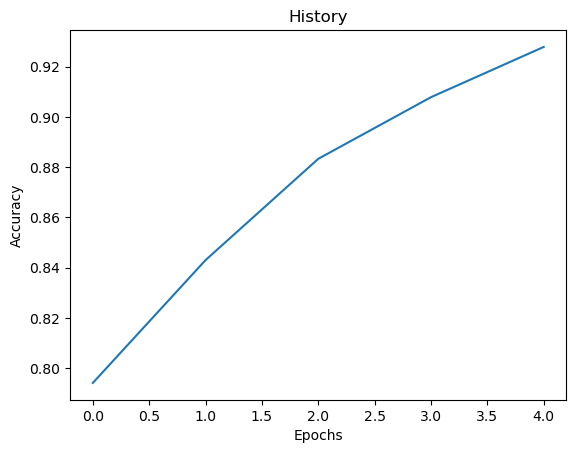

In [22]:
import matplotlib.pyplot as plt
plt.plot(hist.history['accuracy'])
plt.title("History")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.savefig("Accuracy-Epochs.png")

# Evaluate 

In [23]:
eval_ =model.evaluate(test_cnn_data, Label_test)
eval_

Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op _EagerConst in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op RangeDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op MapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op PrefetchDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op FlatMapDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op TensorDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op RepeatDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ZipDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op ParallelMapDatasetV2 in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op OptionsDataset in device /job:localhost/replica:0/task:0/device:CPU:0
Executing op Opt

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  144/12498 [..............................] - ETA: 1:30 - loss: 0.6153 - accuracy: 0.7786Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

  203/12498 [..............................] - ETA: 1:25 - loss: 0.6104 - accuracy: 0.7823Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  237/12498 [..............................

  264/12498 [..............................] - ETA: 1:23 - loss: 0.5915 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  298/12498 [..............................

  325/12498 [..............................] - ETA: 1:21 - loss: 0.5884 - accuracy: 0.7869Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  358/12498 [..............................] - ETA: 1:21 - loss: 0.5935 - accuracy: 0.7862Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  419/12498 [>.............................] - ETA: 1:20 - loss: 0.5902 - accuracy: 0.7851Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  480/12498 [>.............................] - ETA: 1:19 - loss: 0.5938 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  632/12498 [>.............................] - ETA: 1:17 - loss: 0.5922 - accuracy: 0.7871Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  694/12498 [>.............................

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  754/12498 [>.............................] - ETA: 1:16 - loss: 0.5934 - accuracy: 0.7861Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  846/12498 [=>............................

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
  906/12498 [=>............................] - ETA: 1:14 - loss: 0.5920 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1059/12498 [=>............................

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1211/12498 [=>............................

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1300/12498 [==>...........................] - ETA: 1:11 - loss: 0.5948 - accuracy: 0.7838Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1332/12498 [==>...........................] - ETA: 1:11 - loss: 0.5952 - accuracy: 0.7836Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

 1420/12498 [==>...........................] - ETA: 1:11 - loss: 0.5942 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1452/12498 [==>...........................] - ETA: 1:11 - loss: 0.5955 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1513/12498 [==>...........................] - ETA: 1:10 - loss: 0.5964 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1576/12498 [==>...........................

 1603/12498 [==>...........................] - ETA: 1:09 - loss: 0.5943 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1666/12498 [==>...........................] - ETA: 1:09 - loss: 0.5949 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1756/12498 [===>..........................] - ETA: 1:08 - loss: 0.5962 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1819/12498 [===>..........................] - ETA: 1:07 - loss: 0.5964 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1909/12498 [===>..........................] - ETA: 1:06 - loss: 0.5953 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 1972/12498 [===>..........................] - ETA: 1:06 - loss: 0.5942 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2062/12498 [===>..........................] - ETA: 1:05 - loss: 0.5931 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2125/12498 [====>.........................] - ETA: 1:04 - loss: 0.5930 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2215/12498 [====>.........................] - ETA: 1:04 - loss: 0.5930 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2278/12498 [====>.........................] - ETA: 1:03 - loss: 0.5937 - accuracy: 0.7835Executing op ReadVariableOp in

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2368/12498 [====>.........................] - ETA: 1:03 - loss: 0.5924 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2458/12498 [====>.........................] - ETA: 1:02 - loss: 0.5929 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2521/12498 [=====>........................] - ETA: 1:01 - loss: 0.5927 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2611/12498 [=====>........................] - ETA: 1:01 - loss: 0.5927 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2674/12498 [=====>........................] - ETA: 1:00 - loss: 0.5931 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in devic

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2764/12498 [=====>........................] - ETA: 1:00 - loss: 0.5950 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2827/12498 [=====>........................] - ETA: 59s - loss: 0.5954 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2917/12498 [======>.......................] - ETA: 59s - loss: 0.5946 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 2980/12498 [======>.......................] - ETA: 58s - loss: 0.5949 - accuracy: 0.7835Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3070/12498 [======>.......................] - ETA: 58s - loss: 0.5961 - accuracy: 0.7831Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3160/12498 [======>.......................] - ETA: 57s - loss: 0.5957 - accuracy: 0.7832Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3223/12498 [======>.......................] - ETA: 56s - loss: 0.5953 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3313/12498 [======>.......................] - ETA: 56s - loss: 0.5947 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3376/12498 [=======>......................] - ETA: 55s - loss: 0.5945 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

 3465/12498 [=======>......................] - ETA: 55s - loss: 0.5944 - accuracy: 0.7837Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3528/12498 [=======>......................] - ETA: 54s - loss: 0.5945 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3618/12498 [=======>......................] - ETA: 54s - loss: 0.5945 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3681/12498 [=======>......................] - ETA: 53s - loss: 0.5951 - accuracy: 0.7833Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3771/12498 [========>.....................] - ETA: 53s - loss: 0.5951 - accuracy: 0.7836Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3834/12498 [========>.....................] - ETA: 52s - loss: 0.5949 - accuracy: 0.7835Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3954/12498 [========>.....................] - ETA: 52s - loss: 0.5940 - accuracy: 0.7841Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 3986/12498 [========>.....................] - ETA: 52s - loss: 0.5937 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4106/12498 [========>.....................] - ETA: 51s - loss: 0.5937 - accuracy: 0.7840Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4139/12498 [========>.....................] - ETA: 51s - loss: 0.5935 - accuracy: 0.7841Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4229/12498 [=========>....................] - ETA: 50s - loss: 0.5935 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4319/12498 [=========>....................] - ETA: 50s - loss: 0.5934 - accuracy: 0.7842Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4382/12498 [=========>....................] - ETA: 49s - loss: 0.5926 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4444/12498 [=========>....................] - ETA: 49s - loss: 0.5927 - accuracy: 0.7843Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4534/12498 [=========>....................] - ETA: 48s - loss: 0.5921 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4624/12498 [==========>...................] - ETA: 48s - loss: 0.5919 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4687/12498 [==========>...................] - ETA: 47s - loss: 0.5920 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4777/12498 [==========>...................] - ETA: 47s - loss: 0.5919 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4840/12498 [==========>...................] - ETA: 46s - loss: 0.5917 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4930/12498 [==========>...................] - ETA: 46s - loss: 0.5922 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 4993/12498 [==========>...................] - ETA: 45s - loss: 0.5927 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5083/12498 [===========>..................] - ETA: 45s - loss: 0.5931 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5146/12498 [===========>..................] - ETA: 44s - loss: 0.5931 - accuracy: 0.7845Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5236/12498 [===========>..................] - ETA: 44s - loss: 0.5938 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5326/12498 [===========>..................] - ETA: 43s - loss: 0.5940 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5389/12498 [===========>..................] - ETA: 43s - loss: 0.5941 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5479/12498 [============>.................] - ETA: 42s - loss: 0.5943 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5542/12498 [============>.................] - ETA: 42s - loss: 0.5941 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5632/12498 [============>.................] - ETA: 41s - loss: 0.5939 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5695/12498 [============>.................] - ETA: 41s - loss: 0.5941 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5785/12498 [============>.................] - ETA: 40s - loss: 0.5941 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5848/12498 [=============>................] - ETA: 40s - loss: 0.5941 - accuracy: 0.7845Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 5938/12498 [=============>................] - ETA: 39s - loss: 0.5938 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6028/12498 [=============>................] - ETA: 39s - loss: 0.5938 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6091/12498 [=============>................] - ETA: 38s - loss: 0.5930 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6153/12498 [=============>................] - ETA: 38s - loss: 0.5933 - accuracy: 0.7846Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6243/12498 [=============>................] - ETA: 37s - loss: 0.5941 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6333/12498 [==============>...............] - ETA: 37s - loss: 0.5934 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6396/12498 [==============>...............] - ETA: 36s - loss: 0.5933 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6486/12498 [==============>...............] - ETA: 36s - loss: 0.5938 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6549/12498 [==============>...............] - ETA: 36s - loss: 0.5938 - accuracy: 0.7843Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6609/12498 [==============>...............] - ETA: 35s - loss: 0.5934 - accuracy: 0.7844Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6730/12498 [===============>..............] - ETA: 34s - loss: 0.5937 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6762/12498 [===============>..............] - ETA: 34s - loss: 0.5936 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6821/12498 [===============>..............] - ETA: 34s - loss: 0.5939 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6884/12498 [===============>..............] - ETA: 34s - loss: 0.5942 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 6974/12498 [===============>..............] - ETA: 33s - loss: 0.5937 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7037/12498 [===============>..............] - ETA: 33s - loss: 0.5937 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7127/12498 [================>.............] - ETA: 32s - loss: 0.5937 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7190/12498 [================>.............] - ETA: 32s - loss: 0.5936 - accuracy: 0.7845Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7280/12498 [================>.............] - ETA: 31s - loss: 0.5935 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7370/12498 [================>.............] - ETA: 31s - loss: 0.5936 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7433/12498 [================>.............] - ETA: 30s - loss: 0.5936 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7523/12498 [=================>............] - ETA: 30s - loss: 0.5934 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7586/12498 [=================>............] - ETA: 29s - loss: 0.5933 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7676/12498 [=================>............] - ETA: 29s - loss: 0.5932 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7739/12498 [=================>............] - ETA: 28s - loss: 0.5932 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7829/12498 [=================>............] - ETA: 28s - loss: 0.5935 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7892/12498 [=================>............] - ETA: 27s - loss: 0.5932 - accuracy: 0.7846Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 7982/12498 [==================>...........] - ETA: 27s - loss: 0.5933 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8072/12498 [==================>...........] - ETA: 26s - loss: 0.5932 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8135/12498 [==================>...........] - ETA: 26s - loss: 0.5931 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8225/12498 [==================>...........] - ETA: 25s - loss: 0.5929 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8288/12498 [==================>...........] - ETA: 25s - loss: 0.5933 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8378/12498 [===================>..........] - ETA: 24s - loss: 0.5934 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8441/12498 [===================>..........] - ETA: 24s - loss: 0.5935 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8531/12498 [===================>..........] - ETA: 23s - loss: 0.5935 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8594/12498 [===================>..........] - ETA: 23s - loss: 0.5936 - accuracy: 0.7846Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8684/12498 [===================>..........] - ETA: 22s - loss: 0.5935 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8774/12498 [====================>.........] - ETA: 22s - loss: 0.5937 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8837/12498 [====================>.........] - ETA: 21s - loss: 0.5936 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8927/12498 [====================>.........] - ETA: 21s - loss: 0.5938 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 8990/12498 [====================>.........] - ETA: 21s - loss: 0.5940 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9080/12498 [====================>.........] - ETA: 20s - loss: 0.5941 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9143/12498 [====================>.........] - ETA: 20s - loss: 0.5939 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9233/12498 [=====================>........] - ETA: 19s - loss: 0.5939 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9296/12498 [=====================>........] - ETA: 19s - loss: 0.5940 - accuracy: 0.7847Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9357/12498 [=====================>........

 9384/12498 [=====================>........] - ETA: 18s - loss: 0.5936 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9417/12498 [=====================>........] - ETA: 18s - loss: 0.5935 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9478/12498 [=====================>........] - ETA: 18s - loss: 0.5934 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9569/12498 [=====================>........] - ETA: 17s - loss: 0.5932 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9659/12498 [======================>.......] - ETA: 17s - loss: 0.5929 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9722/12498 [======================>.......] - ETA: 16s - loss: 0.5928 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9812/12498 [======================>.......] - ETA: 16s - loss: 0.5927 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9875/12498 [======================>.......] - ETA: 15s - loss: 0.5929 - accuracy: 0.7849Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
 9965/12498 [======================>.......] - ETA: 15s - loss: 0.5929 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10055/12498 [=======================>......] - ETA: 14s - loss: 0.5933 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10118/12498 [=======================>......] - ETA: 14s - loss: 0.5933 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10208/12498 [=======================>......] - ETA: 13s - loss: 0.5931 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10271/12498 [=======================>......] - ETA: 13s - loss: 0.5932 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10361/12498 [=======================>......] - ETA: 12s - loss: 0.5933 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10424/12498 [========================>.....] - ETA: 12s - loss: 0.5933 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10514/12498 [========================>.....] - ETA: 11s - loss: 0.5932 - accuracy: 0.7850Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10577/12498 [========================>.....] - ETA: 11s - loss: 0.5931 - accuracy: 0.7849Executing op ReadVariableOp in 

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10667/12498 [========================>.....] - ETA: 10s - loss: 0.5929 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/r

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10757/12498 [========================>.....] - ETA: 10s - loss: 0.5930 - accuracy: 0.7849Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10820/12498 [========================>.....] - ETA: 10s - loss: 0.5936 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in 

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10910/12498 [=========================>....] - ETA: 9s - loss: 0.5935 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
10973/12498 [=========================>....] - ETA: 9s - loss: 0.5934 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11063/12498 [=========================>....] - ETA: 8s - loss: 0.5934 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11126/12498 [=========================>....] - ETA: 8s - loss: 0.5934 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11216/12498 [=========================>....] - ETA: 7s - loss: 0.5932 - accuracy: 0.7848Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11279/12498 [==========================>...] - ETA: 7s - loss: 0.5935 - accuracy: 0.7847Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11368/12498 [==========================>...] - ETA: 6s - loss: 0.5937 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11431/12498 [==========================>...] - ETA: 6s - loss: 0.5937 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11521/12498 [==========================>...] - ETA: 5s - loss: 0.5939 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11584/12498 [==========================>...] - ETA: 5s - loss: 0.5940 - accuracy: 0.7846Executing op ReadVariableOp in d

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11674/12498 [===========================>..] - ETA: 4s - loss: 0.5940 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/re

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11764/12498 [===========================>..] - ETA: 4s - loss: 0.5941 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11827/12498 [===========================>..] - ETA: 4s - loss: 0.5941 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11917/12498 [===========================>..] - ETA: 3s - loss: 0.5941 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
11980/12498 [===========================>..] - ETA: 3s - loss: 0.5939 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12100/12498 [============================>.] - ETA: 2s - loss: 0.5938 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12132/12498 [============================>.] - ETA: 2s - loss: 0.5937 - accuracy: 0.7847Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12252/12498 [============================>.] - ETA: 1s - loss: 0.5940 - accuracy: 0.7846Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12284/12498 [============================>.] - ETA: 1s - loss: 0.5942 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in d

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12374/12498 [============================>.] - ETA: 0s - loss: 0.5942 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12437/12498 [============================>.] - ETA: 0s - loss: 0.5944 - accuracy: 0.7845Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device 

Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:

Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op __inference_test_function_69427 in device /job:localhost/replica:0/task:0/device:GPU:0
12498/12498 [==============================] - 75s 6ms/step - loss: 0.5944 - accuracy: 0.7845


[0.5943977236747742, 0.784455418586731]

In [24]:
model.save(MODEL_PATH)

Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op Identity in device /job:localhost/replica:0/task:0/device:GPU:0
Executing op ReadVariableOp in device /j